In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.38166311 0.

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit a CNN-LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 04:09:52,177] A new study created in memory with name: no-name-a4703ba6-1f47-4b5b-b463-ee7ec2d8fe53
[I 2025-05-18 04:22:20,476] Trial 0 finished with value: 0.47915634512901306 and parameters: {'lr': 0.9532172732937129, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.29924575481574284}. Best is trial 0 with value: 0.47915634512901306.


Cross Validation Accuracies:
[0.48704731464385986, 0.46072855591773987, 0.488824725151062, 0.48137596249580383, 0.47780516743659973]
Mean Cross Validation Accuracy:
0.47915634512901306
Standard Deviation of Cross Validation Accuracy:
0.010020786094529192


[I 2025-05-18 04:29:54,816] Trial 1 finished with value: 0.48934118151664735 and parameters: {'lr': 0.0011012891790183029, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1322138393261756}. Best is trial 0 with value: 0.47915634512901306.


Cross Validation Accuracies:
[0.49132540822029114, 0.48957520723342896, 0.4934368133544922, 0.478589802980423, 0.49377867579460144]
Mean Cross Validation Accuracy:
0.48934118151664735
Standard Deviation of Cross Validation Accuracy:
0.0055865842819167785


[I 2025-05-18 04:41:33,724] Trial 2 finished with value: 0.051435638964176175 and parameters: {'lr': 0.08491972324795977, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.11740586677030894}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[0.0420183390378952, 0.04568125307559967, 0.05675654113292694, 0.06357560306787491, 0.04914645850658417]
Mean Cross Validation Accuracy:
0.051435638964176175
Standard Deviation of Cross Validation Accuracy:
0.007781125501521121


[I 2025-05-18 04:50:54,715] Trial 3 finished with value: 7.6490401268005375 and parameters: {'lr': 0.6997167228385955, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.1429000856480027}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[11.727191925048828, 8.120593070983887, 4.935151100158691, 6.891178607940674, 6.5710859298706055]
Mean Cross Validation Accuracy:
7.6490401268005375
Standard Deviation of Cross Validation Accuracy:
2.2783861503308964


[I 2025-05-18 04:58:39,786] Trial 4 finished with value: 4.274830865859985 and parameters: {'lr': 0.34042285806066286, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.41637662709933954}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[2.818347930908203, 3.547917366027832, 5.8314208984375, 5.405588626861572, 3.7708795070648193]
Mean Cross Validation Accuracy:
4.274830865859985
Standard Deviation of Cross Validation Accuracy:
1.1493736025905998


[I 2025-05-18 05:09:30,909] Trial 5 finished with value: 0.1066246435046196 and parameters: {'lr': 0.0632779939510413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.436870443582137}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[0.11675126105546951, 0.09473082423210144, 0.1137750893831253, 0.09343671053647995, 0.11442933231592178]
Mean Cross Validation Accuracy:
0.1066246435046196
Standard Deviation of Cross Validation Accuracy:
0.010295386729825697


[I 2025-05-18 05:17:06,337] Trial 6 finished with value: 0.05071800947189331 and parameters: {'lr': 0.0754121306914182, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.40251091964288643}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.0425136461853981, 0.045114729553461075, 0.055459700524806976, 0.06227662414312363, 0.04822534695267677]
Mean Cross Validation Accuracy:
0.05071800947189331
Standard Deviation of Cross Validation Accuracy:
0.0072250521987742835


[I 2025-05-18 05:29:24,898] Trial 7 finished with value: 0.21254937648773192 and parameters: {'lr': 0.41425447270835575, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.23659173423526123}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.21544404327869415, 0.2074120044708252, 0.2153887301683426, 0.22023557126522064, 0.2042665332555771]
Mean Cross Validation Accuracy:
0.21254937648773192
Standard Deviation of Cross Validation Accuracy:
0.005839806478991256


[I 2025-05-18 05:38:55,472] Trial 8 finished with value: 0.051261772960424425 and parameters: {'lr': 0.06316662912921288, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.23619629288997357}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04111344367265701, 0.048069849610328674, 0.055293407291173935, 0.062136147171258926, 0.04969601705670357]
Mean Cross Validation Accuracy:
0.051261772960424425
Standard Deviation of Cross Validation Accuracy:
0.007072971700919233


[I 2025-05-18 05:47:28,136] Trial 9 finished with value: 0.056044069677591325 and parameters: {'lr': 0.7038127264295163, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.15357131846087763}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.05063176527619362, 0.045994941145181656, 0.06137680634856224, 0.06912392377853394, 0.05309291183948517]
Mean Cross Validation Accuracy:
0.056044069677591325
Standard Deviation of Cross Validation Accuracy:
0.008228098437470929


[I 2025-05-18 05:55:22,112] Trial 10 finished with value: 0.051517286151647565 and parameters: {'lr': 0.004408215023080536, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.49990532809616806}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04041295498609543, 0.04524592310190201, 0.05957629904150963, 0.0630287230014801, 0.04932253062725067]
Mean Cross Validation Accuracy:
0.051517286151647565
Standard Deviation of Cross Validation Accuracy:
0.008542996945504339


[I 2025-05-18 06:04:11,857] Trial 11 finished with value: 0.05243324115872383 and parameters: {'lr': 0.01679784764739798, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.333712436933679}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.044398628175258636, 0.04639642313122749, 0.05906382575631142, 0.06302018463611603, 0.04928714409470558]
Mean Cross Validation Accuracy:
0.05243324115872383
Standard Deviation of Cross Validation Accuracy:
0.007306765751365777


[I 2025-05-18 06:13:19,266] Trial 12 finished with value: 0.05150057151913643 and parameters: {'lr': 0.01854424215355864, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24095061762960013}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.043484464287757874, 0.04578493908047676, 0.05677536502480507, 0.06269033998250961, 0.04876774922013283]
Mean Cross Validation Accuracy:
0.05150057151913643
Standard Deviation of Cross Validation Accuracy:
0.007175362176616518


[I 2025-05-18 06:20:46,857] Trial 13 finished with value: 0.05317094698548317 and parameters: {'lr': 0.11077176365815779, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3578402606914569}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04445594549179077, 0.04933731257915497, 0.05551248416304588, 0.06569637358188629, 0.05085261911153793]
Mean Cross Validation Accuracy:
0.05317094698548317
Standard Deviation of Cross Validation Accuracy:
0.007188765620095659


[I 2025-05-18 06:28:08,840] Trial 14 finished with value: 0.05132314115762711 and parameters: {'lr': 0.036503381334123744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22945706852107034}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04303497448563576, 0.045589473098516464, 0.056926485151052475, 0.06227785721421242, 0.048786915838718414]
Mean Cross Validation Accuracy:
0.05132314115762711
Standard Deviation of Cross Validation Accuracy:
0.007202837813696924


[I 2025-05-18 06:36:48,177] Trial 15 finished with value: 0.06377962231636047 and parameters: {'lr': 0.22630390760626468, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3907762373354453}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.05870681628584862, 0.06137041747570038, 0.0641547217965126, 0.07887247949838638, 0.055793676525354385]
Mean Cross Validation Accuracy:
0.06377962231636047
Standard Deviation of Cross Validation Accuracy:
0.008040497456020826


[I 2025-05-18 06:45:57,510] Trial 16 finished with value: 0.05245933458209038 and parameters: {'lr': 0.008582489837842674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2924580824533101}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04181196913123131, 0.04884533956646919, 0.057096194475889206, 0.06311403214931488, 0.0514291375875473]
Mean Cross Validation Accuracy:
0.05245933458209038
Standard Deviation of Cross Validation Accuracy:
0.00724584994032291


[I 2025-05-18 06:56:21,820] Trial 17 finished with value: 0.049820664525032046 and parameters: {'lr': 0.15342861238690964, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.49160316872728915}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042080510407686234, 0.043236762285232544, 0.05431567505002022, 0.061763081699609756, 0.047707293182611465]
Mean Cross Validation Accuracy:
0.049820664525032046
Standard Deviation of Cross Validation Accuracy:
0.007355957320238745


[I 2025-05-18 07:04:55,338] Trial 18 finished with value: 0.050710993260145186 and parameters: {'lr': 0.1595328391521024, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.49637293729829124}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04156821221113205, 0.044700976461172104, 0.05662138760089874, 0.06234034523367882, 0.04832404479384422]
Mean Cross Validation Accuracy:
0.050710993260145186
Standard Deviation of Cross Validation Accuracy:
0.0076887301786764655


[I 2025-05-18 07:14:50,510] Trial 19 finished with value: 1.2314826607704163 and parameters: {'lr': 0.1874352357788998, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.47444420485744493}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.9506815075874329, 1.9742629528045654, 1.122849702835083, 1.014110803604126, 1.095508337020874]
Mean Cross Validation Accuracy:
1.2314826607704163
Standard Deviation of Cross Validation Accuracy:
0.37632765256358097


[I 2025-05-18 07:24:10,252] Trial 20 finished with value: 0.05127172619104385 and parameters: {'lr': 0.17092732530070756, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4555804203604632}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04447463899850845, 0.04458235204219818, 0.05747532472014427, 0.061286237090826035, 0.04854007810354233]
Mean Cross Validation Accuracy:
0.05127172619104385
Standard Deviation of Cross Validation Accuracy:
0.006887453598424271


[I 2025-05-18 07:31:44,217] Trial 21 finished with value: 0.05091791152954102 and parameters: {'lr': 0.03943835533265045, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4805826675280689}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04270981252193451, 0.04498831555247307, 0.05585309490561485, 0.06249645724892616, 0.048541877418756485]
Mean Cross Validation Accuracy:
0.05091791152954102
Standard Deviation of Cross Validation Accuracy:
0.0073020174170829065


[I 2025-05-18 07:40:02,688] Trial 22 finished with value: 0.05059844702482223 and parameters: {'lr': 0.11935007858807677, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4079190598547463}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04129381477832794, 0.04474789276719093, 0.05690555274486542, 0.06213332712650299, 0.04791164770722389]
Mean Cross Validation Accuracy:
0.05059844702482223
Standard Deviation of Cross Validation Accuracy:
0.007757023894007137


[I 2025-05-18 07:48:45,363] Trial 23 finished with value: 0.05074447765946388 and parameters: {'lr': 0.14158763559539292, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.44345823850131133}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04174615070223808, 0.04485427588224411, 0.05525585263967514, 0.06364471465349197, 0.048221394419670105]
Mean Cross Validation Accuracy:
0.05074447765946388
Standard Deviation of Cross Validation Accuracy:
0.007858739501403452


[I 2025-05-18 07:57:07,087] Trial 24 finished with value: 0.05004151463508606 and parameters: {'lr': 0.24934534125365482, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3720315534176375}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04228134825825691, 0.044163912534713745, 0.055088721215724945, 0.0614912249147892, 0.047182366251945496]
Mean Cross Validation Accuracy:
0.05004151463508606
Standard Deviation of Cross Validation Accuracy:
0.007204322006684185


[I 2025-05-18 08:04:10,810] Trial 25 finished with value: 0.052281927317380905 and parameters: {'lr': 0.38953343799879514, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36673041455380107}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04397943615913391, 0.04737992212176323, 0.05586268752813339, 0.06044692173600197, 0.053740669041872025]
Mean Cross Validation Accuracy:
0.052281927317380905
Standard Deviation of Cross Validation Accuracy:
0.005908941010577527


[I 2025-05-18 08:12:57,058] Trial 26 finished with value: 0.05062802881002426 and parameters: {'lr': 0.2850467593778694, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3273895451341525}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04160864278674126, 0.046248432248830795, 0.054931048303842545, 0.06223618611693382, 0.04811583459377289]
Mean Cross Validation Accuracy:
0.05062802881002426
Standard Deviation of Cross Validation Accuracy:
0.007212580715418237


[I 2025-05-18 08:23:02,229] Trial 27 finished with value: 0.05205835998058319 and parameters: {'lr': 0.021589474196529502, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3760945819962137}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.043730173259973526, 0.04595547541975975, 0.05786865949630737, 0.06352207064628601, 0.049215421080589294]
Mean Cross Validation Accuracy:
0.05205835998058319
Standard Deviation of Cross Validation Accuracy:
0.007481476302101719


[I 2025-05-18 08:34:43,872] Trial 28 finished with value: 51.261326217651366 and parameters: {'lr': 0.5630903007650461, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4130052992989179}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[54.10495376586914, 26.63707160949707, 57.52742004394531, 58.86196517944336, 59.17522048950195]
Mean Cross Validation Accuracy:
51.261326217651366
Standard Deviation of Cross Validation Accuracy:
12.442696650273605


[I 2025-05-18 08:43:56,306] Trial 29 finished with value: 0.05100496038794518 and parameters: {'lr': 0.04770684346843424, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3032806454070357}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04298187419772148, 0.0450463742017746, 0.05595250427722931, 0.06226223334670067, 0.04878181591629982]
Mean Cross Validation Accuracy:
0.05100496038794518
Standard Deviation of Cross Validation Accuracy:
0.007155716843194799


[I 2025-05-18 08:56:04,167] Trial 30 finished with value: 9.629928684234619 and parameters: {'lr': 0.11178890614564958, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.42716290925203665}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[9.025238990783691, 9.397008895874023, 7.515928745269775, 10.910707473754883, 11.300759315490723]
Mean Cross Validation Accuracy:
9.629928684234619
Standard Deviation of Cross Validation Accuracy:
1.365354628010448


[I 2025-05-18 09:03:56,876] Trial 31 finished with value: 0.05143982246518135 and parameters: {'lr': 0.27057425624268594, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31907014400135997}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042692940682172775, 0.04670167341828346, 0.05672065168619156, 0.06182540953159332, 0.049258437007665634]
Mean Cross Validation Accuracy:
0.05143982246518135
Standard Deviation of Cross Validation Accuracy:
0.006920462640695441


[I 2025-05-18 09:14:12,609] Trial 32 finished with value: 0.05300246253609657 and parameters: {'lr': 0.8833176768537905, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3445273039430554}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04709381237626076, 0.049172233790159225, 0.055707111954689026, 0.061898671090602875, 0.05114048346877098]
Mean Cross Validation Accuracy:
0.05300246253609657
Standard Deviation of Cross Validation Accuracy:
0.005282185534936365


[I 2025-05-18 09:22:43,031] Trial 33 finished with value: 0.051939642429351805 and parameters: {'lr': 0.29683911134784285, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27107079250622784}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04342150315642357, 0.04558989778161049, 0.05739453807473183, 0.06391960382461548, 0.04937266930937767]
Mean Cross Validation Accuracy:
0.051939642429351805
Standard Deviation of Cross Validation Accuracy:
0.007651701331039856


[I 2025-05-18 09:30:49,739] Trial 34 finished with value: 0.05168818980455399 and parameters: {'lr': 0.4659203786909108, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3845632921533488}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04390249773859978, 0.04588867351412773, 0.055291272699832916, 0.0637013241648674, 0.0496571809053421]
Mean Cross Validation Accuracy:
0.05168818980455399
Standard Deviation of Cross Validation Accuracy:
0.007150859959566458


[I 2025-05-18 09:40:39,933] Trial 35 finished with value: 0.5070058226585388 and parameters: {'lr': 0.0014017096105415161, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.45439154954322897}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.5092870593070984, 0.5127527117729187, 0.5077378749847412, 0.4933309555053711, 0.5119205117225647]
Mean Cross Validation Accuracy:
0.5070058226585388
Standard Deviation of Cross Validation Accuracy:
0.0070699764639049366


[I 2025-05-18 09:49:23,915] Trial 36 finished with value: 0.0511177733540535 and parameters: {'lr': 0.10203791751128473, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.34398704109405825}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.043198324739933014, 0.04472758248448372, 0.0566953644156456, 0.06215246021747589, 0.04881513491272926]
Mean Cross Validation Accuracy:
0.0511177733540535
Standard Deviation of Cross Validation Accuracy:
0.007235028482553897


[I 2025-05-18 10:01:56,918] Trial 37 finished with value: 19.544866180419923 and parameters: {'lr': 0.2182710355245775, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2824642874581591}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[15.966205596923828, 17.332197189331055, 21.70047378540039, 19.024219512939453, 23.701234817504883]
Mean Cross Validation Accuracy:
19.544866180419923
Standard Deviation of Cross Validation Accuracy:
2.8247418636876


[I 2025-05-18 10:10:23,597] Trial 38 finished with value: 0.05078767538070679 and parameters: {'lr': 0.07501890901490088, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4013131257097885}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04253366217017174, 0.04467756673693657, 0.055848632007837296, 0.062279924750328064, 0.04859859123826027]
Mean Cross Validation Accuracy:
0.05078767538070679
Standard Deviation of Cross Validation Accuracy:
0.007320373332779282


[I 2025-05-18 10:18:04,049] Trial 39 finished with value: 0.051406098157167436 and parameters: {'lr': 0.28396199727762556, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.25935564032988245}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04456682130694389, 0.04436822608113289, 0.05778295174241066, 0.0625310093164444, 0.047781482338905334]
Mean Cross Validation Accuracy:
0.051406098157167436
Standard Deviation of Cross Validation Accuracy:
0.0074009877850468135


[I 2025-05-18 10:29:28,400] Trial 40 finished with value: 87.19149017333984 and parameters: {'lr': 0.9574916663338457, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1927507751669484}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[94.22720336914062, 78.17833709716797, 109.90074920654297, 89.37405395507812, 64.27710723876953]
Mean Cross Validation Accuracy:
87.19149017333984
Standard Deviation of Cross Validation Accuracy:
15.338064834382937


[I 2025-05-18 10:37:50,302] Trial 41 finished with value: 0.05042748227715492 and parameters: {'lr': 0.1520871939460998, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4950950451272397}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041002947837114334, 0.044786397367715836, 0.0550306998193264, 0.06191878020763397, 0.04939858615398407]
Mean Cross Validation Accuracy:
0.05042748227715492
Standard Deviation of Cross Validation Accuracy:
0.007415414424924286


[I 2025-05-18 10:46:19,339] Trial 42 finished with value: 0.050473077595233916 and parameters: {'lr': 0.12315427949742604, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4592665552512292}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04132935032248497, 0.04461906477808952, 0.05681696906685829, 0.061896275728940964, 0.04770372807979584]
Mean Cross Validation Accuracy:
0.050473077595233916
Standard Deviation of Cross Validation Accuracy:
0.007697803918599609


[I 2025-05-18 10:54:05,838] Trial 43 finished with value: 0.05104197934269905 and parameters: {'lr': 0.12971964250791682, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.47206650993907096}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041558489203453064, 0.04482142627239227, 0.05720961093902588, 0.06276882439851761, 0.04885154590010643]
Mean Cross Validation Accuracy:
0.05104197934269905
Standard Deviation of Cross Validation Accuracy:
0.007861150537412348


[I 2025-05-18 11:02:37,695] Trial 44 finished with value: 0.050821765512228015 and parameters: {'lr': 0.07058900051827455, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.42923349212392126}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041484929621219635, 0.045697156339883804, 0.055534735321998596, 0.06313084065914154, 0.048261165618896484]
Mean Cross Validation Accuracy:
0.050821765512228015
Standard Deviation of Cross Validation Accuracy:
0.007664466202401825


[I 2025-05-18 11:10:20,041] Trial 45 finished with value: 0.05095904543995857 and parameters: {'lr': 0.05685626333261721, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.45341151987292094}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04223525896668434, 0.0449855700135231, 0.05604565516114235, 0.06266426295042038, 0.04886448010802269]
Mean Cross Validation Accuracy:
0.05095904543995857
Standard Deviation of Cross Validation Accuracy:
0.007470739969429019


[I 2025-05-18 11:20:17,504] Trial 46 finished with value: 2.6503326892852783 and parameters: {'lr': 0.530364869995873, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.48523896877116046}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[3.5980050563812256, 1.9591000080108643, 2.758226156234741, 2.793606996536255, 2.1427252292633057]
Mean Cross Validation Accuracy:
2.6503326892852783
Standard Deviation of Cross Validation Accuracy:
0.5771861737459816


[I 2025-05-18 11:30:09,147] Trial 47 finished with value: 0.05062777623534202 and parameters: {'lr': 0.08519111494554256, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.46374642305780794}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04221263527870178, 0.04552560672163963, 0.05596257746219635, 0.06154210492968559, 0.04789595678448677]
Mean Cross Validation Accuracy:
0.05062777623534202
Standard Deviation of Cross Validation Accuracy:
0.007097777730486734


[I 2025-05-18 11:37:31,169] Trial 48 finished with value: 0.05083505660295486 and parameters: {'lr': 0.09615138641214811, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4147382095567389}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04274848848581314, 0.04427608847618103, 0.056142497807741165, 0.06209748610854149, 0.0489107221364975]
Mean Cross Validation Accuracy:
0.05083505660295486
Standard Deviation of Cross Validation Accuracy:
0.007309267548127862


[I 2025-05-18 11:44:52,727] Trial 49 finished with value: 0.051375599950551985 and parameters: {'lr': 0.02593676542961331, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4382343076619998}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04358067736029625, 0.04545913636684418, 0.05644622817635536, 0.06267278641462326, 0.048719171434640884]
Mean Cross Validation Accuracy:
0.051375599950551985
Standard Deviation of Cross Validation Accuracy:
0.007157648560719849


[I 2025-05-18 11:52:50,726] Trial 50 finished with value: 0.050326849520206454 and parameters: {'lr': 0.2158446501936486, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4914511264553804}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042848140001297, 0.04365425929427147, 0.05635347217321396, 0.06172991171479225, 0.04704846441745758]
Mean Cross Validation Accuracy:
0.050326849520206454
Standard Deviation of Cross Validation Accuracy:
0.007450535192705701


[I 2025-05-18 12:01:49,274] Trial 51 finished with value: 0.05101310461759567 and parameters: {'lr': 0.2056363339023256, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.49983208893249537}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04236181452870369, 0.044339507818222046, 0.055470407009124756, 0.06276073306798935, 0.05013306066393852]
Mean Cross Validation Accuracy:
0.05101310461759567
Standard Deviation of Cross Validation Accuracy:
0.007456949920995432


[I 2025-05-18 12:10:17,231] Trial 52 finished with value: 0.05099468231201172 and parameters: {'lr': 0.14197634030785503, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.485410285683871}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042026080191135406, 0.045796629041433334, 0.055898092687129974, 0.06250608712434769, 0.04874652251601219]
Mean Cross Validation Accuracy:
0.05099468231201172
Standard Deviation of Cross Validation Accuracy:
0.007335743702379403


[I 2025-05-18 12:19:44,644] Trial 53 finished with value: 0.05165935456752777 and parameters: {'lr': 0.1790819378416231, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.46675159493289636}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04292408749461174, 0.04576791450381279, 0.05741003528237343, 0.06275028735399246, 0.049444448202848434]
Mean Cross Validation Accuracy:
0.05165935456752777
Standard Deviation of Cross Validation Accuracy:
0.007375620459619505


[I 2025-05-18 12:28:22,953] Trial 54 finished with value: 0.050473012030124664 and parameters: {'lr': 0.3616083426821619, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4471337662634264}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04128533974289894, 0.04576337710022926, 0.05413597822189331, 0.06389324367046356, 0.047287121415138245]
Mean Cross Validation Accuracy:
0.050473012030124664
Standard Deviation of Cross Validation Accuracy:
0.007877357689522526


[I 2025-05-18 12:37:08,048] Trial 55 finished with value: 3.7028738498687743 and parameters: {'lr': 0.7335259519877532, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4438977134797767}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[3.871148109436035, 3.1962778568267822, 5.034975051879883, 3.1441144943237305, 3.2678537368774414]
Mean Cross Validation Accuracy:
3.7028738498687743
Standard Deviation of Cross Validation Accuracy:
0.7156680592445993


[I 2025-05-18 12:46:52,565] Trial 56 finished with value: 0.05760657414793968 and parameters: {'lr': 0.3554066485864745, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.48837525241801566}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04431556165218353, 0.05616573244333267, 0.059209194034338, 0.07228464633226395, 0.05605773627758026]
Mean Cross Validation Accuracy:
0.05760657414793968
Standard Deviation of Cross Validation Accuracy:
0.008934653102132768


[I 2025-05-18 12:55:51,150] Trial 57 finished with value: 0.054216063022613524 and parameters: {'lr': 0.3831831987933883, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4696432798842825}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04596126452088356, 0.04585014656186104, 0.06040466949343681, 0.0653369277715683, 0.05352730676531792]
Mean Cross Validation Accuracy:
0.054216063022613524
Standard Deviation of Cross Validation Accuracy:
0.00775341375820583


[I 2025-05-18 13:04:43,941] Trial 58 finished with value: 0.05616109743714333 and parameters: {'lr': 0.5534433659702436, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.43118212012852575}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04484359920024872, 0.04755821079015732, 0.06354480236768723, 0.06714474409818649, 0.057714130729436874]
Mean Cross Validation Accuracy:
0.05616109743714333
Standard Deviation of Cross Validation Accuracy:
0.00871397647329803


[I 2025-05-18 13:14:17,069] Trial 59 finished with value: 0.14082455039024352 and parameters: {'lr': 0.012257253642509642, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.45537197027097515}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.138671875, 0.14114981889724731, 0.11129245162010193, 0.13520967960357666, 0.17779892683029175]
Mean Cross Validation Accuracy:
0.14082455039024352
Standard Deviation of Cross Validation Accuracy:
0.021333147708616117


[I 2025-05-18 13:24:38,662] Trial 60 finished with value: 19.457355308532716 and parameters: {'lr': 0.22528926169091185, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4935386038032917}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[12.661911964416504, 18.72987937927246, 21.725942611694336, 22.598417282104492, 21.57062530517578]
Mean Cross Validation Accuracy:
19.457355308532716
Standard Deviation of Cross Validation Accuracy:
3.6382946616057064


[I 2025-05-18 13:31:50,860] Trial 61 finished with value: 0.05064225420355797 and parameters: {'lr': 0.12381868005252893, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.40271479390859766}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042199745774269104, 0.044615525752305984, 0.055856768041849136, 0.06211540848016739, 0.04842382296919823]
Mean Cross Validation Accuracy:
0.05064225420355797
Standard Deviation of Cross Validation Accuracy:
0.007366726072957209


[I 2025-05-18 13:40:35,568] Trial 62 finished with value: 0.050936716794967654 and parameters: {'lr': 0.05172337817157805, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.41988399977137963}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042143307626247406, 0.045089028775691986, 0.05662509426474571, 0.06270220130681992, 0.04812395200133324]
Mean Cross Validation Accuracy:
0.050936716794967654
Standard Deviation of Cross Validation Accuracy:
0.0076186010500739155


[I 2025-05-18 13:48:19,390] Trial 63 finished with value: 0.05003626570105553 and parameters: {'lr': 0.15445762210365951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4789308400111577}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04148233309388161, 0.043959617614746094, 0.05611630901694298, 0.06159789860248566, 0.0470251701772213]
Mean Cross Validation Accuracy:
0.05003626570105553
Standard Deviation of Cross Validation Accuracy:
0.007613151690818661


[I 2025-05-18 13:58:25,777] Trial 64 finished with value: 0.05034287720918655 and parameters: {'lr': 0.16816657262075294, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.47474472602736123}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04001827538013458, 0.0457984060049057, 0.05530459061264992, 0.06243233382701874, 0.04816078022122383]
Mean Cross Validation Accuracy:
0.05034287720918655
Standard Deviation of Cross Validation Accuracy:
0.0077818343587155794


[I 2025-05-18 14:07:59,843] Trial 65 finished with value: 0.05100584030151367 and parameters: {'lr': 0.252508081458702, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4827103754461523}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.03798821195960045, 0.04500947147607803, 0.057870373129844666, 0.06360520422458649, 0.050555940717458725]
Mean Cross Validation Accuracy:
0.05100584030151367
Standard Deviation of Cross Validation Accuracy:
0.009071750421961953


[I 2025-05-18 14:17:24,062] Trial 66 finished with value: 0.7929956316947937 and parameters: {'lr': 0.1658032649217257, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4427778944186016}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.673510730266571, 0.680761992931366, 0.6792724132537842, 0.8570747971534729, 1.0743582248687744]
Mean Cross Validation Accuracy:
0.7929956316947937
Standard Deviation of Cross Validation Accuracy:
0.1568929890310214


[I 2025-05-18 14:27:20,096] Trial 67 finished with value: 0.0552042156457901 and parameters: {'lr': 0.35249519696417164, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.47609648210823097}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.044190533459186554, 0.04526273161172867, 0.06084334850311279, 0.06794503331184387, 0.05777943134307861]
Mean Cross Validation Accuracy:
0.0552042156457901
Standard Deviation of Cross Validation Accuracy:
0.009174903707143004


[I 2025-05-18 14:36:20,383] Trial 68 finished with value: 0.05767809450626373 and parameters: {'lr': 0.6751666122493722, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4971146211235367}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.05323926359415054, 0.054207757115364075, 0.060683682560920715, 0.06833527982234955, 0.05192448943853378]
Mean Cross Validation Accuracy:
0.05767809450626373
Standard Deviation of Cross Validation Accuracy:
0.006123064447874242


[I 2025-05-18 14:46:03,535] Trial 69 finished with value: 0.054366853833198545 and parameters: {'lr': 0.4575611616958704, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.47471100802921445}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04754282161593437, 0.04807150363922119, 0.06020980700850487, 0.06385680288076401, 0.0521533340215683]
Mean Cross Validation Accuracy:
0.054366853833198545
Standard Deviation of Cross Validation Accuracy:
0.0065619776661881525


[I 2025-05-18 14:53:47,559] Trial 70 finished with value: 0.050880780816078185 and parameters: {'lr': 0.19285894743709212, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.448305797718587}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04247354716062546, 0.04340270906686783, 0.05602965131402016, 0.06327999383211136, 0.04921800270676613]
Mean Cross Validation Accuracy:
0.050880780816078185
Standard Deviation of Cross Validation Accuracy:
0.007869171705917544


[I 2025-05-18 14:58:08,161] Trial 71 finished with value: 0.05090807527303696 and parameters: {'lr': 0.14060661466142746, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.46094812632762133}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04318898171186447, 0.04451294243335724, 0.056757546961307526, 0.06135967746376991, 0.048721227794885635]
Mean Cross Validation Accuracy:
0.05090807527303696
Standard Deviation of Cross Validation Accuracy:
0.007052896408160184


[I 2025-05-18 15:02:11,642] Trial 72 finished with value: 0.050940423458814624 and parameters: {'lr': 0.08729994928133754, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.46358692799856566}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042260635644197464, 0.04513503983616829, 0.05640546977519989, 0.06226419284939766, 0.0486367791891098]
Mean Cross Validation Accuracy:
0.050940423458814624
Standard Deviation of Cross Validation Accuracy:
0.007381632026666625


[I 2025-05-18 15:06:26,589] Trial 73 finished with value: 0.050593315809965136 and parameters: {'lr': 0.30278671933225737, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10626543069818817}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041983071714639664, 0.045758724212646484, 0.05762099847197533, 0.06046036258339882, 0.047143422067165375]
Mean Cross Validation Accuracy:
0.050593315809965136
Standard Deviation of Cross Validation Accuracy:
0.0071576292409932345


[I 2025-05-18 15:10:44,659] Trial 74 finished with value: 0.05104996487498283 and parameters: {'lr': 0.2433755507701114, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.48087653160875615}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.0443635918200016, 0.04411541670560837, 0.0566711388528347, 0.06179322302341461, 0.048306453973054886]
Mean Cross Validation Accuracy:
0.05104996487498283
Standard Deviation of Cross Validation Accuracy:
0.007033314830801705


[I 2025-05-18 15:14:43,499] Trial 75 finished with value: 0.05092116519808769 and parameters: {'lr': 0.15739020534175263, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3903545209824815}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.040891699492931366, 0.04611534997820854, 0.05612868443131447, 0.06259198486804962, 0.048878107219934464]
Mean Cross Validation Accuracy:
0.05092116519808769
Standard Deviation of Cross Validation Accuracy:
0.007631335616965377


[I 2025-05-18 15:22:30,136] Trial 76 finished with value: 10.045861434936523 and parameters: {'lr': 0.11076060244733421, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4906490553456335}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[9.912317276000977, 10.704216003417969, 11.666747093200684, 8.879781723022461, 9.066245079040527]
Mean Cross Validation Accuracy:
10.045861434936523
Standard Deviation of Cross Validation Accuracy:
1.0390308173167113


[I 2025-05-18 15:26:52,668] Trial 77 finished with value: 0.05110170692205429 and parameters: {'lr': 0.04025346265235812, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.42326032188171914}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04278874397277832, 0.04522176459431648, 0.056533876806497574, 0.06230976805090904, 0.048654381185770035]
Mean Cross Validation Accuracy:
0.05110170692205429
Standard Deviation of Cross Validation Accuracy:
0.007277328932439902


[I 2025-05-18 15:31:29,017] Trial 78 finished with value: 0.4535916566848755 and parameters: {'lr': 0.0026765104815319046, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4350689992017442}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.45122483372688293, 0.47355028986930847, 0.449909508228302, 0.44031742215156555, 0.4529562294483185]
Mean Cross Validation Accuracy:
0.4535916566848755
Standard Deviation of Cross Validation Accuracy:
0.010900607111347084


[I 2025-05-18 15:35:26,117] Trial 79 finished with value: 0.0620217889547348 and parameters: {'lr': 0.31731364132217804, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36016282443713354}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.051312219351530075, 0.05590897426009178, 0.06980033218860626, 0.07224921137094498, 0.060838207602500916]
Mean Cross Validation Accuracy:
0.0620217889547348
Standard Deviation of Cross Validation Accuracy:
0.007982081852688457


[I 2025-05-18 15:39:16,424] Trial 80 finished with value: 1.2569039106369018 and parameters: {'lr': 0.1903063486692154, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4986771983938551}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[1.4256285429000854, 1.2306737899780273, 1.1074055433273315, 1.8172610998153687, 0.7035505771636963]
Mean Cross Validation Accuracy:
1.2569039106369018
Standard Deviation of Cross Validation Accuracy:
0.366525817295386


[I 2025-05-18 15:43:54,222] Trial 81 finished with value: 0.049157936871051786 and parameters: {'lr': 0.30144585686915315, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22685187063940204}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04035953804850578, 0.044526293873786926, 0.05315621942281723, 0.05996336042881012, 0.04778427258133888]
Mean Cross Validation Accuracy:
0.049157936871051786
Standard Deviation of Cross Validation Accuracy:
0.006833656911227468


[I 2025-05-18 15:49:05,691] Trial 82 finished with value: 0.052822339534759524 and parameters: {'lr': 0.42193490552464824, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.19421162039439482}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04599739611148834, 0.042816199362277985, 0.06190405786037445, 0.06317547708749771, 0.05021856725215912]
Mean Cross Validation Accuracy:
0.052822339534759524
Standard Deviation of Cross Validation Accuracy:
0.008284291024747589


[I 2025-05-18 15:53:51,575] Trial 83 finished with value: 0.05205972641706467 and parameters: {'lr': 0.25997792239721274, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4748604606705793}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04133813828229904, 0.04907551780343056, 0.05764101445674896, 0.06317184120416641, 0.04907212033867836]
Mean Cross Validation Accuracy:
0.05205972641706467
Standard Deviation of Cross Validation Accuracy:
0.007581736140020887


[I 2025-05-18 15:58:39,074] Trial 84 finished with value: 0.05059833601117134 and parameters: {'lr': 0.1552222210348078, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.2089417509141222}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.043156709522008896, 0.04472874850034714, 0.05438251793384552, 0.06165153160691261, 0.04907217249274254]
Mean Cross Validation Accuracy:
0.05059833601117134
Standard Deviation of Cross Validation Accuracy:
0.006762428604251862


[I 2025-05-18 16:03:30,104] Trial 85 finished with value: 0.05163646191358566 and parameters: {'lr': 0.21499465300630713, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.14781920662425183}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.0450577586889267, 0.04504328966140747, 0.05714449658989906, 0.06217397749423981, 0.048762787133455276]
Mean Cross Validation Accuracy:
0.05163646191358566
Standard Deviation of Cross Validation Accuracy:
0.006875826405821891


[I 2025-05-18 16:08:29,549] Trial 86 finished with value: 0.05094127580523491 and parameters: {'lr': 0.11909112829078371, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.16587313784201949}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04326556250452995, 0.04641103371977806, 0.05504235252737999, 0.061618078500032425, 0.04836935177445412]
Mean Cross Validation Accuracy:
0.05094127580523491
Standard Deviation of Cross Validation Accuracy:
0.006585854649354583


[I 2025-05-18 16:13:18,626] Trial 87 finished with value: 0.05112121254205704 and parameters: {'lr': 0.06300547252934655, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.30952173438395847}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04233766719698906, 0.044868625700473785, 0.057146310806274414, 0.062486432492733, 0.048767026513814926]
Mean Cross Validation Accuracy:
0.05112121254205704
Standard Deviation of Cross Validation Accuracy:
0.007579679894516574


[I 2025-05-18 16:19:20,324] Trial 88 finished with value: 0.05078704059123993 and parameters: {'lr': 0.09349360118040631, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.457602044010328}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.042841747403144836, 0.04484011232852936, 0.05626561865210533, 0.061658505350351334, 0.04832921922206879]
Mean Cross Validation Accuracy:
0.05078704059123993
Standard Deviation of Cross Validation Accuracy:
0.007109684790016605


[I 2025-05-18 16:24:41,748] Trial 89 finished with value: 30.780385208129882 and parameters: {'lr': 0.31763190857375345, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24868246058860802}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[32.25974655151367, 33.65434646606445, 31.776416778564453, 31.014732360839844, 25.196683883666992]
Mean Cross Validation Accuracy:
30.780385208129882
Standard Deviation of Cross Validation Accuracy:
2.92139970748617


[I 2025-05-18 16:31:02,827] Trial 90 finished with value: 0.0503958560526371 and parameters: {'lr': 0.07509532145096622, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4469138878695623}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04177290201187134, 0.04495839402079582, 0.05546366050839424, 0.06177986040711403, 0.04800446331501007]
Mean Cross Validation Accuracy:
0.0503958560526371
Standard Deviation of Cross Validation Accuracy:
0.007278987376098285


[I 2025-05-18 16:37:07,977] Trial 91 finished with value: 0.0505088821053505 and parameters: {'lr': 0.07563727253808766, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.46801447789621337}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.041335079818964005, 0.04507298022508621, 0.055611539632081985, 0.06237775459885597, 0.0481470562517643]
Mean Cross Validation Accuracy:
0.0505088821053505
Standard Deviation of Cross Validation Accuracy:
0.007565621548907127


[I 2025-05-18 16:42:58,361] Trial 92 finished with value: 0.05073757469654083 and parameters: {'lr': 0.13526529102818366, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.482194192030867}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.0428437814116478, 0.04501665011048317, 0.05688953027129173, 0.06144070252776146, 0.047497209161520004]
Mean Cross Validation Accuracy:
0.05073757469654083
Standard Deviation of Cross Validation Accuracy:
0.007182540248542858


[I 2025-05-18 16:51:34,967] Trial 93 finished with value: 0.04967838674783707 and parameters: {'lr': 0.17948498609323174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.44731918105373786}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04012120142579079, 0.0438198447227478, 0.05470646917819977, 0.06227867305278778, 0.047465745359659195]
Mean Cross Validation Accuracy:
0.04967838674783707
Standard Deviation of Cross Validation Accuracy:
0.00793229999111988


[I 2025-05-18 16:59:24,627] Trial 94 finished with value: 0.05031521171331406 and parameters: {'lr': 0.1774996734593864, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4518675231183759}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04431748762726784, 0.04552854597568512, 0.05272093042731285, 0.061353329569101334, 0.04765576496720314]
Mean Cross Validation Accuracy:
0.05031521171331406
Standard Deviation of Cross Validation Accuracy:
0.006222299388821846


[I 2025-05-18 17:06:39,969] Trial 95 finished with value: 0.04965920671820641 and parameters: {'lr': 0.18331724275336672, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.37523788949170706}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04168590158224106, 0.044145602732896805, 0.05468720570206642, 0.06087169796228409, 0.046905625611543655]
Mean Cross Validation Accuracy:
0.04965920671820641
Standard Deviation of Cross Validation Accuracy:
0.007107128341168737


[I 2025-05-18 17:13:25,238] Trial 96 finished with value: 0.04916261285543442 and parameters: {'lr': 0.19058367142589208, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.37117230845536486}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.040816400200128555, 0.043548788875341415, 0.05415016785264015, 0.06025473773479462, 0.04704296961426735]
Mean Cross Validation Accuracy:
0.04916261285543442
Standard Deviation of Cross Validation Accuracy:
0.007121490181504902


[I 2025-05-18 17:19:00,374] Trial 97 finished with value: 0.04857913851737976 and parameters: {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.04081575199961662, 0.0424196831882, 0.052468132227659225, 0.06192908436059952, 0.04526304081082344]
Mean Cross Validation Accuracy:
0.04857913851737976
Standard Deviation of Cross Validation Accuracy:
0.007778828835644467


[I 2025-05-18 17:24:00,062] Trial 98 finished with value: 0.0630200020968914 and parameters: {'lr': 0.22480012592368054, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3457374259645833}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.055258143693208694, 0.05493497848510742, 0.0694321021437645, 0.06946858018636703, 0.06600620597600937]
Mean Cross Validation Accuracy:
0.0630200020968914
Standard Deviation of Cross Validation Accuracy:
0.006591367880444221


[I 2025-05-18 17:27:41,330] Trial 99 finished with value: 0.05079420134425163 and parameters: {'lr': 0.1829644481820748, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.33066787876092835}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.042430777102708817, 0.045208994299173355, 0.05539032071828842, 0.06306848675012589, 0.047872427850961685]
Mean Cross Validation Accuracy:
0.05079420134425163
Standard Deviation of Cross Validation Accuracy:
0.007502806923435572
Number of finished trials: 100
Best trial: {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}
Best hyperparameters:  {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}
Fold 1:
Epoch 1/100
84/84 [==============================] - 16s 86ms/step - loss: 0.1439 - val_loss: 0.0710
Epoch 2/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0691 - val_loss: 0.0708
Epoch 3/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0626 - val_loss: 0.0634
Epoch 4/100
84/84 [==============================] - 5s 58ms/

NameError: name 'series' is not defined

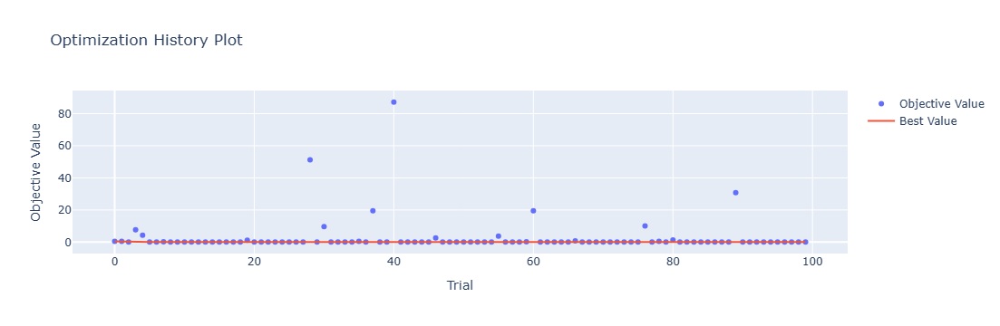

In [4]:
optuna.visualization.plot_optimization_history(study)

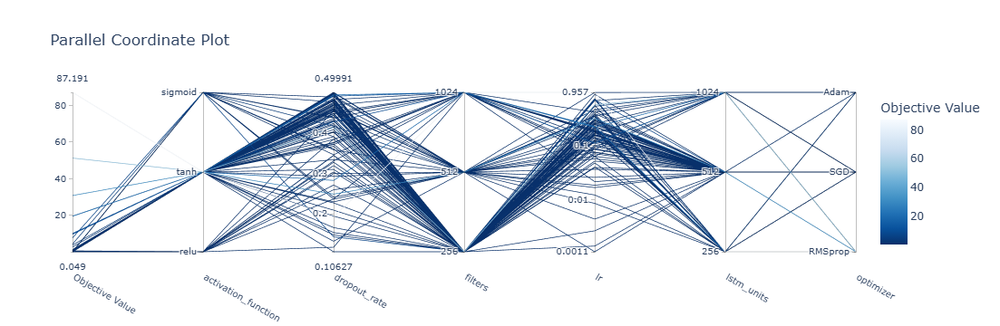

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

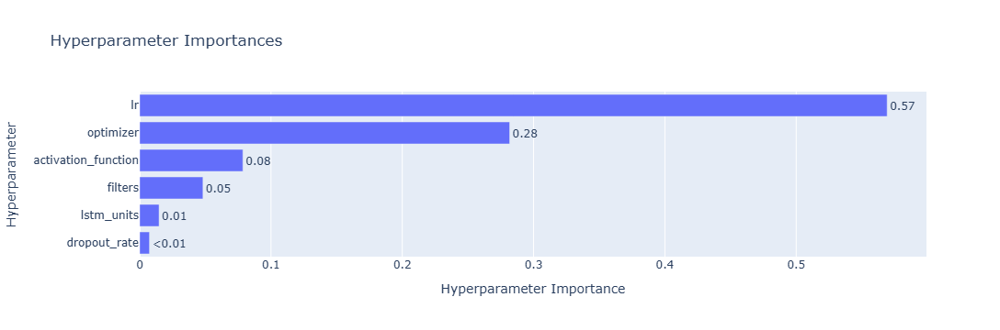

In [6]:
optuna.visualization.plot_param_importances(study)

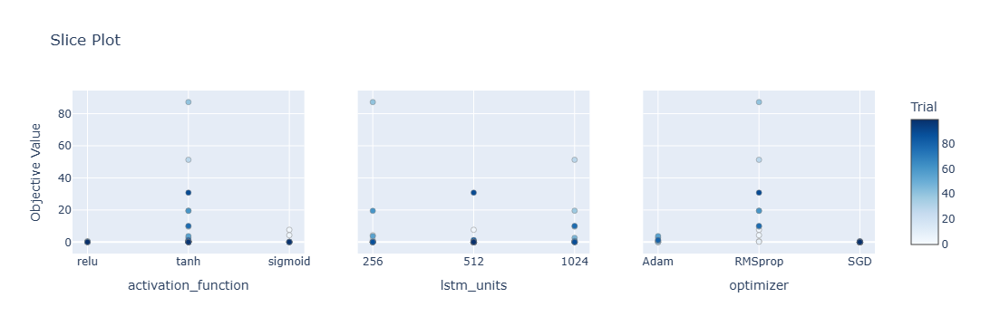

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

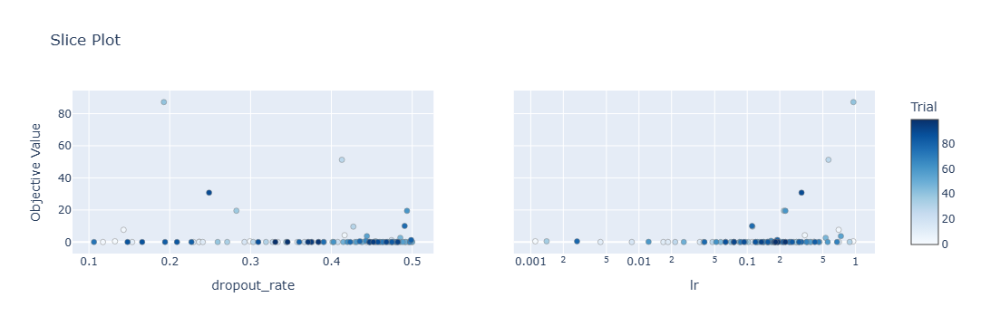

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 37s 188ms/step - loss: 0.1400 - accuracy: 0.2143 - mae: 0.1203 - rmse: 0.1400 - mape: inf - pearson: 0.6268 - val_loss: 0.0749 - val_accuracy: 0.4000 - val_mae: 0.0598 - val_rmse: 0.0749 - val_mape: 13.3470 - val_pearson: 0.8208
Epoch 2/100
84/84 [==============================] - 8s 91ms/step - loss: 0.0696 - accuracy: 0.4524 - mae: 0.0556 - rmse: 0.0696 - mape: inf - pearson: 0.8091 - val_loss: 0.0707 - val_accuracy: 0.4000 - val_mae: 0.0550 - val_rmse: 0.0707 - val_mape: 12.3568 - val_pearson: 0.8132
Epoch 3/100
84/84 [==============================] - 8s 95ms/step - loss: 0.0618 - accuracy: 0.5000 - mae: 0.0488 - rmse: 0.0618 - mape: inf - pearson: 0.8382 - val_loss: 0.0663 - val_accuracy: 0.4000 - val_mae: 0.0520 - val_rmse: 0.0663 - val_mape: 11.7634 - val_pearson: 0.7956
Epoch 4/100
84/84 [==============================] - 7s 79ms/step - loss: 0.0607 - accuracy: 0.5238 - mae: 0.0483 - rmse: 0.0607 - mape: inf - pearson: 0.8366

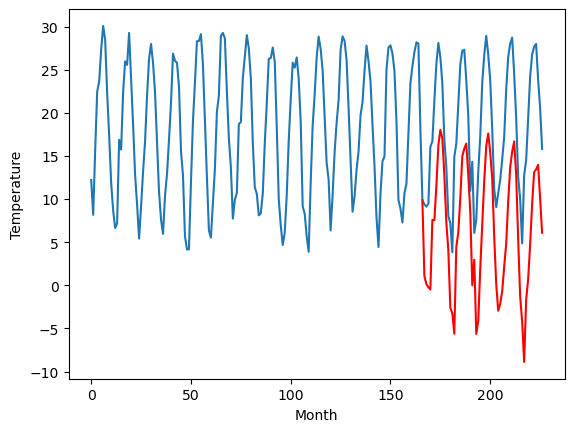

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		0.04		0.99
-1.85		-0.74		1.11
-2.23		-0.75		1.48
-1.48		-0.30		1.18
4.35		6.28		1.93
4.84		6.20		1.36
7.61		9.07		1.46
11.36		12.55		1.19
11.84		14.45		2.61
12.47		14.11		1.64
9.49		11.12		1.63
6.86		7.41		0.55
3.44		3.49		0.05
-3.77		-2.90		0.87
-3.11		-2.99		0.12
-3.20		-2.84		0.36
1.86		3.37		1.51
3.26		5.23		1.97
7.28		8.99		1.71
10.76		12.36		1.60
11.98		13.39		1.41
12.32		14.02		1.70
10.19		10.79		0.60
7.56		7.51		-0.05
2.05		-0.25		-2.30
1.81		3.07		1.26
-4.87		-3.95		0.92
-2.10		-1.77		0.33
1.76		2.68		0.92
4.73		6.90		2.17
9.04		10.85		1.81
12.73		14.27		1.54
12.87		15.15		2.28
12.32		13.62		1.30
11.30		11.19		-0.11
5.70		5.22		-0.48
3.01		1.64		-1.37
-0.84		-1.18		-0.34
-0.05		-0.42		-0.37
1.05		1.25		0.20
2.64		3.53		0.89
4.79		5.42		0.63
7.97		8.56		0.59
11.05		12.09		1.04
12.88		14.59		1.71
14.47		15.53		1.06
11.09		11.98		0.89
5.98		5.97		-0.01
0.74		-0.07		-0.81
-1.96		-

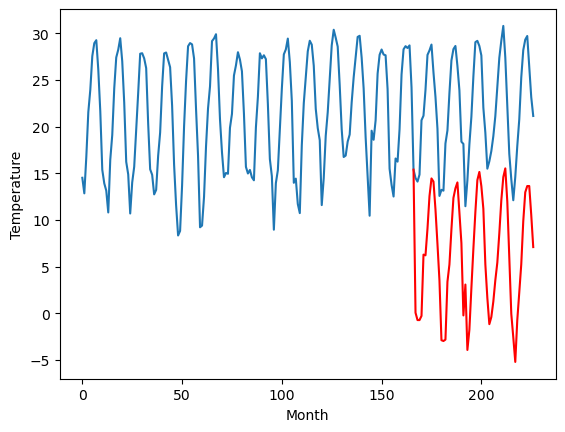

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.82		1.28
-3.21		-2.69		0.52
-3.83		-2.87		0.96
-3.21		-2.72		0.49
3.04		4.20		1.16
2.80		4.23		1.43
6.49		7.70		1.21
10.21		11.94		1.73
12.58		14.03		1.45
11.82		13.17		1.35
8.43		9.75		1.32
4.71		5.35		0.64
-0.22		1.64		1.86
-7.22		-4.99		2.23
-6.40		-5.51		0.89
-5.54		-6.16		-0.62
0.44		1.38		0.94
2.08		3.48		1.40
6.06		7.42		1.36
10.20		11.50		1.30
11.96		12.43		0.47
12.24		13.11		0.87
8.67		9.50		0.83
4.79		6.07		1.28
-3.57		-2.45		1.12
-1.39		0.55		1.94
-7.40		-7.21		0.19
-3.45		-4.78		-1.33
0.05		0.19		0.14
2.79		4.58		1.79
8.55		9.40		0.85
12.33		12.98		0.65
13.25		14.02		0.77
12.02		12.43		0.41
8.90		9.60		0.70
1.76		3.31		1.55
-0.72		-0.47		0.25
-5.24		-3.97		1.27
-3.29		-3.02		0.27
-0.51		-1.52		-1.01
-0.53		0.68		1.21
2.54		3.39		0.85
5.95		6.95		1.00
9.27		10.68		1.41
12.37		13.12		0.75
11.98		13.73		1.75
8.53		10.22		1.69
2.55		4.00		1.45
-2.54		-2.52		0.02
-5.57		-4.90

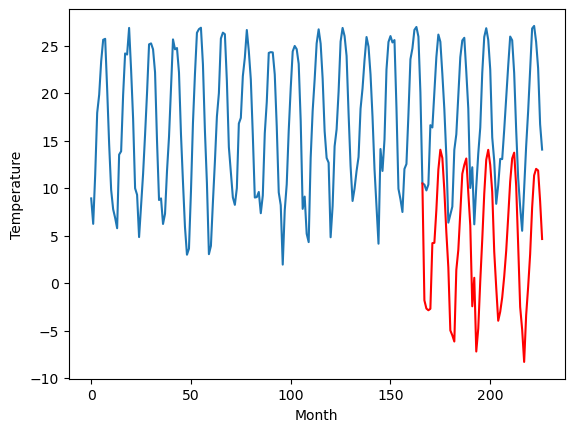

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-2.21		0.28
-2.51		-3.00		-0.49
-2.47		-3.10		-0.63
-2.47		-3.07		-0.60
4.45		4.54		0.09
4.53		4.30		-0.23
7.42		7.55		0.13
10.33		11.38		1.05
11.30		13.03		1.73
11.64		12.54		0.90
9.31		8.89		-0.42
5.25		4.34		-0.91
2.41		0.86		-1.55
-5.05		-5.63		-0.58
-4.96		-5.87		-0.91
-6.53		-7.10		-0.57
1.38		1.22		-0.16
3.17		2.69		-0.48
7.14		6.48		-0.66
10.42		10.37		-0.05
11.05		11.35		0.30
11.10		11.98		0.88
8.59		8.67		0.08
6.28		4.87		-1.41
-1.81		-3.00		-1.19
0.96		0.57		-0.39
-6.39		-7.36		-0.97
-3.95		-5.92		-1.97
-0.16		-0.58		-0.42
4.63		4.35		-0.28
9.15		8.53		-0.62
11.58		12.23		0.65
11.56		13.38		1.82
10.37		11.31		0.94
9.13		8.74		-0.39
3.51		2.39		-1.12
-0.60		-2.42		-1.82
-2.78		-4.87		-2.09
-1.34		-4.23		-2.89
-0.93		-2.59		-1.66
2.59		0.25		-2.34
4.01		1.97		-2.04
8.44		6.17		-2.27
12.19		9.94		-2.25
13.31		11.91		-1.40
14.84		13.33		-1.51
11.40		9.45		-1.95
5.15		2.47		-2.68

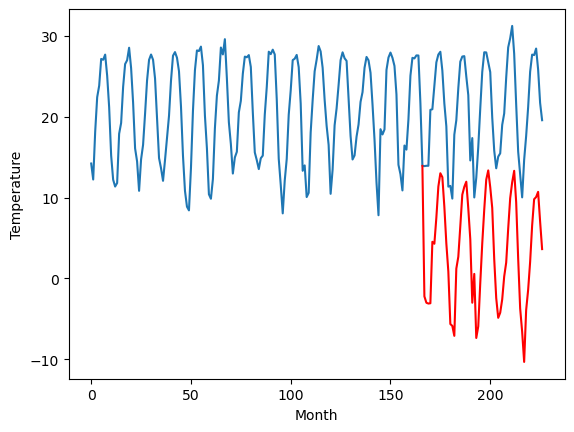

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		5.22		-0.10
3.27		4.19		0.92
4.01		3.87		-0.14
3.34		3.61		0.27
11.09		12.01		0.92
11.34		11.99		0.65
16.32		15.95		-0.37
20.52		20.39		-0.13
22.13		21.89		-0.24
22.62		21.28		-1.34
16.91		16.75		-0.16
12.03		10.96		-1.07
9.51		7.88		-1.63
3.04		1.39		-1.65
2.16		0.98		-1.18
-0.93		-1.82		-0.89
8.97		8.70		-0.27
10.90		10.12		-0.78
14.76		14.08		-0.68
19.96		18.94		-1.02
20.39		19.95		-0.44
21.15		20.32		-0.83
19.14		16.83		-2.31
14.79		12.07		-2.72
7.22		4.25		-2.97
9.55		7.06		-2.49
1.10		-1.26		-2.36
0.87		-0.48		-1.35
7.36		5.84		-1.52
13.40		11.29		-2.11
18.11		15.99		-2.12
22.45		20.19		-2.26
24.81		21.78		-3.03
22.45		19.34		-3.11
19.50		16.45		-3.05
13.58		9.58		-4.00
6.65		3.07		-3.58
3.92		0.65		-3.27
4.89		1.24		-3.65
5.02		2.72		-2.30
9.74		6.05		-3.69
11.24		8.25		-2.99
16.77		13.76		-3.01
21.32		17.70		-3.62
24.31		19.30		-5.01
26.05		20.99		-5.06
21.57		16.81		-4.76
13.91

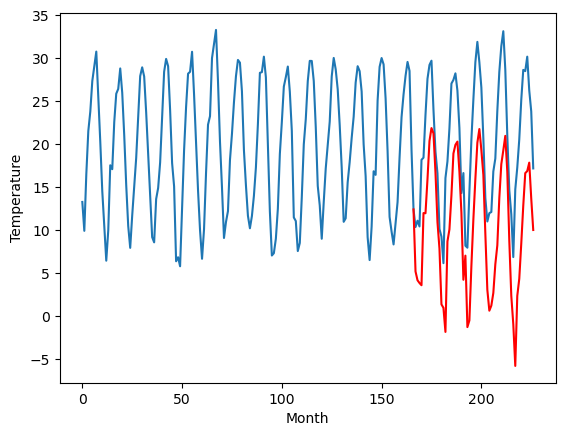

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		5.93		0.08
5.28		4.85		-0.43
4.75		4.66		-0.09
4.44		4.99		0.55
8.03		11.19		3.16
10.00		11.62		1.62
13.69		15.30		1.61
18.04		19.74		1.70
21.78		22.17		0.39
20.93		21.18		0.25
17.90		17.88		-0.02
13.81		13.56		-0.25
9.69		9.50		-0.19
2.94		2.99		0.05
1.16		2.36		1.20
1.81		2.20		0.39
6.71		8.78		2.07
10.08		11.49		1.41
13.59		15.50		1.91
18.16		19.72		1.56
20.15		20.78		0.63
20.63		21.35		0.72
17.62		17.57		-0.05
14.02		14.15		0.13
5.85		5.50		-0.35
6.90		7.62		0.72
0.52		0.44		-0.08
4.13		3.42		-0.71
8.05		8.06		0.01
10.92		11.99		1.07
15.55		17.08		1.53
19.12		20.67		1.55
21.26		21.75		0.49
20.41		20.64		0.23
17.76		17.63		-0.13
11.20		11.32		0.12
9.51		7.93		-1.58
2.99		3.85		0.86
4.68		4.99		0.31
6.17		6.22		0.05
7.08		8.06		0.98
11.76		11.52		-0.24
13.28		14.68		1.40
17.10		18.31		1.21
20.93		21.28		0.35
20.45		21.26		0.81
16.93		17.96		1.03
12.58		12.31		-0.27
7.14		5.56		-1.58
5

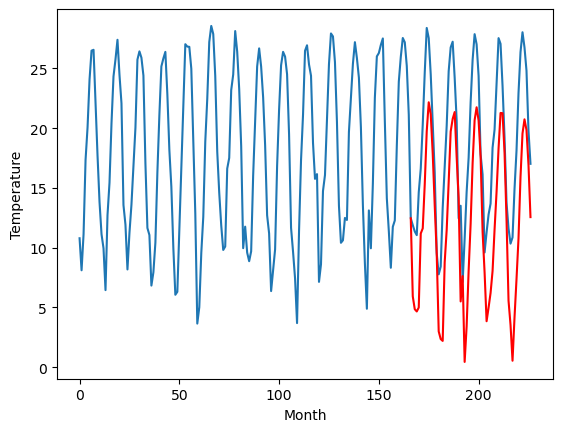

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		0.30		1.50
-1.56		-0.72		0.84
-2.03		-0.98		1.05
-0.92		-0.80		0.12
4.50		5.78		1.28
5.74		6.12		0.38
8.08		9.91		1.83
13.33		14.52		1.19
16.40		16.87		0.47
15.37		15.78		0.41
11.48		12.31		0.83
7.48		7.73		0.25
3.30		3.86		0.56
-3.63		-2.75		0.88
-4.21		-3.45		0.76
-3.57		-4.06		-0.49
3.41		3.31		-0.10
4.44		5.87		1.43
8.15		9.91		1.76
12.48		14.32		1.84
14.10		15.29		1.19
14.04		15.91		1.87
9.99		12.09		2.10
6.76		8.59		1.83
-1.89		-0.21		1.68
0.05		2.11		2.06
-6.60		-5.49		1.11
-2.62		-2.67		-0.05
1.72		2.28		0.56
4.64		6.42		1.78
9.71		11.68		1.97
13.62		15.33		1.71
14.72		16.43		1.71
13.43		15.11		1.68
10.37		12.07		1.70
3.43		5.65		2.22
1.20		2.01		0.81
-5.31		-2.05		3.26
-2.12		-0.93		1.19
0.88		0.35		-0.53
1.36		2.31		0.95
4.92		5.74		0.82
7.61		9.21		1.60
10.96		12.94		1.98
14.67		15.67		1.00
13.98		15.80		1.82
10.47		12.45		1.98
5.26		6.49		1.23
-0.61		-0.29		0.32
-2.90		-2.4

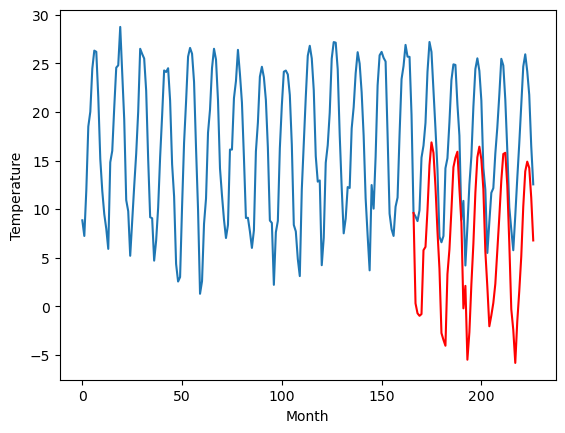

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.34		1.33
3.64		4.22		0.58
3.52		3.90		0.38
4.56		3.99		-0.57
10.14		10.54		0.40
11.04		11.02		-0.02
14.16		15.15		0.99
19.68		20.16		0.48
22.94		22.69		-0.25
21.57		21.34		-0.23
16.70		17.69		0.99
12.86		12.80		-0.06
8.63		8.95		0.32
1.70		2.26		0.56
0.76		1.31		0.55
1.38		0.45		-0.93
7.90		8.20		0.30
11.53		11.02		-0.51
14.55		15.16		0.61
19.34		19.93		0.59
21.46		20.90		-0.56
21.41		21.52		0.11
16.90		17.46		0.56
13.05		13.88		0.83
3.55		4.69		1.14
5.61		6.63		1.02
-1.57		-1.16		0.41
2.67		1.93		-0.74
7.51		7.04		-0.47
10.83		11.14		0.31
15.81		16.86		1.05
19.81		20.58		0.77
21.68		21.79		0.11
20.00		20.58		0.58
16.30		17.28		0.98
9.11		10.72		1.61
6.91		7.07		0.16
-0.26		2.56		2.82
2.91		3.81		0.90
5.88		4.92		-0.96
6.56		6.77		0.21
11.18		10.77		-0.41
13.47		14.33		0.86
17.22		18.12		0.90
21.36		20.97		-0.39
20.22		20.79		0.57
16.46		17.50		1.04
11.07		11.58		0.51
4.62		4.49		-0.1

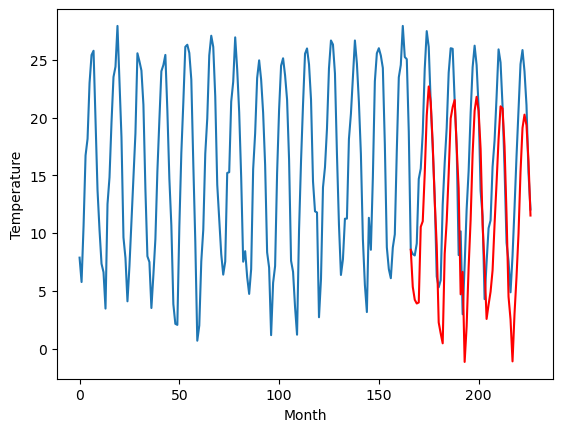

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.17		0.69
4.32		3.98		-0.34
3.13		3.35		0.22
3.63		2.93		-0.70
10.20		11.08		0.88
12.48		11.44		-1.04
17.36		16.19		-1.17
23.29		21.78		-1.51
26.03		23.81		-2.22
23.02		22.35		-0.67
19.46		17.59		-1.87
12.20		11.18		-1.02
9.34		8.18		-1.16
2.63		1.33		-1.30
1.84		0.25		-1.59
-2.43		-2.92		-0.49
10.04		8.38		-1.66
12.64		10.58		-2.06
17.33		14.84		-2.49
23.52		20.60		-2.92
24.09		21.44		-2.65
24.03		21.88		-2.15
20.29		17.77		-2.52
16.33		13.09		-3.24
6.29		3.99		-2.30
8.09		5.84		-2.25
-0.42		-3.03		-2.61
1.62		-1.17		-2.79
8.84		5.36		-3.48
12.79		10.49		-2.30
19.63		16.63		-3.00
24.15		20.91		-3.24
26.48		22.57		-3.91
23.60		20.48		-3.12
19.96		16.97		-2.99
13.40		9.80		-3.60
7.43		3.95		-3.48
2.14		-0.12		-2.26
4.70		0.92		-3.78
6.31		2.11		-4.20
8.13		4.83		-3.30
13.91		8.75		-5.16
19.50		14.17		-5.33
23.37		18.22		-5.15
24.86		20.10		-4.76
23.60		20.81		-2.79
20.43		17.02		-3.41
1

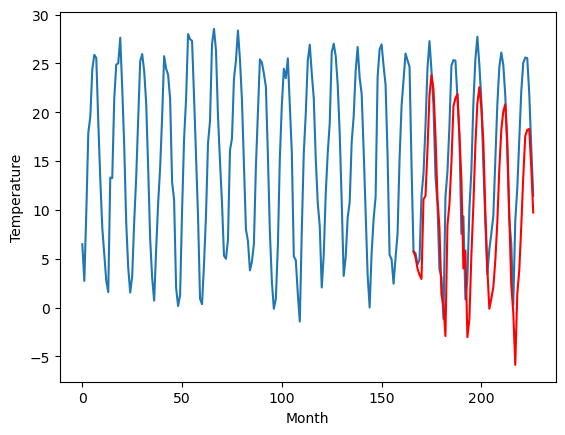

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		1.49		1.75
-0.08		0.33		0.41
-1.36		-0.29		1.07
-2.23		-0.59		1.64
4.96		6.66		1.70
6.62		7.22		0.60
11.71		12.08		0.37
18.69		18.05		-0.64
21.32		20.68		-0.64
18.94		18.75		-0.19
15.27		14.45		-0.82
8.88		8.54		-0.34
5.20		5.15		-0.05
-2.31		-1.87		0.44
-3.90		-3.31		0.59
-6.07		-5.43		0.64
4.68		4.49		-0.19
7.74		7.42		-0.32
12.21		11.77		-0.44
18.69		17.48		-1.21
19.70		18.26		-1.44
20.30		18.89		-1.41
16.44		14.43		-2.01
11.97		10.49		-1.48
1.31		0.50		-0.81
2.54		2.08		-0.46
-6.43		-6.73		-0.30
-2.85		-3.57		-0.72
4.13		2.36		-1.77
6.86		6.80		-0.06
15.03		13.54		-1.49
18.93		17.51		-1.42
20.96		18.93		-2.03
19.05		17.46		-1.59
15.32		13.70		-1.62
8.28		6.70		-1.58
3.26		2.50		-0.76
-2.45		-2.70		-0.25
-0.56		-1.31		-0.75
1.48		-0.32		-1.80
1.82		1.59		-0.23
8.10		6.41		-1.69
13.06		10.75		-2.31
16.90		14.76		-2.14
19.73		17.29		-2.44
18.93		16.95		-1.98
16.32		13.65		-2.67
9.74	

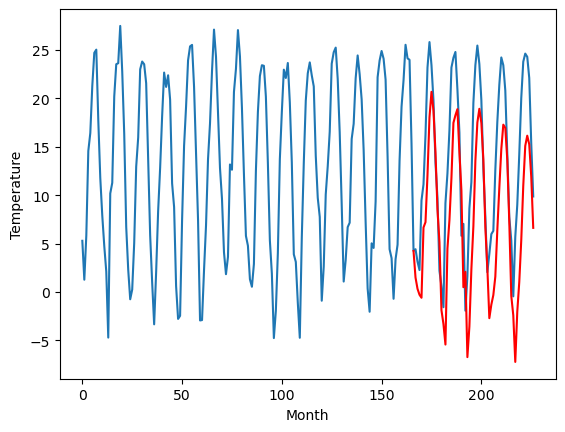

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		-0.71		0.79
-2.17		-2.16		0.01
-3.20		-2.99		0.21
-4.66		-3.39		1.27
1.48		3.80		2.32
4.13		4.77		0.64
10.56		10.30		-0.26
18.52		17.02		-1.50
21.68		19.89		-1.79
18.99		17.58		-1.41
14.16		12.88		-1.28
7.41		6.24		-1.17
3.93		2.91		-1.02
-3.10		-4.19		-1.09
-4.71		-5.99		-1.28
-9.02		-8.69		0.33
2.71		2.01		-0.70
6.68		5.46		-1.22
11.83		10.03		-1.80
19.14		16.51		-2.63
19.73		17.29		-2.44
20.44		17.78		-2.66
16.39		12.94		-3.45
12.04		8.62		-3.42
1.18		-1.83		-3.01
0.28		-1.39		-1.67
-8.67		-10.28		-1.61
-5.43		-6.80		-1.37
1.48		-0.50		-1.98
5.09		3.81		-1.28
14.41		11.42		-2.99
19.17		15.64		-3.53
20.28		17.24		-3.04
19.16		15.99		-3.17
15.32		11.80		-3.52
8.08		4.48		-3.60
3.05		-0.05		-3.10
-3.13		-6.08		-2.95
-2.00		-4.48		-2.48
-1.59		-3.83		-2.24
0.27		-2.08		-2.35
7.12		3.89		-3.23
12.14		8.59		-3.55
17.65		12.67		-4.98
20.11		15.31		-4.80
18.30		14.50		-3.80
15.92		11.32		-

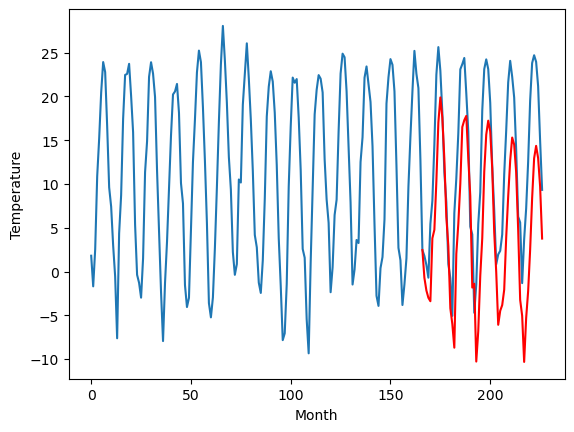

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[1.063567733764648, 0.04476224899292003, -1.8217380142211912, -2.2139267539978027, 5.217848262786866, 5.928610343933105, 0.3032294845581056, 5.341120223999024, 5.168892669677735, 1.4916077041625968, -0.7085823059082035]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.063568
1                 1   -0.95   0.044762
2                 2   -3.10  -1.821738
3                 3   -2.49  -2.213927
4                 4    5.32   5.217848
5                 5    5.85   5.928610
6                 6   -1.20   0.303229
7                 7    4.01   5.341120
8                 8    4.48   5.168893
9                 9   -0.26   1.491608
10               10   -1.50  -0.708582


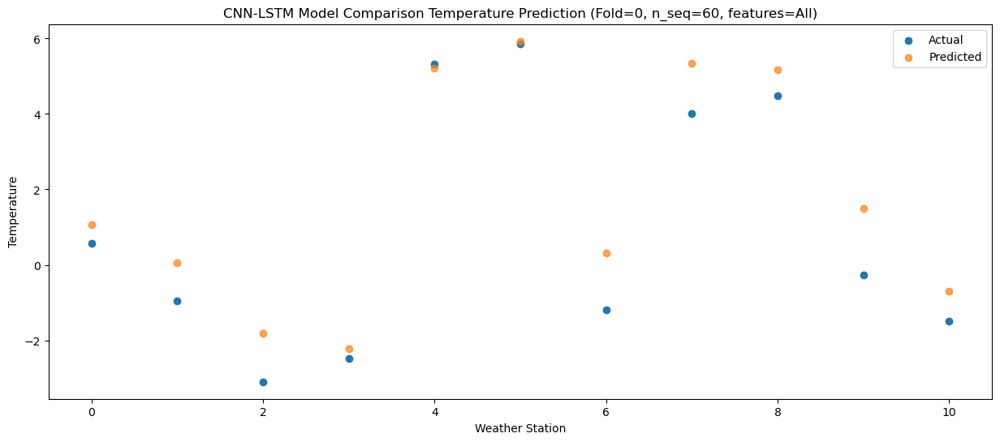

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11   0.137009
1                 1   -1.85  -0.743969
2                 2   -3.21  -2.685994
3                 3   -2.51  -3.000961
4                 4    3.27   4.192071
5                 5    5.28   4.851147
6                 6   -1.56  -0.718255
7                 7    3.64   4.223314
8                 8    4.32   3.982450
9                 9   -0.08   0.330010
10               10   -2.17  -2.158798


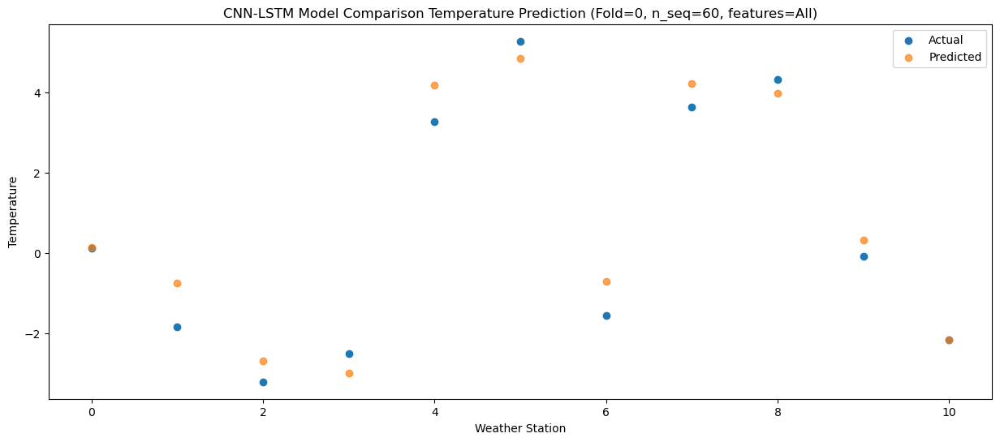

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -0.210169
1                 1   -2.23  -0.745205
2                 2   -3.83  -2.866040
3                 3   -2.47  -3.100416
4                 4    4.01   3.870057
5                 5    4.75   4.664154
6                 6   -2.03  -0.977433
7                 7    3.52   3.901174
8                 8    3.13   3.354435
9                 9   -1.36  -0.286020
10               10   -3.20  -2.992750


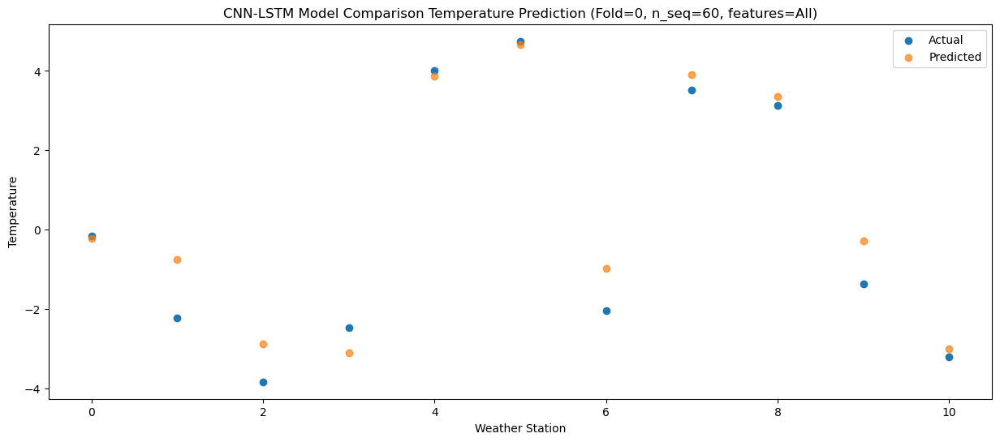

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -0.483958
1                 1   -1.48  -0.296644
2                 2   -3.21  -2.715917
3                 3   -2.47  -3.066323
4                 4    3.34   3.614180
5                 5    4.44   4.993075
6                 6   -0.92  -0.797188
7                 7    4.56   3.989323
8                 8    3.63   2.927840
9                 9   -2.23  -0.594493
10               10   -4.66  -3.388948


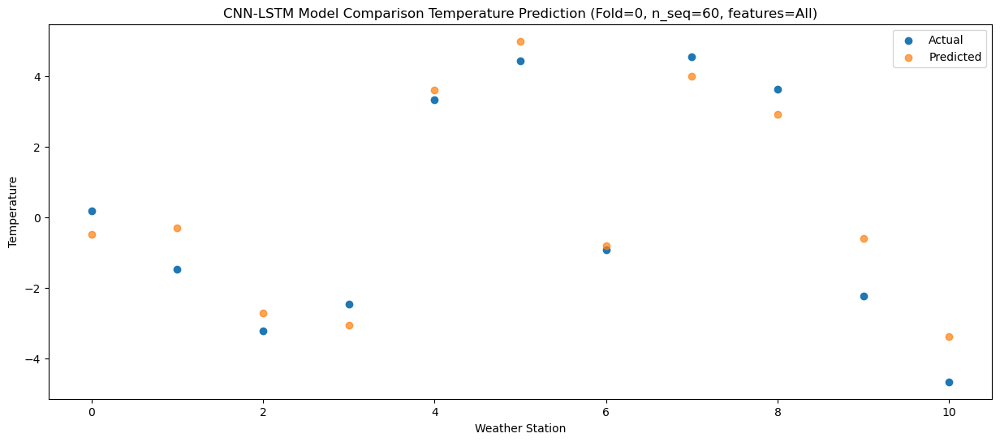

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   7.584295
1                 1    4.35   6.276546
2                 2    3.04   4.198819
3                 3    4.45   4.542029
4                 4   11.09  12.008235
5                 5    8.03  11.187459
6                 6    4.50   5.779452
7                 7   10.14  10.539344
8                 8   10.20  11.082579
9                 9    4.96   6.662695
10               10    1.48   3.802383


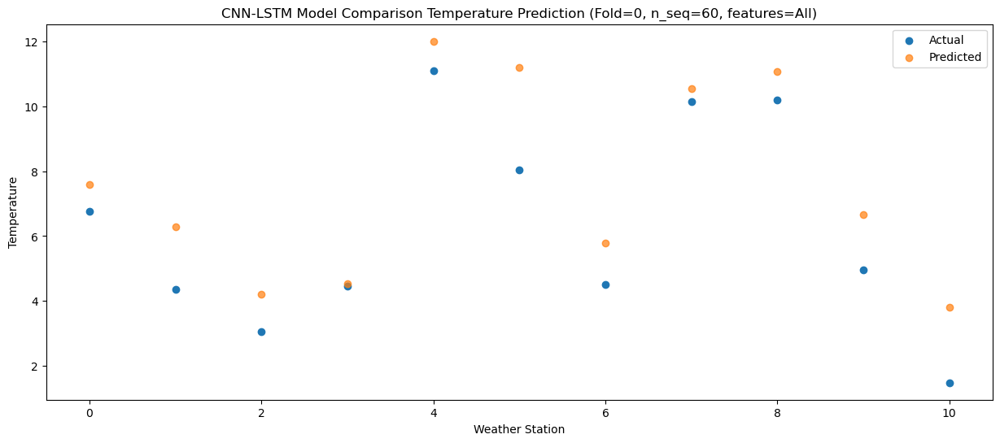

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   7.544404
1                 1    4.84   6.201555
2                 2    2.80   4.233726
3                 3    4.53   4.301214
4                 4   11.34  11.985462
5                 5   10.00  11.617510
6                 6    5.74   6.115807
7                 7   11.04  11.016578
8                 8   12.48  11.438539
9                 9    6.62   7.216316
10               10    4.13   4.771069


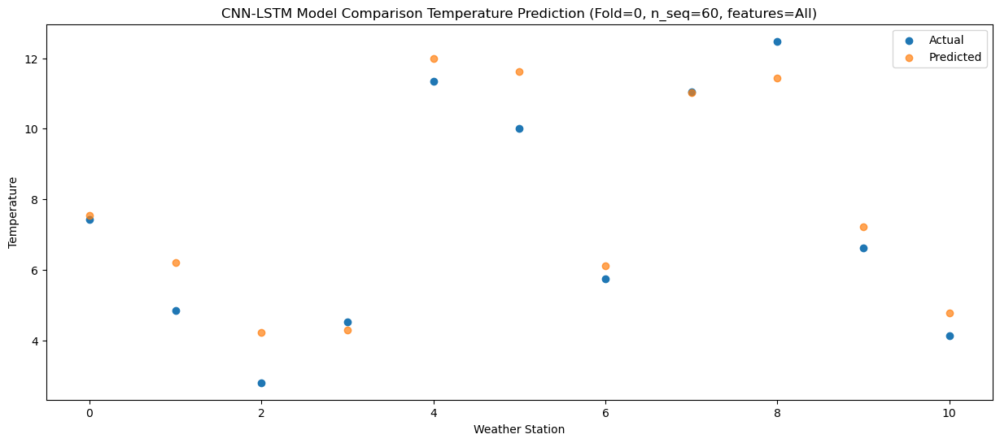

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  11.538797
1                 1    7.61   9.071482
2                 2    6.49   7.696800
3                 3    7.42   7.553178
4                 4   16.32  15.948071
5                 5   13.69  15.302332
6                 6    8.08   9.911199
7                 7   14.16  15.152419
8                 8   17.36  16.185990
9                 9   11.71  12.082980
10               10   10.56  10.296772


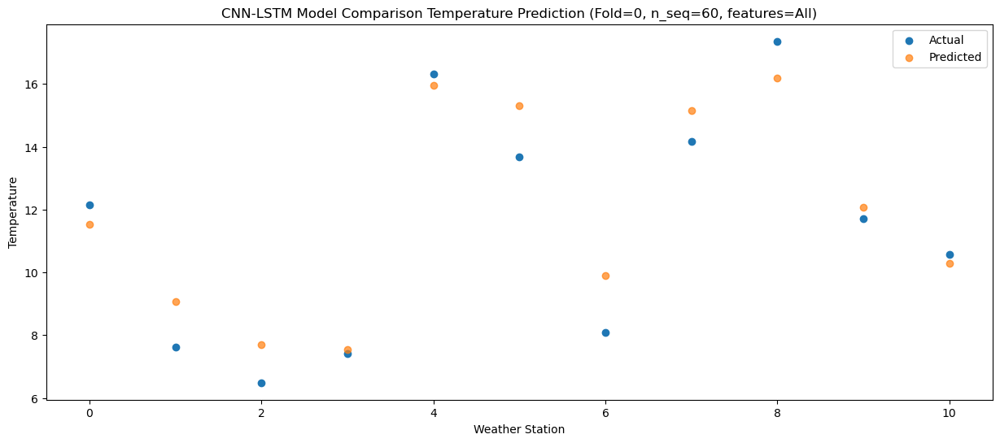

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  16.226307
1                 1   11.36  12.546146
2                 2   10.21  11.944754
3                 3   10.33  11.377983
4                 4   20.52  20.393938
5                 5   18.04  19.736913
6                 6   13.33  14.518821
7                 7   19.68  20.161889
8                 8   23.29  21.782793
9                 9   18.69  18.050596
10               10   18.52  17.019017


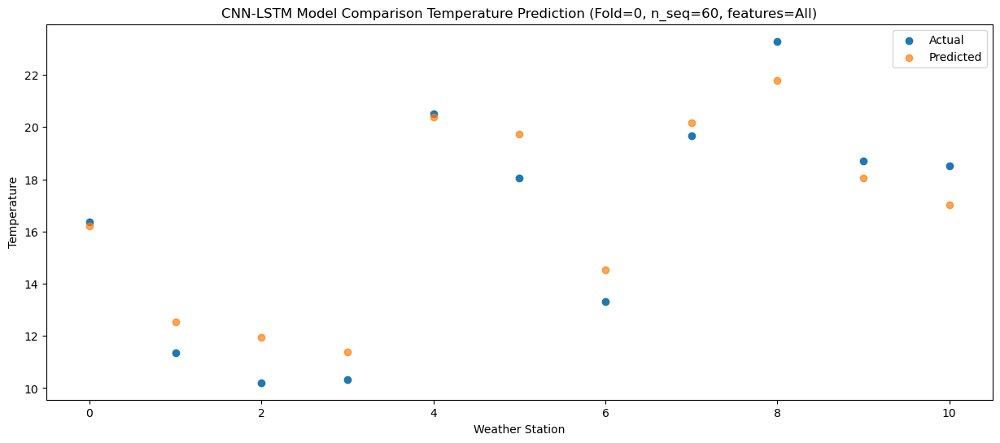

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  18.026584
1                 1   11.84  14.449148
2                 2   12.58  14.031606
3                 3   11.30  13.026730
4                 4   22.13  21.893930
5                 5   21.78  22.169477
6                 6   16.40  16.867908
7                 7   22.94  22.689479
8                 8   26.03  23.808357
9                 9   21.32  20.680778
10               10   21.68  19.891444


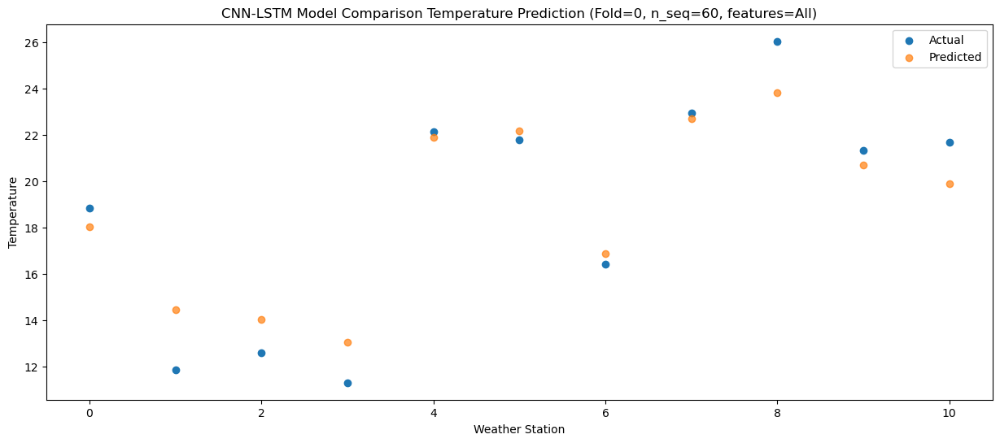

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  17.046367
1                 1   12.47  14.112714
2                 2   11.82  13.166964
3                 3   11.64  12.544088
4                 4   22.62  21.281378
5                 5   20.93  21.176327
6                 6   15.37  15.784927
7                 7   21.57  21.336210
8                 8   23.02  22.354128
9                 9   18.94  18.746572
10               10   18.99  17.576076


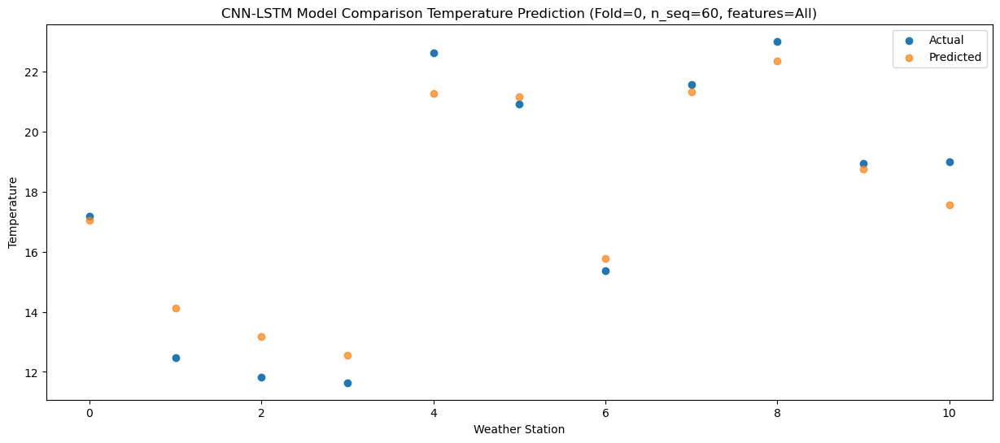

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  12.774338
1                 1    9.49  11.123216
2                 2    8.43   9.752515
3                 3    9.31   8.888624
4                 4   16.91  16.748948
5                 5   17.90  17.882935
6                 6   11.48  12.313223
7                 7   16.70  17.687054
8                 8   19.46  17.588499
9                 9   15.27  14.450883
10               10   14.16  12.875978


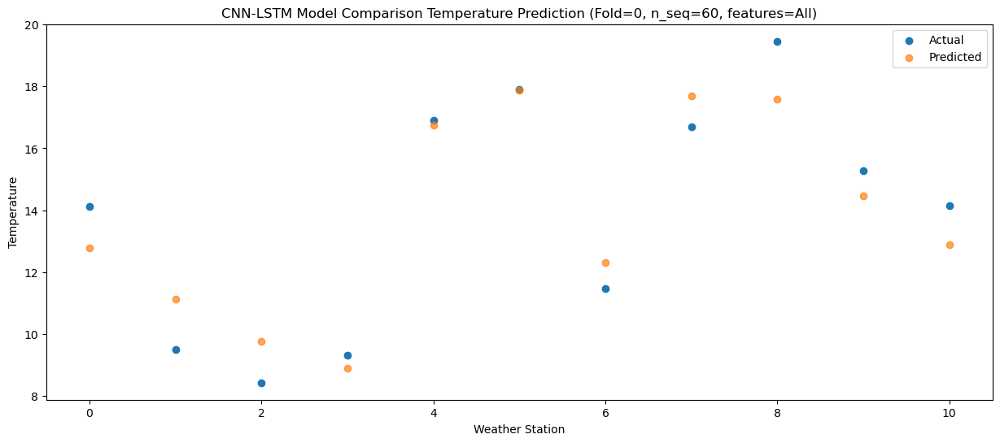

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   7.256017
1                 1    6.86   7.413270
2                 2    4.71   5.351721
3                 3    5.25   4.335588
4                 4   12.03  10.958740
5                 5   13.81  13.558137
6                 6    7.48   7.732576
7                 7   12.86  12.799213
8                 8   12.20  11.178828
9                 9    8.88   8.536493
10               10    7.41   6.243252


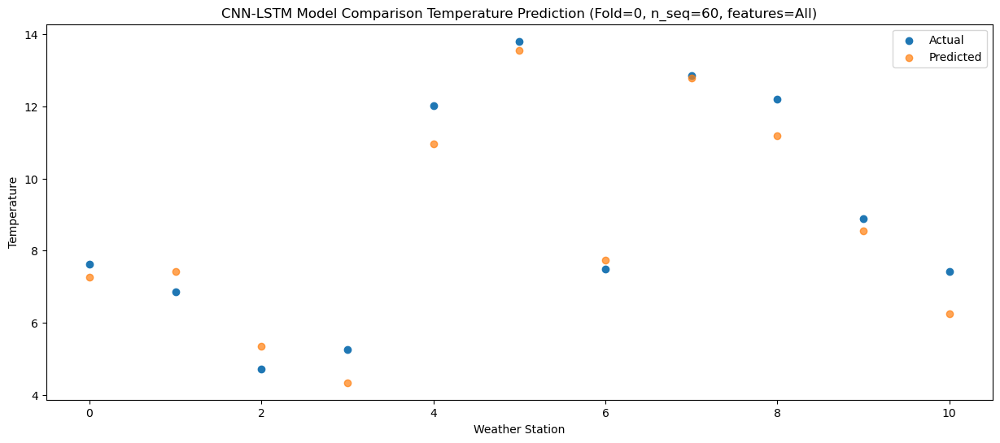

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   4.079226
1                 1    3.44   3.490325
2                 2   -0.22   1.638926
3                 3    2.41   0.860154
4                 4    9.51   7.882895
5                 5    9.69   9.498852
6                 6    3.30   3.864537
7                 7    8.63   8.952597
8                 8    9.34   8.180780
9                 9    5.20   5.146542
10               10    3.93   2.911980


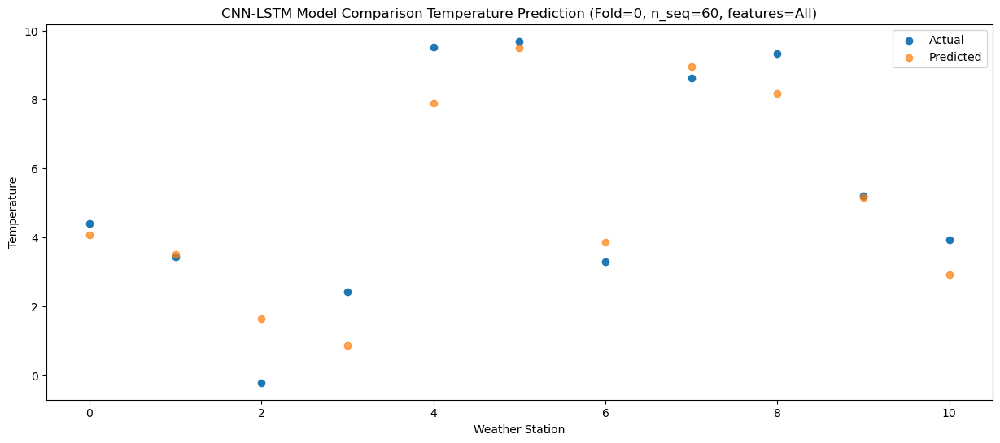

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -2.607715
1                 1   -3.77  -2.903549
2                 2   -7.22  -4.986189
3                 3   -5.05  -5.632663
4                 4    3.04   1.386545
5                 5    2.94   2.993867
6                 6   -3.63  -2.753464
7                 7    1.70   2.256455
8                 8    2.63   1.329454
9                 9   -2.31  -1.871913
10               10   -3.10  -4.187782


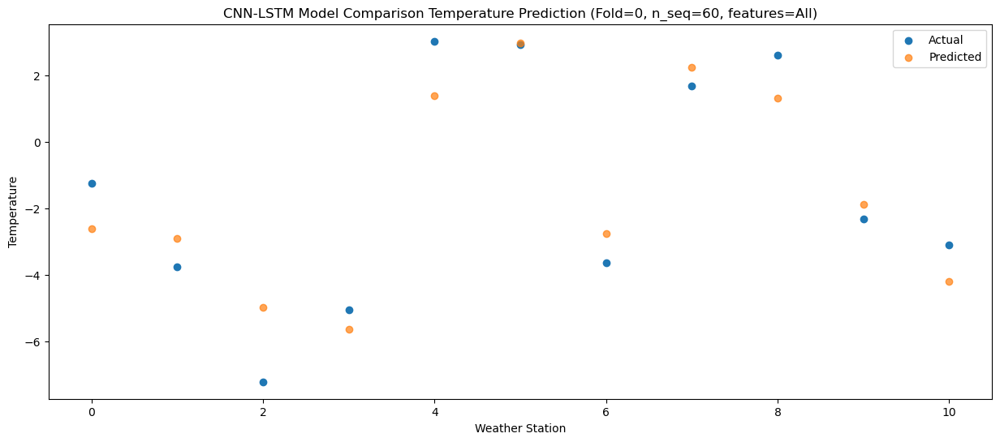

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -3.262628
1                 1   -3.11  -2.989855
2                 2   -6.40  -5.506751
3                 3   -4.96  -5.867045
4                 4    2.16   0.983019
5                 5    1.16   2.355291
6                 6   -4.21  -3.452682
7                 7    0.76   1.310864
8                 8    1.84   0.251428
9                 9   -3.90  -3.306226
10               10   -4.71  -5.988796


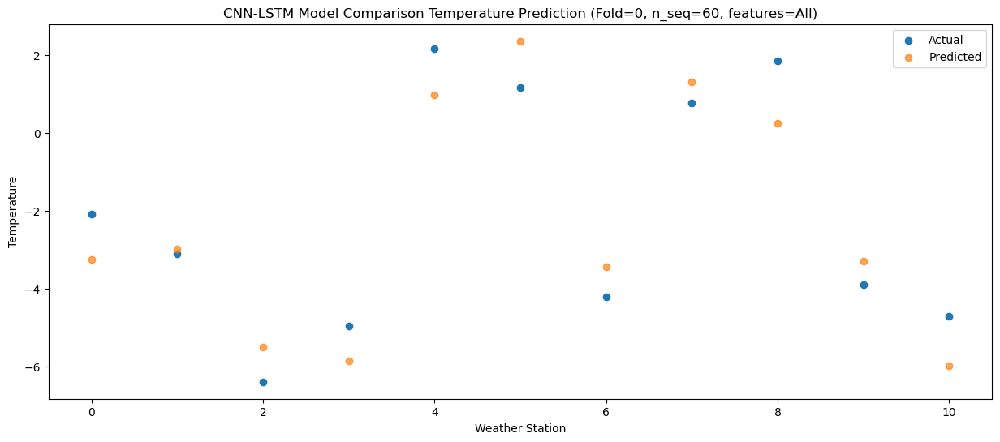

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -5.607142
1                 1   -3.20  -2.839521
2                 2   -5.54  -6.159430
3                 3   -6.53  -7.097219
4                 4   -0.93  -1.817399
5                 5    1.81   2.199437
6                 6   -3.57  -4.057842
7                 7    1.38   0.453623
8                 8   -2.43  -2.915556
9                 9   -6.07  -5.428262
10               10   -9.02  -8.694942


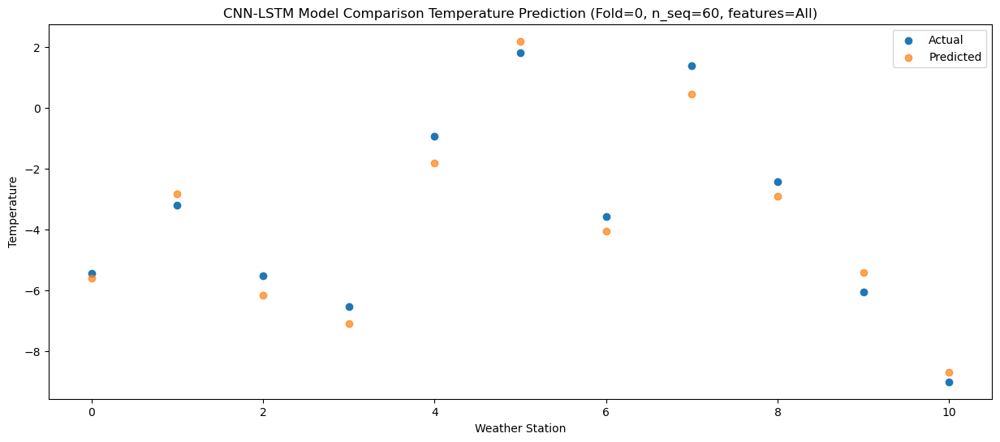

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   4.459757
1                 1    1.86   3.365367
2                 2    0.44   1.378213
3                 3    1.38   1.220436
4                 4    8.97   8.704699
5                 5    6.71   8.781382
6                 6    3.41   3.310669
7                 7    7.90   8.196061
8                 8   10.04   8.384178
9                 9    4.68   4.493255
10               10    2.71   2.013106


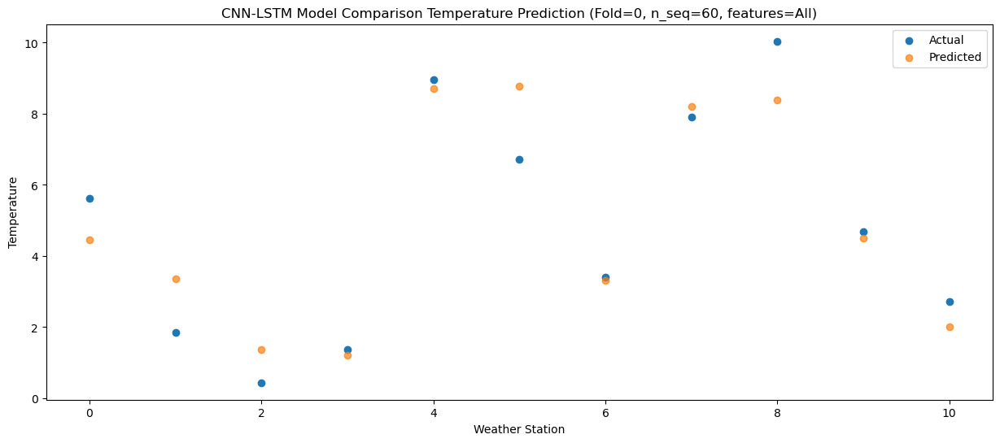

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   6.156347
1                 1    3.26   5.226007
2                 2    2.08   3.483774
3                 3    3.17   2.690464
4                 4   10.90  10.115020
5                 5   10.08  11.485018
6                 6    4.44   5.866572
7                 7   11.53  11.015992
8                 8   12.64  10.583913
9                 9    7.74   7.417401
10               10    6.68   5.460634


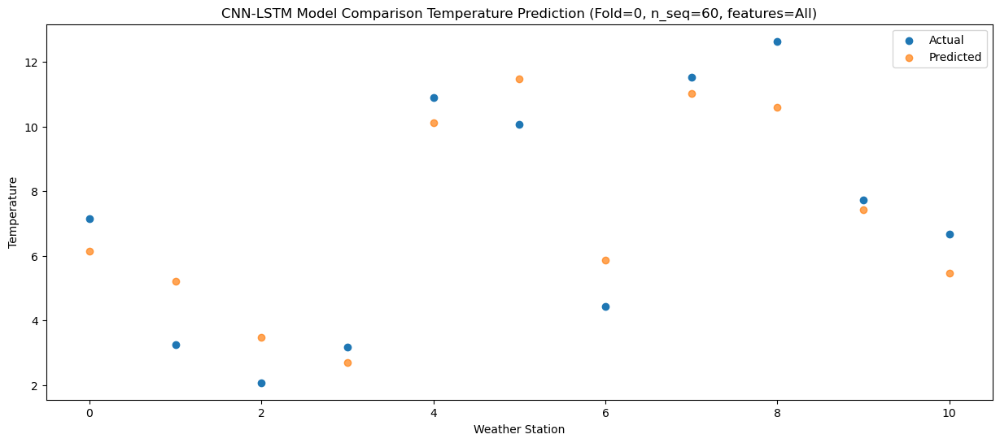

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  10.143612
1                 1    7.28   8.993200
2                 2    6.06   7.417539
3                 3    7.14   6.475652
4                 4   14.76  14.075115
5                 5   13.59  15.503843
6                 6    8.15   9.914186
7                 7   14.55  15.158109
8                 8   17.33  14.837259
9                 9   12.21  11.767620
10               10   11.83  10.031918


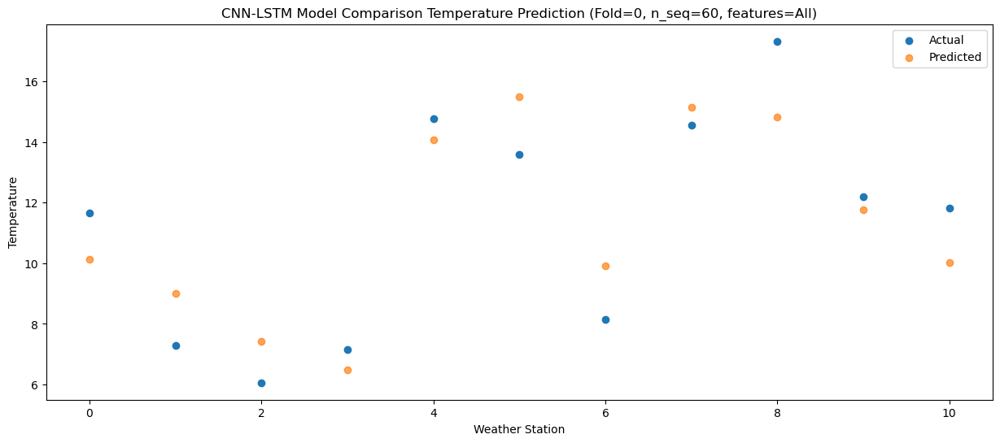

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  14.969555
1                 1   10.76  12.358022
2                 2   10.20  11.495630
3                 3   10.42  10.370903
4                 4   19.96  18.937841
5                 5   18.16  19.722768
6                 6   12.48  14.316172
7                 7   19.34  19.930074
8                 8   23.52  20.596241
9                 9   18.69  17.476903
10               10   19.14  16.511661


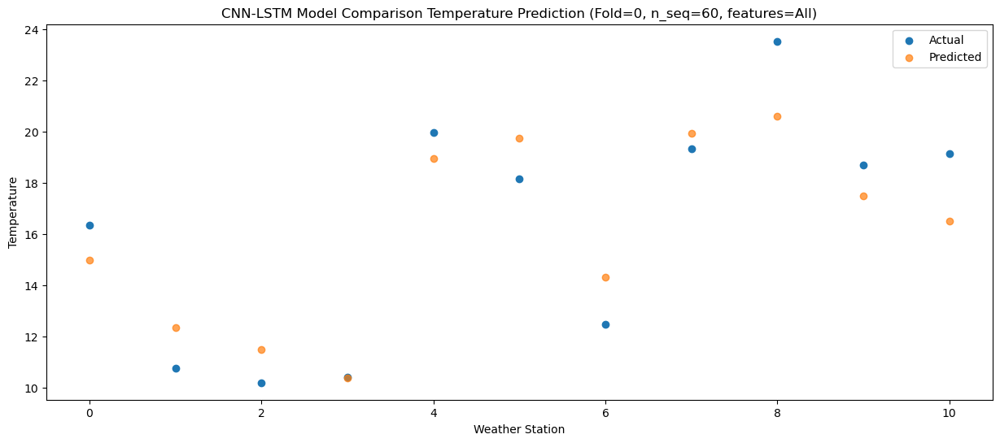

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  15.859361
1                 1   11.98  13.387741
2                 2   11.96  12.430953
3                 3   11.05  11.345035
4                 4   20.39  19.945609
5                 5   20.15  20.780259
6                 6   14.10  15.291917
7                 7   21.46  20.904998
8                 8   24.09  21.443037
9                 9   19.70  18.258735
10               10   19.73  17.294907


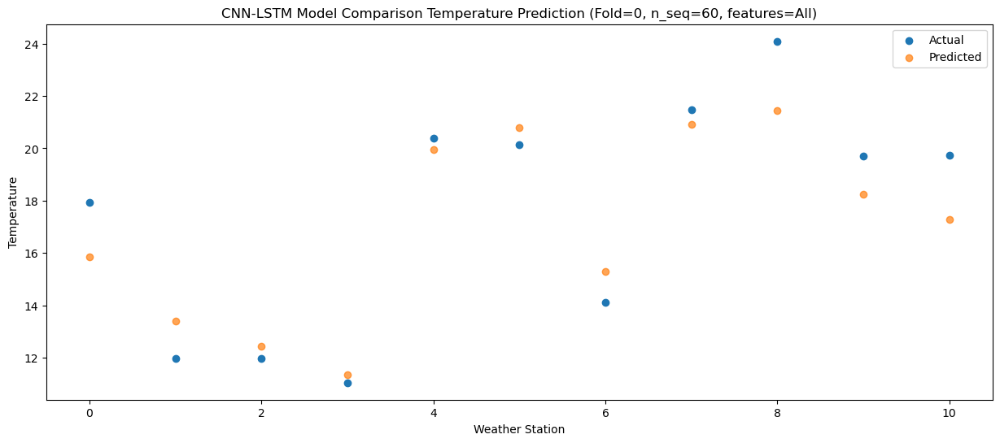

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  16.436383
1                 1   12.32  14.022257
2                 2   12.24  13.113618
3                 3   11.10  11.979626
4                 4   21.15  20.319241
5                 5   20.63  21.350458
6                 6   14.04  15.907635
7                 7   21.41  21.516248
8                 8   24.03  21.882223
9                 9   20.30  18.892902
10               10   20.44  17.783654


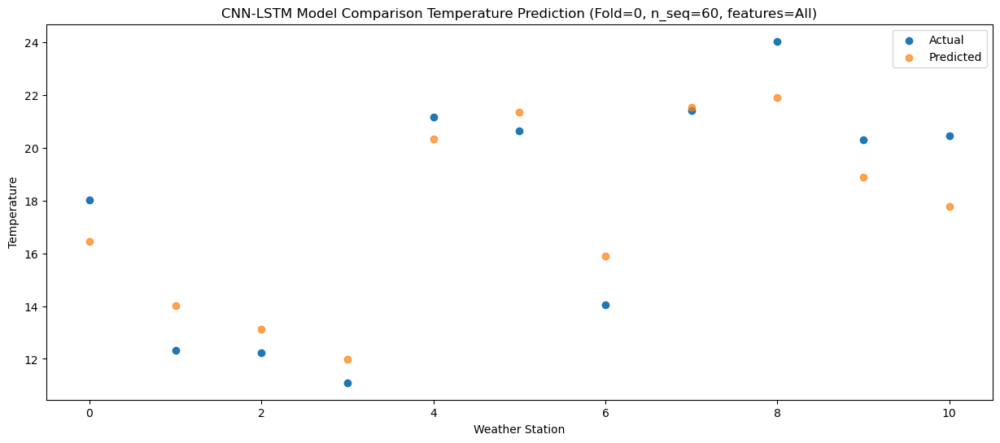

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  12.743349
1                 1   10.19  10.787252
2                 2    8.67   9.503636
3                 3    8.59   8.673649
4                 4   19.14  16.829095
5                 5   17.62  17.571795
6                 6    9.99  12.087878
7                 7   16.90  17.462046
8                 8   20.29  17.766276
9                 9   16.44  14.429804
10               10   16.39  12.938705


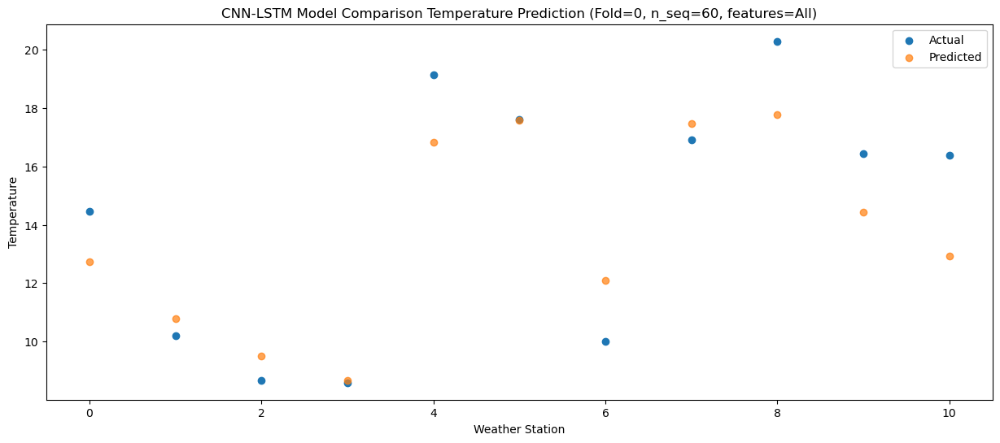

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43   8.498431
1                 1    7.56   7.513434
2                 2    4.79   6.067236
3                 3    6.28   4.866571
4                 4   14.79  12.067790
5                 5   14.02  14.154506
6                 6    6.76   8.592037
7                 7   13.05  13.876300
8                 8   16.33  13.088605
9                 9   11.97  10.492931
10               10   12.04   8.624477


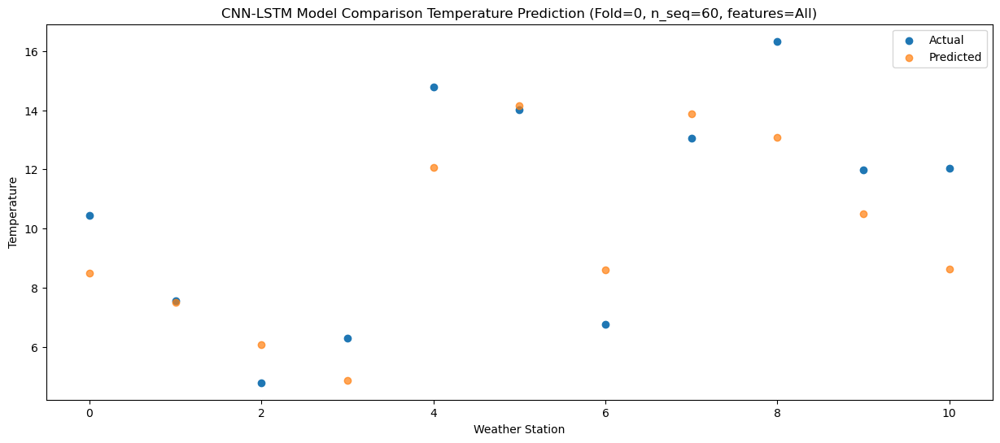

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   0.005312
1                 1    2.05  -0.245421
2                 2   -3.57  -2.449060
3                 3   -1.81  -2.998260
4                 4    7.22   4.249873
5                 5    5.85   5.501401
6                 6   -1.89  -0.210040
7                 7    3.55   4.693480
8                 8    6.29   3.993361
9                 9    1.31   0.497364
10               10    1.18  -1.831646


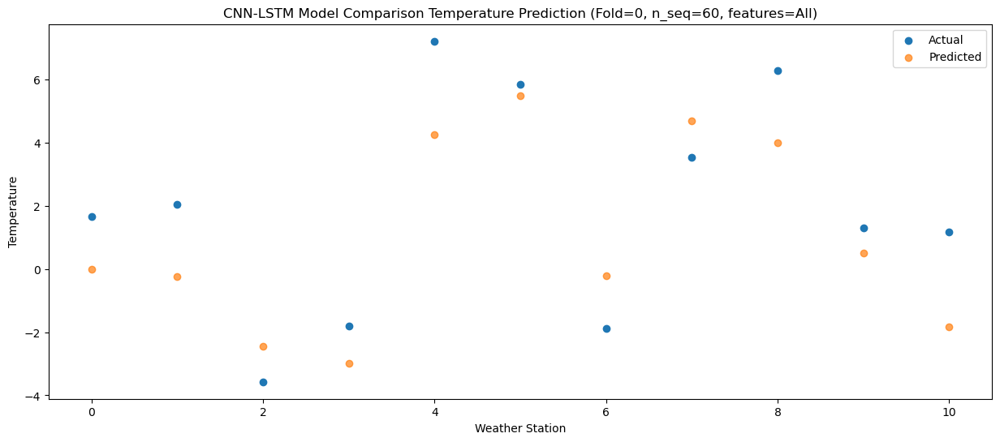

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.964250
1                 1    1.81   3.066465
2                 2   -1.39   0.552905
3                 3    0.96   0.568091
4                 4    9.55   7.055817
5                 5    6.90   7.623190
6                 6    0.05   2.105259
7                 7    5.61   6.633173
8                 8    8.09   5.837403
9                 9    2.54   2.084882
10               10    0.28  -1.392644


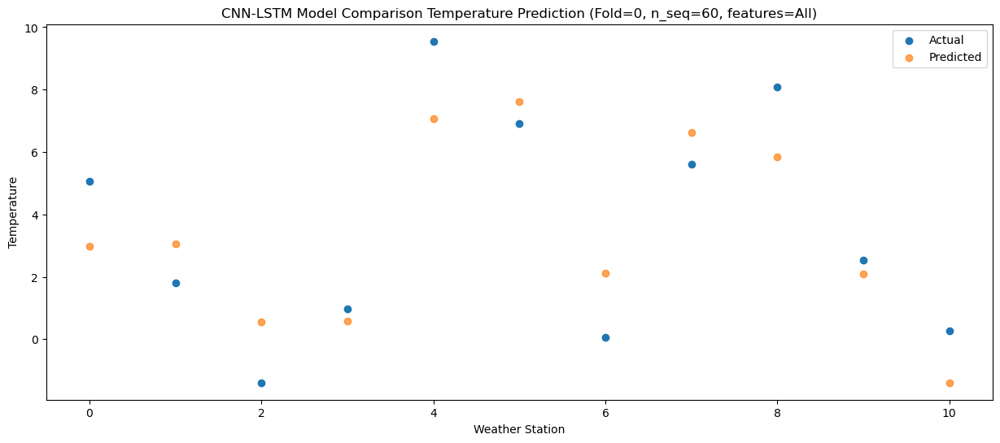

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -5.639033
1                 1   -4.87  -3.950067
2                 2   -7.40  -7.210839
3                 3   -6.39  -7.360685
4                 4    1.10  -1.255205
5                 5    0.52   0.440773
6                 6   -6.60  -5.493994
7                 7   -1.57  -1.157385
8                 8   -0.42  -3.030855
9                 9   -6.43  -6.728029
10               10   -8.67 -10.279553


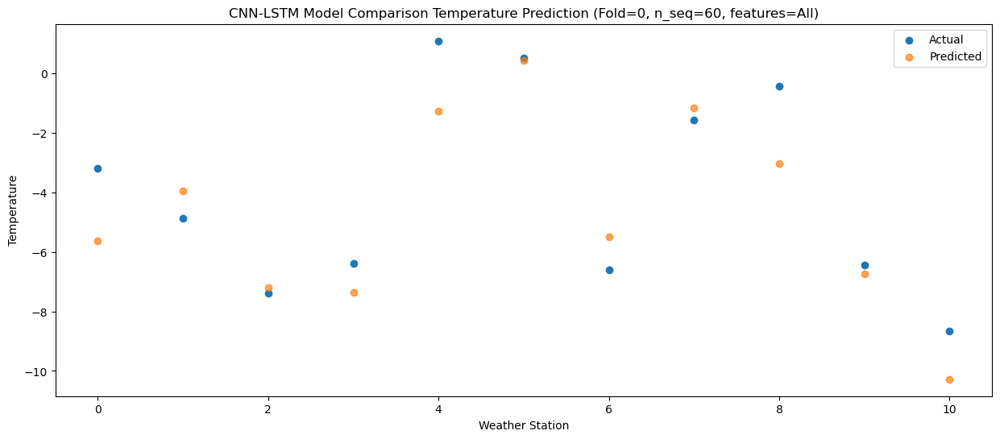

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -4.118831
1                 1   -2.10  -1.771743
2                 2   -3.45  -4.782010
3                 3   -3.95  -5.917742
4                 4    0.87  -0.483692
5                 5    4.13   3.422874
6                 6   -2.62  -2.666305
7                 7    2.67   1.932828
8                 8    1.62  -1.170914
9                 9   -2.85  -3.571947
10               10   -5.43  -6.795844


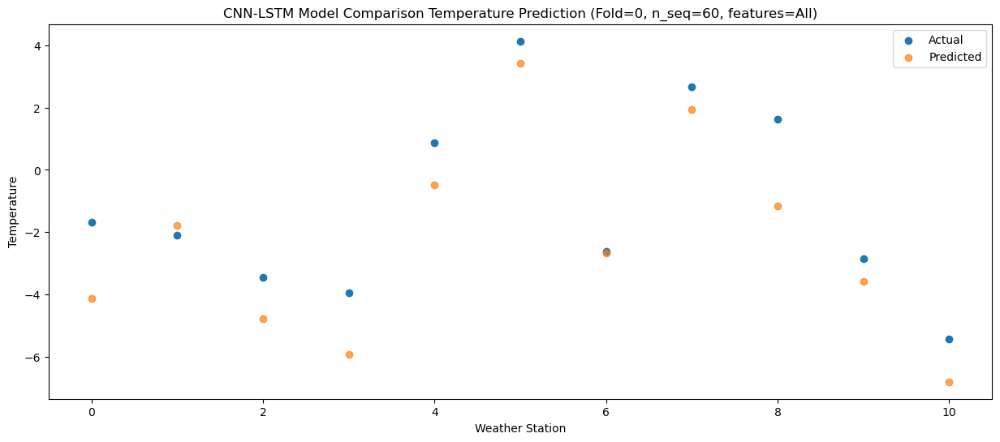

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   1.926441
1                 1    1.76   2.676537
2                 2    0.05   0.193063
3                 3   -0.16  -0.576107
4                 4    7.36   5.838158
5                 5    8.05   8.064927
6                 6    1.72   2.277402
7                 7    7.51   7.040665
8                 8    8.84   5.360443
9                 9    4.13   2.363486
10               10    1.48  -0.502974


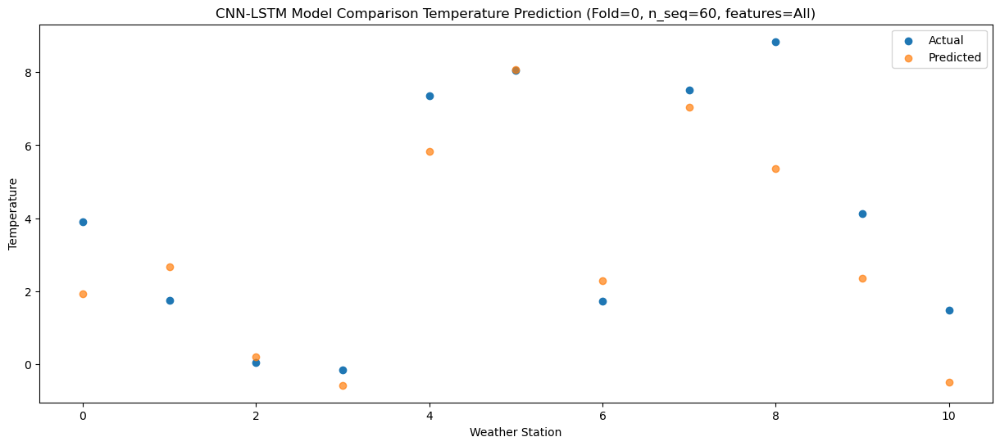

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   7.077650
1                 1    4.73   6.898272
2                 2    2.79   4.579306
3                 3    4.63   4.346440
4                 4   13.40  11.287624
5                 5   10.92  11.988488
6                 6    4.64   6.424054
7                 7   10.83  11.144586
8                 8   12.79  10.489845
9                 9    6.86   6.795306
10               10    5.09   3.813974


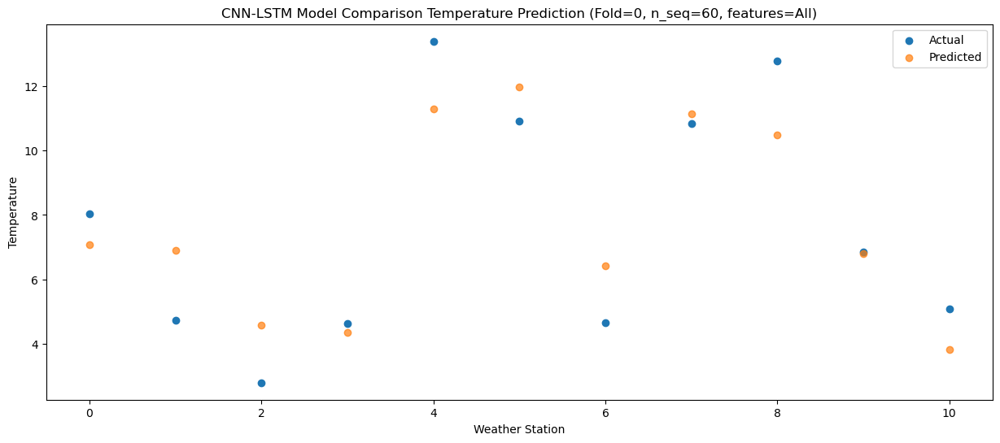

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  12.180944
1                 1    9.04  10.846710
2                 2    8.55   9.399092
3                 3    9.15   8.534460
4                 4   18.11  15.989137
5                 5   15.55  17.084922
6                 6    9.71  11.680161
7                 7   15.81  16.864182
8                 8   19.63  16.627113
9                 9   15.03  13.541317
10               10   14.41  11.415972


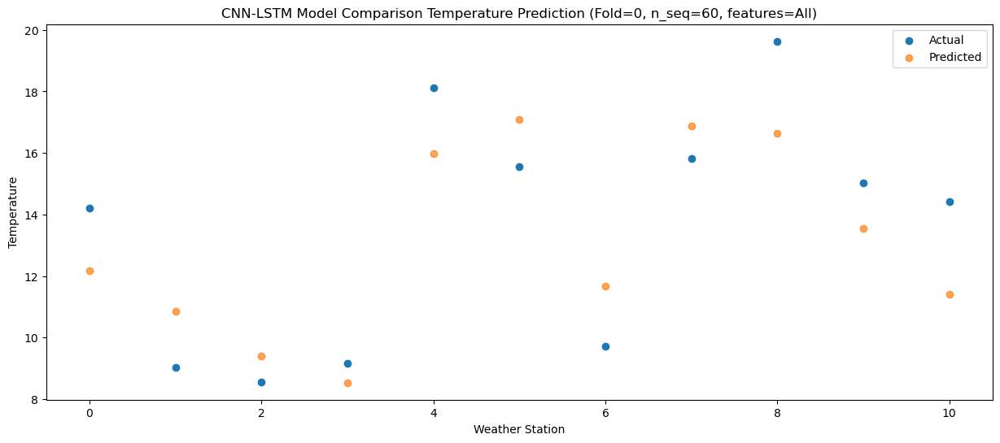

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  16.164754
1                 1   12.73  14.270346
2                 2   12.33  12.978933
3                 3   11.58  12.232834
4                 4   22.45  20.189116
5                 5   19.12  20.674107
6                 6   13.62  15.333961
7                 7   19.81  20.584418
8                 8   24.15  20.910764
9                 9   18.93  17.508090
10               10   19.17  15.643147


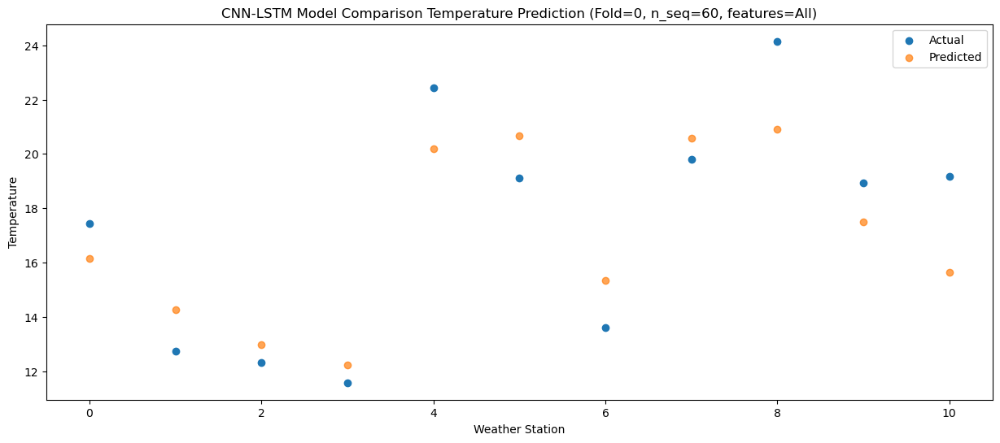

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  17.607105
1                 1   12.87  15.148063
2                 2   13.25  14.022569
3                 3   11.56  13.375226
4                 4   24.81  21.781240
5                 5   21.26  21.750560
6                 6   14.72  16.429837
7                 7   21.68  21.793874
8                 8   26.48  22.573779
9                 9   20.96  18.927079
10               10   20.28  17.235931


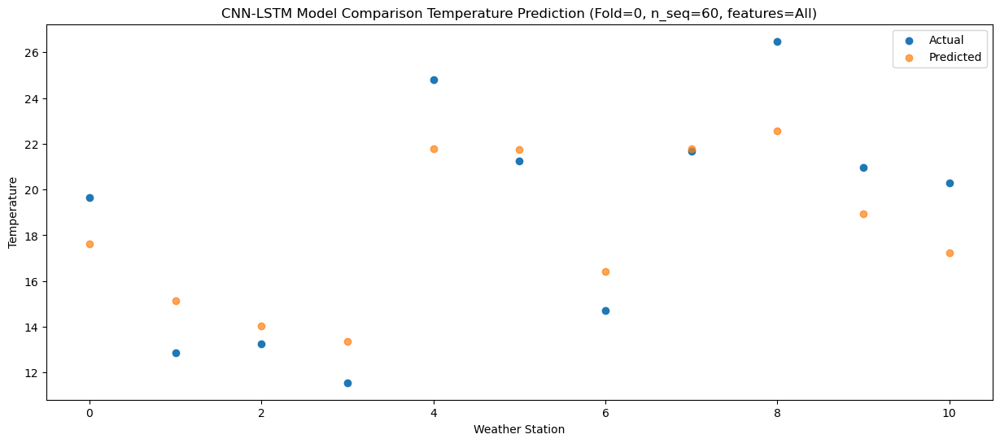

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  15.399262
1                 1   12.32  13.619320
2                 2   12.02  12.430583
3                 3   10.37  11.308844
4                 4   22.45  19.335035
5                 5   20.41  20.637374
6                 6   13.43  15.109554
7                 7   20.00  20.576393
8                 8   23.60  20.479329
9                 9   19.05  17.460705
10               10   19.16  15.993560


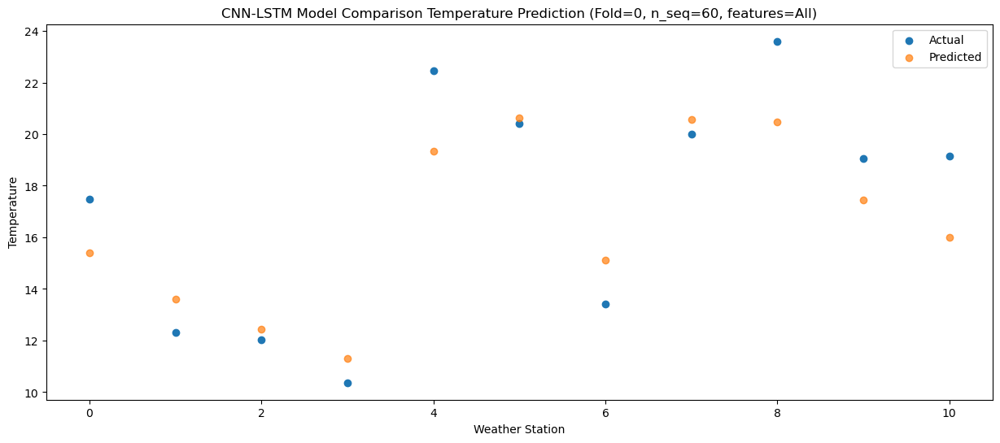

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  12.373542
1                 1   11.30  11.193535
2                 2    8.90   9.603992
3                 3    9.13   8.735001
4                 4   19.50  16.451218
5                 5   17.76  17.632878
6                 6   10.37  12.066694
7                 7   16.30  17.282707
8                 8   19.96  16.970922
9                 9   15.32  13.702097
10               10   15.32  11.795849


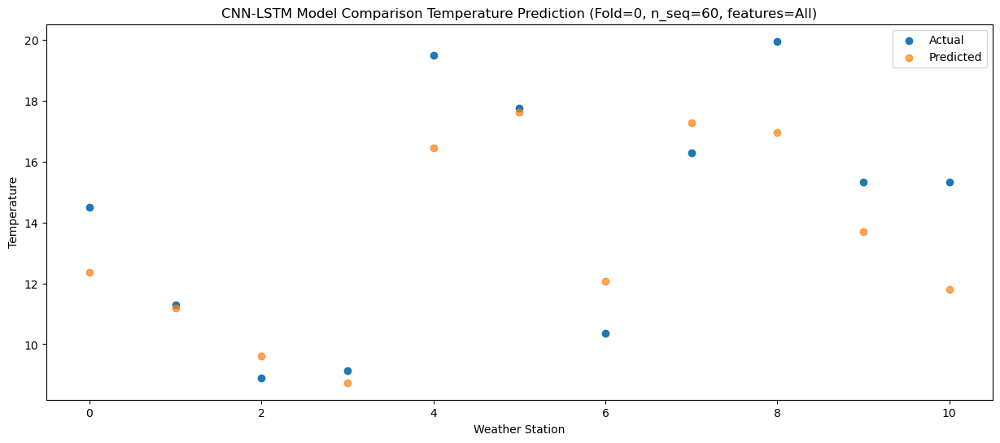

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   5.597631
1                 1    5.70   5.224828
2                 2    1.76   3.305761
3                 3    3.51   2.389296
4                 4   13.58   9.578246
5                 5   11.20  11.321579
6                 6    3.43   5.653053
7                 7    9.11  10.718008
8                 8   13.40   9.797559
9                 9    8.28   6.695695
10               10    8.08   4.480095


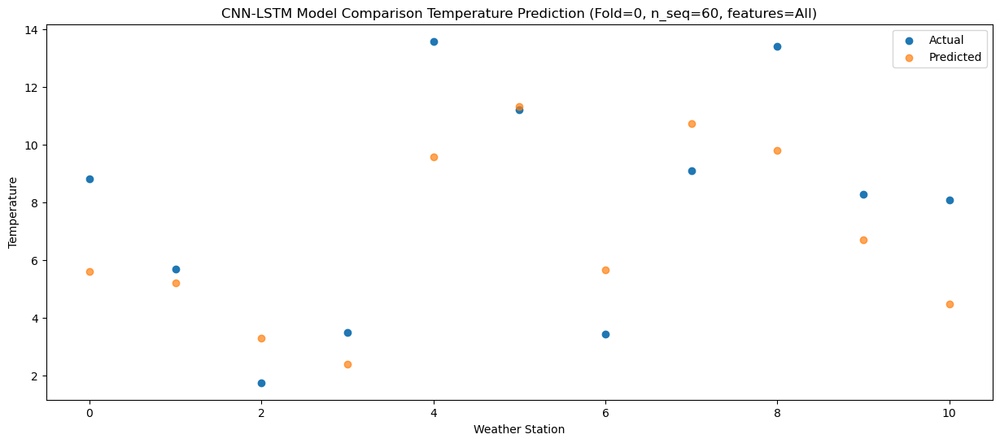

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   0.148414
1                 1    3.01   1.637585
2                 2   -0.72  -0.473026
3                 3   -0.60  -2.423722
4                 4    6.65   3.071555
5                 5    9.51   7.927794
6                 6    1.20   2.005871
7                 7    6.91   7.068739
8                 8    7.43   3.946083
9                 9    3.26   2.498931
10               10    3.05  -0.046728


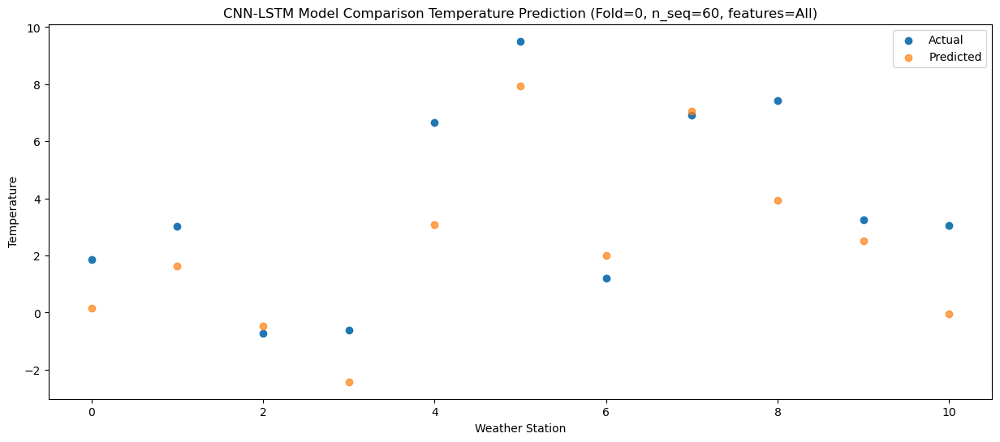

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -2.947100
1                 1   -0.84  -1.183868
2                 2   -5.24  -3.969237
3                 3   -2.78  -4.867315
4                 4    3.92   0.652252
5                 5    2.99   3.846355
6                 6   -5.31  -2.052401
7                 7   -0.26   2.563231
8                 8    2.14  -0.117561
9                 9   -2.45  -2.704606
10               10   -3.13  -6.079785


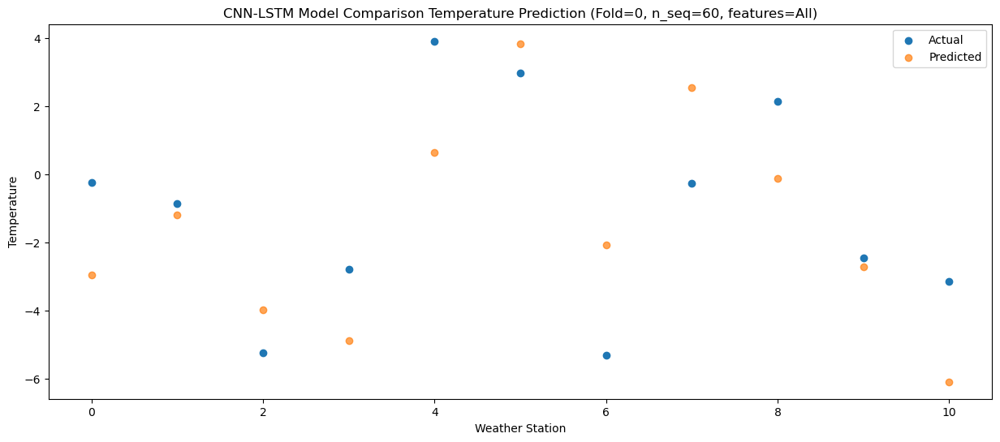

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42  -2.152107
1                 1   -0.05  -0.416120
2                 2   -3.29  -3.022028
3                 3   -1.34  -4.230698
4                 4    4.89   1.243937
5                 5    4.68   4.989857
6                 6   -2.12  -0.933349
7                 7    2.91   3.806328
8                 8    4.70   0.922591
9                 9   -0.56  -1.307480
10               10   -2.00  -4.480860


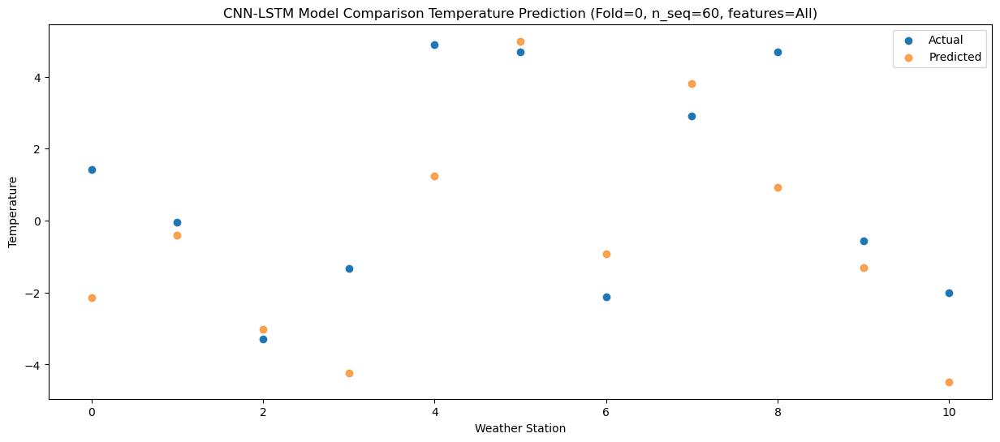

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95  -0.699713
1                 1    1.05   1.250486
2                 2   -0.51  -1.522338
3                 3   -0.93  -2.585583
4                 4    5.02   2.718876
5                 5    6.17   6.216164
6                 6    0.88   0.352315
7                 7    5.88   4.921583
8                 8    6.31   2.105314
9                 9    1.48  -0.319217
10               10   -1.59  -3.831461


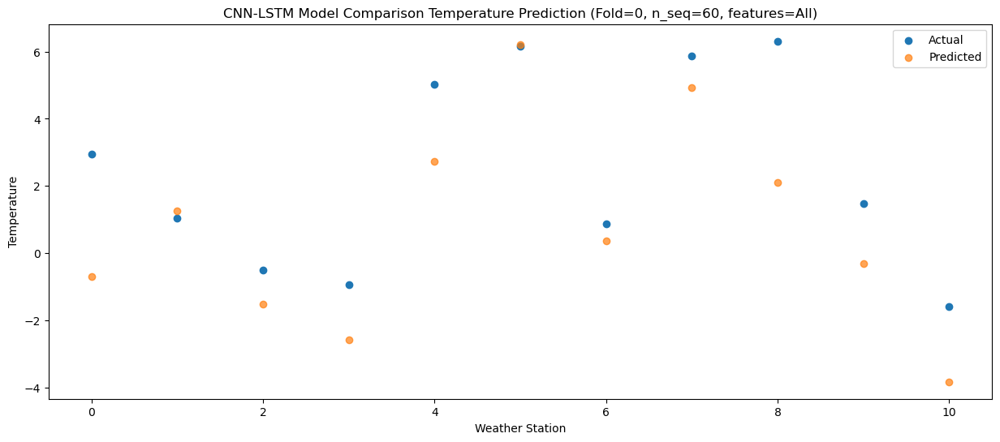

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   2.179611
1                 1    2.64   3.526024
2                 2   -0.53   0.679819
3                 3    2.59   0.250983
4                 4    9.74   6.051451
5                 5    7.08   8.055807
6                 6    1.36   2.313433
7                 7    6.56   6.768407
8                 8    8.13   4.832547
9                 9    1.82   1.590026
10               10    0.27  -2.077167


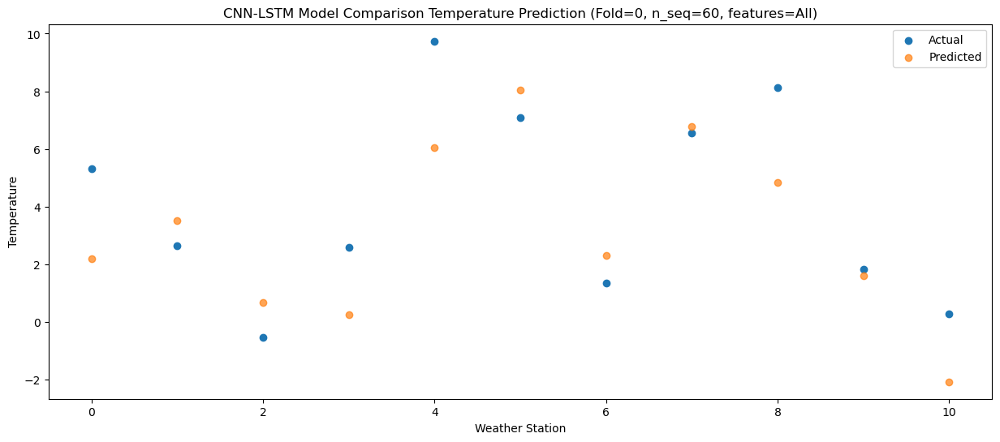

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   4.827683
1                 1    4.79   5.422336
2                 2    2.54   3.386843
3                 3    4.01   1.973429
4                 4   11.24   8.251653
5                 5   11.76  11.523580
6                 6    4.92   5.740915
7                 7   11.18  10.771755
8                 8   13.91   8.750326
9                 9    8.10   6.411073
10               10    7.12   3.892996


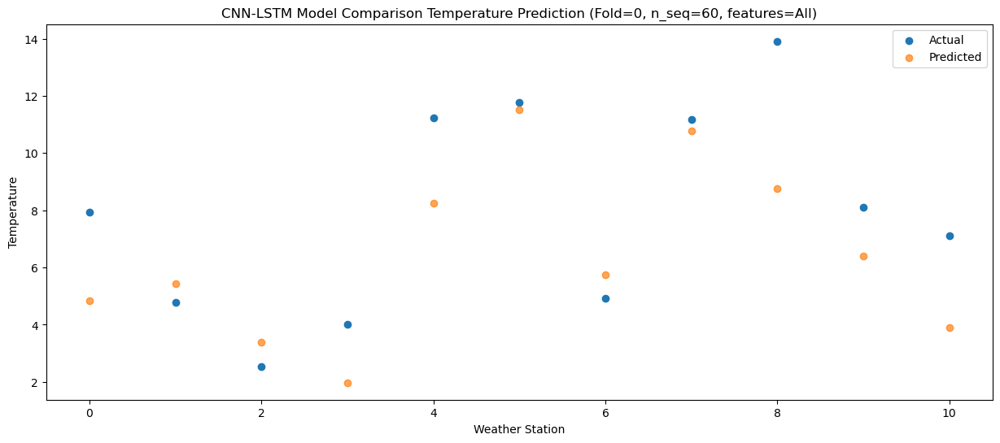

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41   9.731613
1                 1    7.97   8.562479
2                 2    5.95   6.945571
3                 3    8.44   6.165676
4                 4   16.77  13.764564
5                 5   13.28  14.683620
6                 6    7.61   9.213994
7                 7   13.47  14.334855
8                 8   19.50  14.166276
9                 9   13.06  10.748403
10               10   12.14   8.592574


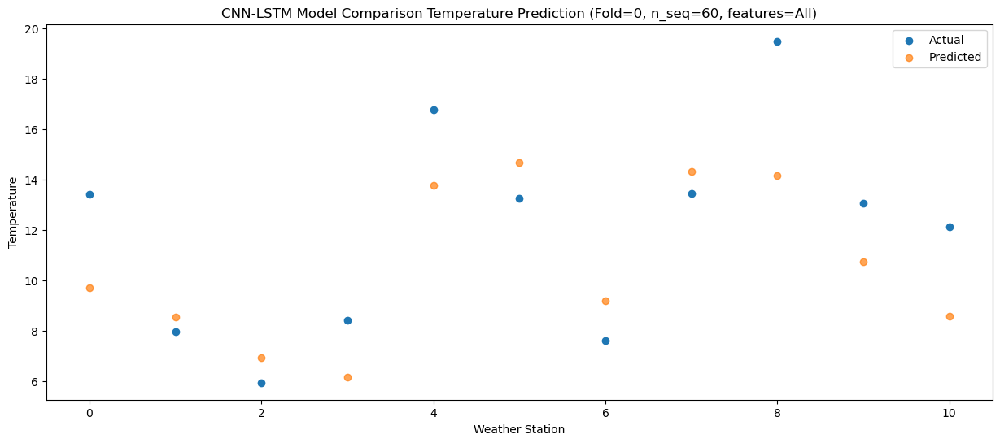

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  13.682370
1                 1   11.05  12.090931
2                 2    9.27  10.679246
3                 3   12.19   9.941479
4                 4   21.32  17.702777
5                 5   17.10  18.312247
6                 6   10.96  12.942420
7                 7   17.22  18.123069
8                 8   23.37  18.224451
9                 9   16.90  14.761946
10               10   17.65  12.673267


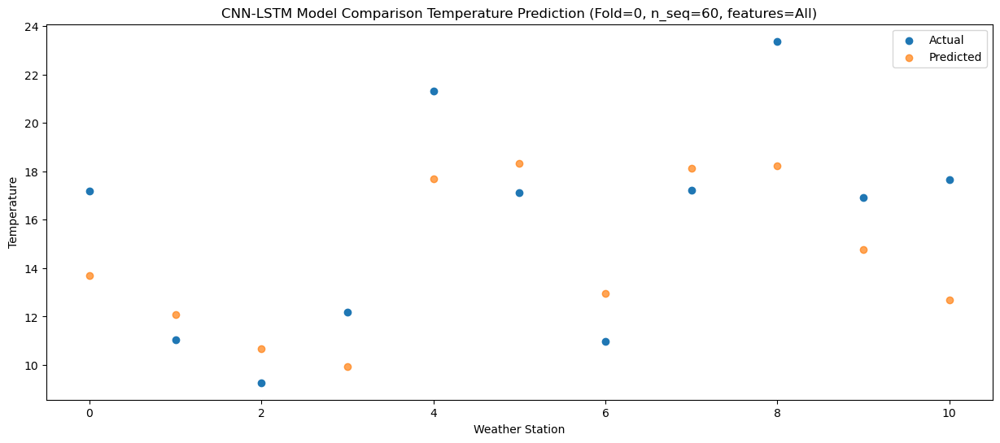

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  15.518294
1                 1   12.88  14.594762
2                 2   12.37  13.118654
3                 3   13.31  11.912315
4                 4   24.31  19.302553
5                 5   20.93  21.277291
6                 6   14.67  15.673968
7                 7   21.36  20.970503
8                 8   24.86  20.097025
9                 9   19.73  17.289055
10               10   20.11  15.312126


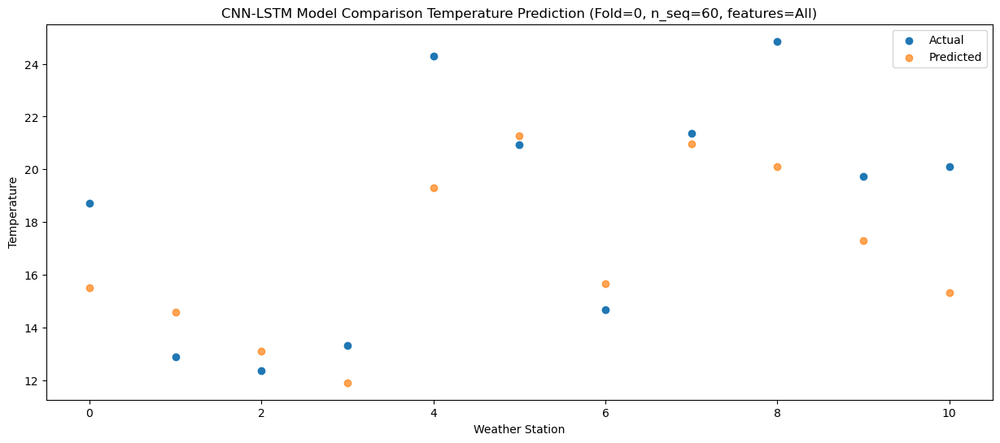

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  16.692054
1                 1   14.47  15.526866
2                 2   11.98  13.727644
3                 3   14.84  13.327600
4                 4   26.05  20.988537
5                 5   20.45  21.257134
6                 6   13.98  15.798206
7                 7   20.22  20.788943
8                 8   23.60  20.812250
9                 9   18.93  16.950691
10               10   18.30  14.503463


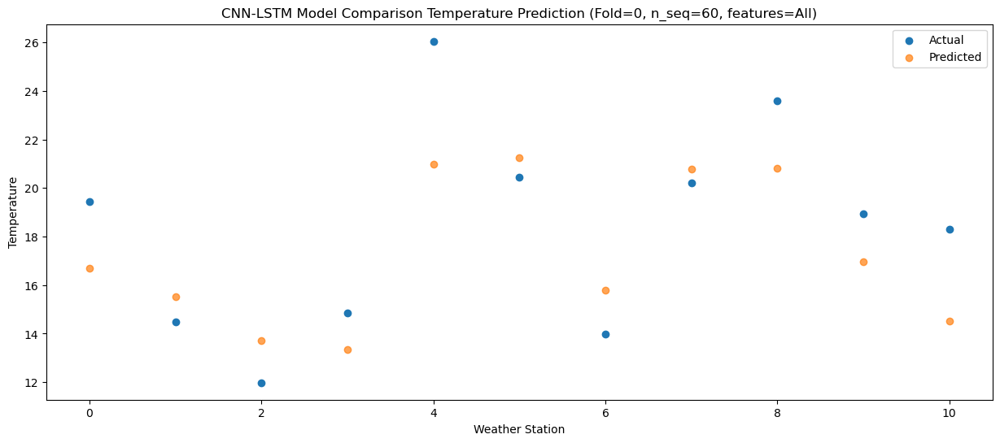

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  12.791982
1                 1   11.09  11.975204
2                 2    8.53  10.224938
3                 3   11.40   9.451627
4                 4   21.57  16.805864
5                 5   16.93  17.960134
6                 6   10.47  12.445008
7                 7   16.46  17.503953
8                 8   20.43  17.015940
9                 9   16.32  13.652438
10               10   15.92  11.323915


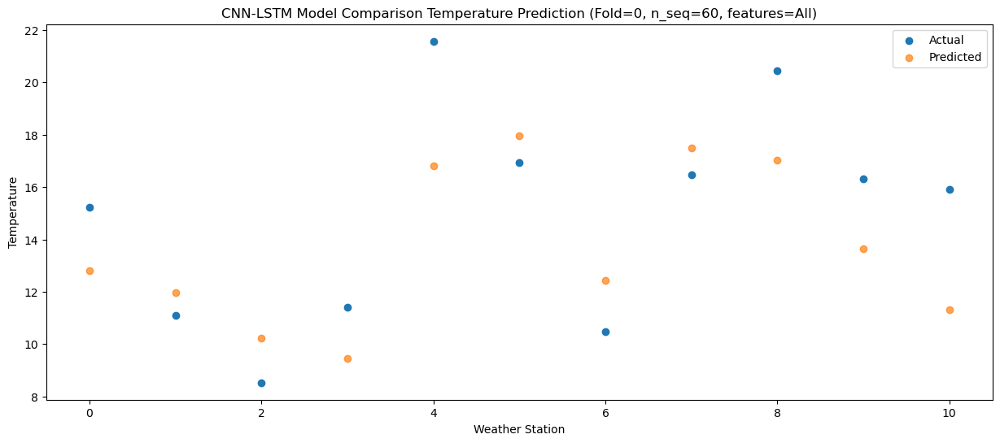

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16   5.356159
1                 1    5.98   5.971429
2                 2    2.55   3.998932
3                 3    5.15   2.472456
4                 4   13.91   8.809256
5                 5   12.58  12.306242
6                 6    5.26   6.494255
7                 7   11.07  11.577871
8                 8   14.83   9.401134
9                 9    9.74   7.166775
10               10    9.96   4.789496


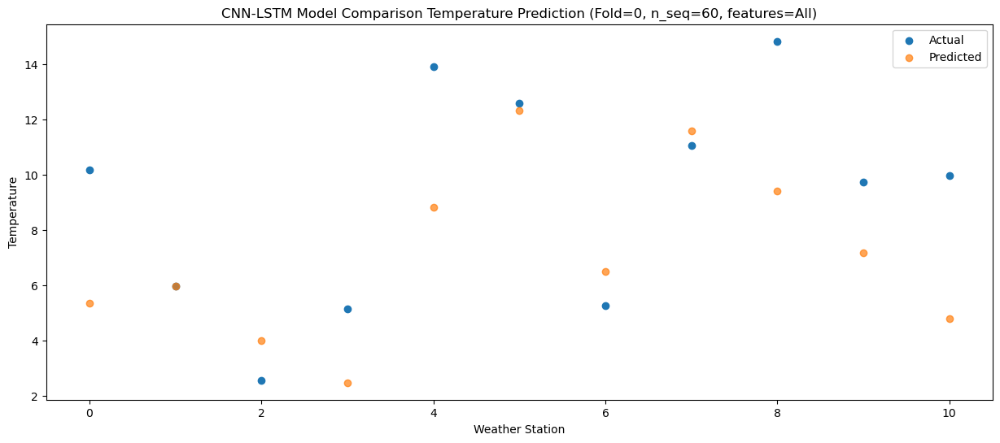

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30  -1.298102
1                 1    0.74  -0.071506
2                 2   -2.54  -2.517895
3                 3   -0.71  -3.711410
4                 4    7.55   2.392976
5                 5    7.14   5.557814
6                 6   -0.61  -0.293994
7                 7    4.62   4.493146
8                 8    7.84   2.259141
9                 9    3.24  -0.407877
10               10    2.32  -3.227485


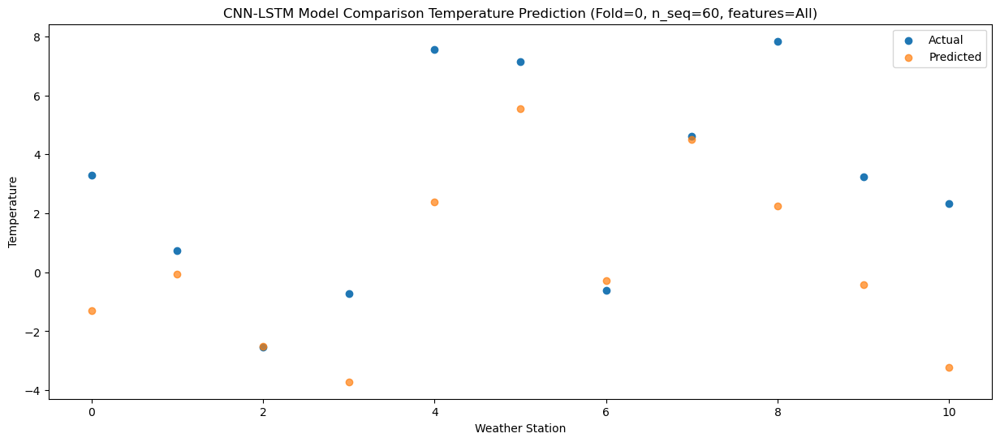

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70  -4.195534
1                 1   -1.96  -2.585450
2                 2   -5.57  -4.899211
3                 3   -3.50  -6.599181
4                 4    4.76  -0.903889
5                 5    5.00   3.538641
6                 6   -2.90  -2.429332
7                 7    3.03   2.521078
8                 8    5.28  -0.494025
9                 9    0.81  -2.413437
10               10    1.64  -5.045355


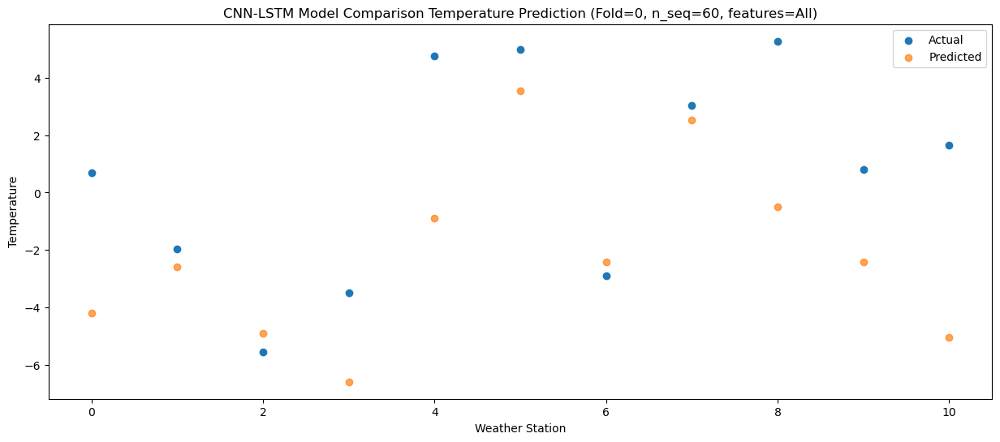

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -8.883480
1                 1   -4.23  -5.232864
2                 2   -8.08  -8.306230
3                 3   -6.38 -10.325303
4                 4   -0.22  -5.771621
5                 5    3.73   0.540292
6                 6   -5.03  -5.825025
7                 7    0.33  -1.110559
8                 8   -0.98  -5.873988
9                 9   -4.95  -7.223525
10               10   -5.28 -10.321323


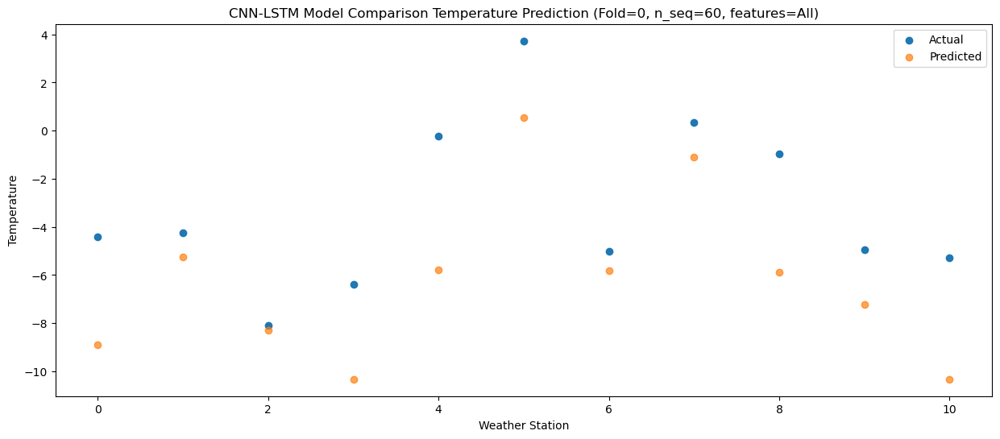

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46  -1.697225
1                 1   -1.73  -0.756369
2                 2   -3.57  -3.398649
3                 3   -1.73  -3.908091
4                 4    7.65   2.370861
5                 5    4.25   4.165696
6                 6   -1.47  -1.543915
7                 7    3.47   3.017960
8                 8    7.64   1.410211
9                 9    1.19  -2.038498
10               10   -0.27  -5.323216


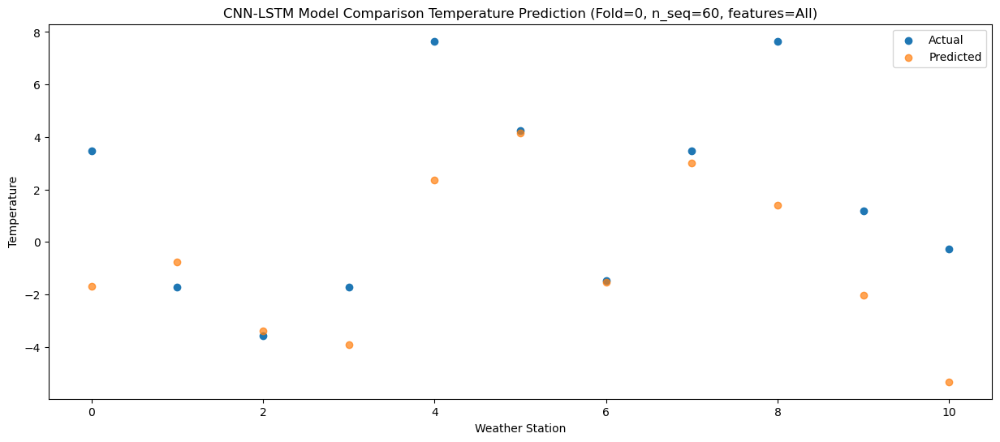

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   0.698543
1                 1    1.57   2.213920
2                 2    0.81  -0.414829
3                 3    1.21  -1.402805
4                 4   10.20   4.365089
5                 5    8.30   7.377345
6                 6    2.37   1.568817
7                 7    7.62   6.197367
8                 8   10.92   3.818230
9                 9    4.51   1.028419
10               10    3.23  -2.238838


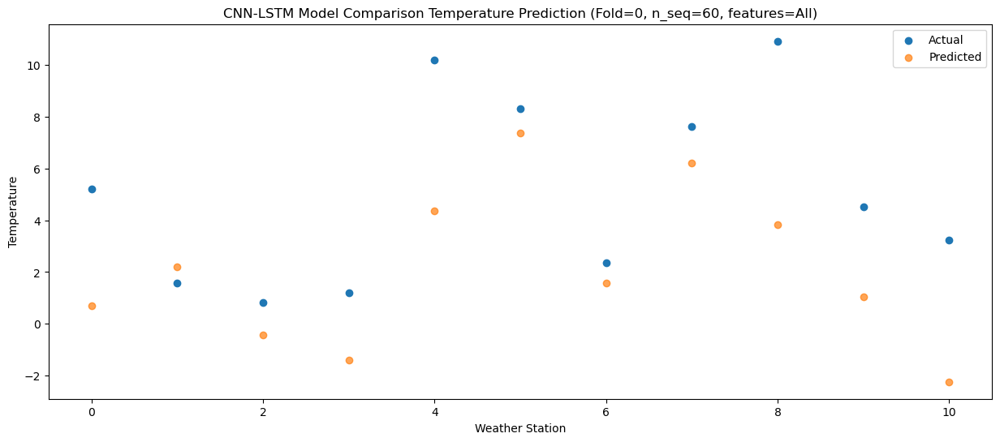

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98   4.704352
1                 1    4.45   5.245173
2                 2    4.50   3.031694
3                 3    4.78   2.068740
4                 4   13.47   8.452614
5                 5   11.52  10.784053
6                 6    5.96   5.124581
7                 7   12.10   9.936183
8                 8   15.80   8.324427
9                 9    9.73   5.353736
10               10    8.57   2.480322


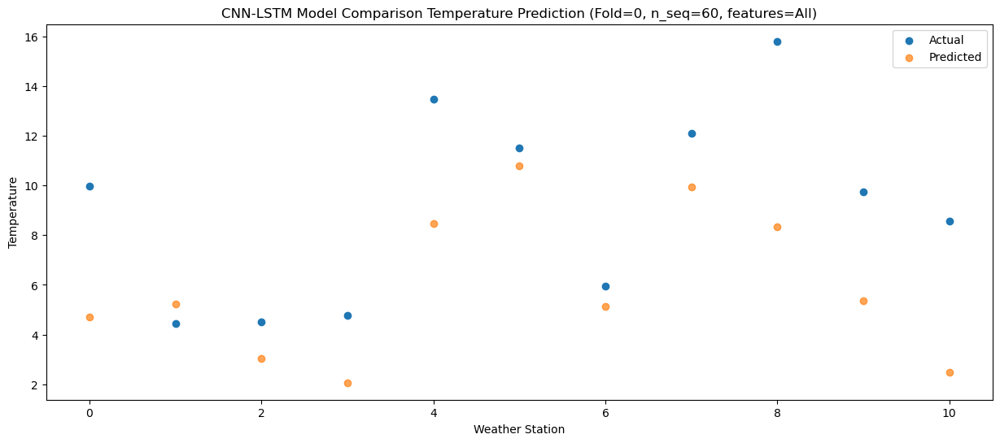

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89   9.439889
1                 1    8.94   9.850814
2                 2    8.98   7.944077
3                 3    9.17   6.552981
4                 4   18.05  12.851966
5                 5   16.33  15.913014
6                 6    9.96  10.248701
7                 7   16.06  15.262290
8                 8   20.87  13.392554
9                 9   15.53  10.963038
10               10   15.54   8.381601


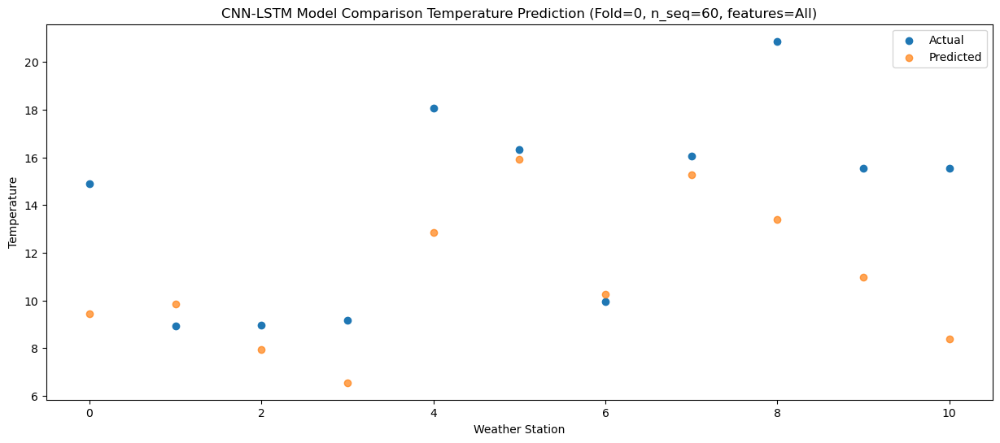

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  13.122239
1                 1   11.87  12.966281
2                 2   13.22  11.334829
3                 3   11.29   9.814149
4                 4   21.55  16.652124
5                 5   19.76  19.557267
6                 6   13.87  13.887220
7                 7   20.08  19.095061
8                 8   23.80  17.571965
9                 9   19.29  15.097759
10               10   19.86  12.941935


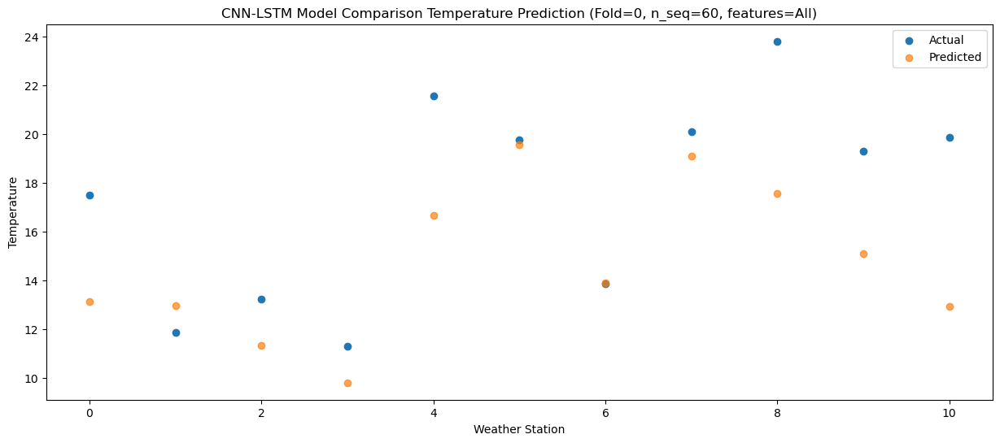

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  13.444461
1                 1   13.00  13.632819
2                 2   13.49  12.020579
3                 3   11.23  10.079662
4                 4   21.41  16.893775
5                 5   21.42  20.741261
6                 6   15.13  14.887335
7                 7   21.30  20.248593
8                 8   24.35  18.200641
9                 9   20.13  16.151667
10               10   20.75  14.357948


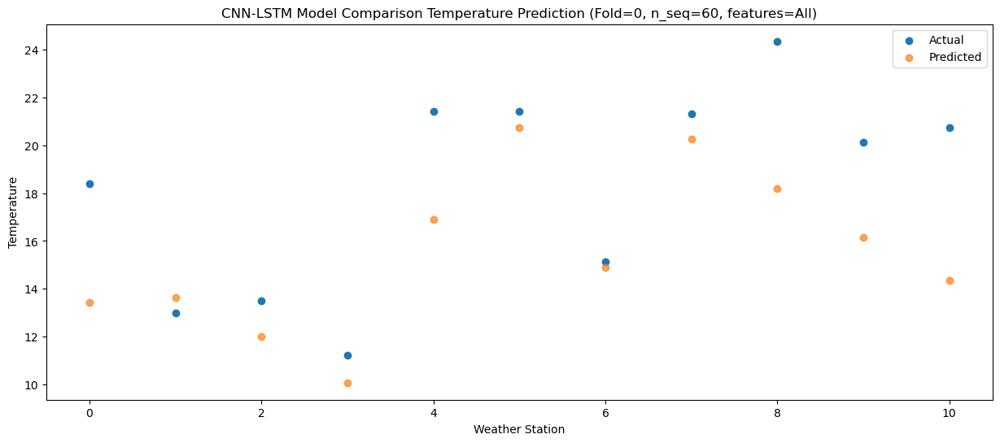

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  13.972148
1                 1   13.39  13.636848
2                 2   11.81  11.849051
3                 3   12.04  10.724873
4                 4   23.09  17.871732
5                 5   20.15  19.852026
6                 6   13.38  14.240093
7                 7   19.46  19.324682
8                 8   24.29  18.298034
9                 9   19.80  15.254697
10               10   20.00  12.964347


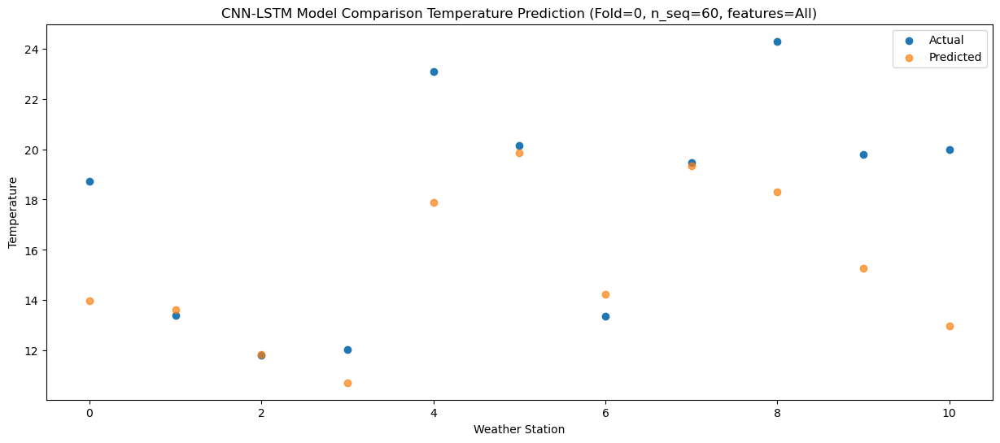

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  10.069353
1                 1   10.15  10.542743
2                 2    9.04   8.619765
3                 3    9.45   7.042937
4                 4   19.17  13.711931
5                 5   18.21  16.940560
6                 6   10.95  11.171929
7                 7   16.53  16.259691
8                 8   20.67  14.435469
9                 9   17.61  11.933409
10               10   17.22   9.728169


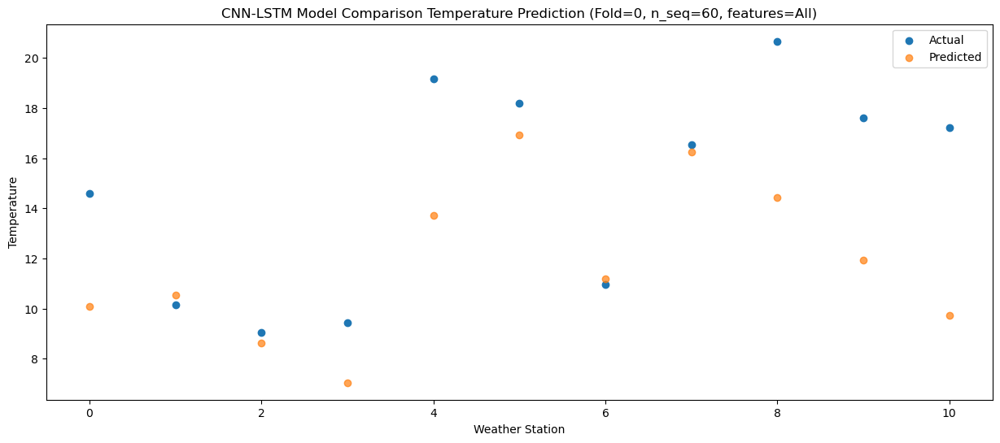

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31   6.094390
1                 1    6.83   7.086044
2                 2    3.14   4.633839
3                 3    5.31   3.637870
4                 4   16.72  10.037209
5                 5   13.18  12.560075
6                 6    5.68   6.777995
7                 7   10.70  11.515824
8                 8   15.24   9.739840
9                 9   10.87   6.626686
10               10   10.99   3.769015


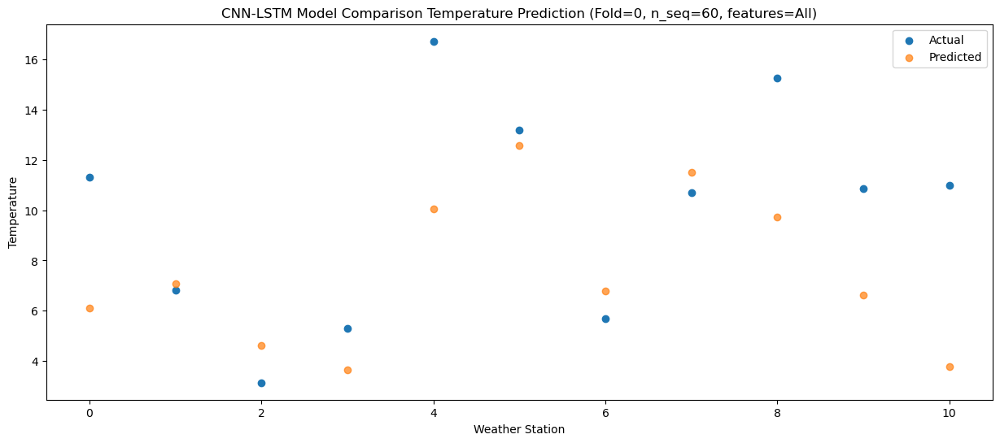

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_10 (Conv1D)          (None, 1, 1024)           2028544   
                                                                 
 max_pooling1d_10 (MaxPoolin  (None, 1, 1024)          0         
 g1D)                                                            
                                                                 
 dropout_30 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_20 (LSTM)              (None, 1, 512)            3147776   
                                                                 
 dropout_31 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_21 (LSTM)              (None, 512)               2099200   
                                                     

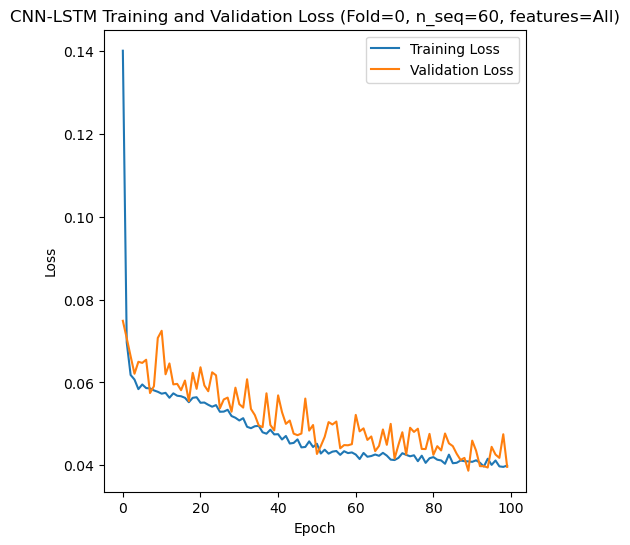

Epoch 1/100
84/84 [==============================] - 7s 41ms/step - loss: 0.1475 - accuracy: 0.3333 - mae: 0.1282 - rmse: 0.1475 - mape: inf - pearson: 0.6105 - val_loss: 0.0619 - val_accuracy: 0.6000 - val_mae: 0.0495 - val_rmse: 0.0619 - val_mape: 10.8945 - val_pearson: 0.8378
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0707 - accuracy: 0.4762 - mae: 0.0560 - rmse: 0.0707 - mape: inf - pearson: 0.8027 - val_loss: 0.0615 - val_accuracy: 0.0000e+00 - val_mae: 0.0487 - val_rmse: 0.0615 - val_mape: 10.8068 - val_pearson: 0.8438
Epoch 3/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0619 - accuracy: 0.4881 - mae: 0.0490 - rmse: 0.0619 - mape: inf - pearson: 0.8243 - val_loss: 0.0605 - val_accuracy: 0.6000 - val_mae: 0.0486 - val_rmse: 0.0605 - val_mape: 10.6230 - val_pearson: 0.8448
Epoch 4/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0613 - accuracy: 0.5238 - mae: 0.0481 - rmse: 0.0613 - mape: inf - pearson: 0.83

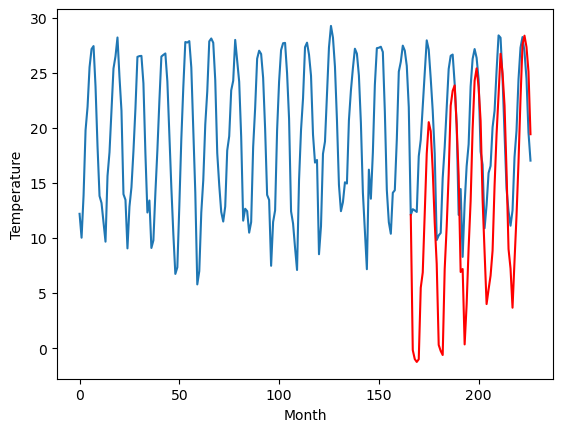

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-1.76		-0.77
-1.90		-2.62		-0.72
-3.01		-2.99		0.02
-2.92		-2.93		-0.01
3.08		3.95		0.87
4.30		5.39		1.09
7.65		11.19		3.54
12.00		17.14		5.14
15.37		19.98		4.61
13.96		18.91		4.95
10.42		15.08		4.66
6.70		9.84		3.14
2.60		6.44		3.84
-4.29		-1.09		3.20
-4.49		-1.91		2.58
-3.83		-3.00		0.83
2.94		5.92		2.98
5.08		9.81		4.73
8.81		14.69		5.88
12.95		21.37		8.42
14.33		22.62		8.29
14.60		23.18		8.58
10.86		19.42		8.56
7.08		14.69		7.61
-0.58		5.52		6.10
1.05		5.67		4.62
-5.68		-1.76		3.92
-1.45		1.82		3.27
2.12		7.41		5.29
5.12		11.93		6.81
11.00		18.98		7.98
14.97		23.48		8.51
15.47		24.75		9.28
14.01		22.85		8.84
10.92		19.52		8.60
4.58		12.16		7.58
1.58		7.12		5.54
-4.23		2.19		6.42
-2.04		3.51		5.55
1.33		4.65		3.32
2.10		7.06		4.96
5.37		13.40		8.03
8.65		18.46		9.81
11.84		22.27		10.43
15.44		25.81		10.37
14.90		23.97		9.07
11.39		21.08		9.69
6.38		14.80		8.42
0.76		7.53		6.77
-2.38

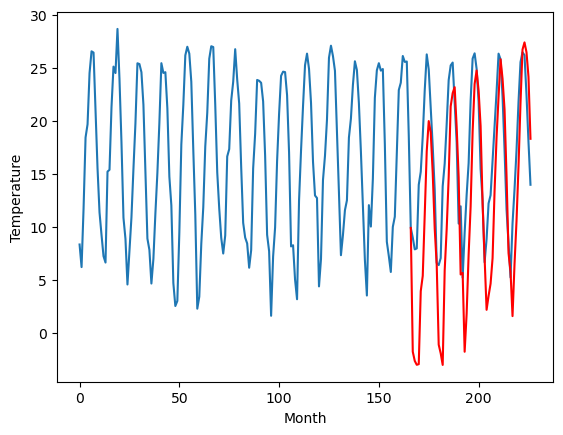

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		-0.30		0.60
-0.47		-1.01		-0.54
-1.00		-1.40		-0.40
-0.72		-1.28		-0.56
6.38		5.80		-0.58
5.41		7.04		1.63
9.56		12.54		2.98
13.79		18.21		4.42
15.26		20.80		5.54
15.25		19.90		4.65
12.45		16.18		3.73
8.10		11.10		3.00
3.30		7.76		4.46
-3.76		0.18		3.94
-3.34		-0.40		2.94
-2.85		-1.53		1.32
4.21		7.52		3.31
5.61		11.02		5.41
9.73		15.79		6.06
13.61		22.18		8.57
14.38		23.45		9.07
15.04		24.00		8.96
12.02		20.47		8.45
8.24		15.69		7.45
0.50		6.78		6.28
3.10		7.43		4.33
-3.79		-0.01		3.78
-0.44		3.34		3.78
3.56		8.90		5.34
7.15		13.49		6.34
12.51		20.14		7.63
15.48		24.63		9.15
16.19		25.73		9.54
14.58		23.59		9.01
12.19		20.53		8.34
5.50		13.21		7.71
2.18		8.02		5.84
-0.98		3.53		4.51
0.02		4.74		4.72
2.61		6.17		3.56
4.04		8.70		4.66
6.73		14.43		7.70
9.97		19.56		9.59
13.72		23.32		9.60
16.09		26.61		10.52
16.53		25.16		8.63
13.57		22.11		8.54
7.53		15.68		8.15
0.97		8.66		7.69
-1.81	

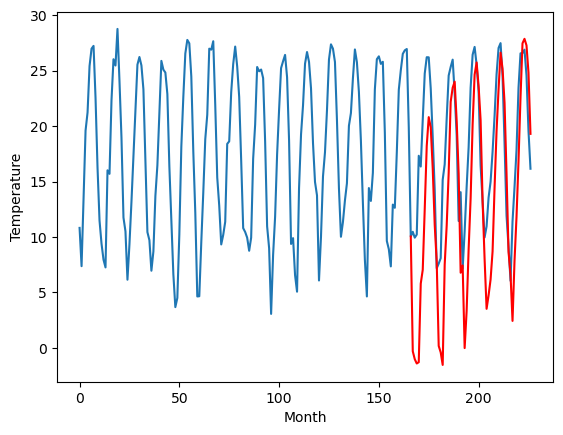

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-0.66		-1.85
-0.23		-1.31		-1.08
0.52		-1.73		-2.25
-0.01		-1.50		-1.49
7.63		5.79		-1.84
7.51		7.03		-0.48
11.26		12.42		1.16
14.04		17.88		3.84
15.69		20.17		4.48
15.93		19.51		3.58
12.52		15.74		3.22
7.98		10.55		2.57
5.08		7.29		2.21
-1.10		-0.09		1.01
-1.20		-0.38		0.82
-2.79		-1.93		0.86
4.58		7.59		3.01
6.92		10.71		3.79
10.81		15.37		4.56
14.70		21.72		7.02
14.58		23.00		8.42
15.55		23.41		7.86
12.54		20.21		7.67
9.85		15.02		5.17
2.69		6.71		4.02
6.06		7.60		1.54
-1.99		0.31		2.30
-2.46		3.12		5.58
3.38		8.82		5.44
9.38		13.57		4.19
13.81		19.78		5.97
16.81		24.47		7.66
17.75		25.58		7.83
16.11		23.11		7.00
13.34		20.29		6.95
7.78		12.93		5.15
2.73		6.96		4.23
0.64		3.19		2.55
1.35		4.25		2.90
2.35		5.81		3.46
6.18		8.71		2.53
7.02		13.87		6.85
11.61		19.41		7.80
15.76		23.16		7.40
17.48		26.20		8.72
19.45		25.25		5.80
16.37		21.97		5.60
9.11		15.19		6.08
2.83		8.45		5.62
0.43	

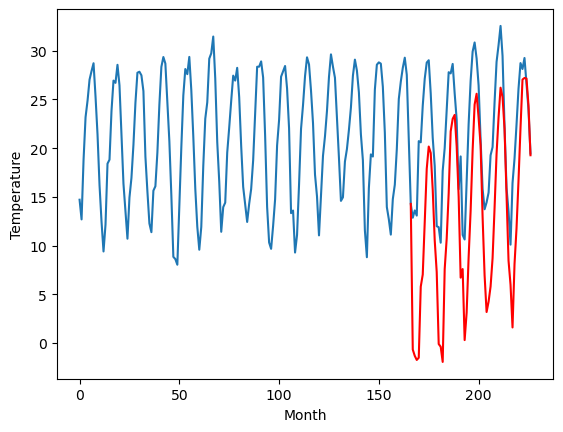

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		3.56		-2.04
3.71		2.92		-0.79
4.52		2.48		-2.04
4.14		2.67		-1.47
12.18		10.07		-2.11
11.92		11.30		-0.62
15.72		16.76		1.04
18.75		22.31		3.56
20.79		24.57		3.78
21.03		23.87		2.84
17.45		20.05		2.60
12.51		14.76		2.25
9.41		11.59		2.18
3.05		4.16		1.11
3.04		3.84		0.80
1.34		2.11		0.77
8.95		11.91		2.96
11.25		15.00		3.75
15.37		19.68		4.31
18.84		26.11		7.27
18.93		27.37		8.44
19.90		27.79		7.89
16.32		24.58		8.26
13.28		19.35		6.07
5.73		10.96		5.23
9.61		11.87		2.26
1.13		4.44		3.31
0.82		7.21		6.39
6.60		13.01		6.41
12.87		17.84		4.97
17.49		24.11		6.62
20.86		28.83		7.97
21.95		29.96		8.01
19.94		27.42		7.48
16.76		24.55		7.79
11.37		17.15		5.78
6.37		11.10		4.73
4.35		7.32		2.97
4.83		8.36		3.53
6.01		9.92		3.91
9.83		12.87		3.04
10.79		18.07		7.28
15.43		23.71		8.28
20.32		27.49		7.17
22.27		30.46		8.19
23.70		29.53		5.83
19.85		26.25		6.40
12.45		19.38		6.93
6.25		12.62		6.37


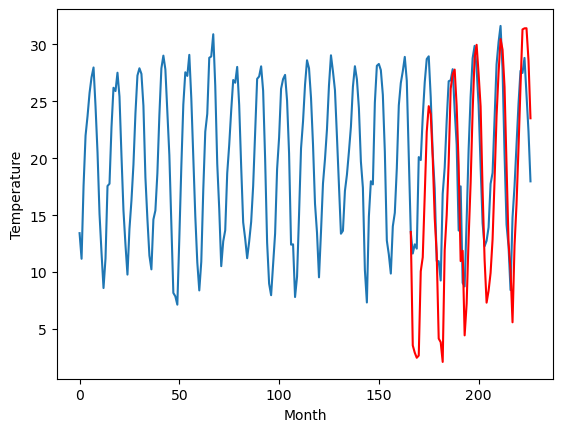

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		0.11		-2.62
0.70		-0.96		-1.66
0.04		-1.33		-1.37
-0.48		-1.01		-0.53
6.87		5.70		-1.17
9.66		7.53		-2.13
14.85		13.36		-1.49
17.57		18.96		1.39
20.27		21.57		1.30
20.12		20.98		0.86
12.59		17.02		4.43
9.75		11.47		1.72
6.03		7.87		1.84
-0.72		0.94		1.66
-2.23		0.57		2.80
-1.85		-0.92		0.93
5.49		8.03		2.54
7.76		11.75		3.99
13.35		16.56		3.21
17.62		23.36		5.74
16.96		24.75		7.79
16.37		24.95		8.58
16.01		21.53		5.52
11.69		15.99		4.30
5.22		8.07		2.85
5.48		7.65		2.17
-1.84		1.20		3.04
-1.95		3.97		5.92
5.00		9.67		4.67
11.91		14.21		2.30
17.31		20.67		3.36
19.37		25.59		6.22
20.29		27.04		6.75
17.44		24.99		7.55
14.39		21.92		7.53
8.31		14.51		6.20
1.35		7.97		6.62
0.23		4.00		3.77
0.69		5.15		4.46
0.83		6.20		5.37
5.89		9.10		3.21
9.05		15.05		6.00
13.66		20.83		7.17
20.35		24.52		4.17
21.45		28.03		6.58
20.64		26.65		6.01
18.36		23.42		5.06
10.76		16.78		6.02
4.10		9.86		5.76
1.74	

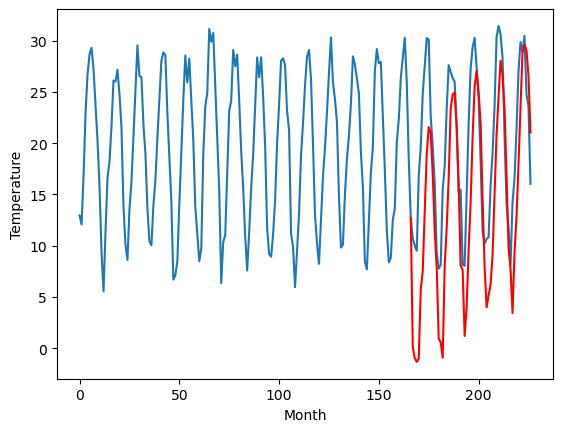

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		1.32		-0.43
1.02		0.42		-0.60
0.21		0.08		-0.13
0.28		0.14		-0.14
5.95		6.94		0.99
7.58		8.43		0.85
10.36		14.27		3.91
15.03		20.25		5.22
18.21		23.17		4.96
16.58		22.07		5.49
13.16		18.24		5.08
9.67		12.99		3.32
5.52		9.56		4.04
-1.69		2.04		3.73
-1.89		1.19		3.08
-1.11		0.16		1.27
5.17		8.96		3.79
7.74		12.96		5.22
11.51		17.86		6.35
15.52		24.57		9.05
16.88		25.83		8.95
17.14		26.39		9.25
13.81		22.59		8.78
9.86		17.87		8.01
2.26		8.68		6.42
3.78		8.71		4.93
-2.61		1.34		3.95
1.20		4.97		3.77
5.04		10.54		5.50
7.80		15.02		7.22
13.72		22.13		8.41
17.30		26.62		9.32
18.04		27.94		9.90
16.54		26.11		9.57
13.65		22.73		9.08
7.31		15.38		8.07
4.42		10.39		5.97
-1.59		5.38		6.97
0.54		6.73		6.19
4.13		7.81		3.68
4.80		10.17		5.37
8.06		16.63		8.57
11.06		21.64		10.58
14.34		25.44		11.10
17.79		29.07		11.28
17.37		27.15		9.78
14.20		24.29		10.09
9.19		18.08		8.89
3.50		10.76		7.26
0.76		9.

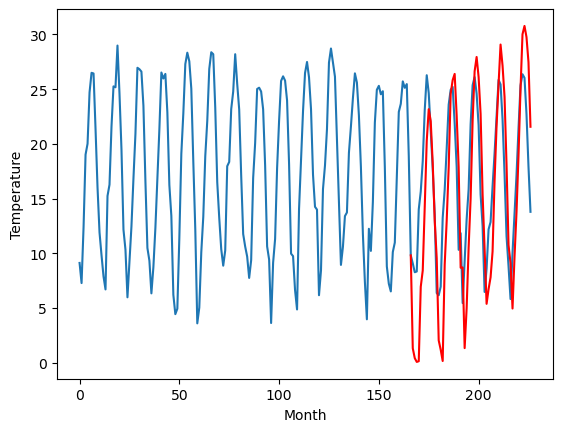

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		5.66		-0.85
5.89		4.85		-1.04
5.04		4.23		-0.81
5.72		4.12		-1.60
12.64		11.99		-0.65
13.78		13.41		-0.37
18.28		19.58		1.30
23.84		26.09		2.25
26.38		28.47		2.09
24.36		27.27		2.91
21.06		22.94		1.88
14.29		16.90		2.61
10.62		14.24		3.62
4.02		6.49		2.47
3.71		5.62		1.91
0.71		2.89		2.18
12.03		14.25		2.22
13.74		17.63		3.89
18.40		22.62		4.22
24.48		29.86		5.38
25.47		30.96		5.49
26.69		31.54		4.85
22.98		27.99		5.01
17.78		22.65		4.87
8.48		13.37		4.89
10.89		13.74		2.85
2.06		5.46		3.40
4.11		8.40		4.29
10.06		14.82		4.76
15.25		19.97		4.72
20.72		27.27		6.55
24.78		32.14		7.36
28.91		33.53		4.62
26.04		30.91		4.87
22.20		27.50		5.30
15.53		19.81		4.28
8.93		13.61		4.68
5.19		8.98		3.79
6.38		10.14		3.76
7.88		11.46		3.58
10.71		14.46		3.75
15.11		20.71		5.60
20.46		26.81		6.35
24.27		30.95		6.68
26.57		33.74		7.17
27.07		32.46		5.39
23.45		29.39		5.94
17.14		22.14		5.00
9.74		14.94

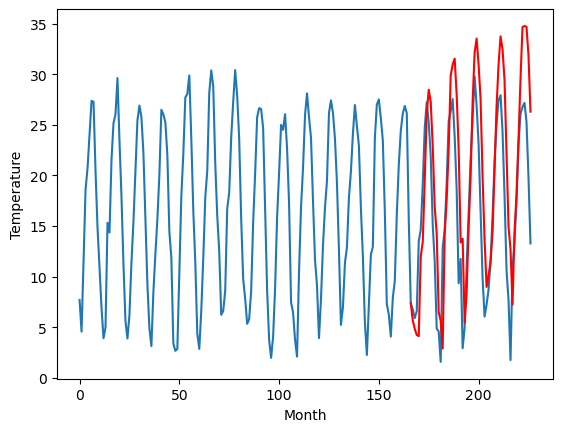

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		4.76		-1.41
4.32		3.78		-0.54
4.50		3.14		-1.36
3.99		3.07		-0.92
11.82		10.96		-0.86
13.20		12.59		-0.61
19.31		18.89		-0.42
24.42		25.48		1.06
26.96		27.79		0.83
26.03		26.69		0.66
19.38		22.20		2.82
13.20		15.83		2.63
10.32		13.21		2.89
3.64		5.63		1.99
3.29		4.82		1.53
-1.49		1.71		3.20
11.07		13.45		2.38
12.87		16.82		3.95
17.68		21.89		4.21
23.71		29.38		5.67
25.22		30.53		5.31
25.61		30.97		5.36
23.10		27.47		4.37
16.85		21.76		4.91
9.10		12.77		3.67
8.29		12.74		4.45
0.67		4.73		4.06
1.65		7.39		5.74
8.90		13.99		5.09
16.01		19.19		3.18
21.37		26.49		5.12
25.66		31.59		5.93
29.81		33.13		3.32
27.14		30.49		3.35
23.31		27.05		3.74
15.08		19.27		4.19
7.23		12.43		5.20
3.60		7.90		4.30
4.46		9.05		4.59
4.83		10.31		5.48
9.26		13.46		4.20
13.59		19.83		6.24
19.28		26.34		7.06
24.21		30.49		6.28
27.09		33.21		6.12
28.90		32.04		3.14
24.26		28.89		4.63
15.68		21.39		5.71
8.56		14.25		

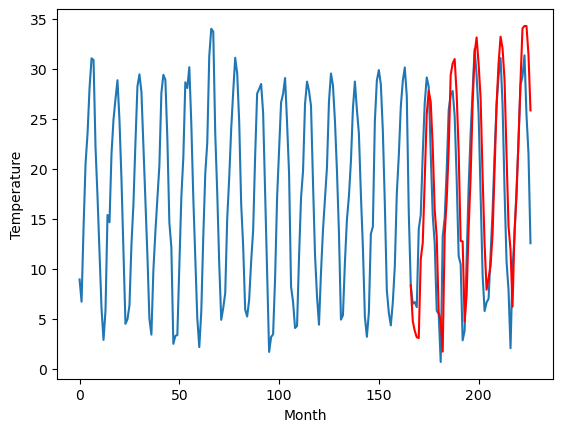

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		4.69		-4.01
7.34		3.33		-4.01
6.89		2.79		-4.10
5.65		2.87		-2.78
13.61		10.07		-3.54
15.92		12.20		-3.72
22.45		18.72		-3.73
28.83		25.22		-3.61
30.41		27.83		-2.58
29.18		26.89		-2.29
22.43		22.34		-0.09
15.83		15.82		-0.01
12.65		12.74		0.09
5.38		5.64		0.26
5.49		4.85		-0.64
1.12		2.08		0.96
11.83		12.86		1.03
15.59		16.76		1.17
20.14		21.92		1.78
27.25		29.66		2.41
27.92		30.96		3.04
27.77		31.14		3.37
25.82		27.47		1.65
18.38		21.49		3.11
12.13		13.03		0.90
10.52		11.79		1.27
3.60		4.82		1.22
3.66		7.46		3.80
10.59		13.89		3.30
17.07		18.75		1.68
22.52		26.13		3.61
27.09		31.38		4.29
30.69		33.19		2.50
27.86		31.06		3.20
25.45		27.49		2.04
16.91		19.73		2.82
7.92		12.47		4.55
5.57		7.81		2.24
5.85		9.06		3.21
7.00		9.91		2.91
10.73		12.95		2.22
16.08		19.91		3.83
21.19		26.50		5.31
24.42		30.50		6.08
29.04		33.70		4.66
29.44		32.16		2.72
25.92		29.01		3.09
17.82		21.75		3.93
11.0

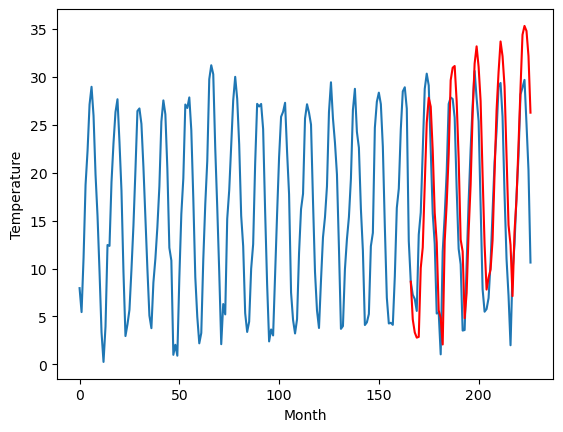

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		-0.67		-0.27
-3.21		-2.19		1.02
-2.87		-2.54		0.33
-2.13		-2.68		-0.55
2.19		3.55		1.36
3.82		5.89		2.07
9.28		13.01		3.73
16.60		20.03		3.43
20.47		23.70		3.23
18.28		22.12		3.84
13.75		17.71		3.96
8.21		11.56		3.35
4.01		8.05		4.04
-3.00		0.78		3.78
-4.84		-0.80		4.04
-5.80		-2.24		3.56
1.42		6.61		5.19
6.07		11.89		5.82
10.61		17.21		6.60
16.70		25.12		8.42
18.93		26.31		7.38
18.71		26.83		8.12
15.01		22.32		7.31
10.59		17.35		6.76
1.27		7.63		6.36
0.50		5.62		5.12
-6.52		-1.56		4.96
-2.62		2.51		5.13
1.94		8.42		6.48
5.29		12.83		7.54
12.27		21.31		9.04
16.66		26.07		9.41
20.60		28.09		7.49
20.06		26.88		6.82
15.15		22.60		7.45
7.05		15.02		7.97
3.54		9.77		6.23
-3.61		3.64		7.25
-0.65		5.23		5.88
-0.97		5.22		6.19
0.15		7.48		7.33
7.37		16.04		8.67
9.93		21.32		11.39
14.30		25.40		11.10
19.44		29.79		10.35
17.70		26.71		9.01
14.51		24.30		9.79
9.16		18.28		9.12
1.22		10.15		8.93


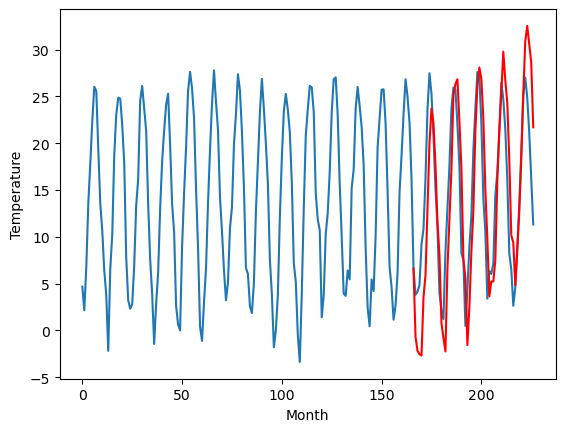

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[-0.17322242736816484, -1.7569547271728512, -0.2959235382080081, -0.6618080520629883, 3.5620166778564446, 0.10597286224365199, 1.324539489746094, 5.6606263732910165, 4.757775230407715, 4.690827560424804, -0.6725128936767586]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68  -0.173222
1                 1   -0.99  -1.756955
2                 2   -0.90  -0.295924
3                 3    1.19  -0.661808
4                 4    5.60   3.562017
5                 5    2.73   0.105973
6                 6    1.75   1.324539
7                 7    6.51   5.660626
8                 8    6.17   4.757775
9                 9    8.70   4.690828
10               10   -0.40  -0.672513


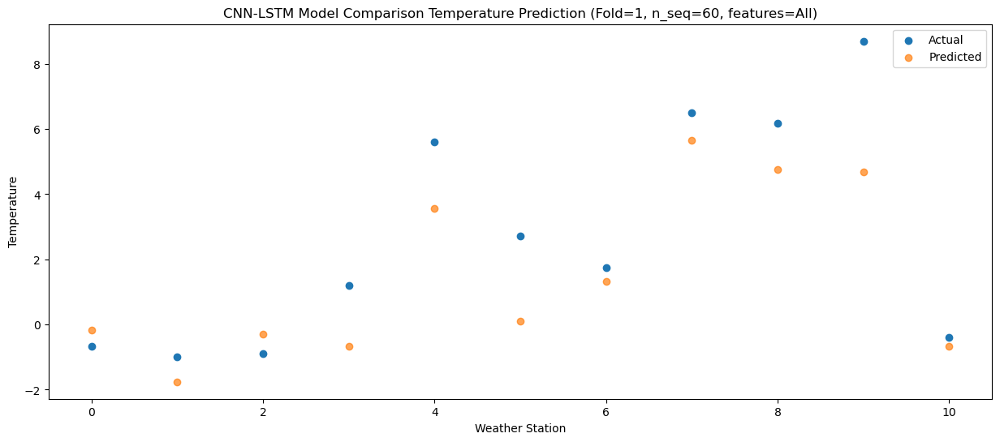

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -0.987955
1                 1   -1.90  -2.621465
2                 2   -0.47  -1.011204
3                 3   -0.23  -1.306864
4                 4    3.71   2.922185
5                 5    0.70  -0.955688
6                 6    1.02   0.423950
7                 7    5.89   4.848477
8                 8    4.32   3.783975
9                 9    7.34   3.334453
10               10   -3.21  -2.187713


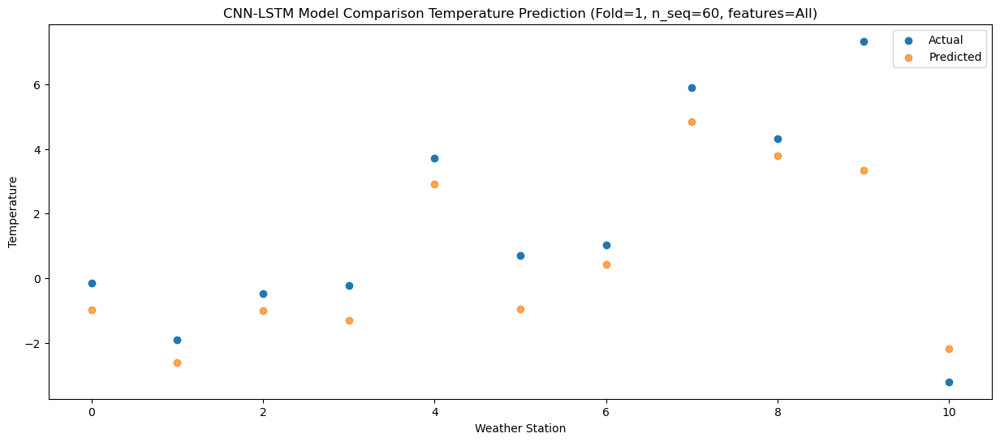

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -1.247965
1                 1   -3.01  -2.989156
2                 2   -1.00  -1.399855
3                 3    0.52  -1.728608
4                 4    4.52   2.475521
5                 5    0.04  -1.332863
6                 6    0.21   0.076411
7                 7    5.04   4.229752
8                 8    4.50   3.144492
9                 9    6.89   2.794010
10               10   -2.87  -2.539094


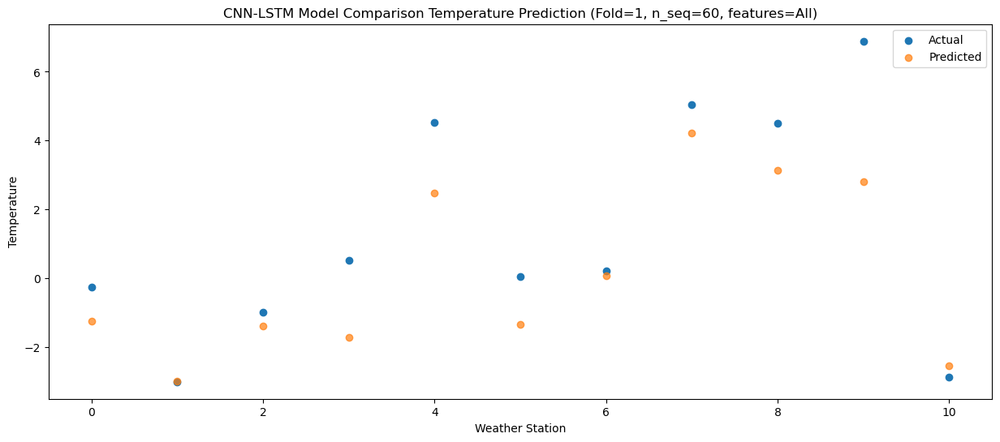

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -1.009445
1                 1   -2.92  -2.928910
2                 2   -0.72  -1.281234
3                 3   -0.01  -1.502032
4                 4    4.14   2.669226
5                 5   -0.48  -1.011600
6                 6    0.28   0.140115
7                 7    5.72   4.116788
8                 8    3.99   3.070987
9                 9    5.65   2.872846
10               10   -2.13  -2.679504


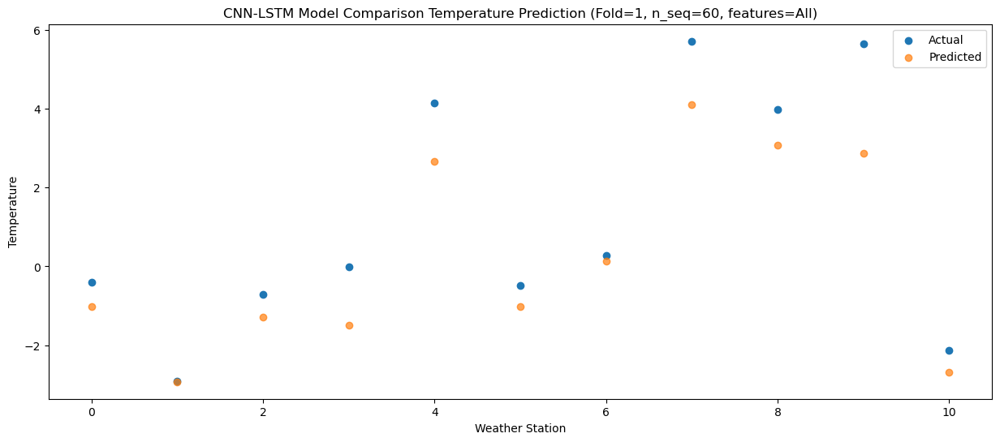

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   5.487778
1                 1    3.08   3.952965
2                 2    6.38   5.800215
3                 3    7.63   5.788893
4                 4   12.18  10.069631
5                 5    6.87   5.697209
6                 6    5.95   6.940978
7                 7   12.64  11.985707
8                 8   11.82  10.958300
9                 9   13.61  10.065362
10               10    2.19   3.549364


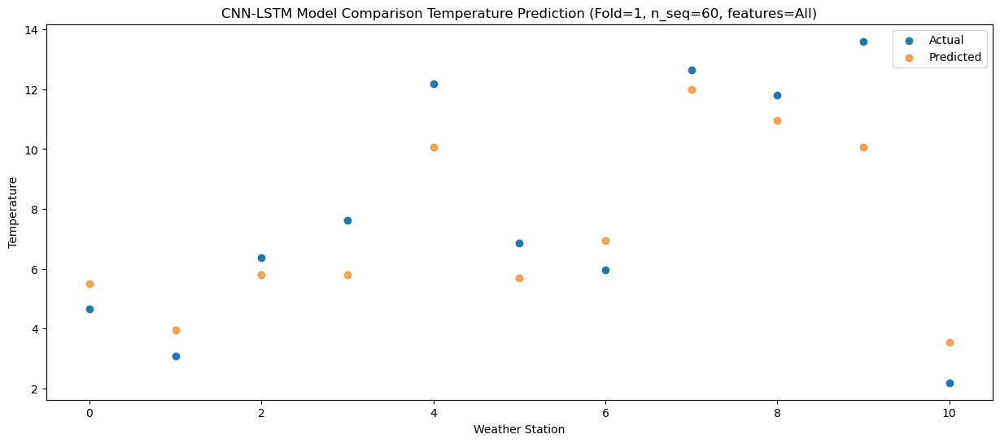

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.873324
1                 1    4.30   5.390778
2                 2    5.41   7.040995
3                 3    7.51   7.032730
4                 4   11.92  11.302776
5                 5    9.66   7.534583
6                 6    7.58   8.426788
7                 7   13.78  13.413272
8                 8   13.20  12.589026
9                 9   15.92  12.196786
10               10    3.82   5.885262


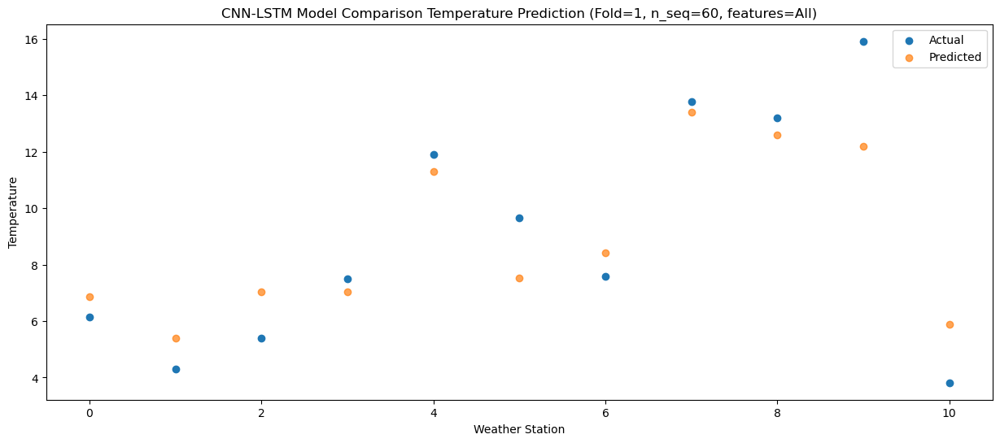

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  12.249222
1                 1    7.65  11.189676
2                 2    9.56  12.535050
3                 3   11.26  12.423656
4                 4   15.72  16.758244
5                 5   14.85  13.360000
6                 6   10.36  14.273213
7                 7   18.28  19.580700
8                 8   19.31  18.892938
9                 9   22.45  18.723451
10               10    9.28  13.008311


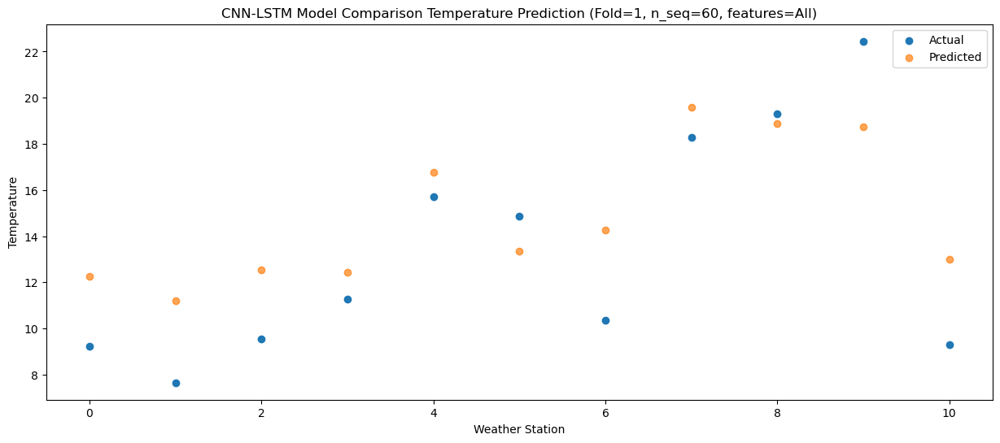

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  17.667562
1                 1   12.00  17.139496
2                 2   13.79  18.207195
3                 3   14.04  17.878964
4                 4   18.75  22.312652
5                 5   17.57  18.963093
6                 6   15.03  20.254015
7                 7   23.84  26.093100
8                 8   24.42  25.479056
9                 9   28.83  25.220857
10               10   16.60  20.029893


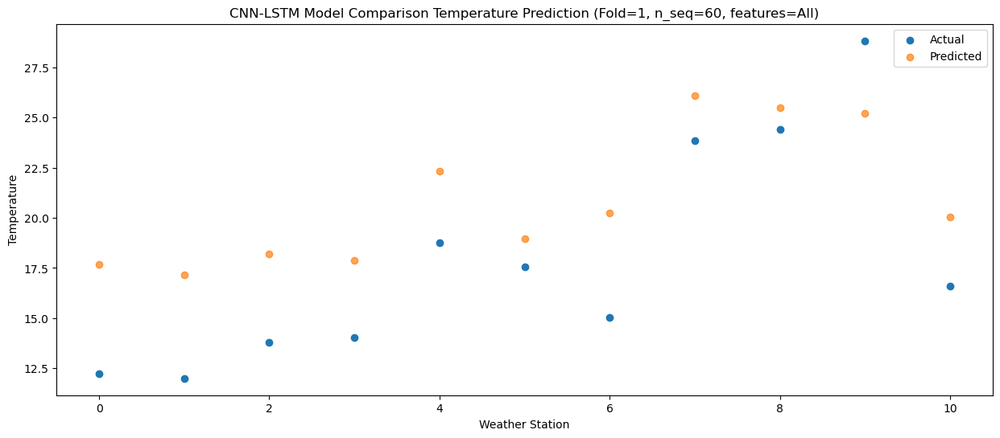

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  20.521361
1                 1   15.37  19.983715
2                 2   15.26  20.800725
3                 3   15.69  20.166119
4                 4   20.79  24.571515
5                 5   20.27  21.566928
6                 6   18.21  23.167697
7                 7   26.38  28.466736
8                 8   26.96  27.785603
9                 9   30.41  27.828933
10               10   20.47  23.701618


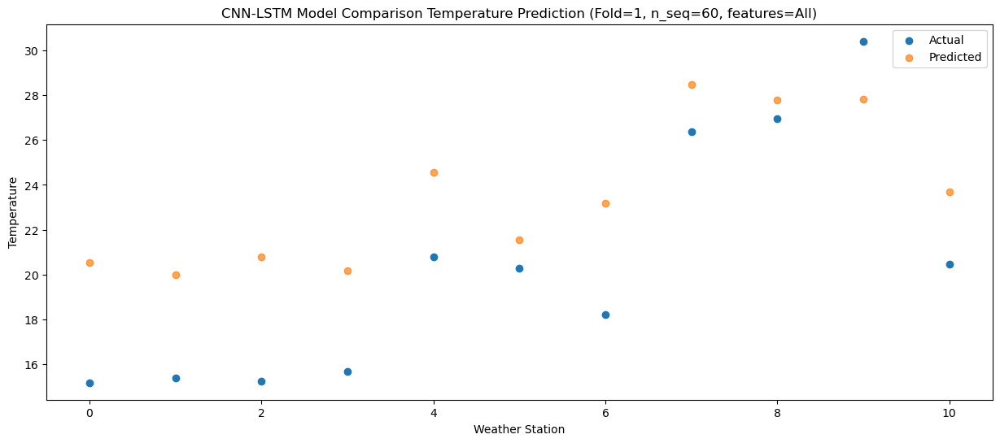

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  19.701899
1                 1   13.96  18.914308
2                 2   15.25  19.900859
3                 3   15.93  19.506555
4                 4   21.03  23.871302
5                 5   20.12  20.979986
6                 6   16.58  22.074808
7                 7   24.36  27.273960
8                 8   26.03  26.693808
9                 9   29.18  26.893109
10               10   18.28  22.123972


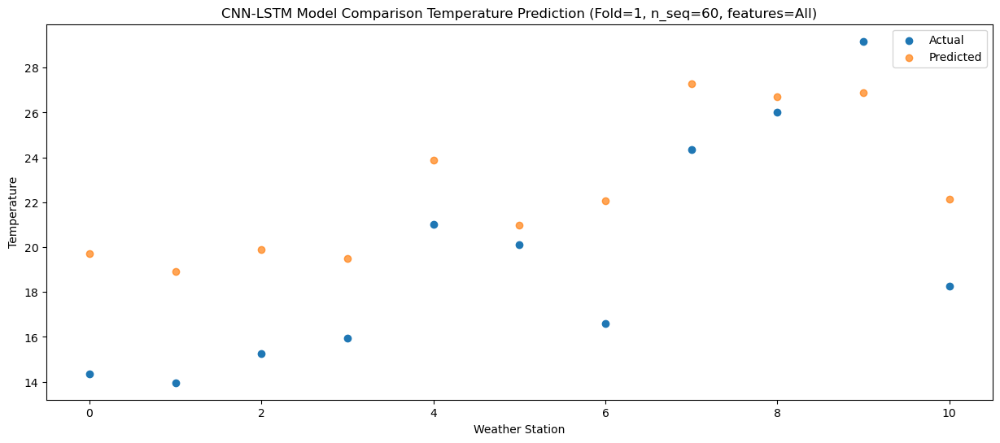

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  16.177137
1                 1   10.42  15.083519
2                 2   12.45  16.184242
3                 3   12.52  15.744189
4                 4   17.45  20.045639
5                 5   12.59  17.020180
6                 6   13.16  18.241346
7                 7   21.06  22.944278
8                 8   19.38  22.195966
9                 9   22.43  22.335975
10               10   13.75  17.705908


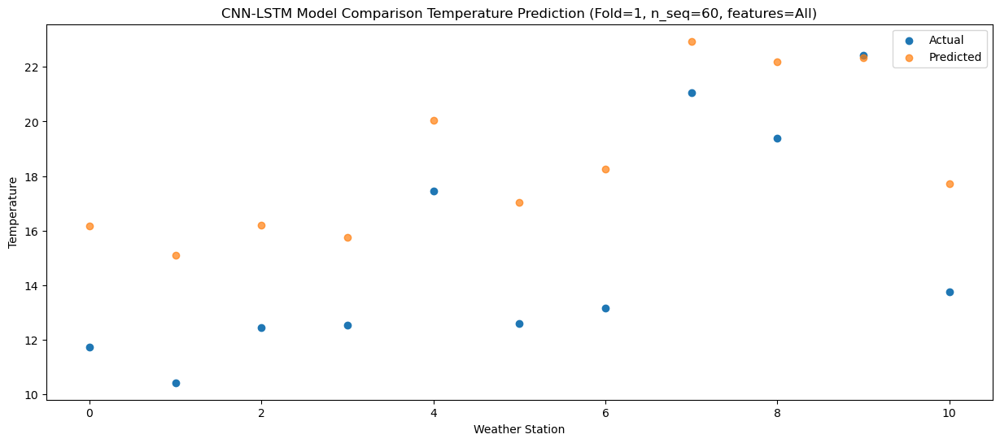

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79  11.403832
1                 1    6.70   9.839511
2                 2    8.10  11.100032
3                 3    7.98  10.547796
4                 4   12.51  14.759793
5                 5    9.75  11.470618
6                 6    9.67  12.994059
7                 7   14.29  16.895126
8                 8   13.20  15.833530
9                 9   15.83  15.817742
10               10    8.21  11.562737


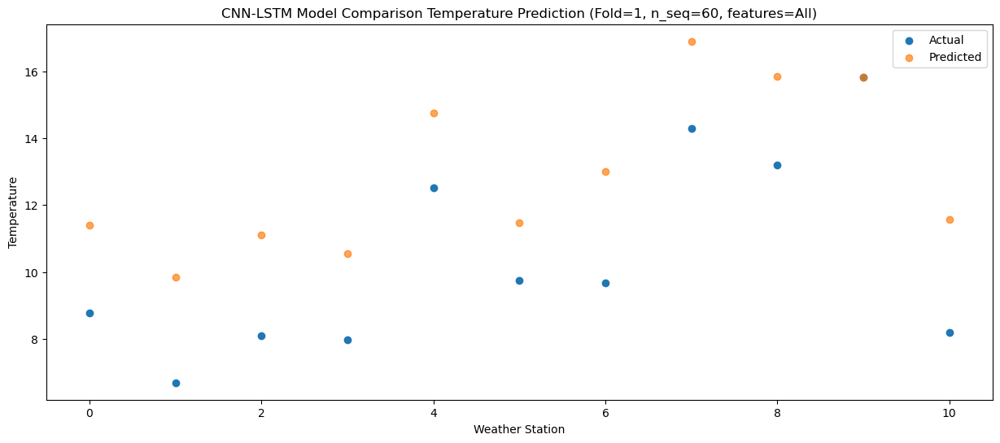

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   7.650648
1                 1    2.60   6.443788
2                 2    3.30   7.755356
3                 3    5.08   7.291661
4                 4    9.41  11.591551
5                 5    6.03   7.873342
6                 6    5.52   9.556378
7                 7   10.62  14.239823
8                 8   10.32  13.208388
9                 9   12.65  12.735796
10               10    4.01   8.052728


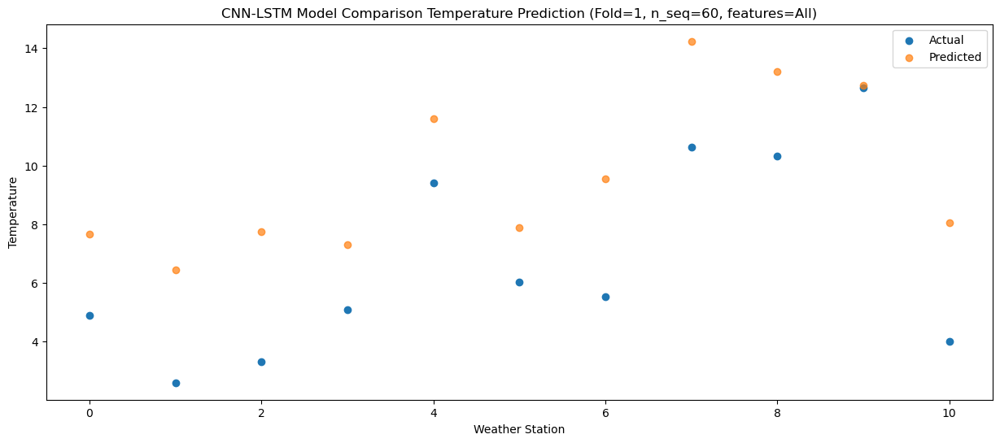

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95   0.296131
1                 1   -4.29  -1.094667
2                 2   -3.76   0.184942
3                 3   -1.10  -0.094409
4                 4    3.05   4.160077
5                 5   -0.72   0.941749
6                 6   -1.69   2.043179
7                 7    4.02   6.493704
8                 8    3.64   5.629808
9                 9    5.38   5.639686
10               10   -3.00   0.783470


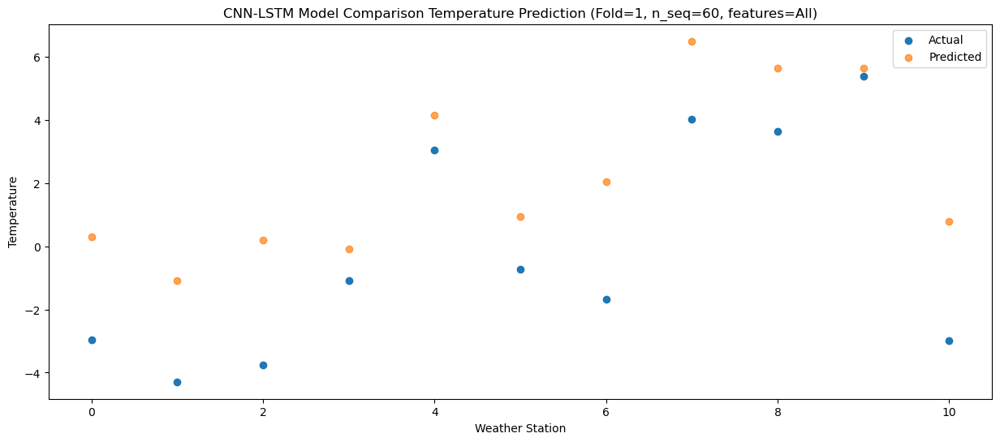

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -0.255183
1                 1   -4.49  -1.907144
2                 2   -3.34  -0.399289
3                 3   -1.20  -0.377191
4                 4    3.04   3.840825
5                 5   -2.23   0.572132
6                 6   -1.89   1.191452
7                 7    3.71   5.617574
8                 8    3.29   4.823319
9                 9    5.49   4.854458
10               10   -4.84  -0.802715


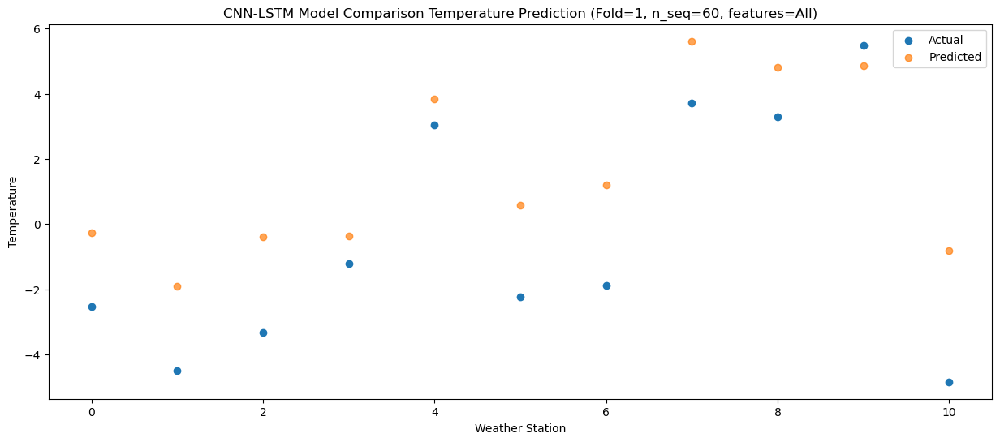

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -0.620759
1                 1   -3.83  -3.001235
2                 2   -2.85  -1.528582
3                 3   -2.79  -1.931249
4                 4    1.34   2.110723
5                 5   -1.85  -0.921470
6                 6   -1.11   0.160940
7                 7    0.71   2.890440
8                 8   -1.49   1.711693
9                 9    1.12   2.079761
10               10   -5.80  -2.242781


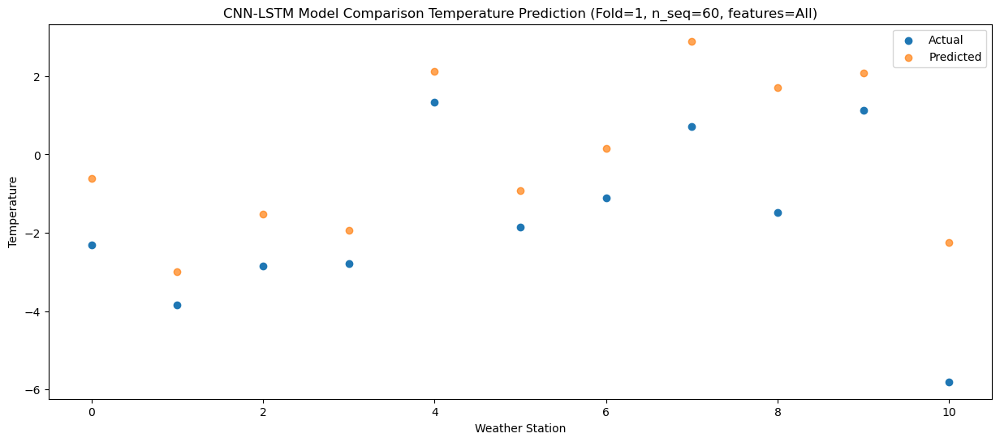

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   7.178051
1                 1    2.94   5.920767
2                 2    4.21   7.518510
3                 3    4.58   7.585573
4                 4    8.95  11.912634
5                 5    5.49   8.033026
6                 6    5.17   8.962932
7                 7   12.03  14.253253
8                 8   11.07  13.448733
9                 9   11.83  12.855997
10               10    1.42   6.612778


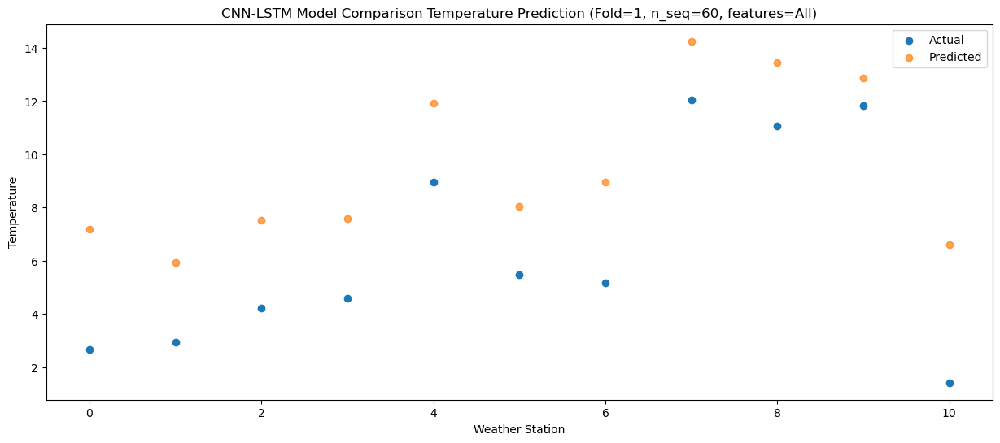

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48  11.044888
1                 1    5.08   9.814975
2                 2    5.61  11.024325
3                 3    6.92  10.714994
4                 4   11.25  15.004802
5                 5    7.76  11.752941
6                 6    7.74  12.958524
7                 7   13.74  17.630481
8                 8   12.87  16.823714
9                 9   15.59  16.761055
10               10    6.07  11.890608


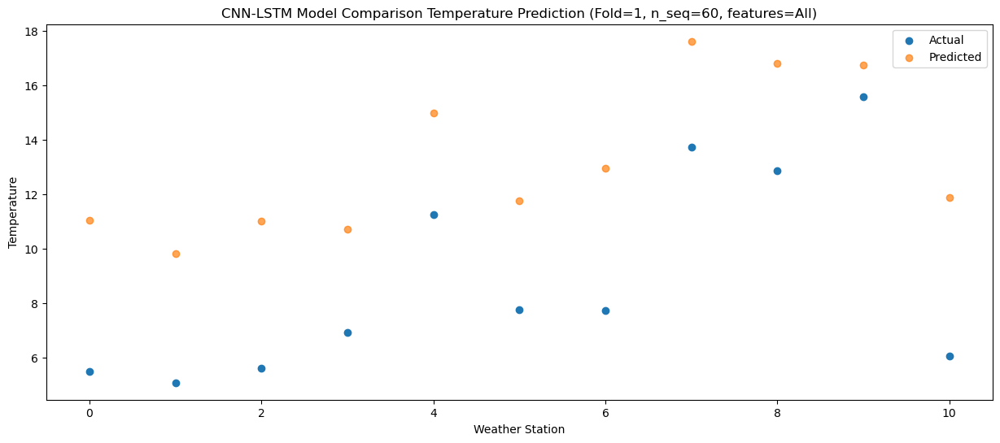

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  15.791062
1                 1    8.81  14.694815
2                 2    9.73  15.787510
3                 3   10.81  15.366266
4                 4   15.37  19.676076
5                 5   13.35  16.555276
6                 6   11.51  17.855135
7                 7   18.40  22.623680
8                 8   17.68  21.887378
9                 9   20.14  21.918830
10               10   10.61  17.206504


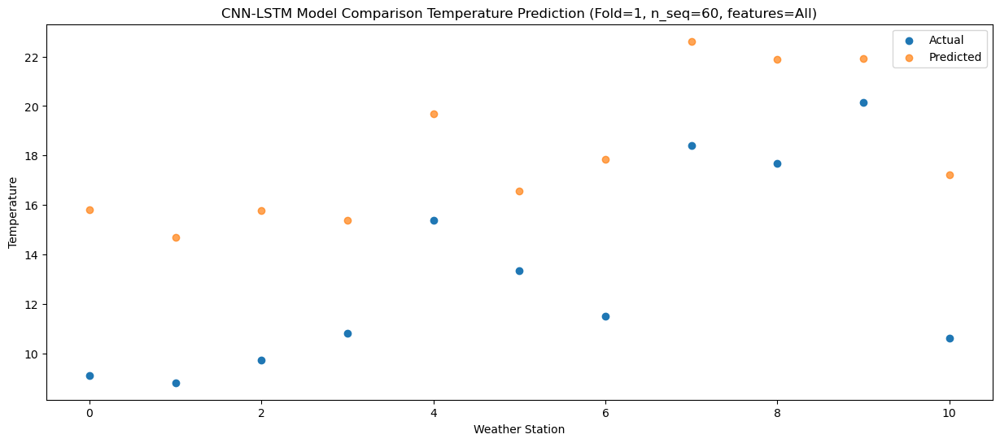

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  22.019562
1                 1   12.95  21.371985
2                 2   13.61  22.183974
3                 3   14.70  21.717937
4                 4   18.84  26.105414
5                 5   17.62  23.363402
6                 6   15.52  24.571118
7                 7   24.48  29.861660
8                 8   23.71  29.381045
9                 9   27.25  29.656705
10               10   16.70  25.123107


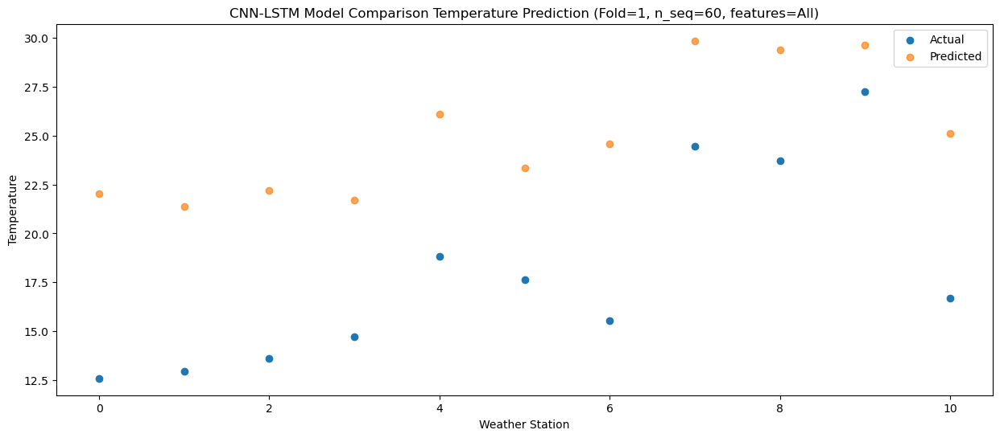

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  23.367841
1                 1   14.33  22.616697
2                 2   14.38  23.448843
3                 3   14.58  23.003501
4                 4   18.93  27.366820
5                 5   16.96  24.751130
6                 6   16.88  25.827046
7                 7   25.47  30.958544
8                 8   25.22  30.527699
9                 9   27.92  30.957497
10               10   18.93  26.313380


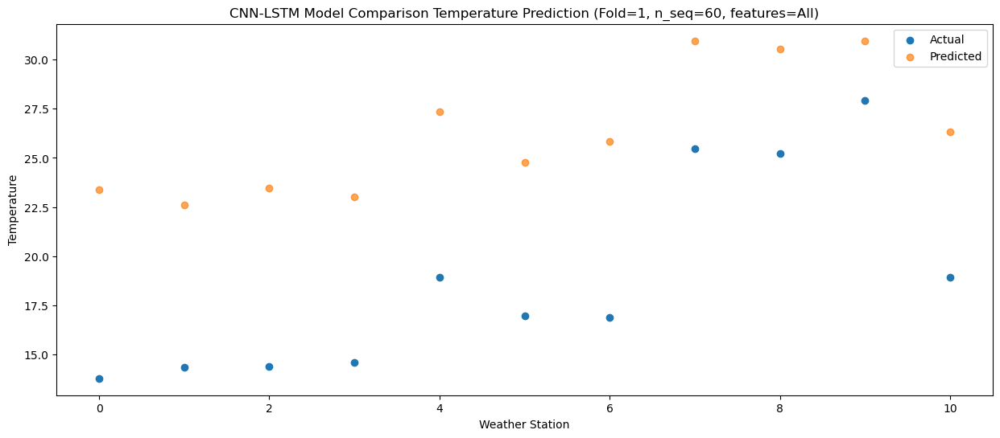

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  23.859367
1                 1   14.60  23.182891
2                 2   15.04  24.001591
3                 3   15.55  23.411979
4                 4   19.90  27.787724
5                 5   16.37  24.945867
6                 6   17.14  26.391174
7                 7   26.69  31.544263
8                 8   25.61  30.968433
9                 9   27.77  31.139937
10               10   18.71  26.830119


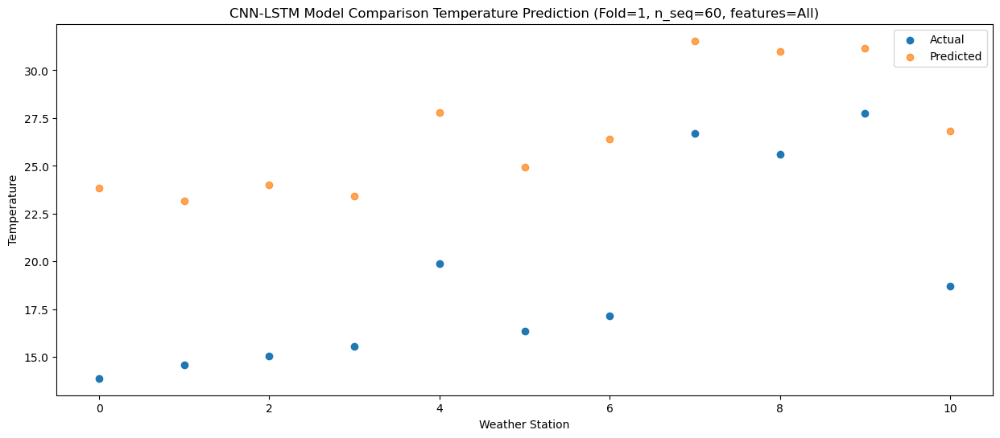

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  20.224508
1                 1   10.86  19.422922
2                 2   12.02  20.474659
3                 3   12.54  20.209659
4                 4   16.32  24.580409
5                 5   16.01  21.531274
6                 6   13.81  22.587428
7                 7   22.98  27.986917
8                 8   23.10  27.465195
9                 9   25.82  27.466446
10               10   15.01  22.320368


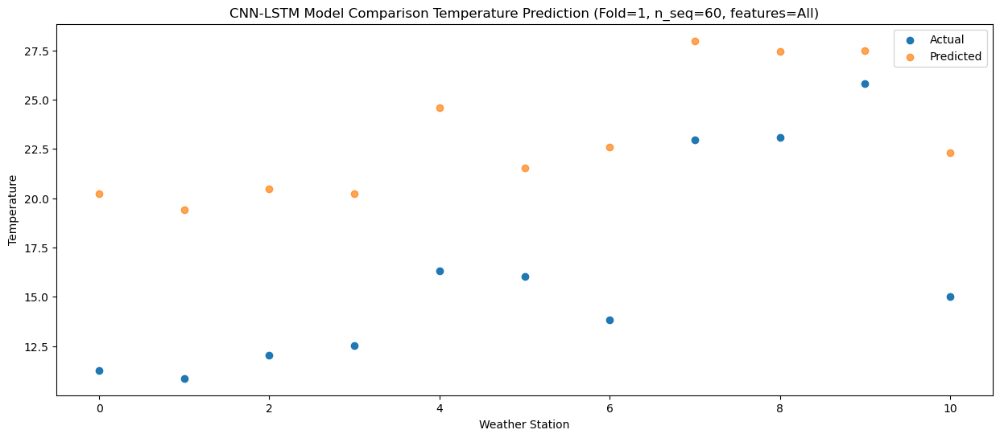

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  15.638080
1                 1    7.08  14.687276
2                 2    8.24  15.688810
3                 3    9.85  15.019820
4                 4   13.28  19.351767
5                 5   11.69  15.990628
6                 6    9.86  17.868287
7                 7   17.78  22.654458
8                 8   16.85  21.763426
9                 9   18.38  21.486021
10               10   10.59  17.352998


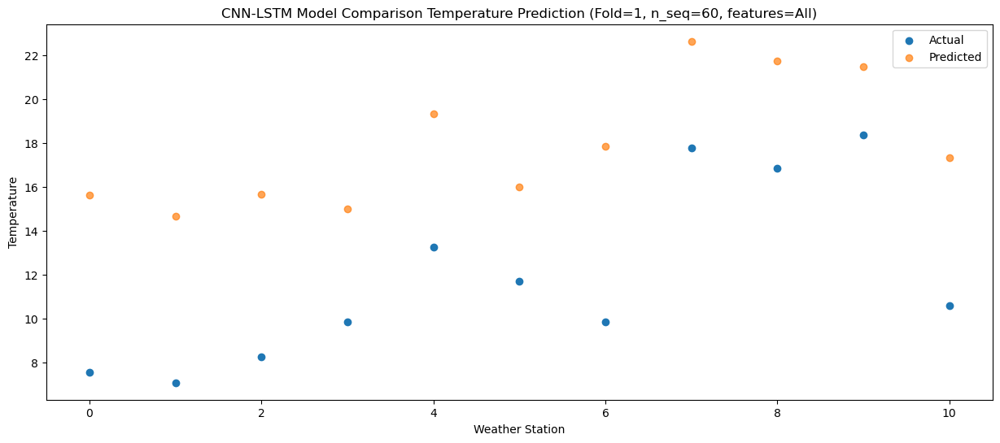

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   6.916378
1                 1   -0.58   5.522574
2                 2    0.50   6.781127
3                 3    2.69   6.714845
4                 4    5.73  10.964631
5                 5    5.22   8.067079
6                 6    2.26   8.677793
7                 7    8.48  13.365724
8                 8    9.10  12.774043
9                 9   12.13  13.026361
10               10    1.27   7.628037


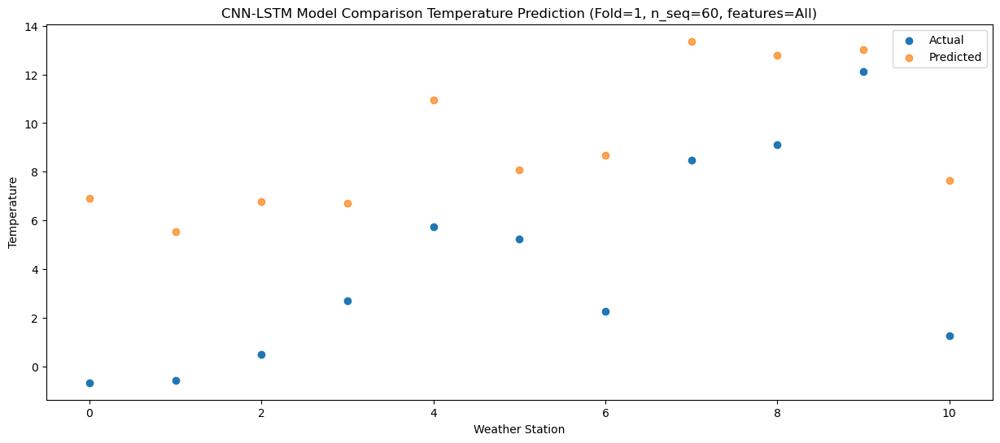

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   7.188349
1                 1    1.05   5.669152
2                 2    3.10   7.433639
3                 3    6.06   7.595187
4                 4    9.61  11.874190
5                 5    5.48   7.649563
6                 6    3.78   8.711135
7                 7   10.89  13.741598
8                 8    8.29  12.736307
9                 9   10.52  11.794117
10               10    0.50   5.618609


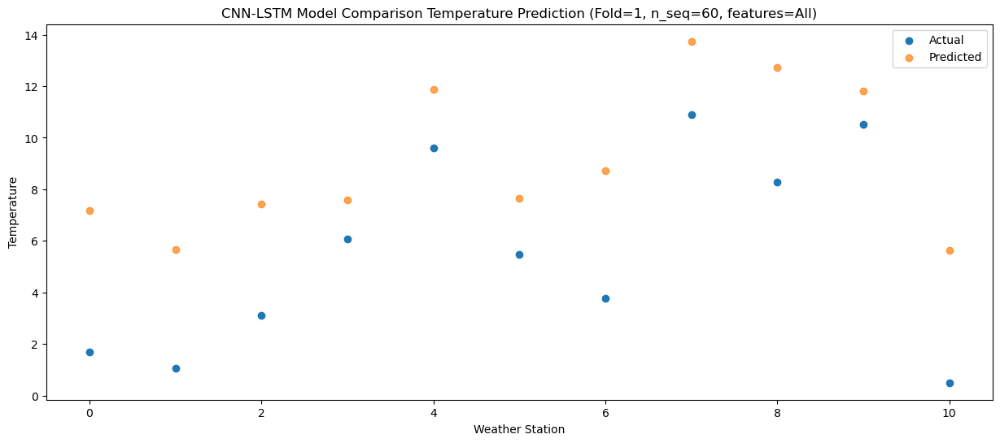

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48   0.341596
1                 1   -5.68  -1.760055
2                 2   -3.79  -0.011137
3                 3   -1.99   0.308841
4                 4    1.13   4.442491
5                 5   -1.84   1.198623
6                 6   -2.61   1.337894
7                 7    2.06   5.458283
8                 8    0.67   4.727635
9                 9    3.60   4.824024
10               10   -6.52  -1.560909


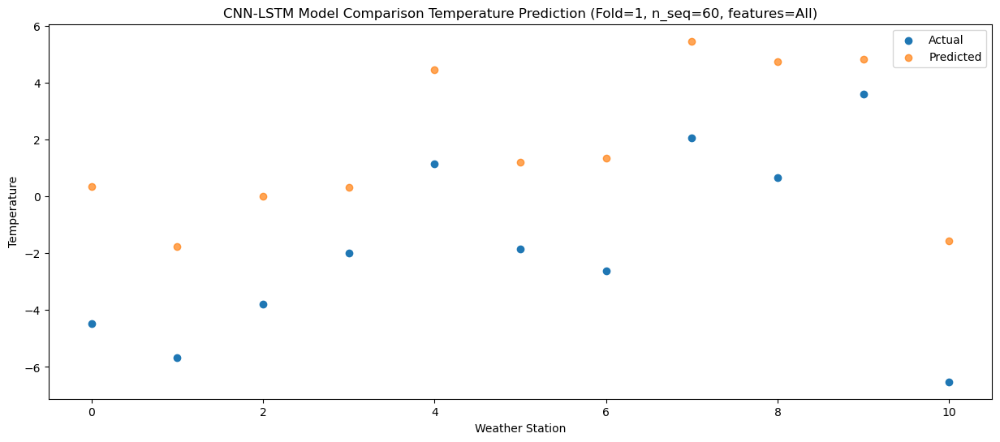

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36   3.968437
1                 1   -1.45   1.817664
2                 2   -0.44   3.336620
3                 3   -2.46   3.117845
4                 4    0.82   7.214053
5                 5   -1.95   3.973623
6                 6    1.20   4.974926
7                 7    4.11   8.395701
8                 8    1.65   7.386999
9                 9    3.66   7.455076
10               10   -2.62   2.505094


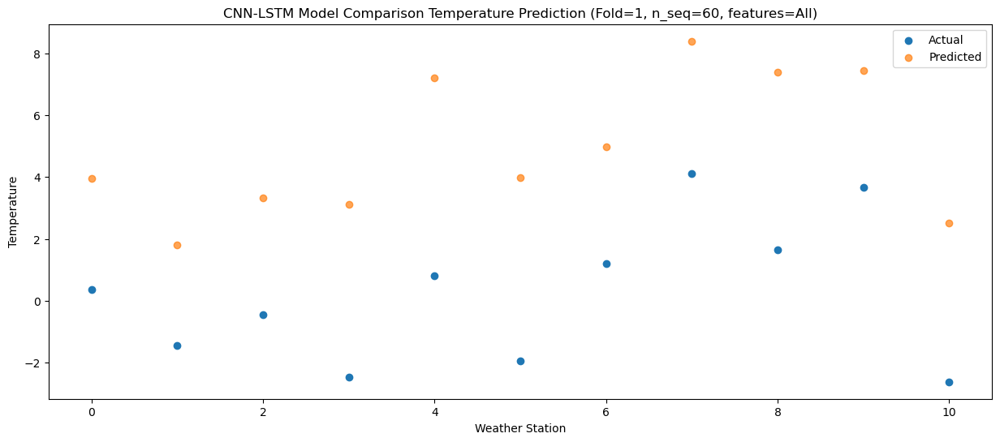

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   9.115285
1                 1    2.12   7.408801
2                 2    3.56   8.897552
3                 3    3.38   8.815073
4                 4    6.60  13.010301
5                 5    5.00   9.674921
6                 6    5.04  10.537368
7                 7   10.06  14.824979
8                 8    8.90  13.989436
9                 9   10.59  13.892381
10               10    1.94   8.415675


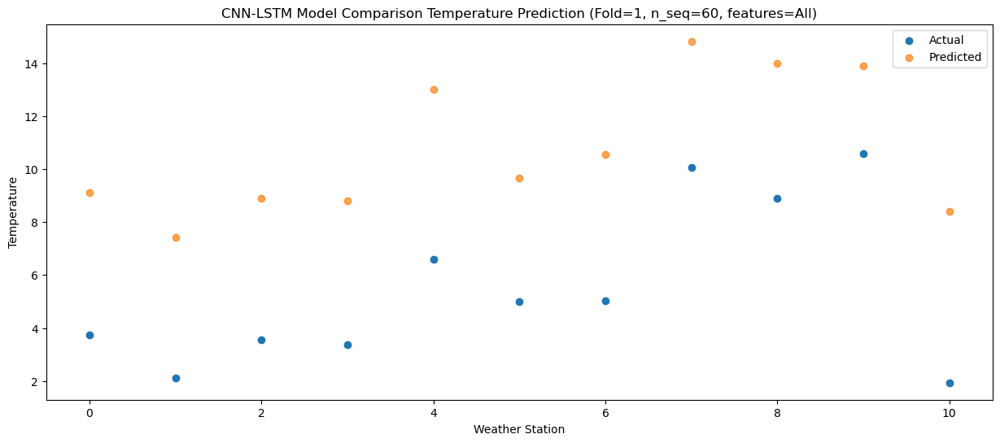

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74  13.356024
1                 1    5.12  11.927624
2                 2    7.15  13.487375
3                 3    9.38  13.574218
4                 4   12.87  17.837393
5                 5   11.91  14.211711
6                 6    7.80  15.016913
7                 7   15.25  19.973542
8                 8   16.01  19.186571
9                 9   17.07  18.753532
10               10    5.29  12.831999


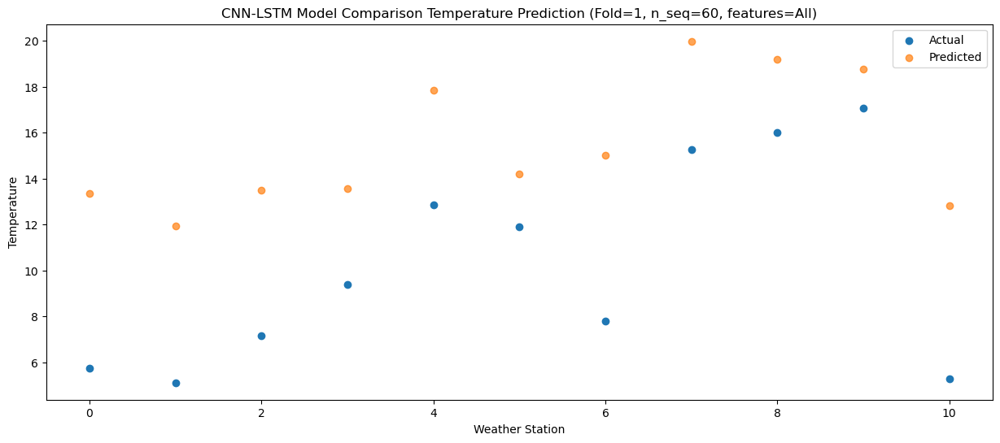

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  19.920284
1                 1   11.00  18.983972
2                 2   12.51  20.139167
3                 3   13.81  19.780297
4                 4   17.49  24.112990
5                 5   17.31  20.672236
6                 6   13.72  22.134642
7                 7   20.72  27.267429
8                 8   21.37  26.490183
9                 9   22.52  26.127195
10               10   12.27  21.309912


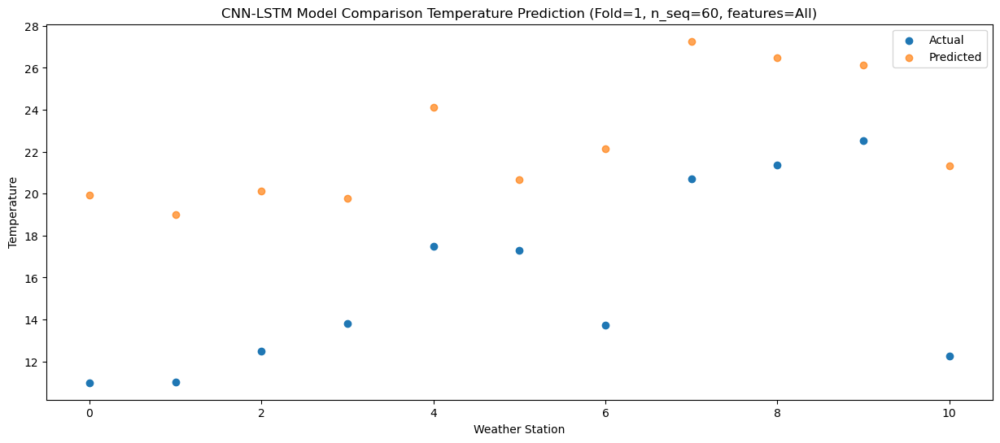

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  24.290311
1                 1   14.97  23.481219
2                 2   15.48  24.625550
3                 3   16.81  24.473409
4                 4   20.86  28.832966
5                 5   19.37  25.589518
6                 6   17.30  26.624400
7                 7   24.78  32.141718
8                 8   25.66  31.585280
9                 9   27.09  31.384811
10               10   16.66  26.069220


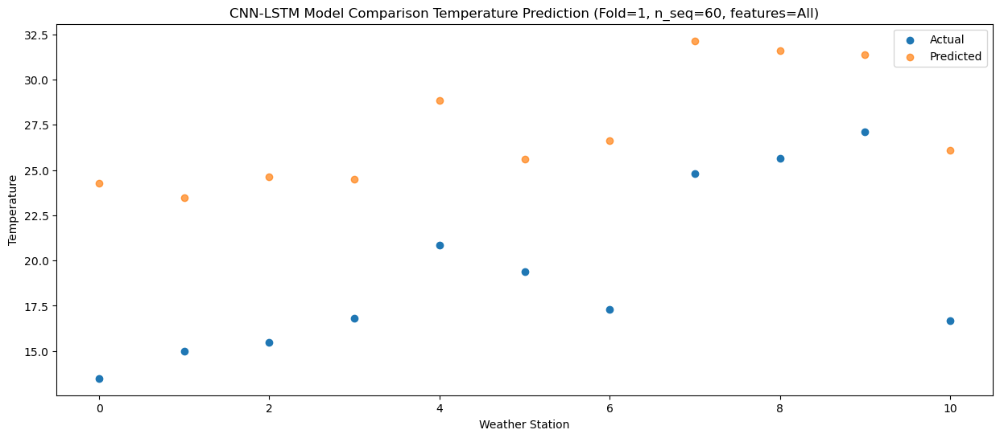

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  25.406659
1                 1   15.47  24.749372
2                 2   16.19  25.726568
3                 3   17.75  25.580864
4                 4   21.95  29.960388
5                 5   20.29  27.038295
6                 6   18.04  27.936835
7                 7   28.91  33.529882
8                 8   29.81  33.129762
9                 9   30.69  33.191132
10               10   20.60  28.087054


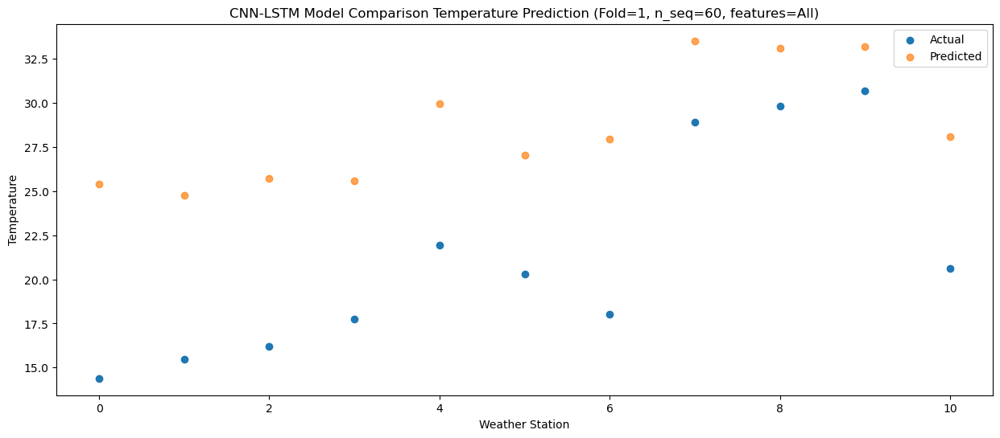

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  23.713246
1                 1   14.01  22.848473
2                 2   14.58  23.592133
3                 3   16.11  23.114051
4                 4   19.94  27.415751
5                 5   17.44  24.993614
6                 6   16.54  26.110513
7                 7   26.04  30.909975
8                 8   27.14  30.486855
9                 9   27.86  31.057141
10               10   20.06  26.880165


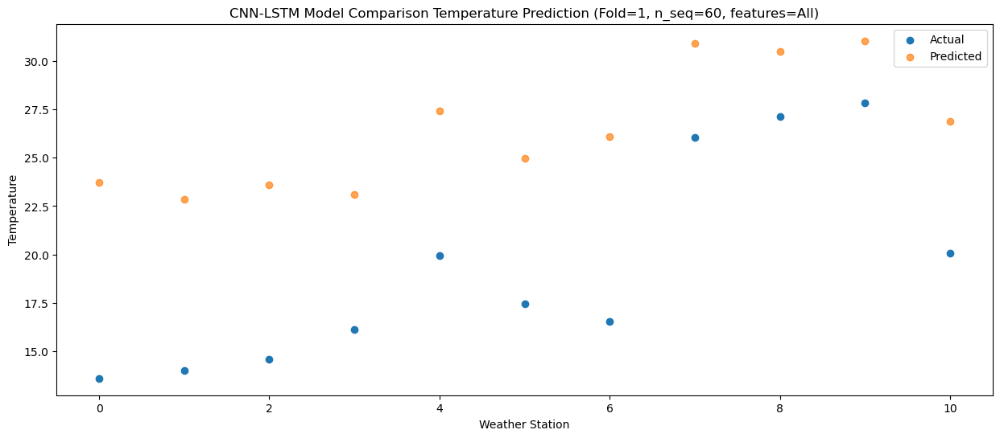

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  20.641137
1                 1   10.92  19.522285
2                 2   12.19  20.531065
3                 3   13.34  20.286832
4                 4   16.76  24.550616
5                 5   14.39  21.918530
6                 6   13.65  22.734647
7                 7   22.20  27.500509
8                 8   23.31  27.045364
9                 9   25.45  27.488594
10               10   15.15  22.597084


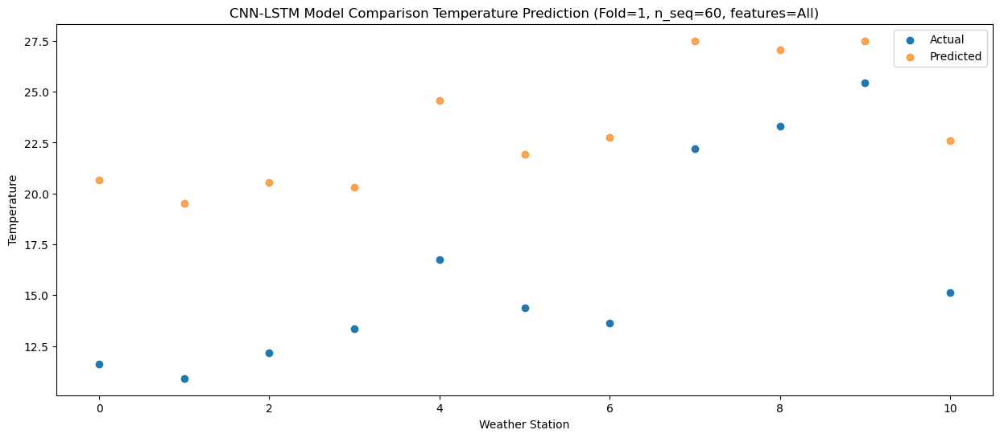

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08  13.474265
1                 1    4.58  12.163307
2                 2    5.50  13.212354
3                 3    7.78  12.928625
4                 4   11.37  17.146190
5                 5    8.31  14.511075
6                 6    7.31  15.382038
7                 7   15.53  19.807442
8                 8   15.08  19.265390
9                 9   16.91  19.728782
10               10    7.05  15.015461


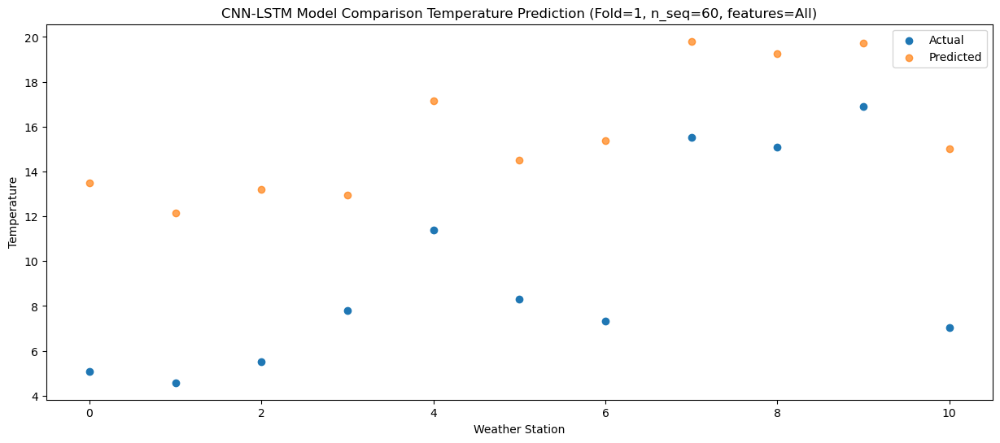

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   8.708072
1                 1    1.58   7.121265
2                 2    2.18   8.023937
3                 3    2.73   6.957884
4                 4    6.37  11.095492
5                 5    1.35   7.972863
6                 6    4.42  10.393553
7                 7    8.93  13.607799
8                 8    7.23  12.428133
9                 9    7.92  12.466847
10               10    3.54   9.773386


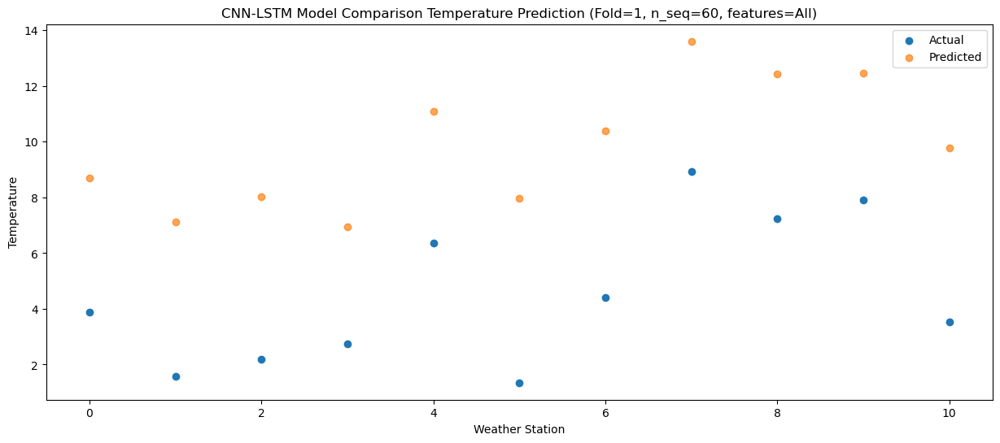

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88   4.004943
1                 1   -4.23   2.193160
2                 2   -0.98   3.526738
3                 3    0.64   3.190035
4                 4    4.35   7.316466
5                 5    0.23   3.995063
6                 6   -1.59   5.384045
7                 7    5.19   8.979288
8                 8    3.60   7.904138
9                 9    5.57   7.809056
10               10   -3.61   3.636702


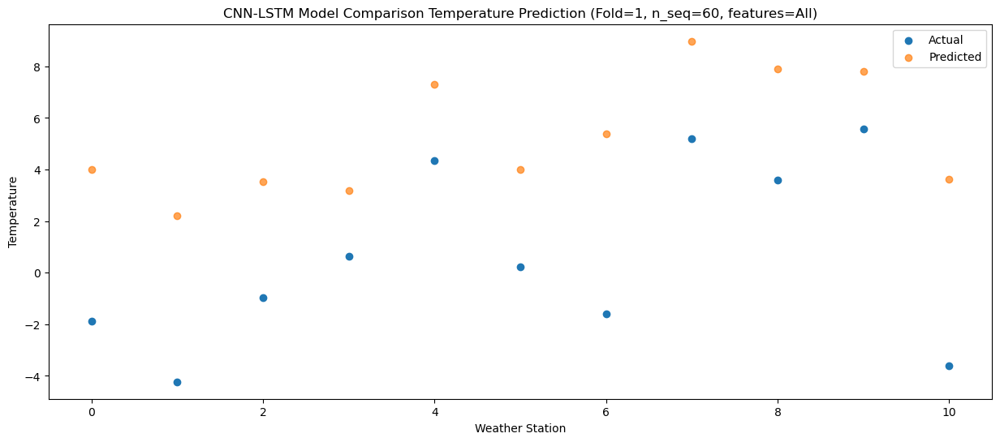

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23   5.337933
1                 1   -2.04   3.511321
2                 2    0.02   4.743875
3                 3    1.35   4.250158
4                 4    4.83   8.361328
5                 5    0.69   5.152209
6                 6    0.54   6.731742
7                 7    6.38  10.137515
8                 8    4.46   9.050038
9                 9    5.85   9.059143
10               10   -0.65   5.230337


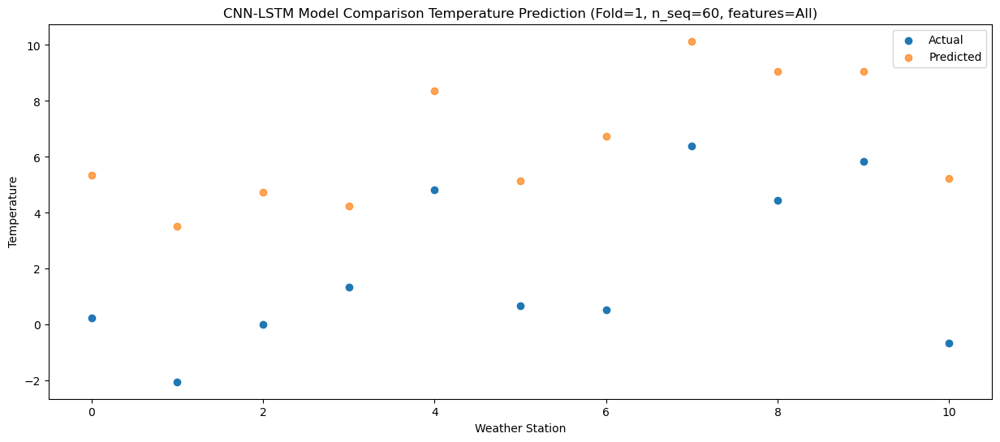

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   6.593286
1                 1    1.33   4.654629
2                 2    2.61   6.169293
3                 3    2.35   5.807620
4                 4    6.01   9.923305
5                 5    0.83   6.204662
6                 6    4.13   7.805547
7                 7    7.88  11.459810
8                 8    4.83  10.309655
9                 9    7.00   9.905929
10               10   -0.97   5.222337


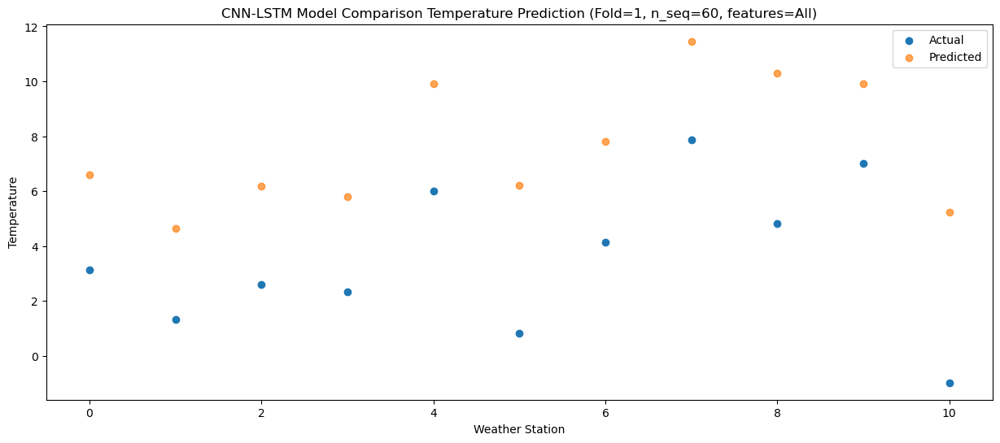

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   8.851194
1                 1    2.10   7.062050
2                 2    4.04   8.699571
3                 3    6.18   8.705892
4                 4    9.83  12.869720
5                 5    5.89   9.096674
6                 6    4.80  10.169042
7                 7   10.71  14.460966
8                 8    9.26  13.458312
9                 9   10.73  12.950390
10               10    0.15   7.480930


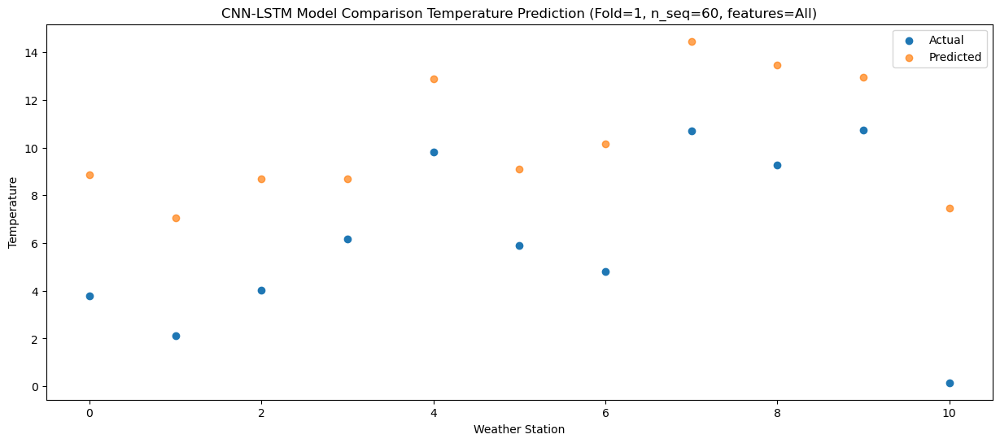

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28  14.748697
1                 1    5.37  13.397367
2                 2    6.73  14.429560
3                 3    7.02  13.869246
4                 4   10.79  18.068315
5                 5    9.05  15.047525
6                 6    8.06  16.626122
7                 7   15.11  20.706859
8                 8   13.59  19.832928
9                 9   16.08  19.907888
10               10    7.37  16.041867


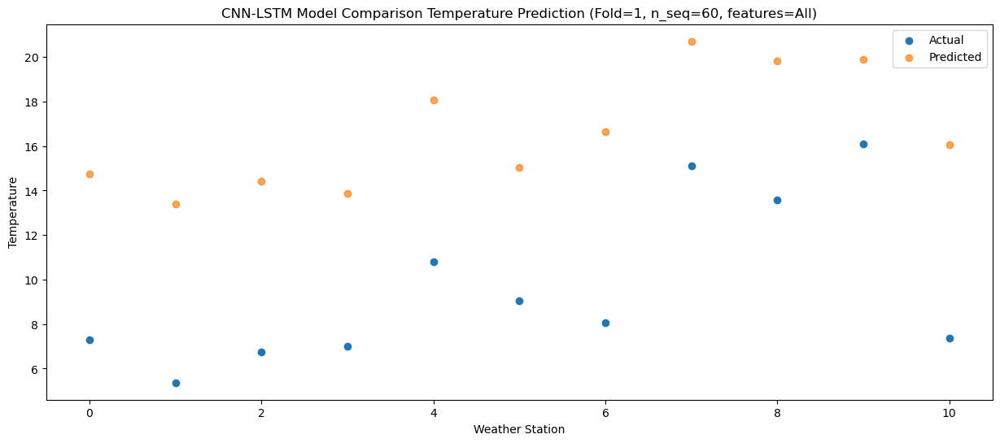

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  19.411436
1                 1    8.65  18.456791
2                 2    9.97  19.558871
3                 3   11.61  19.414247
4                 4   15.43  23.705214
5                 5   13.66  20.829446
6                 6   11.06  21.638520
7                 7   20.46  26.814995
8                 8   19.28  26.341428
9                 9   21.19  26.496189
10               10    9.93  21.324296


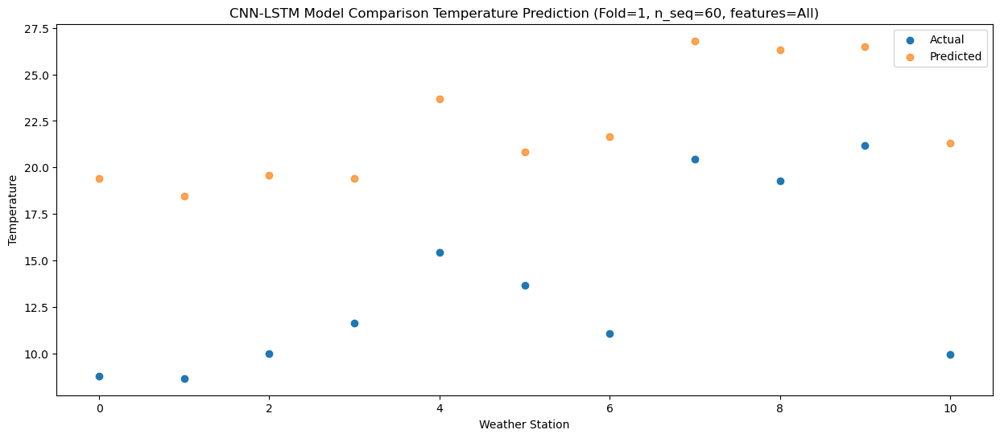

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  22.997630
1                 1   11.84  22.265323
2                 2   13.72  23.318598
3                 3   15.76  23.162340
4                 4   20.32  27.494663
5                 5   20.35  24.523858
6                 6   14.34  25.444653
7                 7   24.27  30.953091
8                 8   24.21  30.494967
9                 9   24.42  30.495065
10               10   14.30  25.403895


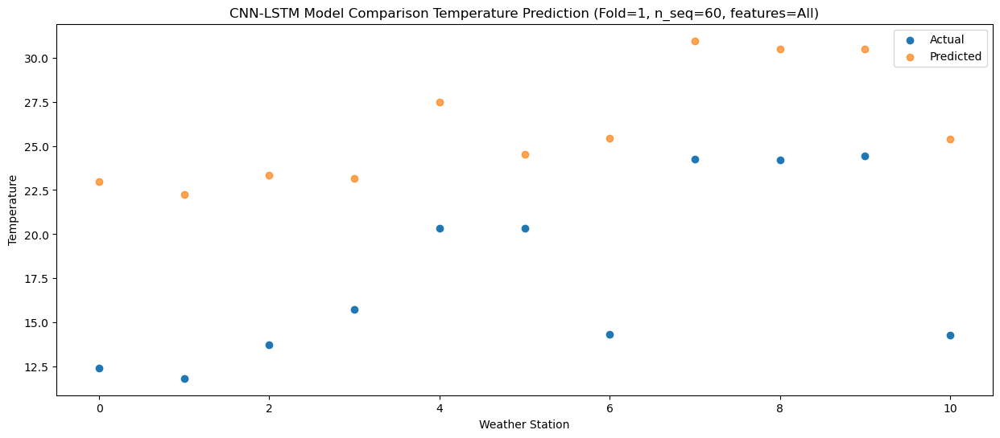

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  26.733310
1                 1   15.44  25.808416
2                 2   16.09  26.610240
3                 3   17.48  26.201531
4                 4   22.27  30.463146
5                 5   21.45  28.029533
6                 6   17.79  29.073251
7                 7   26.57  33.735239
8                 8   27.09  33.205899
9                 9   29.04  33.699624
10               10   19.44  29.785201


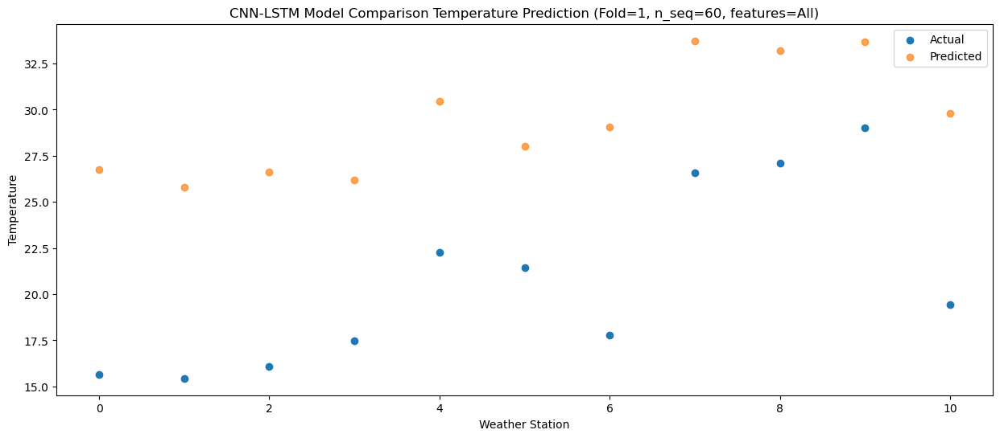

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  24.966298
1                 1   14.90  23.970739
2                 2   16.53  25.157038
3                 3   19.45  25.251753
4                 4   23.70  29.534045
5                 5   20.64  26.652540
6                 6   17.37  27.145777
7                 7   27.07  32.456335
8                 8   28.90  32.038055
9                 9   29.44  32.159581
10               10   17.70  26.710968


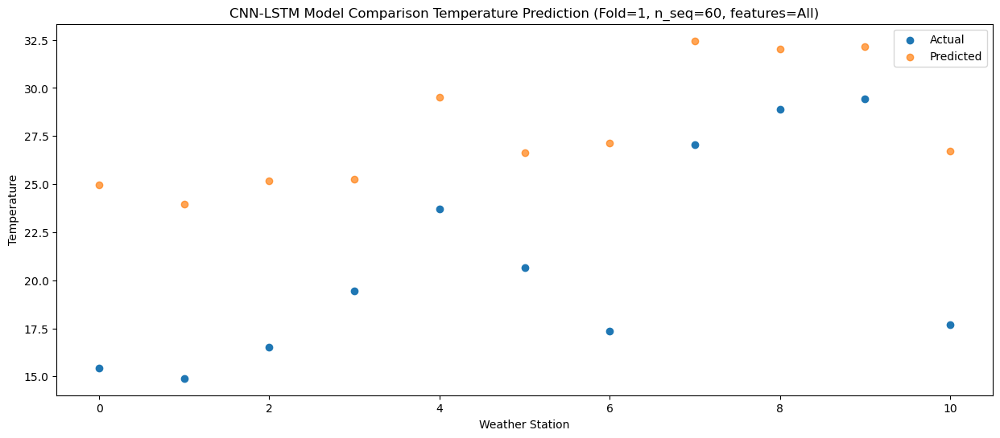

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  22.022722
1                 1   11.39  21.081670
2                 2   13.57  22.106788
3                 3   16.37  21.973270
4                 4   19.85  26.252524
5                 5   18.36  23.417472
6                 6   14.20  24.293910
7                 7   23.45  29.392939
8                 8   24.26  28.885396
9                 9   25.92  29.012782
10               10   14.51  24.298567


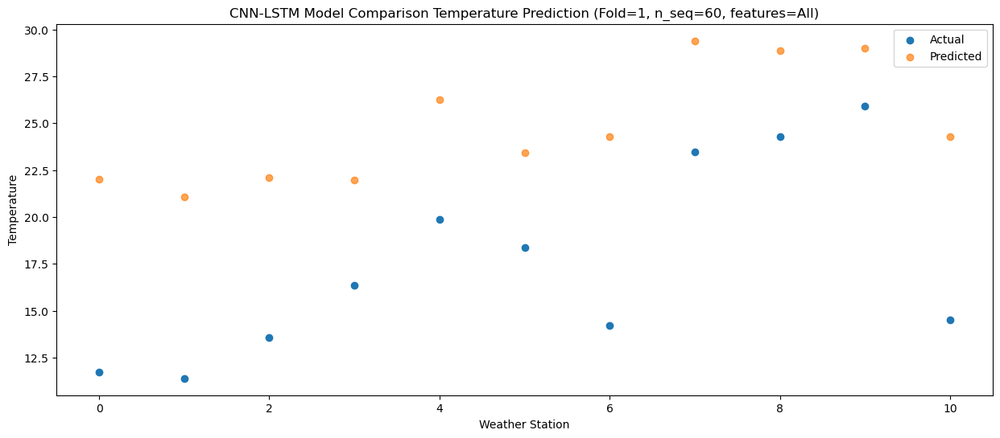

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85  16.059502
1                 1    6.38  14.801257
2                 2    7.53  15.680172
3                 3    9.11  15.192700
4                 4   12.45  19.381324
5                 5   10.76  16.782531
6                 6    9.19  18.076877
7                 7   17.14  22.141603
8                 8   15.68  21.387296
9                 9   17.82  21.746885
10               10    9.16  18.284877


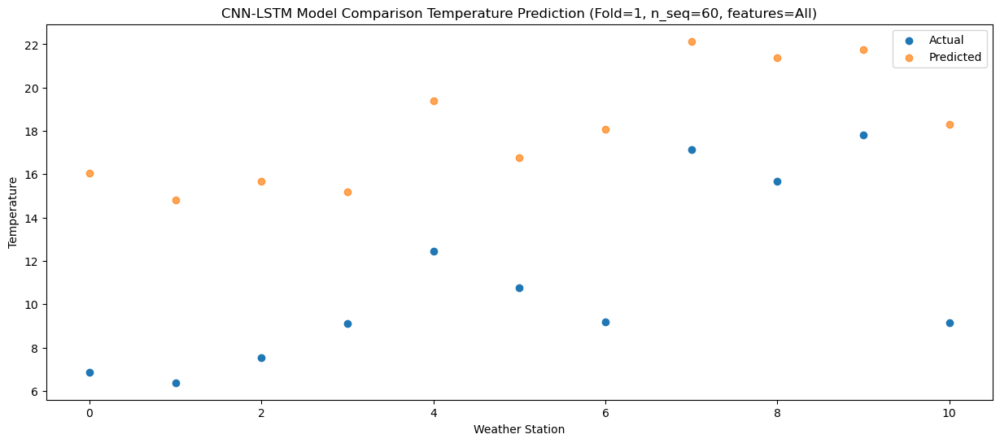

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   9.001156
1                 1    0.76   7.532058
2                 2    0.97   8.656574
3                 3    2.83   8.453592
4                 4    6.25  12.618676
5                 5    4.10   9.863333
6                 6    3.50  10.758764
7                 7    9.74  14.942556
8                 8    8.56  14.254511
9                 9   11.07  14.546196
10               10    1.22  10.147137


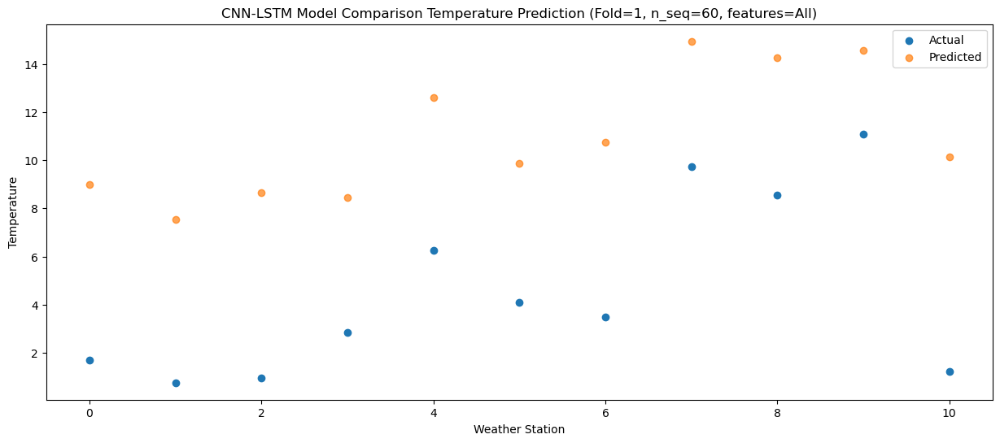

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   7.237345
1                 1   -2.38   5.790027
2                 2   -1.81   6.600477
3                 3    0.43   5.989583
4                 4    4.35  10.121824
5                 5    1.74   7.713146
6                 6    0.76   9.099552
7                 7    6.82  12.680817
8                 8    5.71  11.884057
9                 9    7.24  12.464226
10               10   -0.47   9.404396


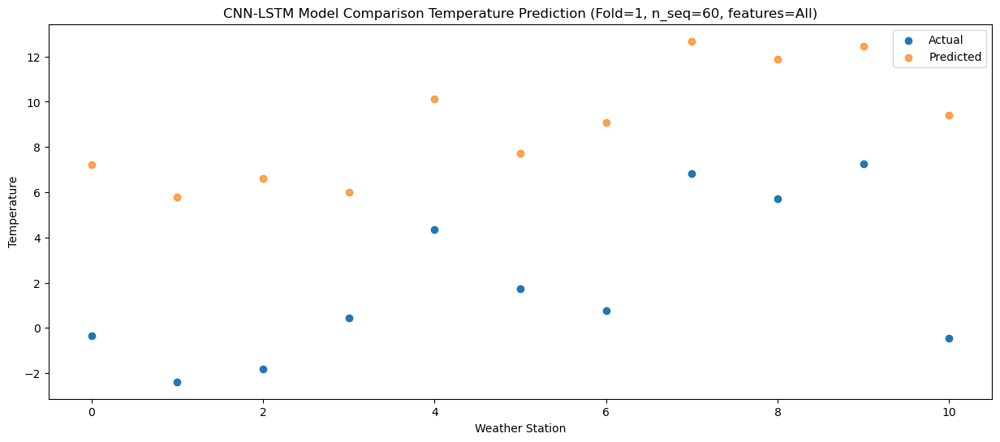

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65   3.674642
1                 1   -5.66   1.600319
2                 2   -4.89   2.437304
3                 3   -2.99   1.604295
4                 4    0.50   5.590485
5                 5   -1.87   3.434114
6                 6   -2.24   4.954223
7                 7    0.89   7.237836
8                 8   -0.12   6.203419
9                 9    2.07   7.129688
10               10   -4.37   4.833568


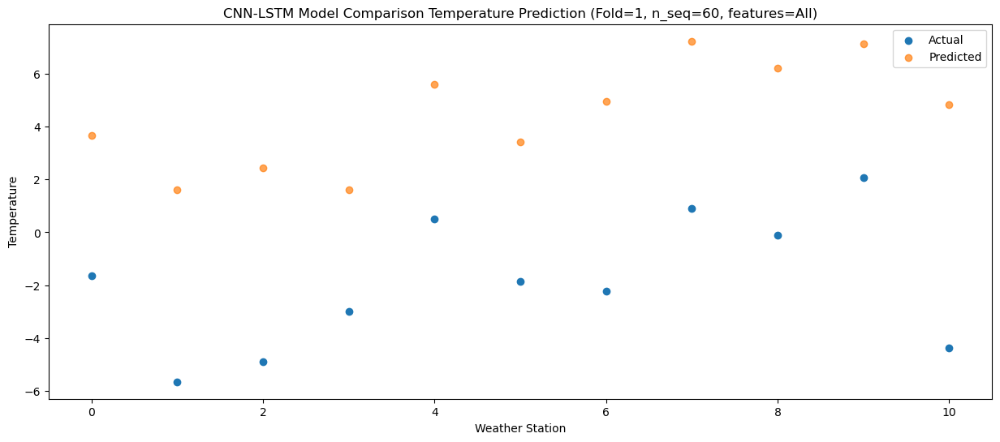

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   7.928358
1                 1   -0.58   6.497373
2                 2    0.45   7.854891
3                 3    3.32   8.106868
4                 4    6.87  12.306218
5                 5    4.25   9.321948
6                 6    1.97   9.674363
7                 7    9.89  14.398992
8                 8    7.83  13.791369
9                 9    9.78  13.861361
10               10   -2.42   8.480420


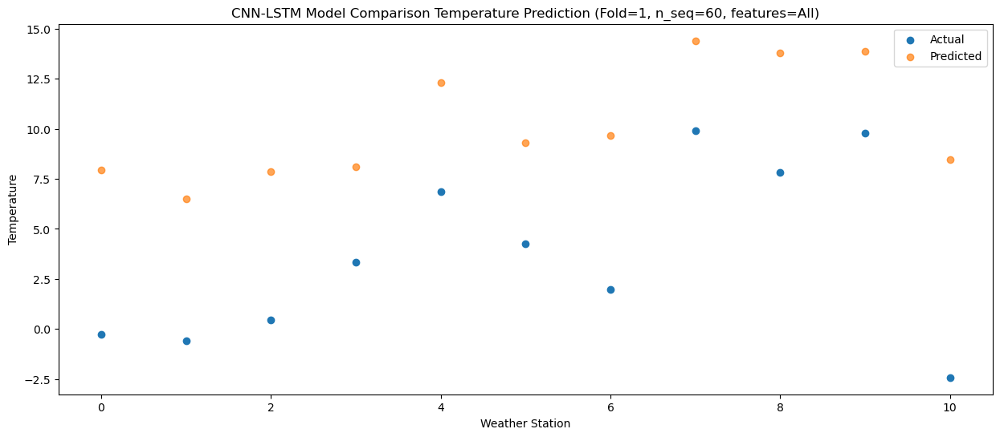

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58  12.016350
1                 1    2.64  10.558990
2                 2    3.55  11.814855
3                 3    5.83  11.764261
4                 4    9.61  15.945530
5                 5    6.60  12.829798
6                 6    5.63  13.765380
7                 7   12.61  18.121025
8                 8   11.07  17.306274
9                 9   12.61  17.251447
10               10    1.98  12.680310


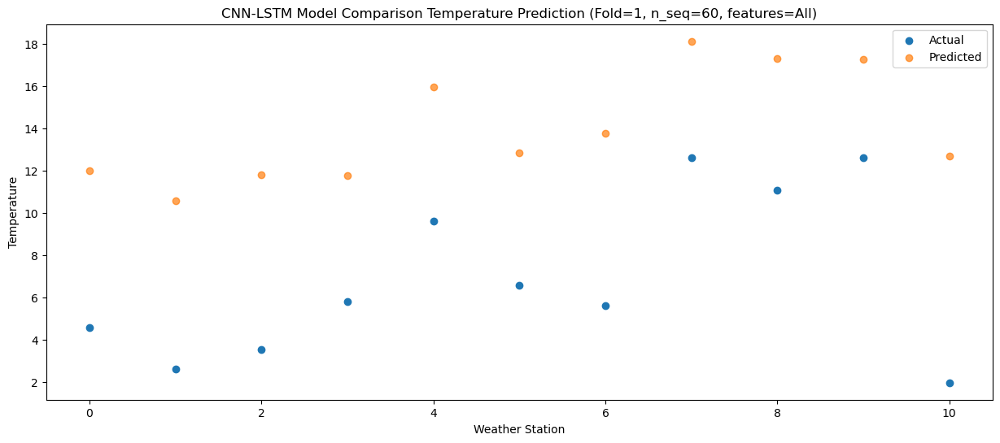

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98  16.904526
1                 1    6.31  15.719748
2                 2    6.89  16.834105
3                 3    9.31  16.678024
4                 4   13.17  20.911682
5                 5   11.40  17.930344
6                 6    9.10  18.938105
7                 7   16.65  23.593958
8                 8   15.75  22.897337
9                 9   17.68  22.922391
10               10    6.37  18.397818


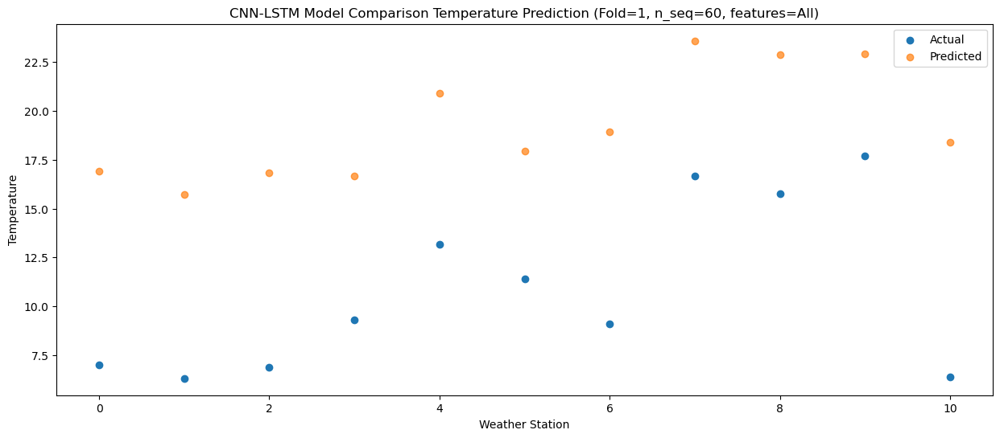

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  22.652761
1                 1   10.88  21.692825
2                 2   12.50  22.561611
3                 3   13.01  22.068606
4                 4   16.87  26.325599
5                 5   17.02  23.452832
6                 6   13.34  24.952827
7                 7   22.19  29.515404
8                 8   20.51  28.747333
9                 9   21.82  28.802577
10               10   11.96  25.149193


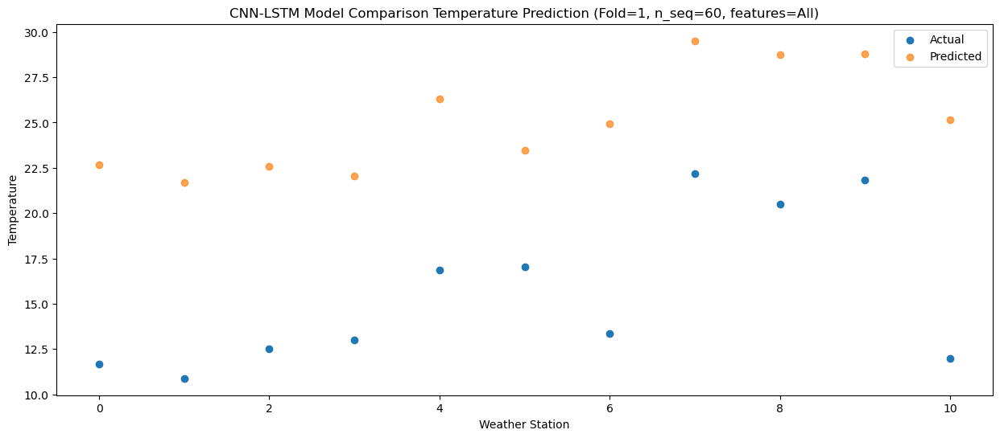

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  27.553320
1                 1   14.64  26.718423
2                 2   15.61  27.452284
3                 3   15.64  27.040096
4                 4   19.76  31.310567
5                 5   19.88  28.804501
6                 6   17.27  30.010049
7                 7   25.26  34.656198
8                 8   26.21  34.041544
9                 9   28.23  34.398109
10               10   18.07  30.889643


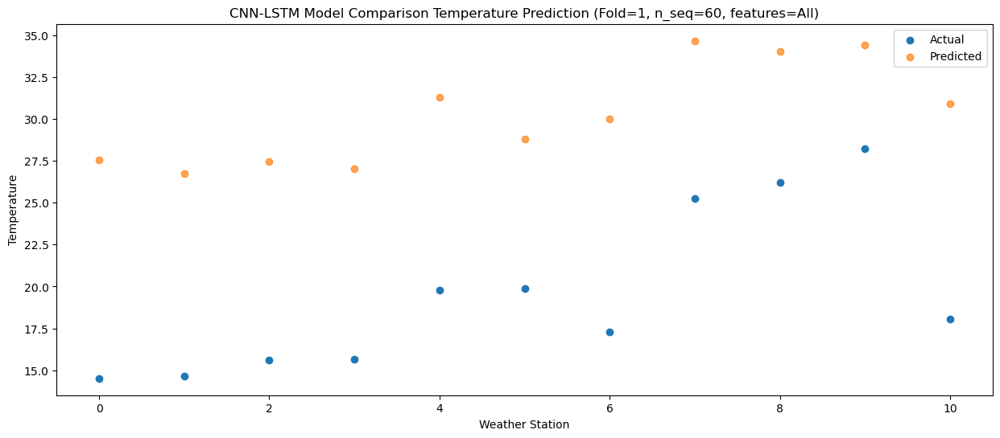

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  28.377595
1                 1   15.57  27.400406
2                 2   15.63  27.856843
3                 3   15.03  27.198841
4                 4   19.57  31.408290
5                 5   18.88  29.613480
6                 6   18.30  30.774410
7                 7   25.90  34.773859
8                 8   27.06  34.282062
9                 9   28.96  35.321403
10               10   20.00  32.529374


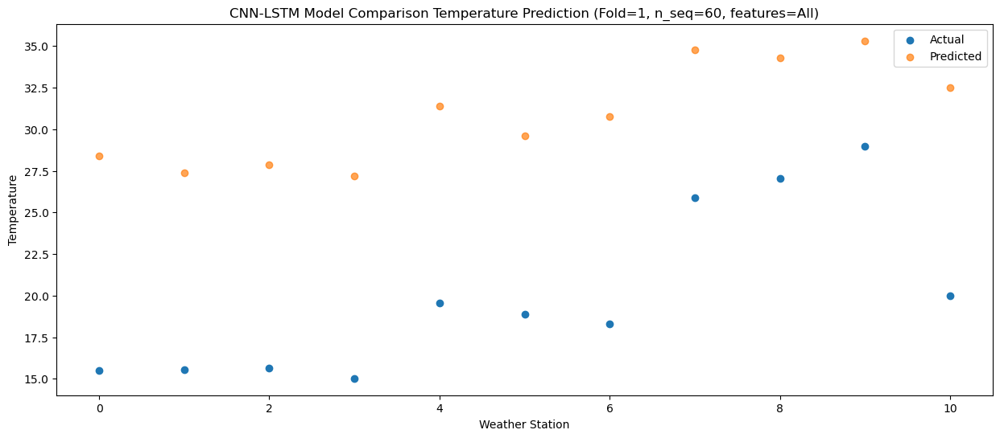

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  27.338979
1                 1   15.29  26.472827
2                 2   15.94  27.265918
3                 3   16.16  27.141128
4                 4   20.89  31.416090
5                 5   20.48  29.077571
6                 6   17.97  29.753875
7                 7   26.31  34.675137
8                 8   29.17  34.272483
9                 9   29.76  34.798088
10               10   17.85  30.585185


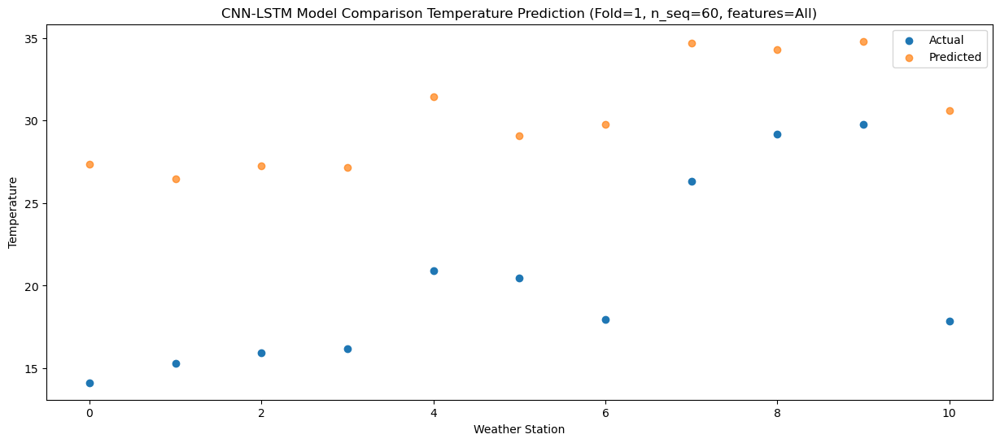

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  25.111808
1                 1   11.57  24.149396
2                 2   13.63  24.809280
3                 3   13.56  24.377869
4                 4   17.60  28.612825
5                 5   14.77  26.517887
6                 6   14.67  27.466471
7                 7   24.44  31.878696
8                 8   23.20  31.407164
9                 9   25.20  32.179588
10               10   14.12  28.618957


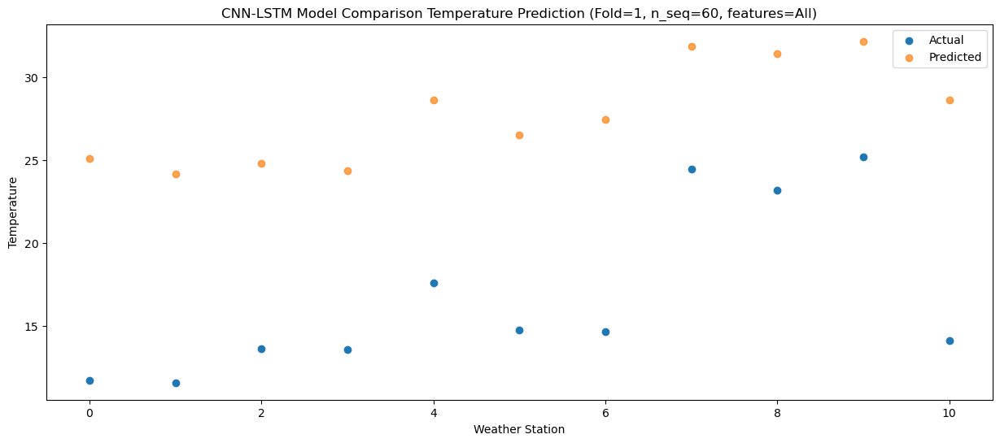

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  19.428774
1                 1    7.12  18.313174
2                 2    8.63  19.294180
3                 3   10.87  19.273099
4                 4   14.45  23.509269
5                 5   13.62  21.018902
6                 6    9.87  21.561453
7                 7   18.97  26.303936
8                 8   19.34  25.829343
9                 9   20.35  26.270757
10               10    9.25  21.699985


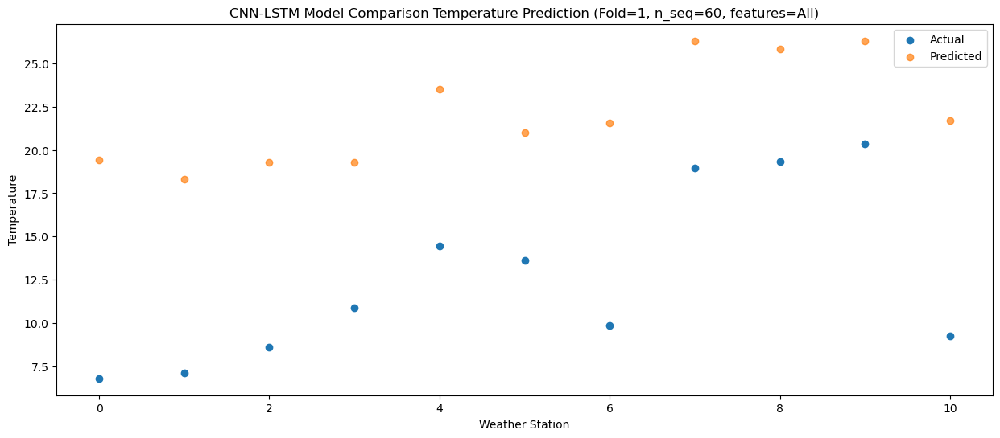

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_11 (Conv1D)          (None, 1, 1024)           2028544   
                                                                 
 max_pooling1d_11 (MaxPoolin  (None, 1, 1024)          0         
 g1D)                                                            
                                                                 
 dropout_33 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_22 (LSTM)              (None, 1, 512)            3147776   
                                                                 
 dropout_34 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_23 (LSTM)              (None, 512)               2099200   
                                                     

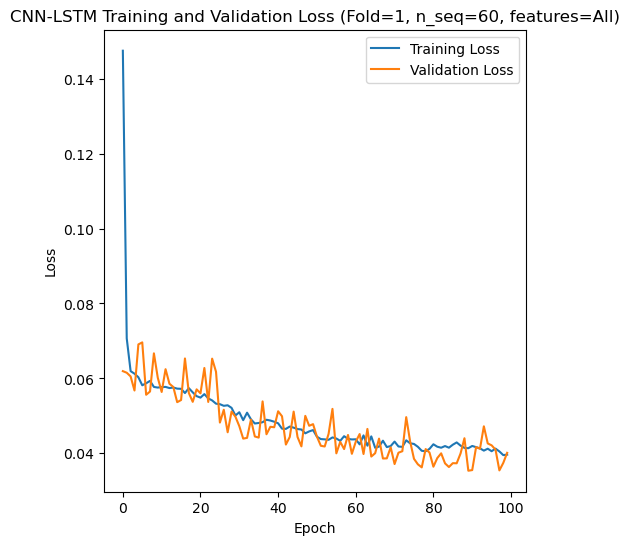

Epoch 1/100
84/84 [==============================] - 7s 37ms/step - loss: 0.1514 - accuracy: 0.2738 - mae: 0.1325 - rmse: 0.1514 - mape: inf - pearson: 0.6032 - val_loss: 0.0649 - val_accuracy: 0.6000 - val_mae: 0.0521 - val_rmse: 0.0649 - val_mape: 12.5290 - val_pearson: 0.8253
Epoch 2/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0698 - accuracy: 0.3929 - mae: 0.0552 - rmse: 0.0698 - mape: inf - pearson: 0.7976 - val_loss: 0.0450 - val_accuracy: 0.6000 - val_mae: 0.0360 - val_rmse: 0.0450 - val_mape: 8.2201 - val_pearson: 0.9252
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0630 - accuracy: 0.4762 - mae: 0.0500 - rmse: 0.0630 - mape: inf - pearson: 0.8282 - val_loss: 0.0362 - val_accuracy: 0.6000 - val_mae: 0.0290 - val_rmse: 0.0362 - val_mape: 6.4136 - val_pearson: 0.9450
Epoch 4/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0609 - accuracy: 0.5476 - mae: 0.0480 - rmse: 0.0609 - mape: inf - pearson: 0.8363 - v

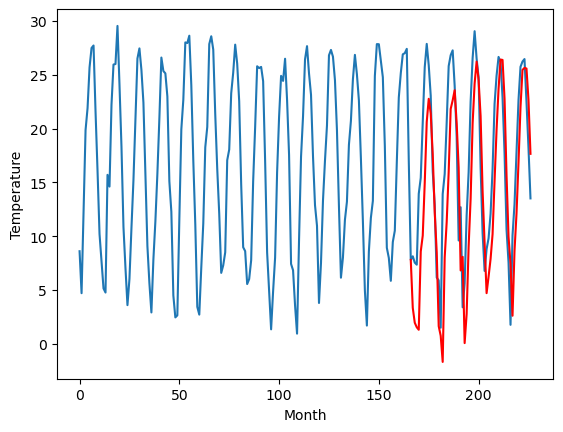

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-0.63		-2.20
-0.71		-2.64		-1.93
-0.95		-3.34		-2.39
-1.68		-3.36		-1.68
6.33		4.07		-2.26
8.56		6.51		-2.05
15.36		12.19		-3.17
22.56		18.55		-4.01
22.59		20.60		-1.99
21.26		19.45		-1.81
15.13		14.84		-0.29
8.14		8.04		-0.10
5.02		4.32		-0.70
-1.61		-2.19		-0.58
-1.69		-2.99		-1.30
-5.73		-6.63		-0.90
4.46		4.39		-0.07
8.22		8.17		-0.05
13.40		13.28		-0.12
20.65		20.47		-0.18
21.34		21.39		0.05
22.10		21.65		-0.45
19.86		18.51		-1.35
11.60		12.99		1.39
4.89		4.33		-0.56
2.50		3.23		0.73
-2.19		-3.80		-1.61
-2.20		-1.91		0.29
4.78		5.27		0.49
11.46		9.85		-1.61
17.26		17.24		-0.02
21.06		22.09		1.03
24.30		24.78		0.48
21.99		23.09		1.10
19.23		19.45		0.22
10.85		11.89		1.04
0.86		4.70		3.84
-1.85		-0.06		1.79
-2.10		1.49		3.59
-0.50		2.89		3.39
3.57		5.86		2.29
9.43		11.97		2.54
14.92		18.32		3.40
17.53		22.12		4.59
21.63		24.83		3.20
22.12		24.88		2.76
19.25		21.02		1.77
10.21		13.01	

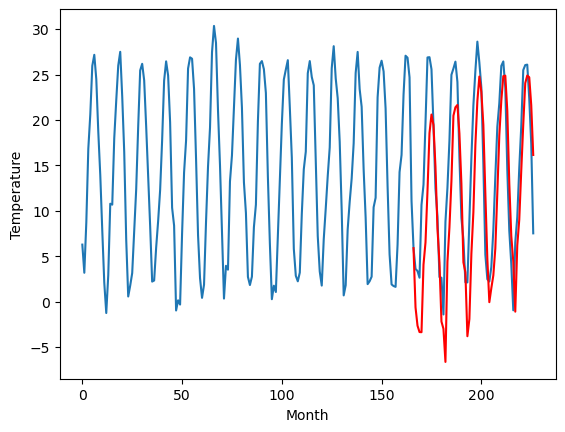

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		3.58		-2.08
4.54		2.78		-1.76
3.39		3.28		-0.11
4.43		4.11		-0.32
8.05		8.25		0.20
9.44		9.06		-0.38
10.75		11.27		0.52
13.34		13.36		0.02
13.98		15.53		1.55
13.67		15.73		2.06
12.41		14.10		1.69
11.14		12.36		1.22
7.72		7.17		-0.55
0.73		1.03		0.30
1.39		1.96		0.57
4.12		4.34		0.22
5.93		5.71		-0.22
7.74		8.26		0.52
11.32		11.85		0.53
12.54		14.41		1.87
13.33		15.77		2.44
13.38		16.43		3.05
12.10		14.14		2.04
10.96		11.57		0.61
4.11		4.56		0.45
5.01		7.43		2.42
0.75		2.83		2.08
3.08		6.28		3.20
6.55		9.06		2.51
8.36		11.43		3.07
11.12		14.72		3.60
12.93		16.88		3.95
13.11		18.12		5.01
12.54		17.74		5.20
11.13		15.53		4.40
8.50		10.18		1.68
6.74		8.18		1.44
2.64		5.05		2.41
2.44		6.64		4.20
5.50		8.96		3.46
6.52		9.73		3.21
9.06		11.44		2.38
10.04		13.02		2.98
12.45		15.40		2.95
14.36		19.72		5.36
14.54		19.72		5.18
12.59		15.98		3.39
9.01		11.39		2.38
5.03		7.40		2.37
3.10		5.16		2.06


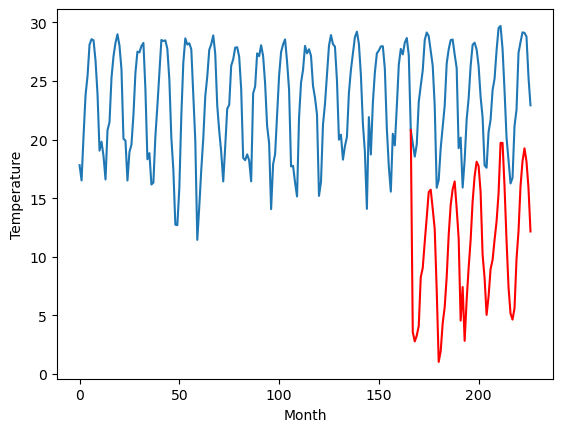

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		-1.35		-1.34
-3.07		-3.11		-0.04
-2.80		-2.96		-0.16
-2.65		-3.24		-0.59
0.90		1.93		1.03
2.13		3.89		1.76
8.02		9.13		1.11
14.08		14.60		0.52
18.36		18.05		-0.31
16.51		16.42		-0.09
11.93		12.90		0.97
6.71		8.14		1.43
2.75		3.63		0.88
-4.08		-2.86		1.22
-7.16		-4.25		2.91
-7.14		-4.79		2.35
-3.03		1.46		4.49
1.47		6.15		4.68
6.73		10.77		4.04
12.30		16.81		4.51
14.30		17.78		3.48
15.36		18.73		3.37
12.19		14.83		2.64
8.36		11.39		3.03
0.28		1.28		1.00
-1.64		1.23		2.87
-7.79		-5.94		1.85
-5.47		-1.86		3.61
-1.61		3.31		4.92
2.83		6.58		3.75
8.17		14.16		5.99
12.41		17.29		4.88
17.03		19.96		2.93
16.95		19.24		2.29
11.91		15.04		3.13
6.47		8.31		1.84
2.67		5.01		2.34
-3.50		-0.84		2.66
-2.21		1.19		3.40
-4.09		1.66		5.75
-1.65		2.69		4.34
4.07		9.11		5.04
7.70		12.40		4.70
11.49		15.95		4.46
17.06		20.47		3.41
15.05		18.63		3.58
12.63		15.51		2.88
7.61		10.02		2.41
-0.37		3.69		4.06
-1

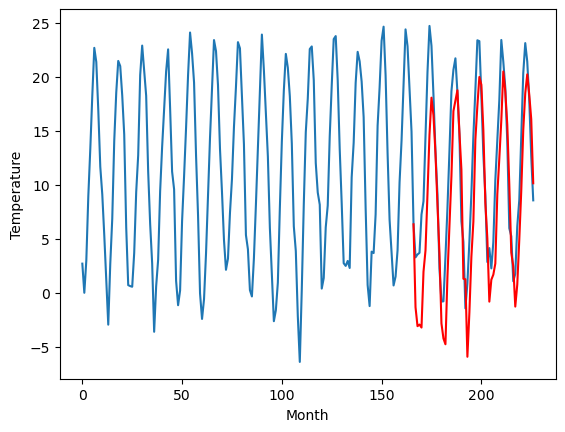

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		-0.03		0.29
0.03		-0.85		-0.88
0.37		-0.72		-1.09
1.01		-0.37		-1.38
7.70		5.41		-2.29
7.17		6.17		-1.00
10.14		9.25		-0.89
13.18		12.61		-0.57
13.92		14.57		0.65
14.29		14.23		-0.06
11.94		11.84		-0.10
8.25		8.83		0.58
4.13		4.33		0.20
-2.17		-2.20		-0.03
-1.82		-1.85		-0.03
-2.56		-1.44		1.12
4.77		3.56		-1.21
5.64		6.05		0.41
10.11		10.03		-0.08
13.59		13.56		-0.03
14.18		14.69		0.51
14.35		15.57		1.22
11.81		13.18		1.37
9.07		10.13		1.06
0.80		2.12		1.32
4.21		5.11		0.90
-3.52		-1.16		2.36
-0.38		1.83		2.21
3.38		6.03		2.65
7.18		9.44		2.26
12.34		13.99		1.65
14.93		16.63		1.70
14.76		17.97		3.21
13.94		16.83		2.89
11.97		14.43		2.46
5.78		8.49		2.71
2.71		5.52		2.81
0.20		2.13		1.93
1.37		3.61		2.24
3.50		5.91		2.41
5.33		7.46		2.13
7.25		9.88		2.63
11.28		12.70		1.42
14.93		15.72		0.79
16.37		19.11		2.74
17.67		19.44		1.77
13.24		15.68		2.44
7.08		9.89		2.81
1.97		5.38		3.41
-0.6

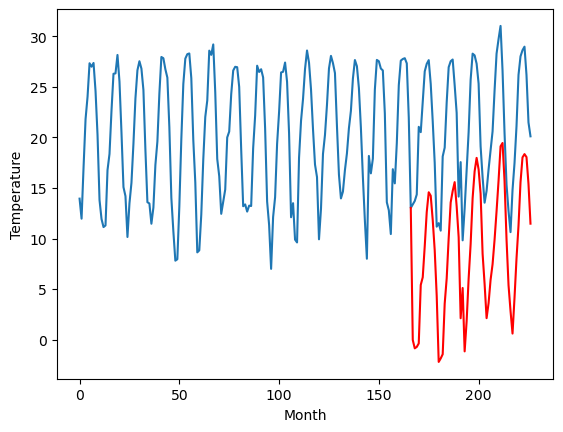

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-2.07		-1.68
-1.82		-3.14		-1.32
-1.45		-3.29		-1.84
-2.21		-3.19		-0.98
5.88		3.53		-2.35
5.85		4.58		-1.27
9.69		8.45		-1.24
13.30		12.81		-0.49
15.00		14.70		-0.30
15.30		13.99		-1.31
10.90		10.88		-0.02
6.43		6.68		0.25
3.75		2.54		-1.21
-2.36		-4.05		-1.69
-2.95		-4.10		-1.15
-5.30		-5.18		0.12
3.08		2.30		-0.78
5.20		5.00		-0.20
9.24		9.31		0.07
13.79		13.89		0.10
13.87		14.90		1.03
14.98		15.73		0.75
12.24		13.21		0.97
8.94		9.45		0.51
1.30		1.03		-0.27
4.54		3.34		-1.20
-3.89		-3.67		0.22
-4.27		-1.19		3.08
1.85		4.17		2.32
8.00		8.21		0.21
12.60		13.70		1.10
16.32		16.97		0.65
17.68		18.59		0.91
14.96		17.03		2.07
12.30		14.35		2.05
6.73		7.90		1.17
0.85		3.61		2.76
-1.38		-0.01		1.37
-0.62		1.42		2.04
0.57		3.52		2.95
4.37		5.68		1.31
5.29		8.93		3.64
10.37		12.94		2.57
15.29		16.32		1.03
17.45		19.25		1.80
19.15		19.70		0.55
14.67		15.86		1.19
6.78		9.18		2.40
0.50		4.24		3.

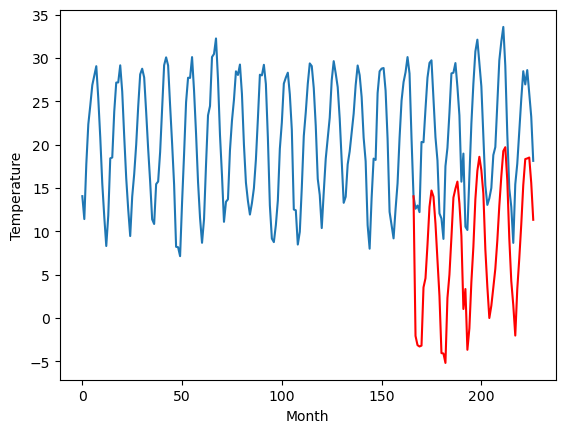

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		9.62		-0.80
8.61		8.29		-0.32
8.96		7.82		-1.14
8.40		7.76		-0.64
16.05		15.20		-0.85
16.36		16.62		0.26
21.26		21.24		-0.02
26.00		26.60		0.60
27.18		28.45		1.27
27.41		27.40		-0.01
21.47		23.65		2.18
15.99		18.33		2.34
13.50		14.61		1.11
7.04		7.85		0.81
6.34		7.36		1.02
3.23		4.90		1.67
13.60		14.59		0.99
15.30		17.54		2.24
19.38		22.17		2.79
24.94		27.78		2.84
25.83		28.66		2.83
26.39		29.44		3.05
24.12		26.70		2.58
19.61		22.34		2.73
11.64		13.45		1.81
13.93		14.89		0.96
5.45		7.28		1.83
5.28		9.52		4.24
11.86		15.82		3.96
18.13		20.33		2.20
23.15		26.77		3.62
27.86		30.61		2.75
30.65		32.51		1.86
27.84		30.69		2.85
24.01		27.68		3.67
17.63		20.74		3.11
10.96		15.45		4.49
8.34		11.35		3.01
9.22		12.76		3.54
9.41		14.69		5.28
14.06		17.28		3.22
15.88		21.57		5.69
21.62		26.57		4.95
25.77		30.28		4.51
28.33		32.79		4.46
30.67		33.24		2.57
25.89		29.40		3.51
17.17		22.00		4.83
11.83	

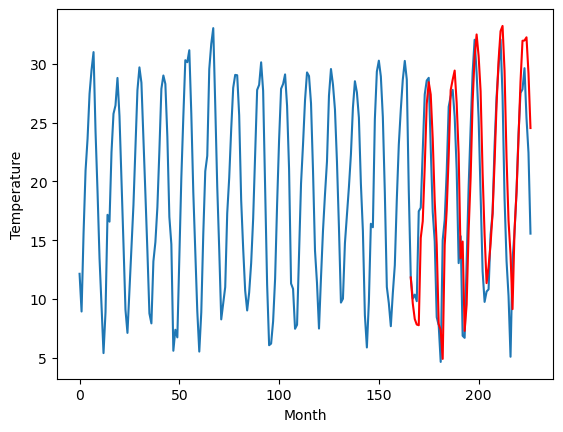

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.02		-1.59
-7.96		-6.60		1.36
-6.71		-6.42		0.29
-5.90		-6.09		-0.19
-1.40		-0.83		0.57
3.58		1.00		-2.58
9.87		5.01		-4.86
13.39		9.00		-4.39
15.49		11.50		-3.99
15.93		11.10		-4.83
9.68		7.96		-1.72
4.08		3.76		-0.32
-1.48		-1.30		0.18
-9.13		-7.09		2.04
-8.59		-6.90		1.69
-5.67		-6.97		-1.30
-2.57		-1.83		0.74
4.09		1.76		-2.33
9.10		6.13		-2.97
14.09		11.17		-2.92
12.89		12.48		-0.41
12.37		12.77		0.40
10.19		10.01		-0.18
3.63		5.79		2.16
-1.77		-1.70		0.07
-5.12		-1.26		3.86
-8.12		-6.54		1.58
-7.15		-4.03		3.12
-2.09		0.90		2.99
5.10		4.16		-0.94
9.80		9.42		-0.38
13.66		13.04		-0.62
14.80		15.33		0.53
11.78		14.43		2.65
10.05		11.36		1.31
1.84		4.91		3.07
-5.05		-0.08		4.97
-7.22		-3.74		3.48
-7.93		-2.03		5.90
-6.72		-0.63		6.09
-2.02		1.16		3.18
3.62		5.17		1.55
8.27		9.17		0.90
12.93		12.08		-0.85
17.68		16.31		-1.37
14.68		15.94		1.26
12.02		12.08		0.06
5.28		6.04		0.76
-1

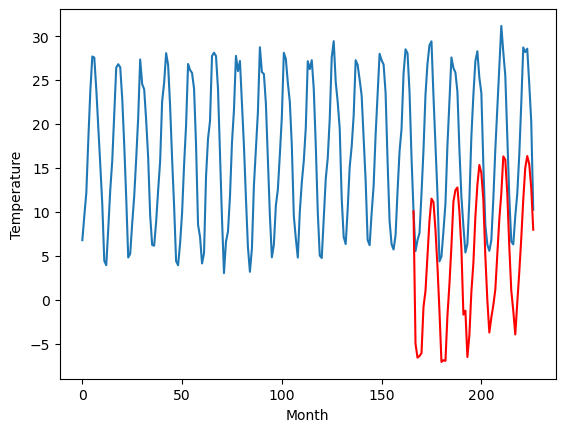

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		7.23		-2.11
5.80		5.29		-0.51
6.34		5.94		-0.40
8.45		6.74		-1.71
8.52		10.15		1.63
11.73		12.50		0.77
15.78		15.92		0.14
17.07		18.70		1.63
19.48		21.47		1.99
21.88		21.82		-0.06
20.28		19.12		-1.16
17.04		15.64		-1.40
10.32		9.46		-0.86
8.27		4.63		-3.64
8.21		5.62		-2.59
7.29		7.20		-0.09
6.89		8.76		1.87
10.75		12.76		2.01
12.97		16.83		3.86
17.21		21.49		4.28
20.19		23.18		2.99
19.79		22.87		3.08
18.01		20.22		2.21
13.03		15.79		2.76
11.77		9.94		-1.83
5.26		9.21		3.95
7.67		6.32		-1.35
8.54		8.75		0.21
10.33		12.67		2.34
12.45		14.84		2.39
13.41		18.87		5.46
18.33		22.52		4.19
19.14		25.14		6.00
21.18		25.00		3.82
20.77		21.98		1.21
14.50		15.96		1.46
8.27		10.62		2.35
5.57		7.61		2.04
5.23		9.49		4.26
4.91		10.51		5.60
5.92		11.89		5.97
9.76		15.48		5.72
10.97		19.05		8.08
12.93		21.20		8.27
19.85		26.59		6.74
19.48		25.79		6.31
15.98		21.69		5.71
14.39		16.58		2.19
10.00		11.98	

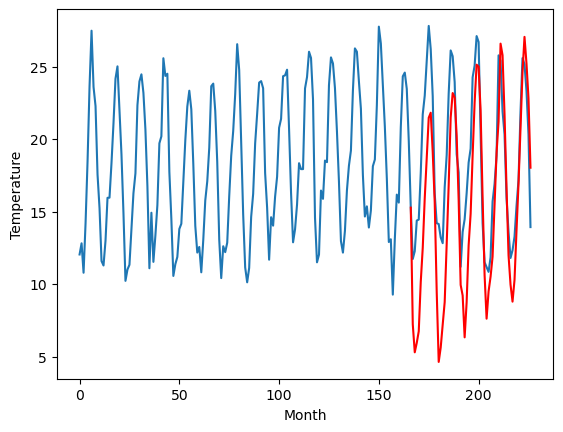

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		4.71		0.66
3.64		3.50		-0.14
3.35		3.65		0.30
4.39		3.73		-0.66
9.62		9.16		-0.46
10.92		10.47		-0.45
13.52		14.50		0.98
18.81		18.82		0.01
21.80		21.50		-0.30
20.80		20.54		-0.26
16.77		17.69		0.92
12.85		13.96		1.11
8.24		9.46		1.22
1.24		2.91		1.67
0.83		2.44		1.61
1.33		2.51		1.18
8.21		7.96		-0.25
11.00		11.46		0.46
15.02		15.73		0.71
19.31		20.35		1.04
20.88		21.42		0.54
20.97		22.37		1.40
16.86		19.26		2.40
13.58		16.10		2.52
4.67		7.04		2.37
6.59		8.69		2.10
0.11		1.99		1.88
4.13		5.58		1.45
8.24		10.14		1.90
11.53		13.45		1.92
16.38		19.38		3.00
20.14		22.19		2.05
21.58		24.15		2.57
20.20		23.23		3.03
16.89		19.99		3.10
9.58		13.69		4.11
7.46		10.74		3.28
0.93		6.15		5.22
4.13		7.92		3.79
7.15		9.41		2.26
7.60		10.64		3.04
11.12		14.91		3.79
13.90		17.84		3.94
17.56		21.09		3.53
21.15		25.06		3.91
20.60		24.35		3.75
16.64		20.92		4.28
11.35		15.33		3.98
5.45		10.00		4.55
2.98	

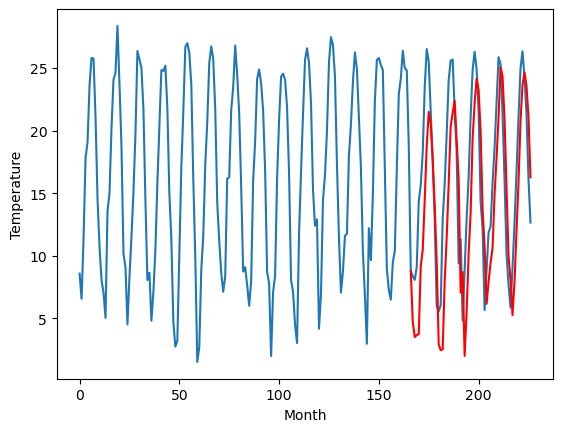

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		2.66		1.01
2.25		1.34		-0.91
1.81		1.39		-0.42
1.61		1.30		-0.31
7.65		7.08		-0.57
8.08		8.52		0.44
12.12		13.00		0.88
17.49		17.86		0.37
20.78		20.61		-0.17
19.52		19.38		-0.14
15.57		16.21		0.64
10.91		11.97		1.06
5.86		7.66		1.80
-1.20		1.00		2.20
-0.87		0.20		1.07
0.48		-0.35		-0.83
6.69		6.16		-0.53
8.66		9.87		1.21
13.57		14.30		0.73
18.98		19.44		0.46
20.29		20.43		0.14
20.37		21.42		1.05
15.88		18.14		2.26
12.12		14.79		2.67
1.90		5.28		3.38
4.00		6.59		2.59
-2.87		-0.59		2.28
1.72		2.99		1.27
6.27		8.02		1.75
9.43		11.56		2.13
15.67		18.12		2.45
19.32		21.12		1.80
20.67		23.24		2.57
19.42		22.19		2.77
15.27		18.72		3.45
7.99		12.18		4.19
5.54		8.92		3.38
0.08		4.00		3.92
2.00		5.79		3.79
4.79		7.10		2.31
5.32		8.46		3.14
10.21		13.36		3.15
13.56		16.67		3.11
16.47		20.12		3.65
20.02		23.97		3.95
19.31		23.12		3.81
16.53		19.76		3.23
10.48		13.89		3.41
4.27		8.26		3.99
1.42		6.

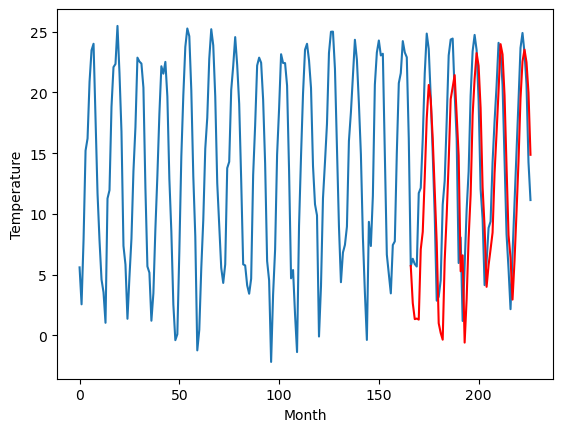

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[3.3493687057495123, -0.6251511383056645, 3.577336349487304, -1.353946380615234, -0.028663291931152912, -2.0716349792480466, 9.62211353302002, -5.020992107391358, 7.225637855529785, 4.709577369689942, 2.661544456481934]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   3.349369
1                 1    1.57  -0.625151
2                 2    5.66   3.577336
3                 3   -0.01  -1.353946
4                 4   -0.32  -0.028663
5                 5   -0.39  -2.071635
6                 6   10.42   9.622114
7                 7   -3.43  -5.020992
8                 8    9.34   7.225638
9                 9    4.05   4.709577
10               10    1.65   2.661544


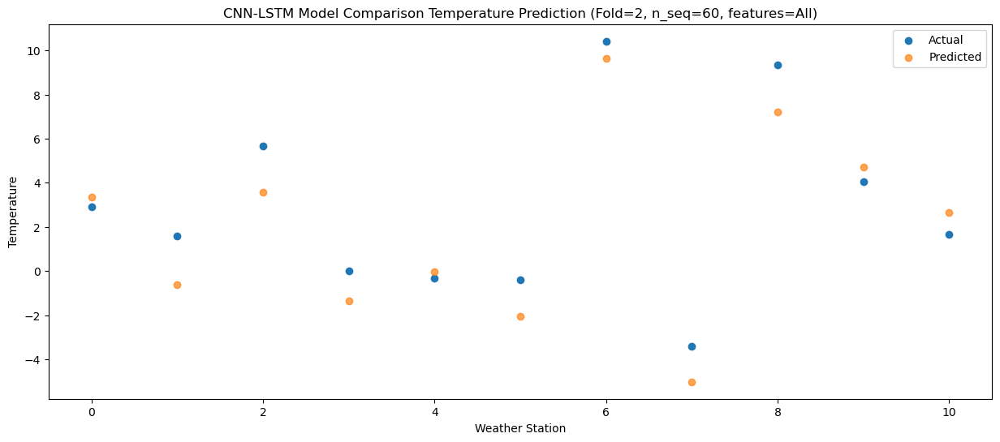

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   1.965675
1                 1   -0.71  -2.643382
2                 2    4.54   2.782322
3                 3   -3.07  -3.109063
4                 4    0.03  -0.853016
5                 5   -1.82  -3.135660
6                 6    8.61   8.290300
7                 7   -7.96  -6.604477
8                 8    5.80   5.289784
9                 9    3.64   3.497043
10               10    2.25   1.340091


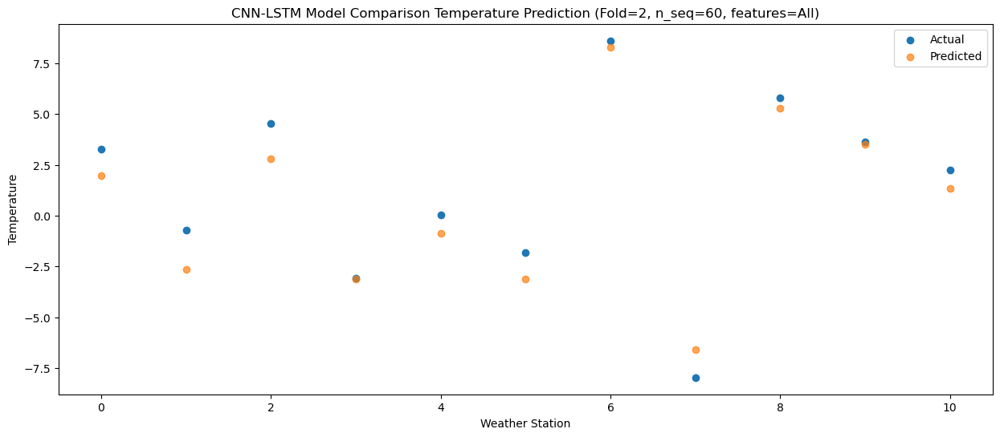

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   1.541931
1                 1   -0.95  -3.344577
2                 2    3.39   3.283766
3                 3   -2.80  -2.958363
4                 4    0.37  -0.715389
5                 5   -1.45  -3.288341
6                 6    8.96   7.821118
7                 7   -6.71  -6.421209
8                 8    6.34   5.942283
9                 9    3.35   3.653708
10               10    1.81   1.388305


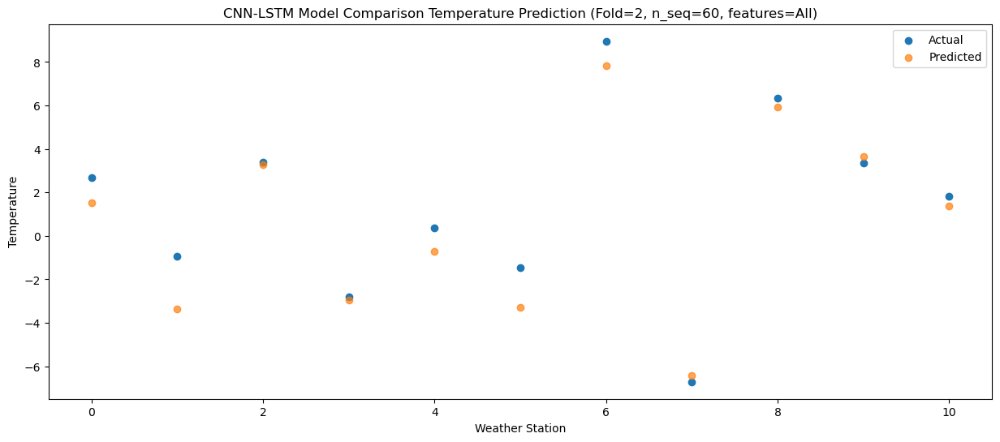

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   1.310711
1                 1   -1.68  -3.361658
2                 2    4.43   4.105466
3                 3   -2.65  -3.237947
4                 4    1.01  -0.368739
5                 5   -2.21  -3.188127
6                 6    8.40   7.763909
7                 7   -5.90  -6.087551
8                 8    8.45   6.740427
9                 9    4.39   3.730328
10               10    1.61   1.302917


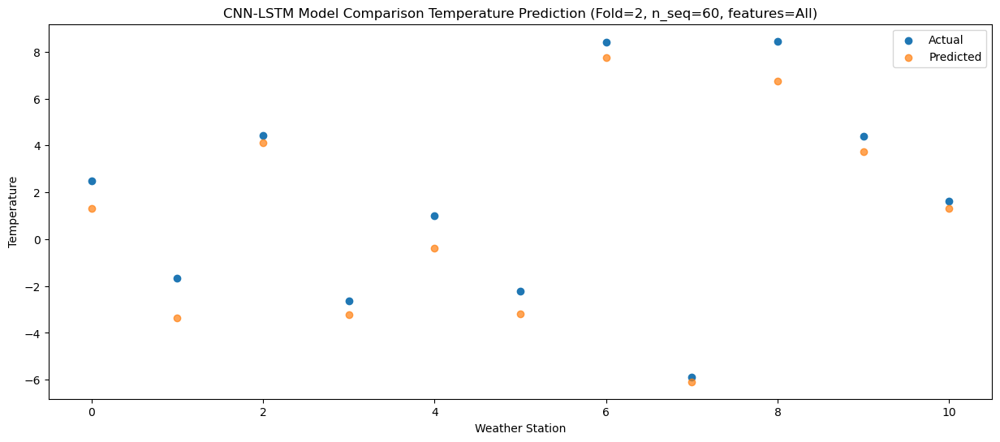

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.583655
1                 1    6.33   4.072160
2                 2    8.05   8.253908
3                 3    0.90   1.930107
4                 4    7.70   5.411131
5                 5    5.88   3.527632
6                 6   16.05  15.195602
7                 7   -1.40  -0.828026
8                 8    8.52  10.148593
9                 9    9.62   9.161100
10               10    7.65   7.083686


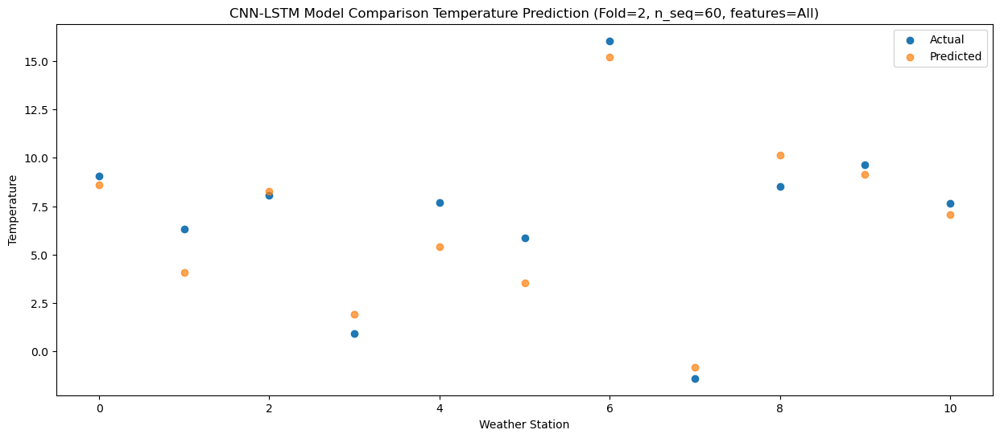

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.060710
1                 1    8.56   6.513979
2                 2    9.44   9.055570
3                 3    2.13   3.894144
4                 4    7.17   6.169822
5                 5    5.85   4.583790
6                 6   16.36  16.617046
7                 7    3.58   1.000866
8                 8   11.73  12.499636
9                 9   10.92  10.465531
10               10    8.08   8.519959


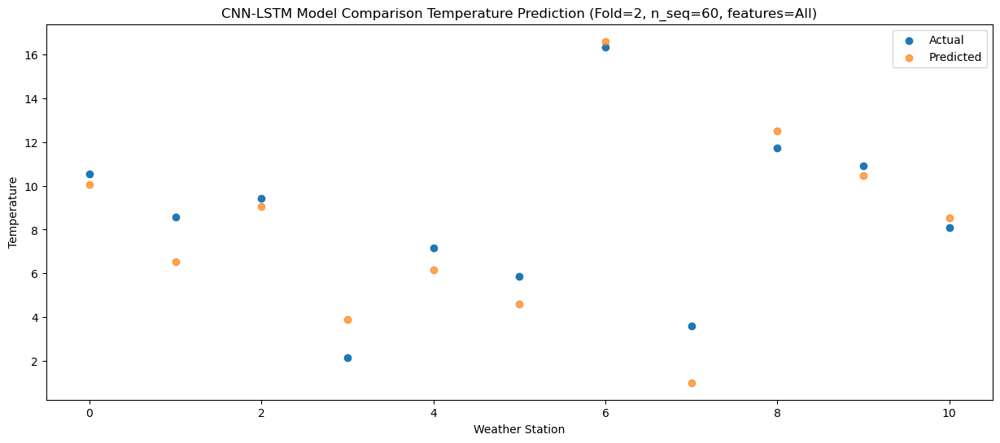

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  14.964958
1                 1   15.36  12.186746
2                 2   10.75  11.270190
3                 3    8.02   9.126507
4                 4   10.14   9.245667
5                 5    9.69   8.445670
6                 6   21.26  21.244926
7                 7    9.87   5.008277
8                 8   15.78  15.923503
9                 9   13.52  14.502925
10               10   12.12  12.996678


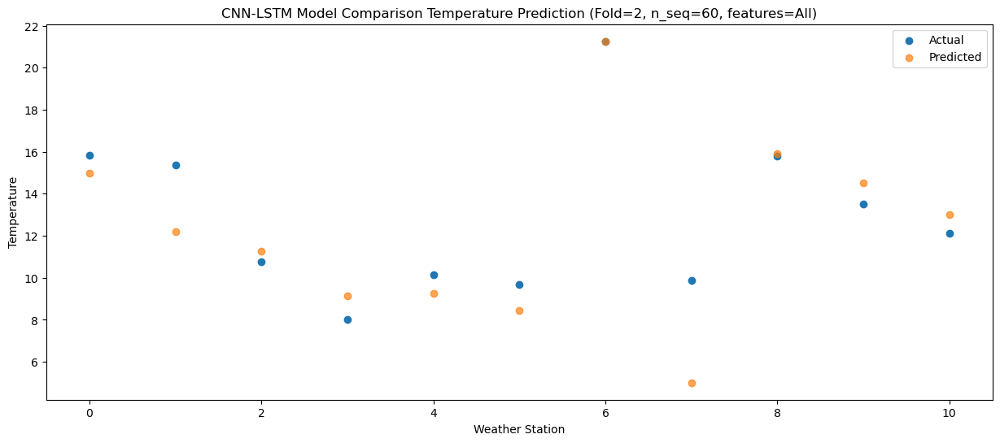

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  20.624417
1                 1   22.56  18.552537
2                 2   13.34  13.364179
3                 3   14.08  14.600638
4                 4   13.18  12.614148
5                 5   13.30  12.805891
6                 6   26.00  26.597916
7                 7   13.39   9.000358
8                 8   17.07  18.704204
9                 9   18.81  18.822722
10               10   17.49  17.859470


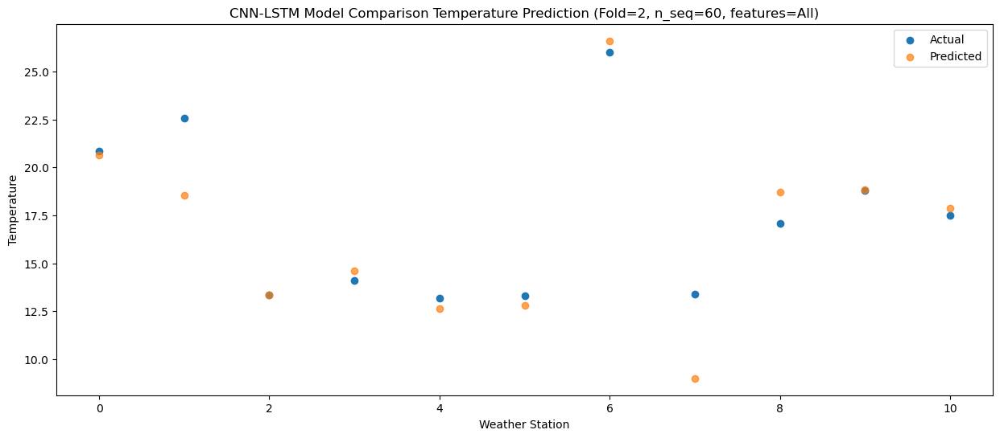

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  22.775968
1                 1   22.59  20.597548
2                 2   13.98  15.526279
3                 3   18.36  18.047286
4                 4   13.92  14.570156
5                 5   15.00  14.703338
6                 6   27.18  28.447872
7                 7   15.49  11.502466
8                 8   19.48  21.472819
9                 9   21.80  21.498644
10               10   20.78  20.610634


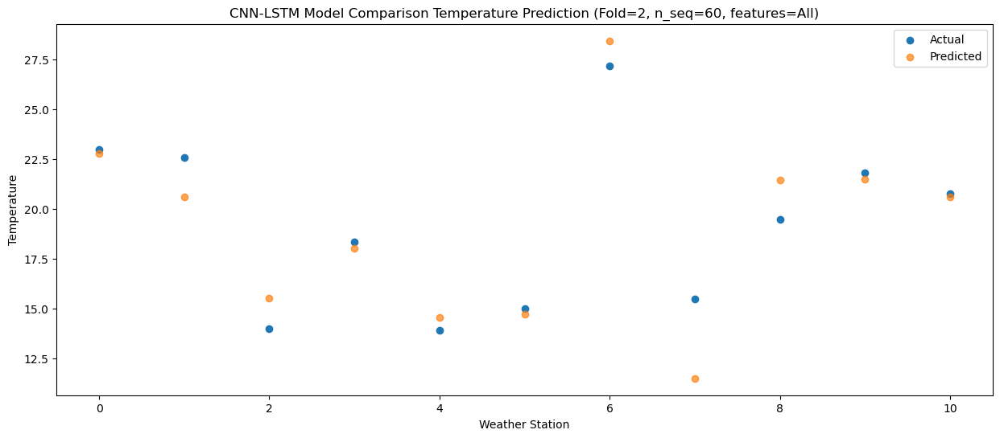

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  21.421168
1                 1   21.26  19.451104
2                 2   13.67  15.728473
3                 3   16.51  16.415180
4                 4   14.29  14.226948
5                 5   15.30  13.993359
6                 6   27.41  27.398303
7                 7   15.93  11.101205
8                 8   21.88  21.823115
9                 9   20.80  20.537509
10               10   19.52  19.382942


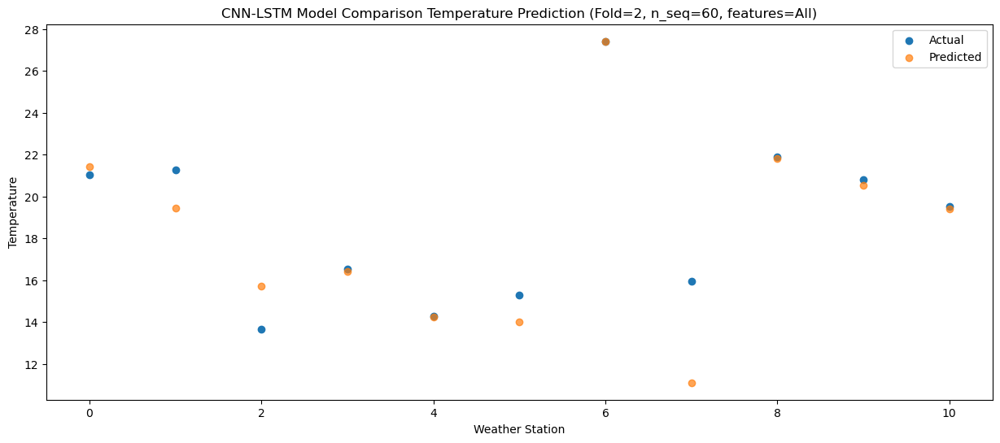

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  17.623734
1                 1   15.13  14.839212
2                 2   12.41  14.098410
3                 3   11.93  12.895816
4                 4   11.94  11.838511
5                 5   10.90  10.882224
6                 6   21.47  23.646048
7                 7    9.68   7.959199
8                 8   20.28  19.115341
9                 9   16.77  17.685263
10               10   15.57  16.212202


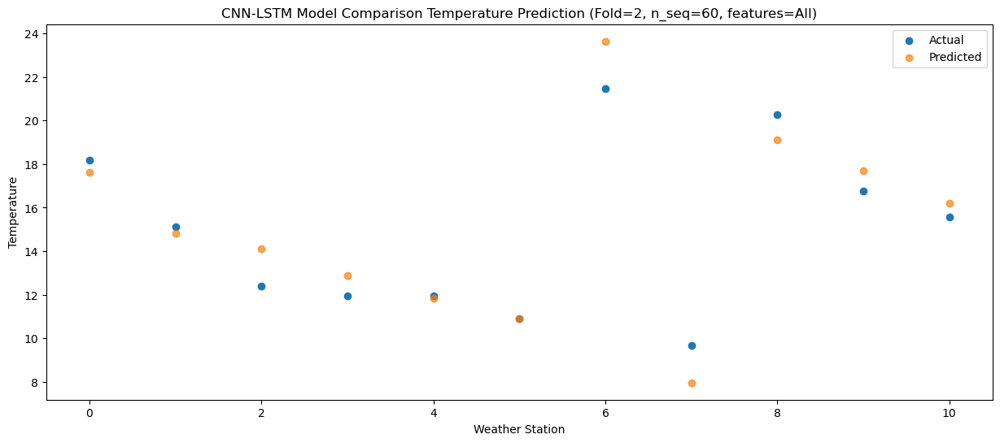

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  12.236719
1                 1    8.14   8.042749
2                 2   11.14  12.362852
3                 3    6.71   8.140623
4                 4    8.25   8.828866
5                 5    6.43   6.679004
6                 6   15.99  18.328978
7                 7    4.08   3.757114
8                 8   17.04  15.641392
9                 9   12.85  13.962945
10               10   10.91  11.969487


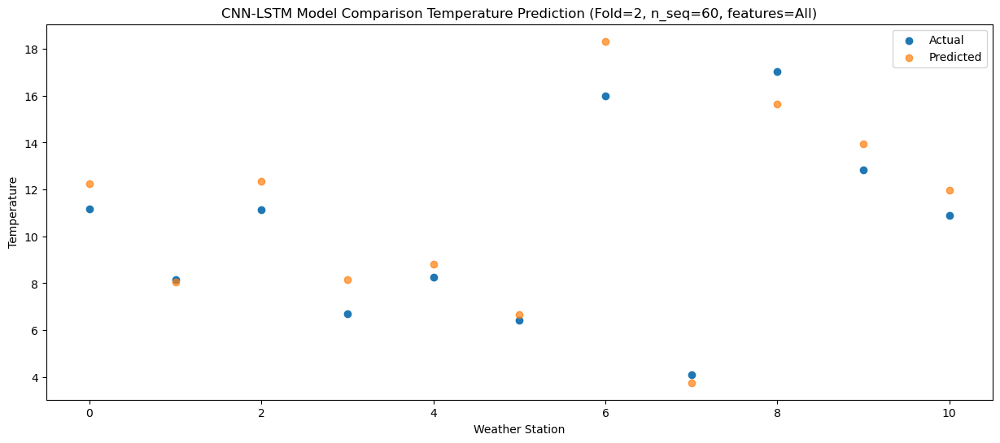

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   8.538418
1                 1    5.02   4.315755
2                 2    7.72   7.170568
3                 3    2.75   3.626206
4                 4    4.13   4.331821
5                 5    3.75   2.540711
6                 6   13.50  14.611225
7                 7   -1.48  -1.303256
8                 8   10.32   9.456650
9                 9    8.24   9.464370
10               10    5.86   7.657884


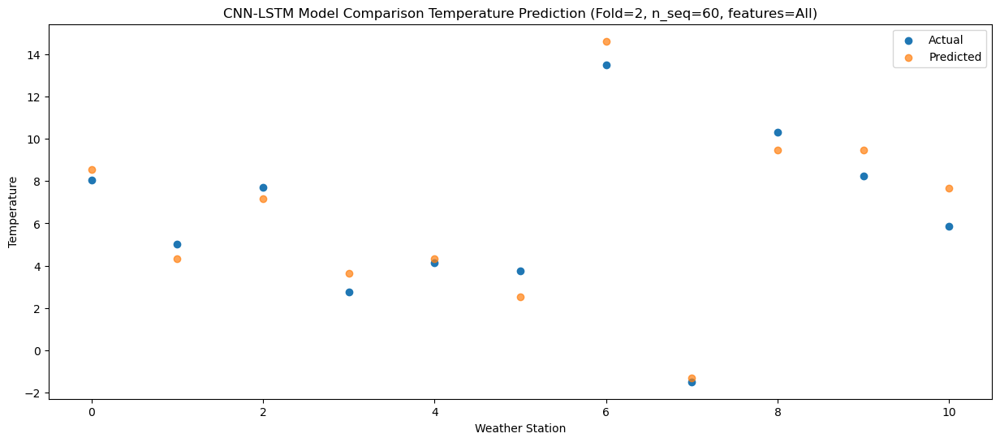

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   1.646350
1                 1   -1.61  -2.186334
2                 2    0.73   1.034349
3                 3   -4.08  -2.857709
4                 4   -2.17  -2.197449
5                 5   -2.36  -4.052298
6                 6    7.04   7.847506
7                 7   -9.13  -7.091784
8                 8    8.27   4.626577
9                 9    1.24   2.912482
10               10   -1.20   1.002199


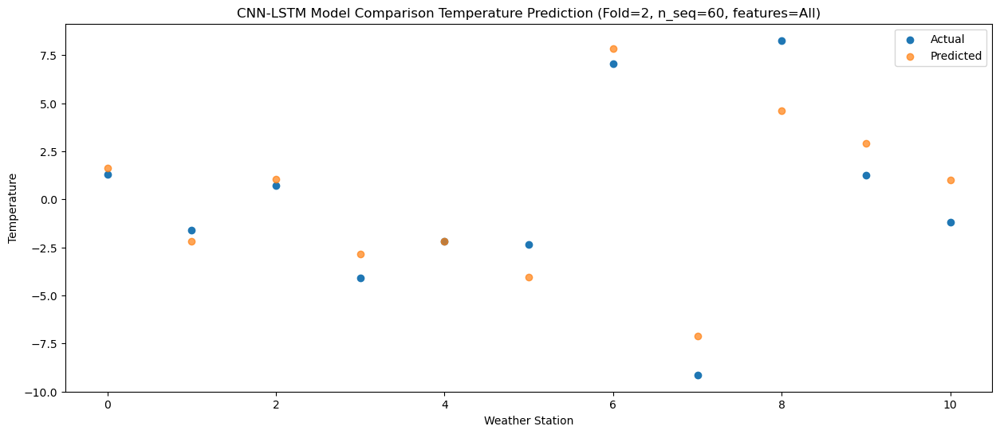

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   0.752422
1                 1   -1.69  -2.986982
2                 2    1.39   1.963727
3                 3   -7.16  -4.246704
4                 4   -1.82  -1.852964
5                 5   -2.95  -4.099904
6                 6    6.34   7.355785
7                 7   -8.59  -6.897076
8                 8    8.21   5.615758
9                 9    0.83   2.443224
10               10   -0.87   0.203911


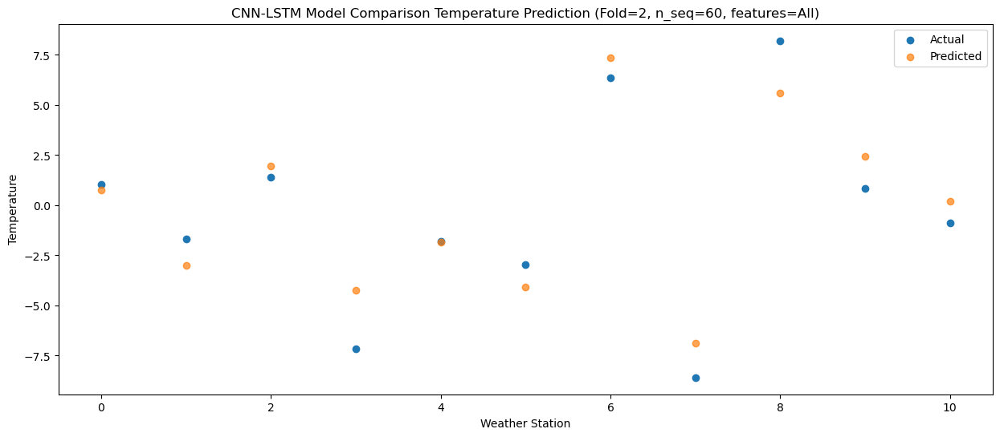

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -1.677809
1                 1   -5.73  -6.632063
2                 2    4.12   4.341993
3                 3   -7.14  -4.786401
4                 4   -2.56  -1.436443
5                 5   -5.30  -5.184663
6                 6    3.23   4.897730
7                 7   -5.67  -6.974957
8                 8    7.29   7.196525
9                 9    1.33   2.514006
10               10    0.48  -0.347979


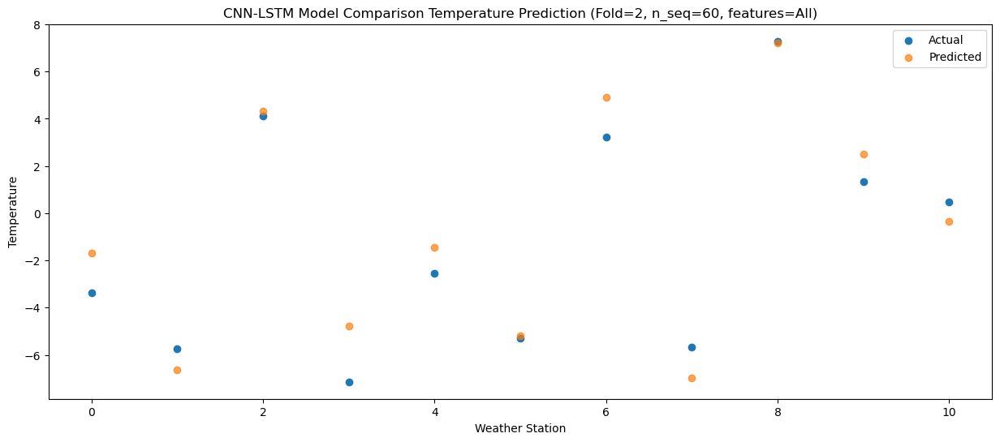

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   8.026016
1                 1    4.46   4.387450
2                 2    5.93   5.705767
3                 3   -3.03   1.460890
4                 4    4.77   3.560104
5                 5    3.08   2.303357
6                 6   13.60  14.586705
7                 7   -2.57  -1.826555
8                 8    6.89   8.757085
9                 9    8.21   7.960904
10               10    6.69   6.164238


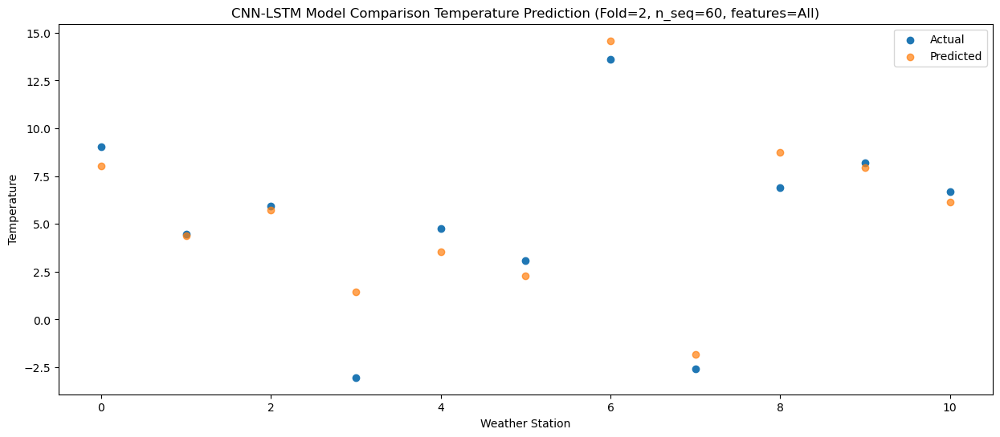

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  11.316533
1                 1    8.22   8.174946
2                 2    7.74   8.263969
3                 3    1.47   6.154114
4                 4    5.64   6.050081
5                 5    5.20   4.999652
6                 6   15.30  17.536463
7                 7    4.09   1.760595
8                 8   10.75  12.761398
9                 9   11.00  11.462956
10               10    8.66   9.873921


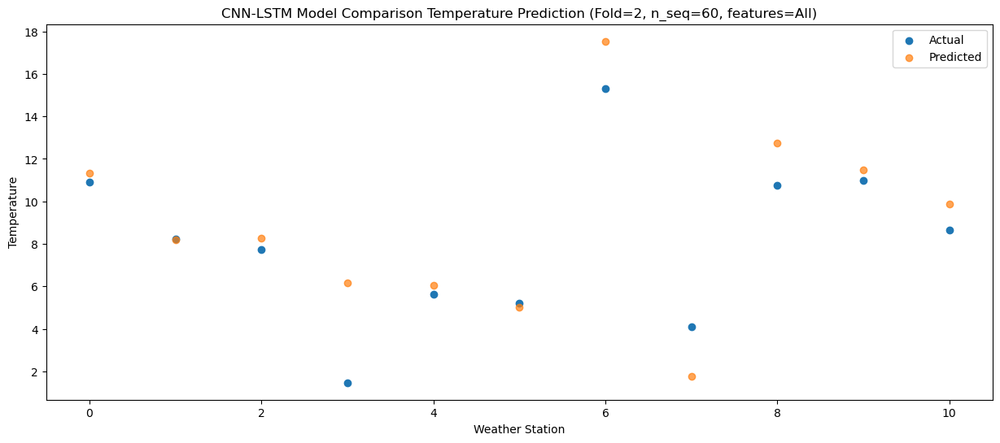

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  15.992911
1                 1   13.40  13.278059
2                 2   11.32  11.849693
3                 3    6.73  10.769456
4                 4   10.11  10.027179
5                 5    9.24   9.313201
6                 6   19.38  22.172372
7                 7    9.10   6.129385
8                 8   12.97  16.832731
9                 9   15.02  15.731576
10               10   13.57  14.304794


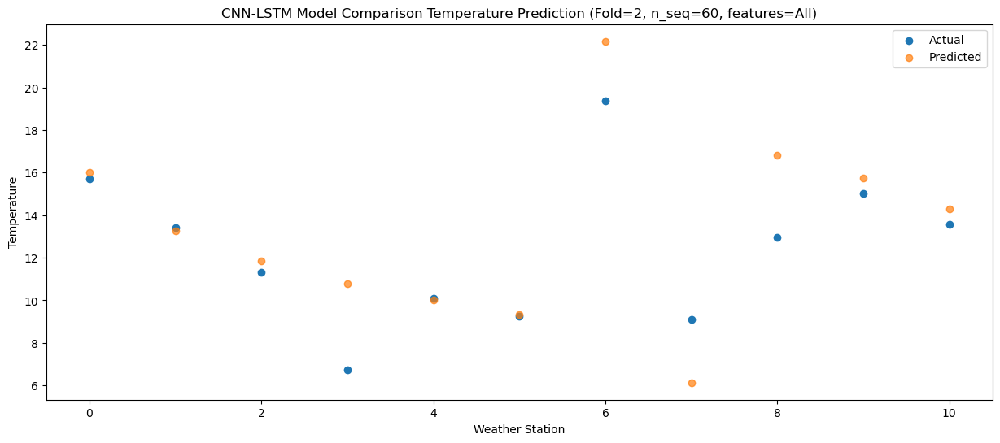

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  21.833069
1                 1   20.65  20.471260
2                 2   12.54  14.411606
3                 3   12.30  16.806481
4                 4   13.59  13.556031
5                 5   13.79  13.891552
6                 6   24.94  27.777287
7                 7   14.09  11.168434
8                 8   17.21  21.490520
9                 9   19.31  20.352394
10               10   18.98  19.444164


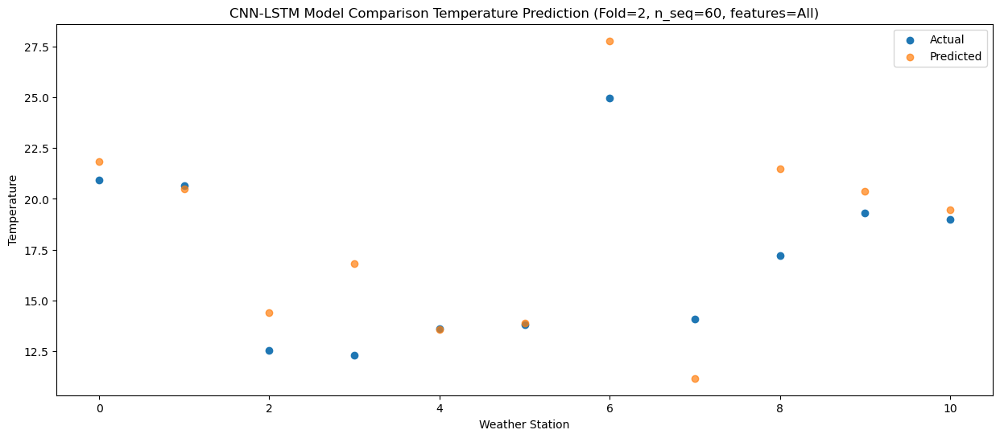

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  22.634575
1                 1   21.34  21.394937
2                 2   13.33  15.772907
3                 3   14.30  17.776248
4                 4   14.18  14.688432
5                 5   13.87  14.904145
6                 6   25.83  28.660545
7                 7   12.89  12.475728
8                 8   20.19  23.179018
9                 9   20.88  21.418149
10               10   20.29  20.425836


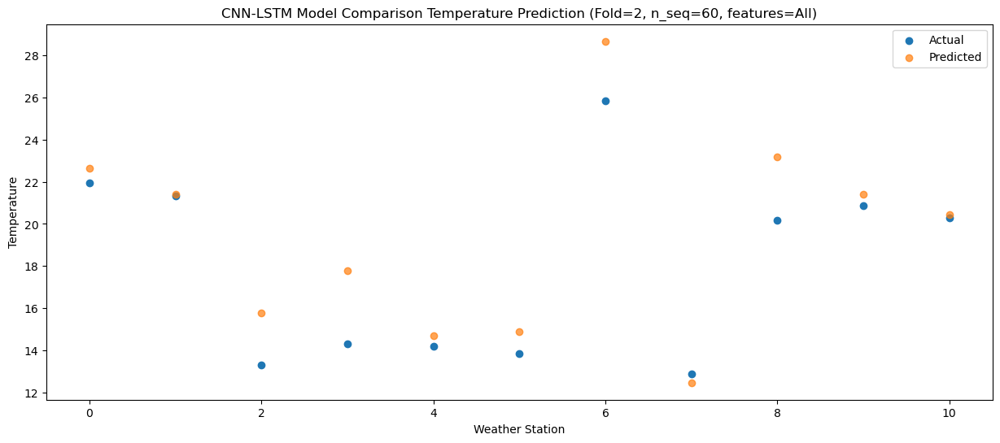

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  23.571905
1                 1   22.10  21.651287
2                 2   13.38  16.430936
3                 3   15.36  18.734569
4                 4   14.35  15.570171
5                 5   14.98  15.730225
6                 6   26.39  29.437857
7                 7   12.37  12.769785
8                 8   19.79  22.866909
9                 9   20.97  22.367425
10               10   20.37  21.423526


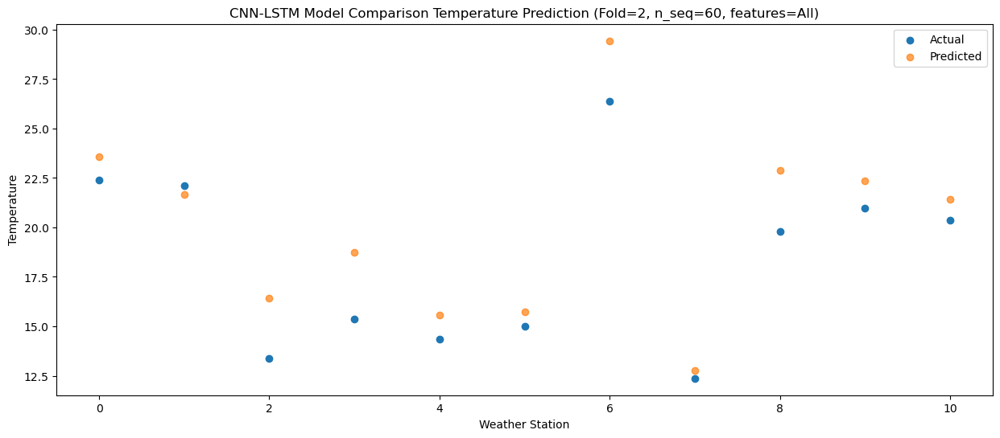

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  20.513428
1                 1   19.86  18.514634
2                 2   12.10  14.136333
3                 3   12.19  14.828806
4                 4   11.81  13.181062
5                 5   12.24  13.211292
6                 6   24.12  26.699869
7                 7   10.19  10.012339
8                 8   18.01  20.219167
9                 9   16.86  19.262979
10               10   15.88  18.140027


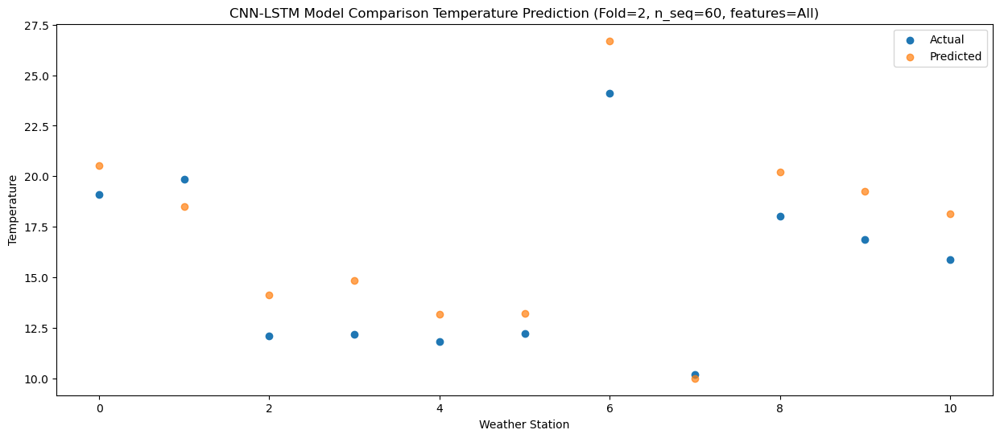

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  16.386124
1                 1   11.60  12.988511
2                 2   10.96  11.572040
3                 3    8.36  11.390061
4                 4    9.07  10.126682
5                 5    8.94   9.451905
6                 6   19.61  22.337084
7                 7    3.63   5.788274
8                 8   13.03  15.785261
9                 9   13.58  16.095332
10               10   12.12  14.789949


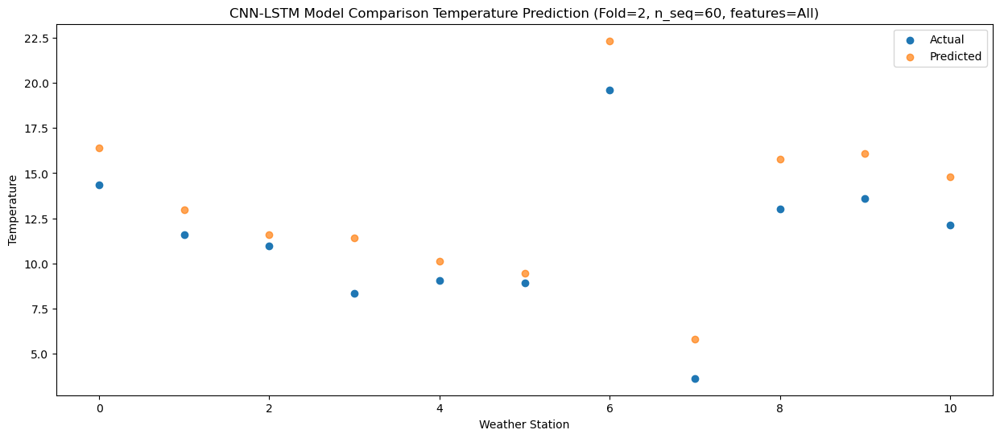

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   6.824565
1                 1    4.89   4.330889
2                 2    4.11   4.558435
3                 3    0.28   1.276182
4                 4    0.80   2.119783
5                 5    1.30   1.034726
6                 6   11.64  13.453597
7                 7   -1.77  -1.703471
8                 8   11.77   9.939124
9                 9    4.67   7.041627
10               10    1.90   5.278758


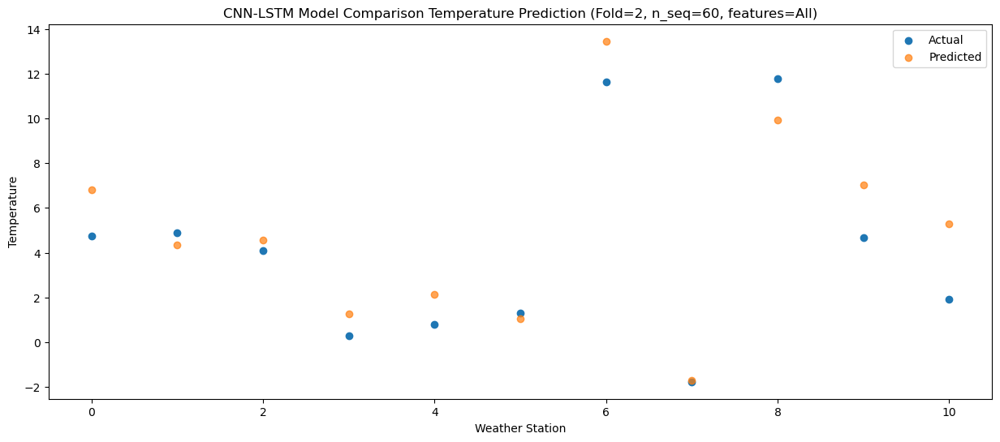

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   8.089823
1                 1    2.50   3.234357
2                 2    5.01   7.427828
3                 3   -1.64   1.232980
4                 4    4.21   5.111256
5                 5    4.54   3.339061
6                 6   13.93  14.885296
7                 7   -5.12  -1.255294
8                 8    5.26   9.214777
9                 9    6.59   8.691424
10               10    4.00   6.591936


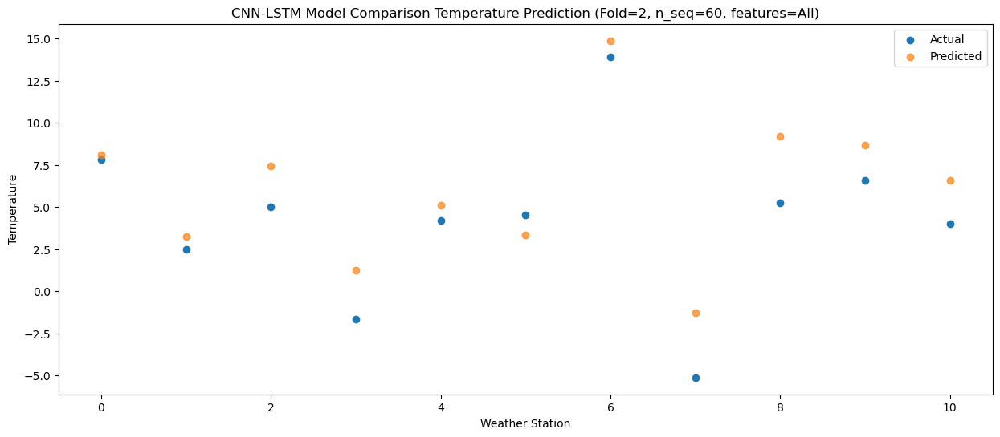

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48   0.070752
1                 1   -2.19  -3.803633
2                 2    0.75   2.834787
3                 3   -7.79  -5.943258
4                 4   -3.52  -1.155778
5                 5   -3.89  -3.670184
6                 6    5.45   7.280796
7                 7   -8.12  -6.537361
8                 8    7.67   6.321386
9                 9    0.11   1.988905
10               10   -2.87  -0.590917


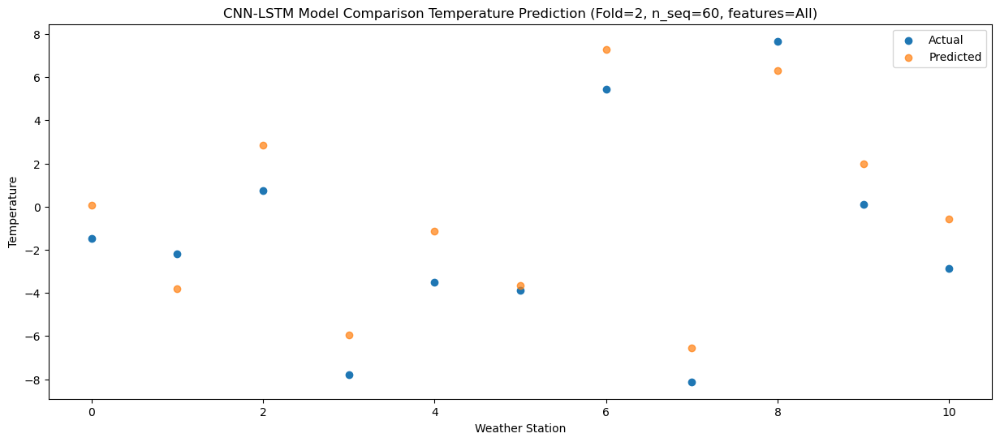

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   2.772020
1                 1   -2.20  -1.910827
2                 2    3.08   6.281901
3                 3   -5.47  -1.857420
4                 4   -0.38   1.826046
5                 5   -4.27  -1.189280
6                 6    5.28   9.521635
7                 7   -7.15  -4.025786
8                 8    8.54   8.749729
9                 9    4.13   5.580209
10               10    1.72   2.994513


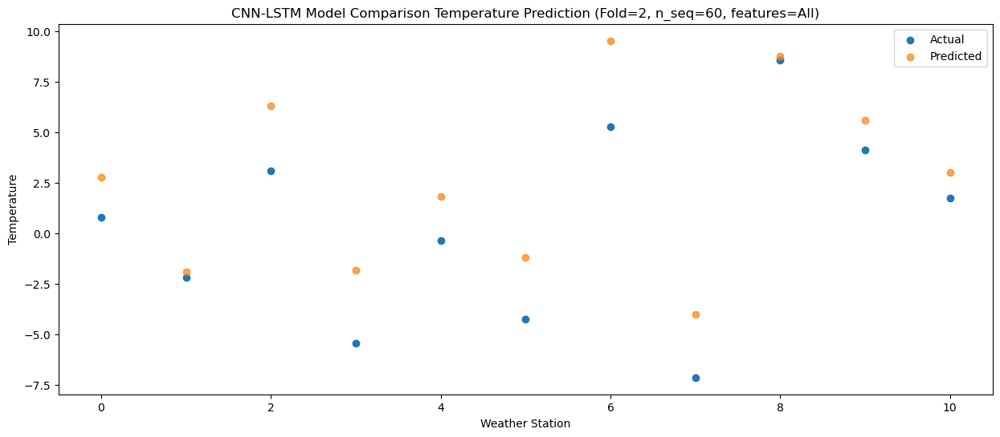

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05   9.058385
1                 1    4.78   5.267574
2                 2    6.55   9.055889
3                 3   -1.61   3.307604
4                 4    3.38   6.030219
5                 5    1.85   4.166465
6                 6   11.86  15.815210
7                 7   -2.09   0.900907
8                 8   10.33  12.666882
9                 9    8.24  10.137109
10               10    6.27   8.017350


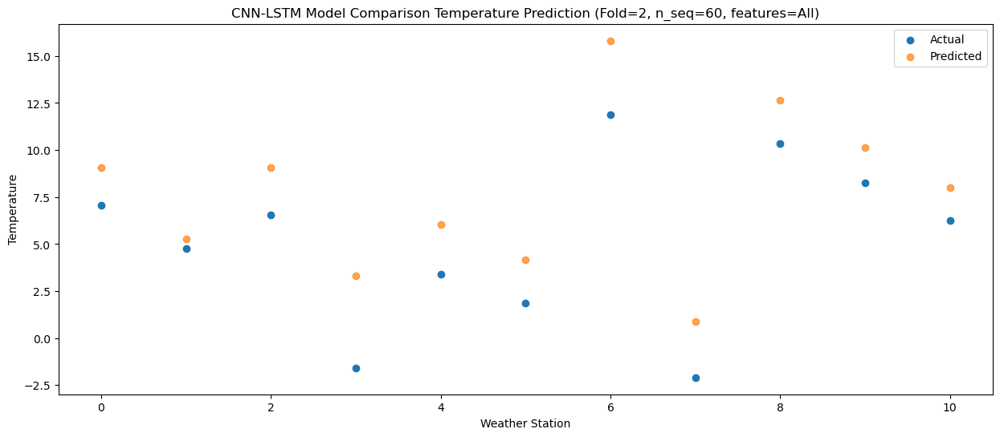

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  13.487492
1                 1   11.46   9.849696
2                 2    8.36  11.432769
3                 3    2.83   6.575529
4                 4    7.18   9.436716
5                 5    8.00   8.210681
6                 6   18.13  20.332756
7                 7    5.10   4.155324
8                 8   12.45  14.837177
9                 9   11.53  13.448810
10               10    9.43  11.560237


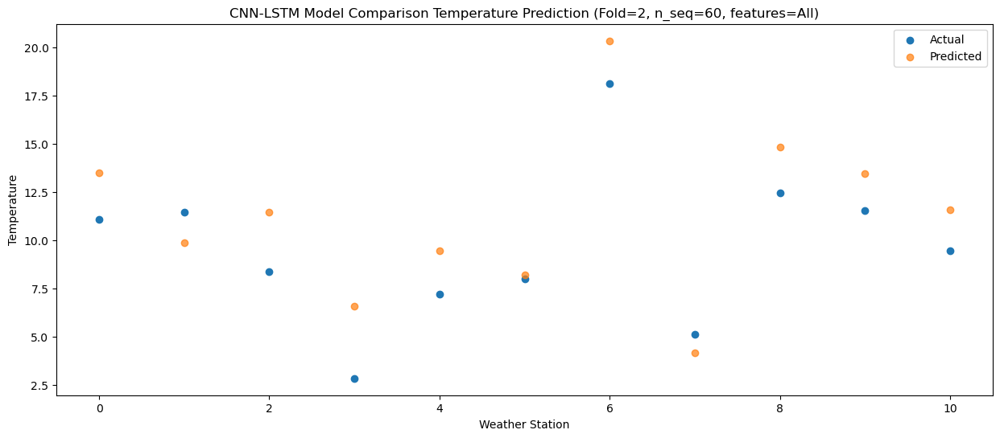

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  20.499693
1                 1   17.26  17.242918
2                 2   11.12  14.716598
3                 3    8.17  14.160869
4                 4   12.34  13.989993
5                 5   12.60  13.702093
6                 6   23.15  26.774060
7                 7    9.80   9.421189
8                 8   13.41  18.866888
9                 9   16.38  19.375734
10               10   15.67  18.117324


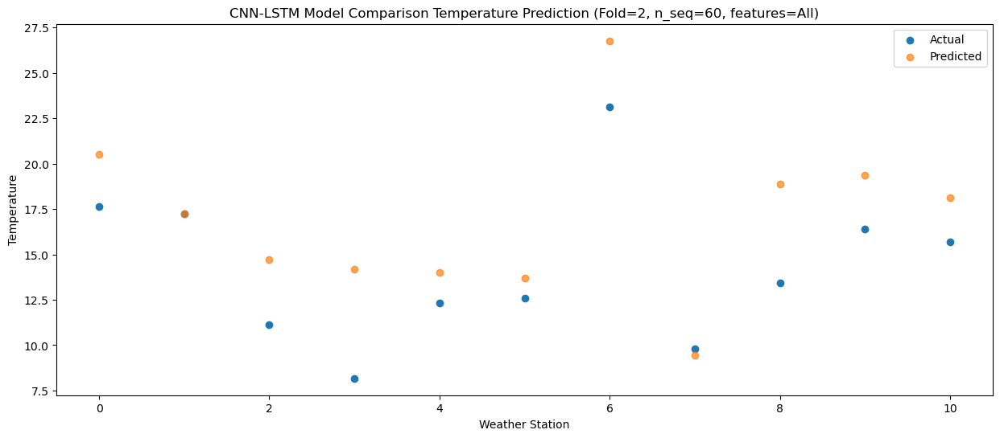

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  24.200513
1                 1   21.06  22.086613
2                 2   12.93  16.875452
3                 3   12.41  17.287134
4                 4   14.93  16.632330
5                 5   16.32  16.973581
6                 6   27.86  30.614927
7                 7   13.66  13.035404
8                 8   18.33  22.515057
9                 9   20.14  22.188440
10               10   19.32  21.120852


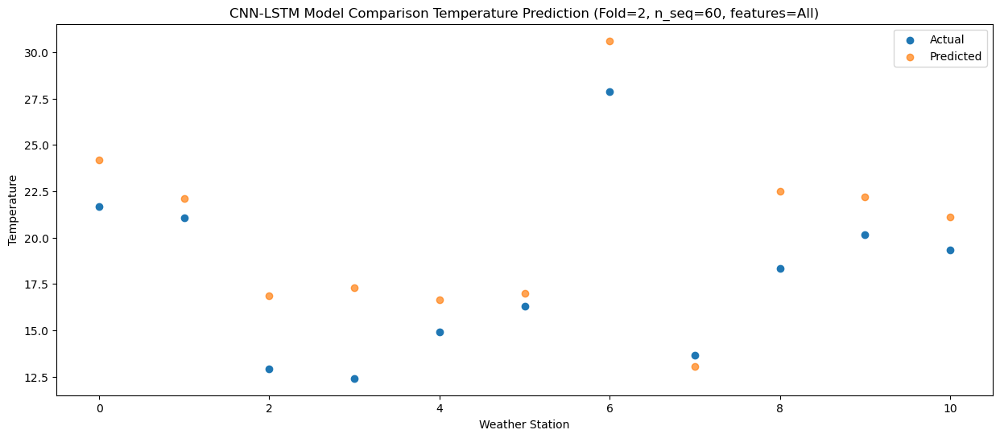

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  26.229477
1                 1   24.30  24.780390
2                 2   13.11  18.118940
3                 3   17.03  19.961907
4                 4   14.76  17.967024
5                 5   17.68  18.588983
6                 6   30.65  32.511995
7                 7   14.80  15.334206
8                 8   19.14  25.136677
9                 9   21.58  24.151489
10               10   20.67  23.235526


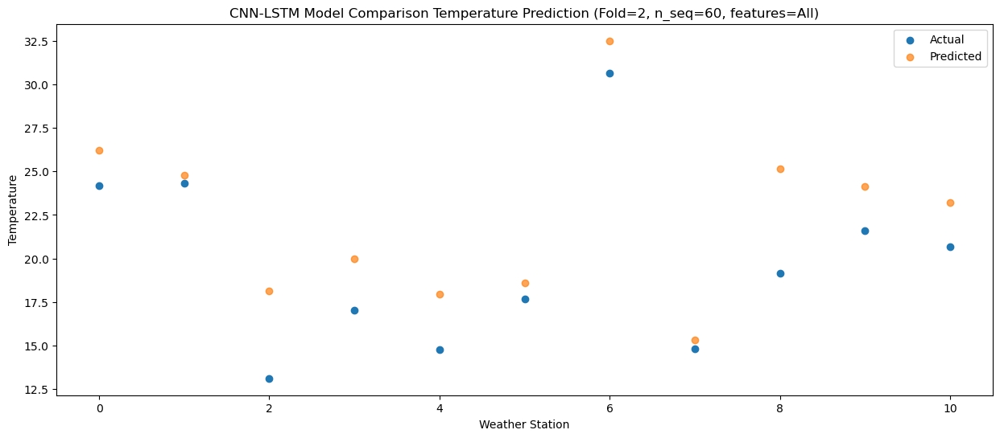

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  24.507496
1                 1   21.99  23.093457
2                 2   12.54  17.739942
3                 3   16.95  19.244762
4                 4   13.94  16.827242
5                 5   14.96  17.030112
6                 6   27.84  30.692349
7                 7   11.78  14.427851
8                 8   21.18  24.998306
9                 9   20.20  23.234004
10               10   19.42  22.188043


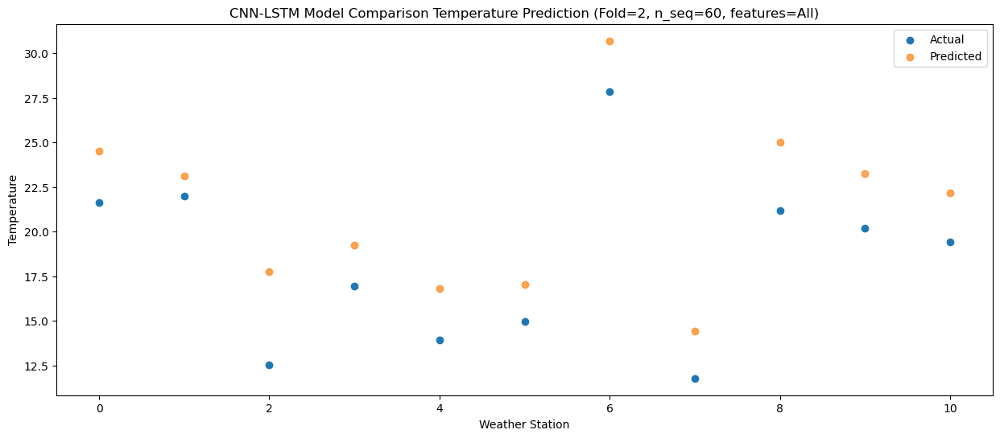

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  21.179446
1                 1   19.23  19.446942
2                 2   11.13  15.529386
3                 3   11.91  15.042613
4                 4   11.97  14.427500
5                 5   12.30  14.354718
6                 6   24.01  27.678401
7                 7   10.05  11.357942
8                 8   20.77  21.979824
9                 9   16.89  19.990313
10               10   15.27  18.715094


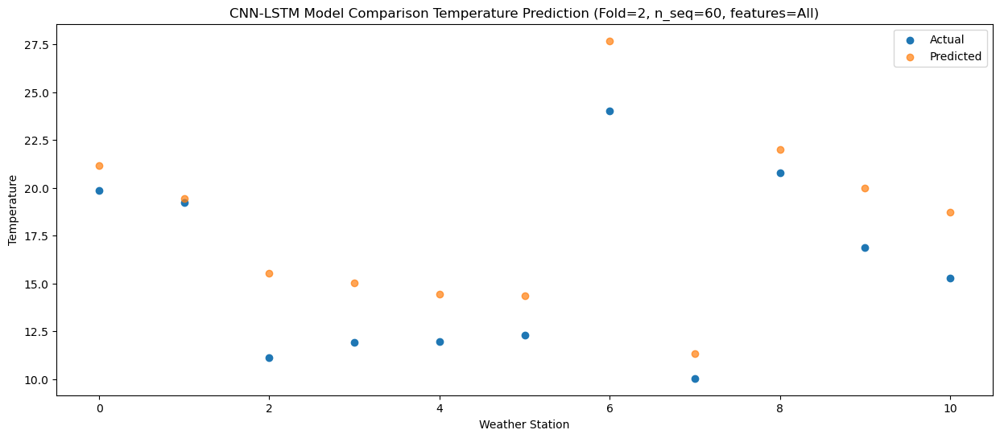

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  14.184869
1                 1   10.85  11.891545
2                 2    8.50  10.183334
3                 3    6.47   8.308035
4                 4    5.78   8.491284
5                 5    6.73   7.897439
6                 6   17.63  20.744148
7                 7    1.84   4.914756
8                 8   14.50  15.957361
9                 9    9.58  13.690289
10               10    7.99  12.179586


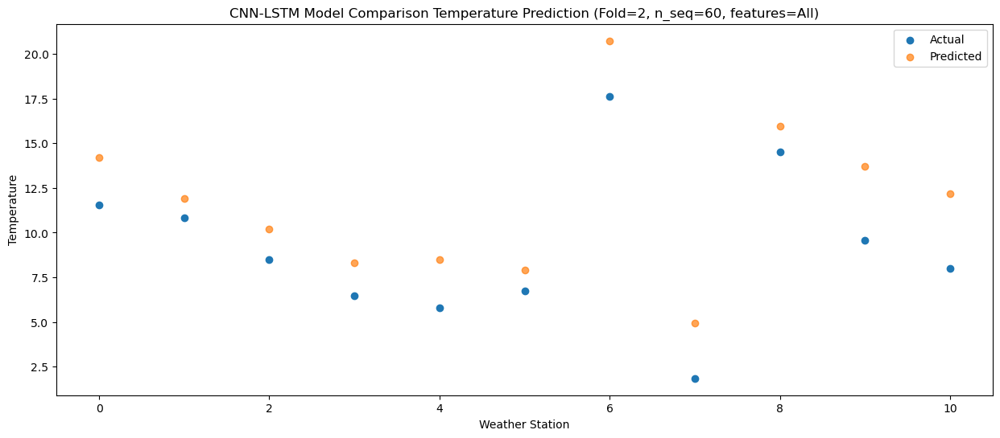

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41   9.377958
1                 1    0.86   4.697961
2                 2    6.74   8.178422
3                 3    2.67   5.010034
4                 4    2.71   5.519920
5                 5    0.85   3.612713
6                 6   10.96  15.447869
7                 7   -5.05  -0.076460
8                 8    8.27  10.615617
9                 9    7.46  10.742073
10               10    5.54   8.919593


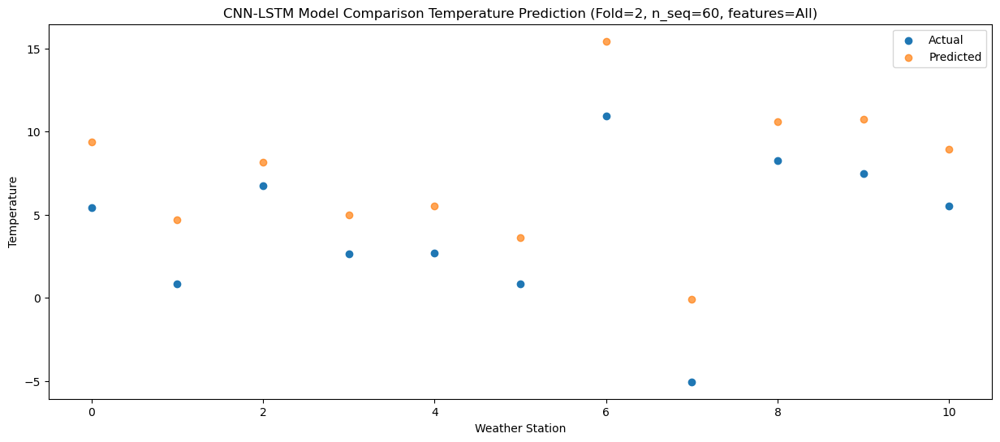

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   4.713575
1                 1   -1.85  -0.056776
2                 2    2.64   5.046053
3                 3   -3.50  -0.838090
4                 4    0.20   2.127483
5                 5   -1.38  -0.005417
6                 6    8.34  11.345875
7                 7   -7.22  -3.742565
8                 8    5.57   7.609380
9                 9    0.93   6.154359
10               10    0.08   3.999646


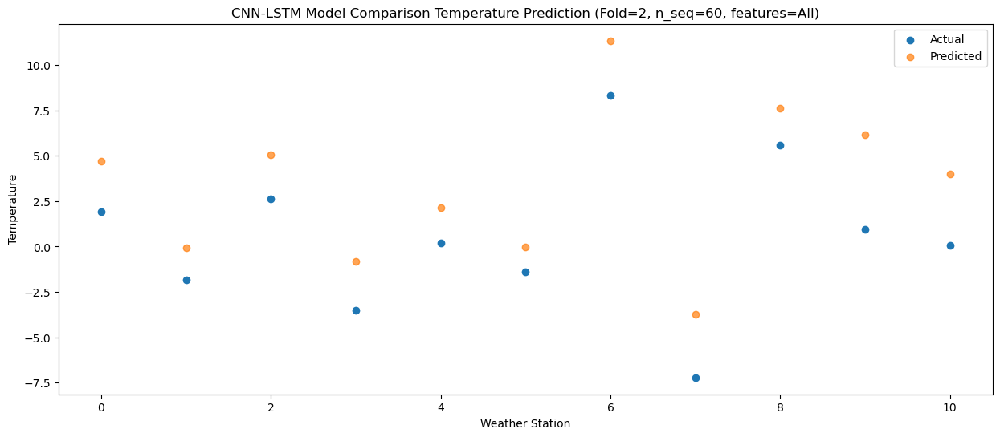

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   6.249609
1                 1   -2.10   1.494960
2                 2    2.44   6.639899
3                 3   -2.21   1.190413
4                 4    1.37   3.614878
5                 5   -0.62   1.417112
6                 6    9.22  12.758291
7                 7   -7.93  -2.030739
8                 8    5.23   9.493331
9                 9    4.13   7.924011
10               10    2.00   5.786521


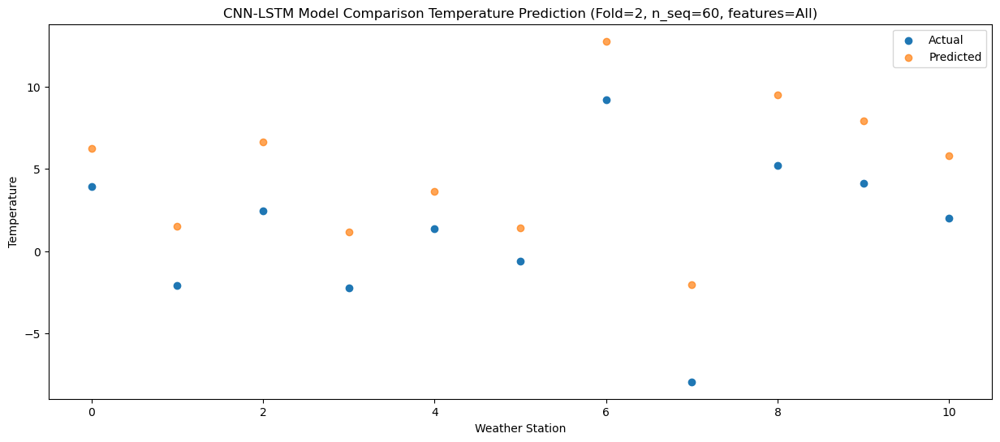

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   7.895015
1                 1   -0.50   2.890211
2                 2    5.50   8.959162
3                 3   -4.09   1.662240
4                 4    3.50   5.912400
5                 5    0.57   3.516815
6                 6    9.41  14.693205
7                 7   -6.72  -0.630869
8                 8    4.91  10.512910
9                 9    7.15   9.410182
10               10    4.79   7.095146


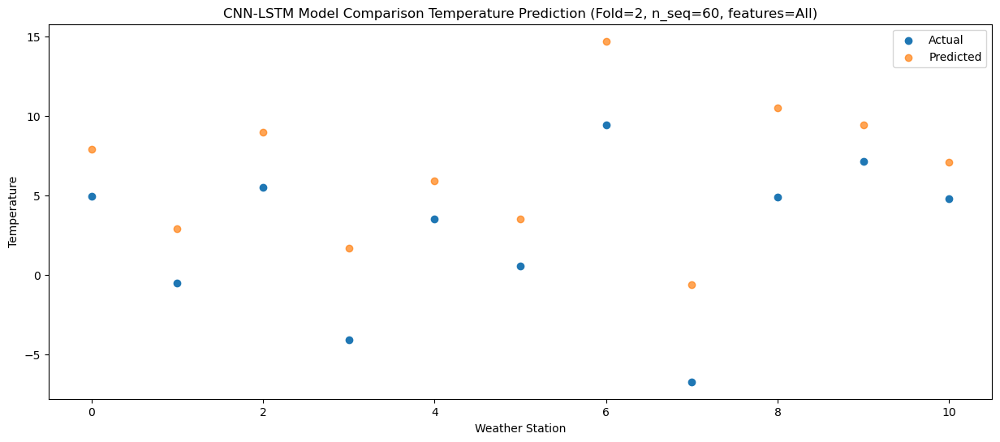

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21  10.201483
1                 1    3.57   5.858535
2                 2    6.52   9.734535
3                 3   -1.65   2.689094
4                 4    5.33   7.460539
5                 5    4.37   5.677808
6                 6   14.06  17.283933
7                 7   -2.02   1.157333
8                 8    5.92  11.886569
9                 9    7.60  10.635860
10               10    5.32   8.464829


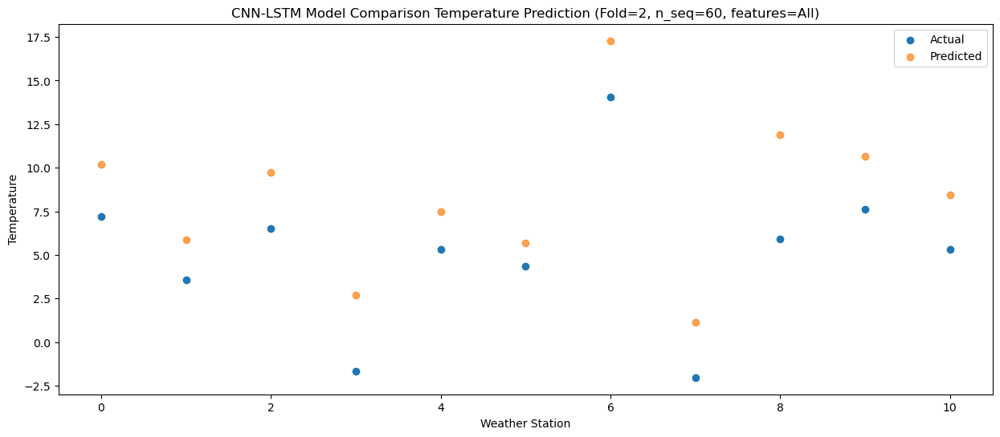

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  15.131535
1                 1    9.43  11.969497
2                 2    9.06  11.444108
3                 3    4.07   9.113244
4                 4    7.25   9.876569
5                 5    5.29   8.925171
6                 6   15.88  21.568783
7                 7    3.62   5.170194
8                 8    9.76  15.480699
9                 9   11.12  14.913494
10               10   10.21  13.355375


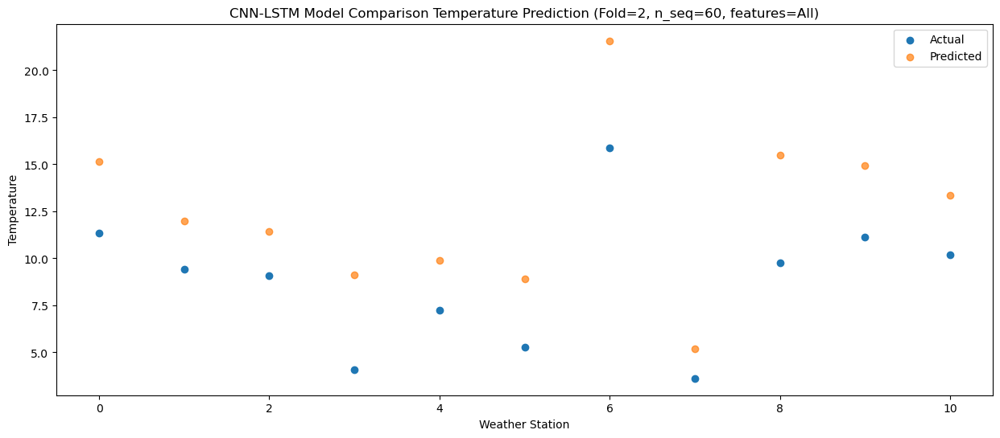

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  19.888256
1                 1   14.92  18.316153
2                 2   10.04  13.018317
3                 3    7.70  12.403530
4                 4   11.28  12.703842
5                 5   10.37  12.940909
6                 6   21.62  26.570616
7                 7    8.27   9.169069
8                 8   10.97  19.050369
9                 9   13.90  17.836165
10               10   13.56  16.666941


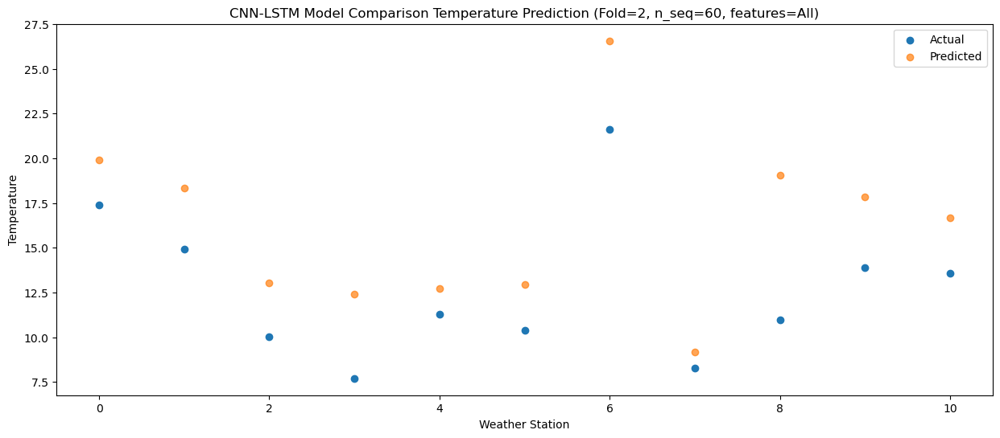

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  23.707218
1                 1   17.53  22.117490
2                 2   12.45  15.403460
3                 3   11.49  15.948111
4                 4   14.93  15.715313
5                 5   15.29  16.323034
6                 6   25.77  30.283718
7                 7   12.93  12.084303
8                 8   12.93  21.204542
9                 9   17.56  21.085198
10               10   16.47  20.122070


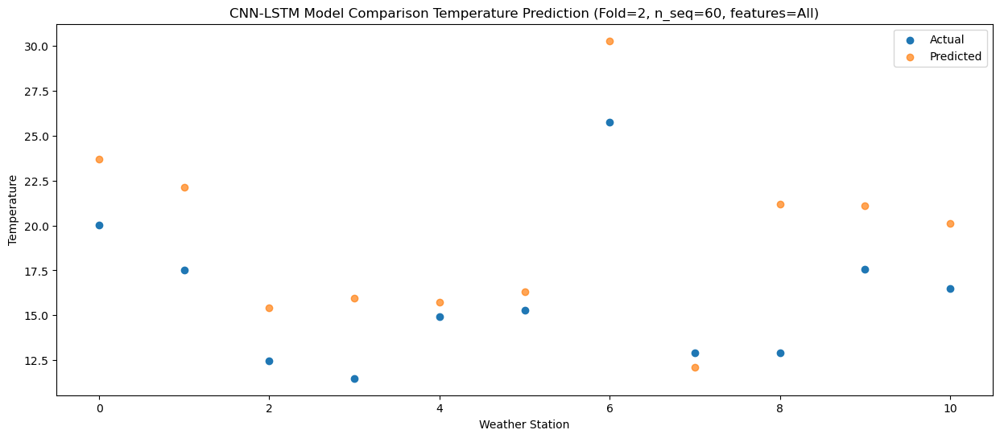

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  26.423615
1                 1   21.63  24.826141
2                 2   14.36  19.722571
3                 3   17.06  20.468519
4                 4   16.37  19.111490
5                 5   17.45  19.251613
6                 6   28.33  32.790103
7                 7   17.68  16.310414
8                 8   19.85  26.587980
9                 9   21.15  25.062996
10               10   20.02  23.970032


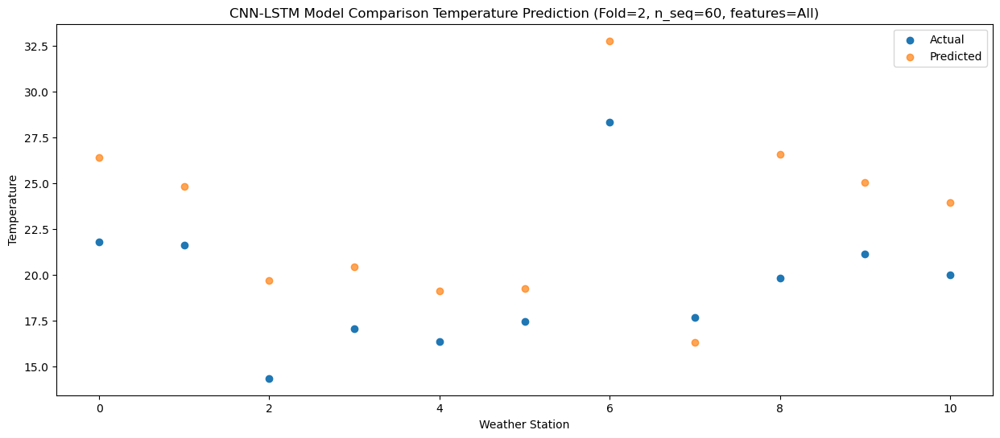

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  26.389707
1                 1   22.12  24.877937
2                 2   14.54  19.716825
3                 3   15.05  18.630503
4                 4   17.67  19.439909
5                 5   19.15  19.695147
6                 6   30.67  33.237520
7                 7   14.68  15.943456
8                 8   19.48  25.789179
9                 9   20.60  24.346988
10               10   19.31  23.122896


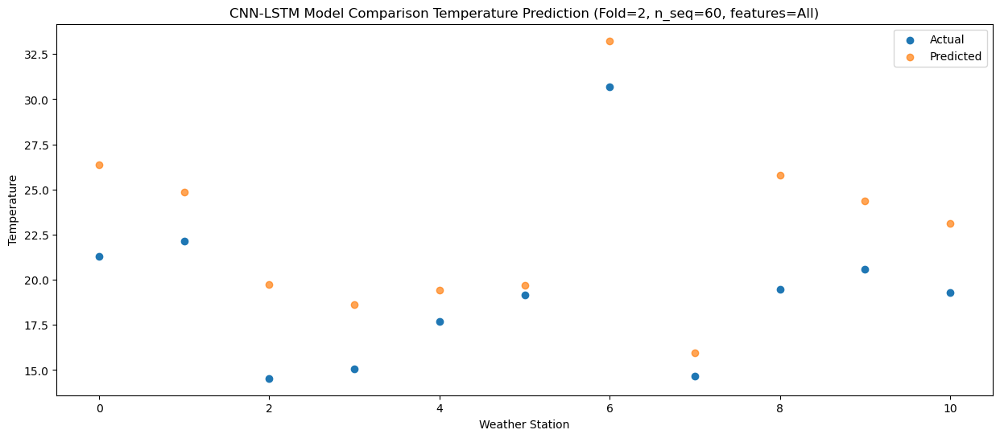

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  22.775833
1                 1   19.25  21.017252
2                 2   12.59  15.977588
3                 3   12.63  15.514102
4                 4   13.24  15.679401
5                 5   14.67  15.858048
6                 6   25.89  29.402207
7                 7   12.02  12.080259
8                 8   15.98  21.686334
9                 9   16.64  20.920064
10               10   16.53  19.758730


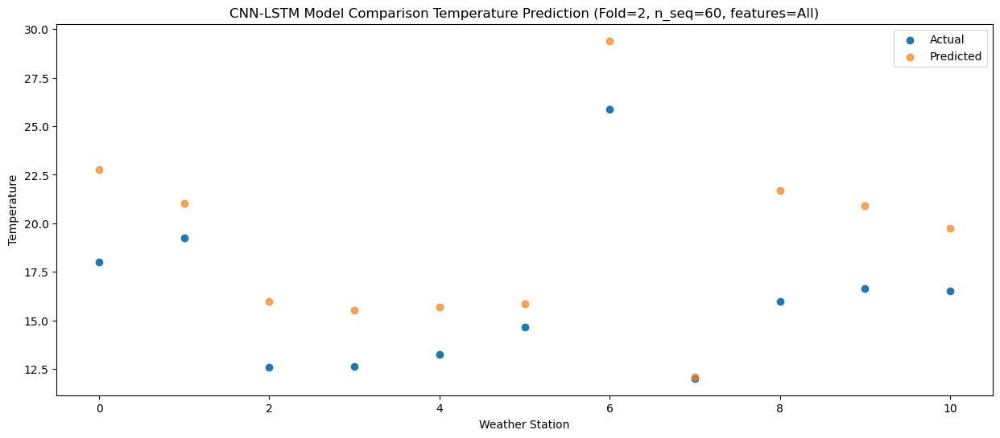

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  15.645011
1                 1   10.21  13.014726
2                 2    9.01  11.386370
3                 3    7.61  10.023783
4                 4    7.08   9.886608
5                 5    6.78   9.182844
6                 6   17.17  22.004667
7                 7    5.28   6.042092
8                 8   14.39  16.583008
9                 9   11.35  15.327927
10               10   10.48  13.891954


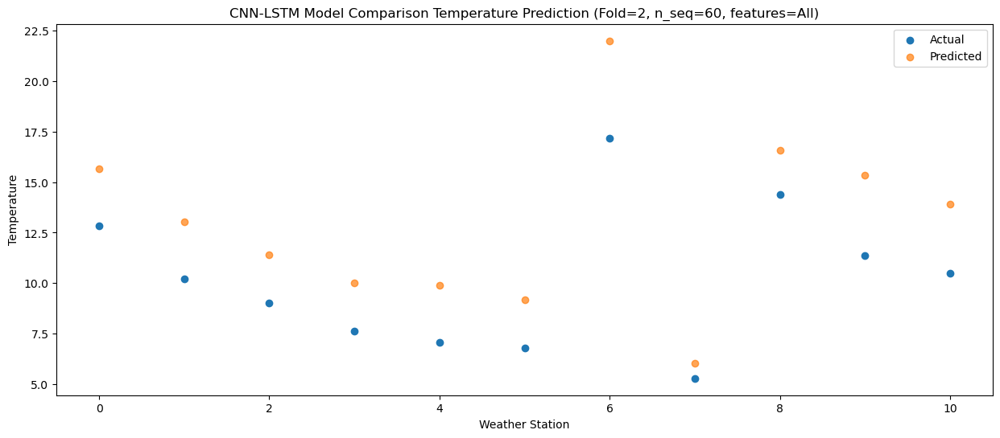

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74   9.963984
1                 1    3.49   7.240651
2                 2    5.03   7.396734
3                 3   -0.37   3.694457
4                 4    1.97   5.381622
5                 5    0.50   4.244607
6                 6   11.83  16.662207
7                 7   -1.83   1.023990
8                 8   10.00  11.984792
9                 9    5.45  10.000931
10               10    4.27   8.260468


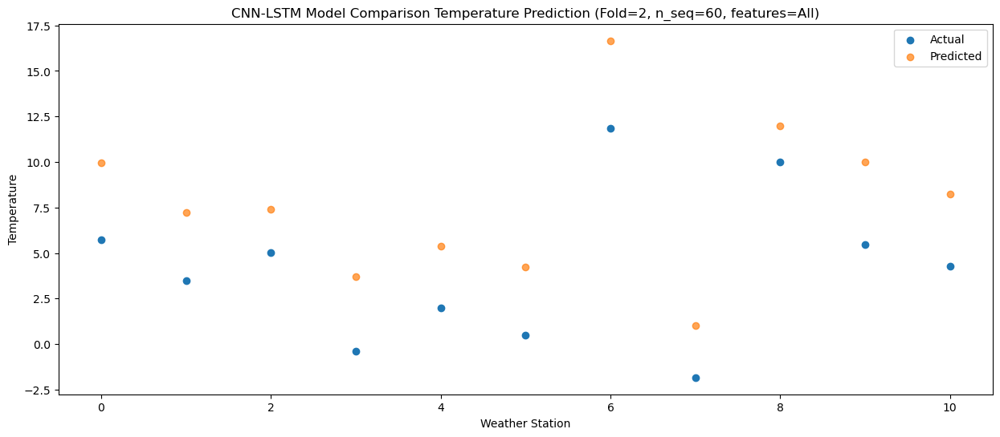

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68   7.422744
1                 1   -0.18   4.428430
2                 2    3.10   5.163432
3                 3   -1.11   2.435496
4                 4   -0.63   2.834730
5                 5   -1.61   1.481258
6                 6    8.85  13.780824
7                 7   -6.87  -1.256714
8                 8    7.67   9.957991
9                 9    2.98   8.093968
10               10    1.42   6.393123


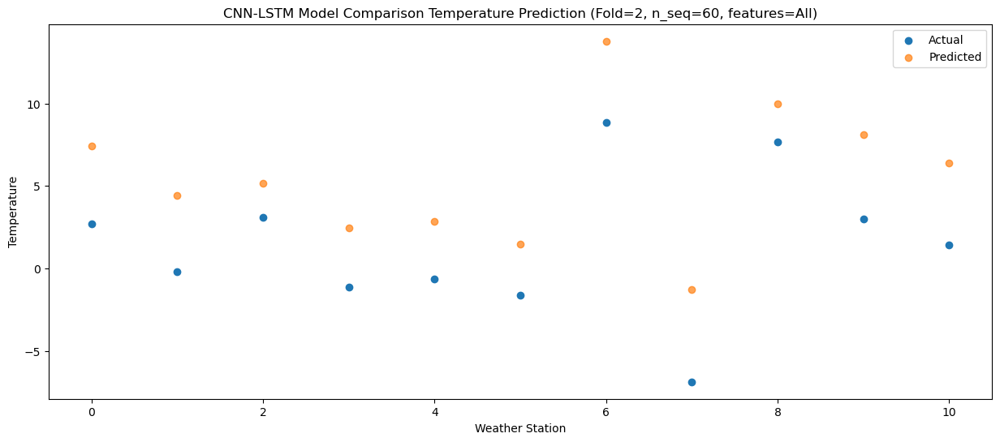

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11   2.614657
1                 1   -5.27  -1.100478
2                 2    1.10   4.645918
3                 3   -5.28  -1.296872
4                 4   -2.71   0.604606
5                 5   -5.76  -2.028620
6                 6    3.67   9.133075
7                 7   -7.20  -3.961176
8                 8    5.87   8.785713
9                 9    1.13   5.245543
10               10   -1.90   2.949347


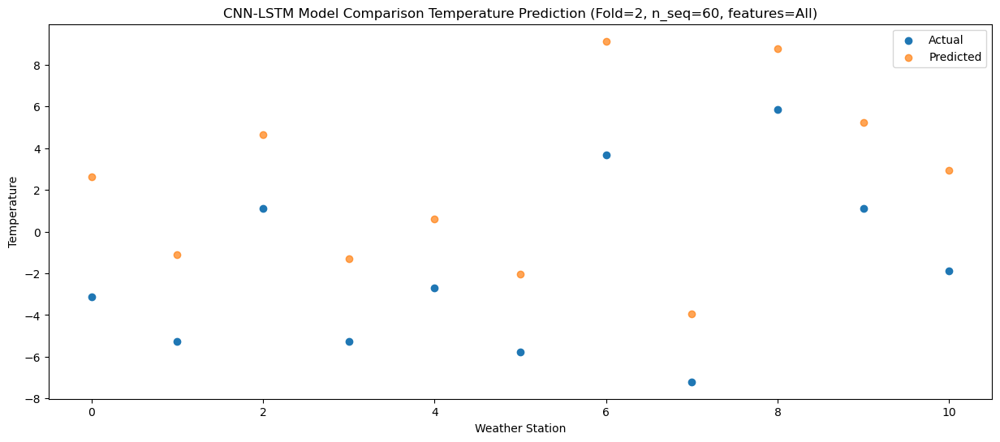

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21   8.666420
1                 1    2.21   6.187881
2                 2    1.58   5.618534
3                 3   -4.60   0.745684
4                 4    1.45   4.154748
5                 5    1.00   3.336653
6                 6   11.93  15.813999
7                 7   -3.99  -0.351446
8                 8    6.40  10.284751
9                 9    4.35   7.945758
10               10    2.64   6.143117


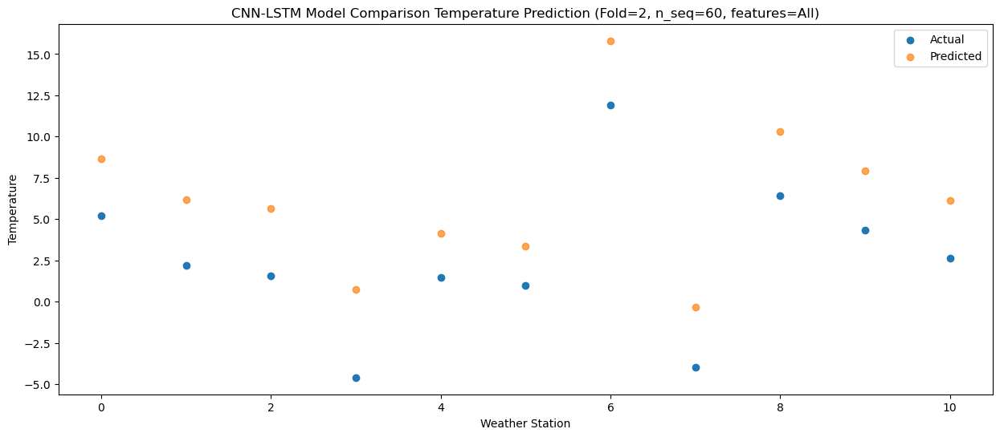

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10  12.122760
1                 1    4.98   9.035898
2                 2    6.00   9.809329
3                 3   -0.20   4.865594
4                 4    4.12   8.030107
5                 5    3.37   6.843821
6                 6   14.28  19.064203
7                 7   -1.42   3.114667
8                 8    7.34  13.697325
9                 9    7.91  11.990388
10               10    6.81  10.127444


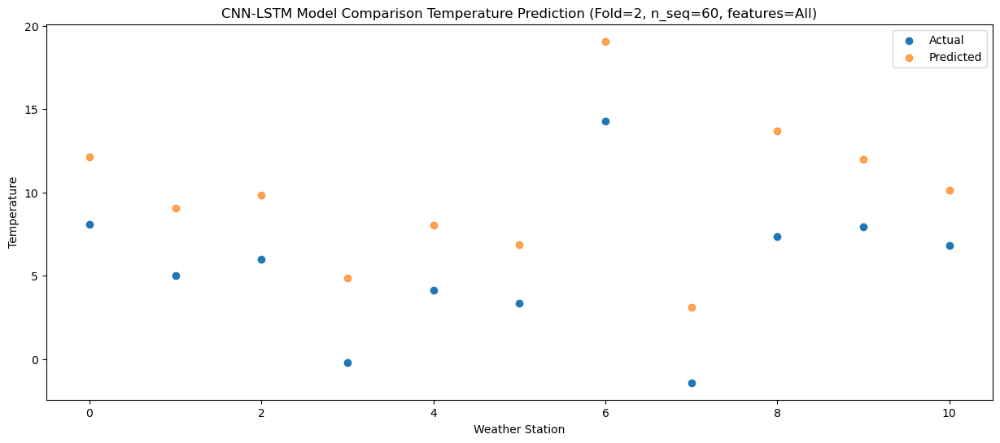

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  16.867388
1                 1   10.39  14.437408
2                 2    7.39  12.171309
3                 3    2.23   9.419587
4                 4    7.78  11.283282
5                 5    7.11  10.793056
6                 6   17.73  23.650289
7                 7    2.99   6.967544
8                 8    9.45  16.908375
9                 9   11.97  15.839677
10               10   10.79  14.334141


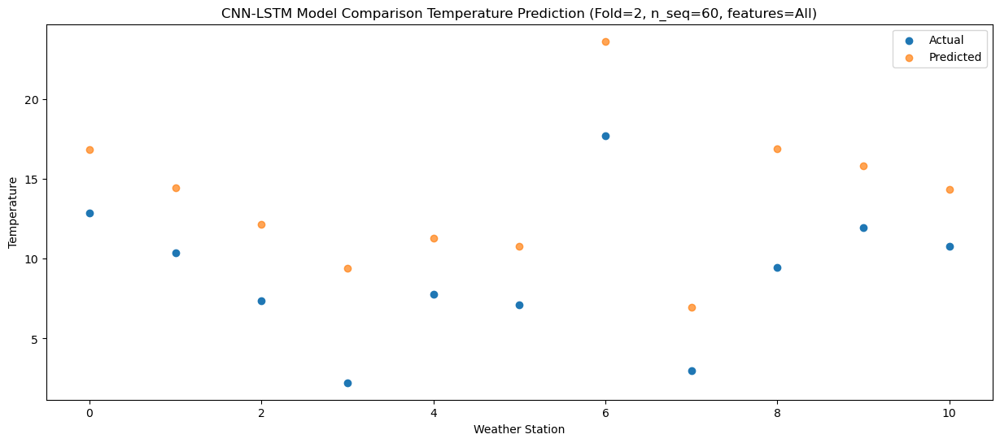

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  22.004221
1                 1   15.00  19.491581
2                 2   12.24  16.013263
3                 3    8.02  15.040480
4                 4   12.83  15.550328
5                 5   10.81  15.311556
6                 6   22.62  28.465946
7                 7    8.81  11.381260
8                 8   11.25  20.732081
9                 9   16.35  20.766535
10               10   15.25  19.496751


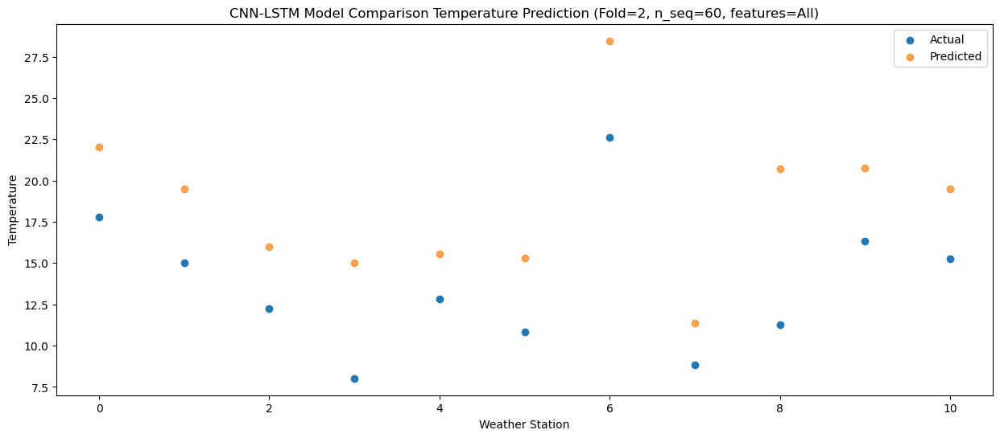

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  25.463563
1                 1   21.17  24.053955
2                 2   13.15  18.138563
3                 3   13.99  18.451556
4                 4   14.66  18.016184
5                 5   14.04  18.326135
6                 6   26.12  31.974313
7                 7   15.23  14.999870
8                 8   15.93  24.600629
9                 9   20.23  23.631086
10               10   19.60  22.548618


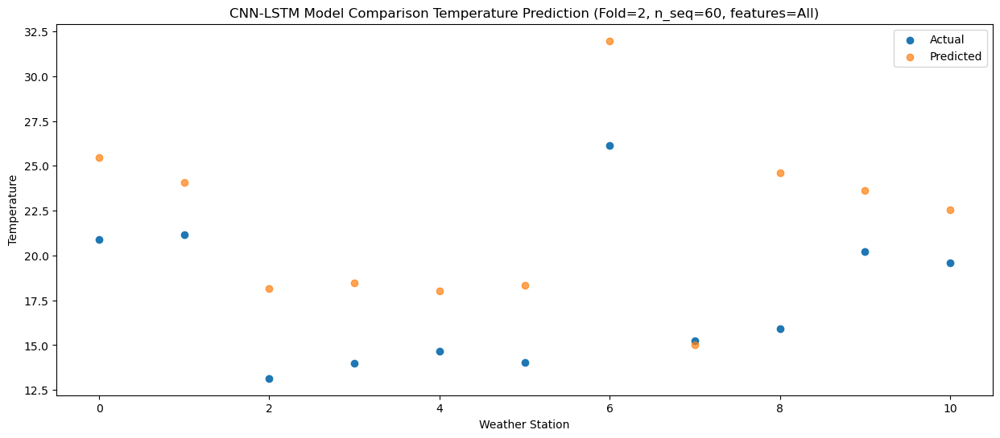

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  25.648116
1                 1   21.72  24.887311
2                 2   13.99  19.257440
3                 3   16.77  20.203387
4                 4   15.27  18.340906
5                 5   12.52  18.400263
6                 6   26.43  31.996580
7                 7   14.70  16.353931
8                 8   19.66  27.055452
9                 9   21.62  24.640940
10               10   20.83  23.517191


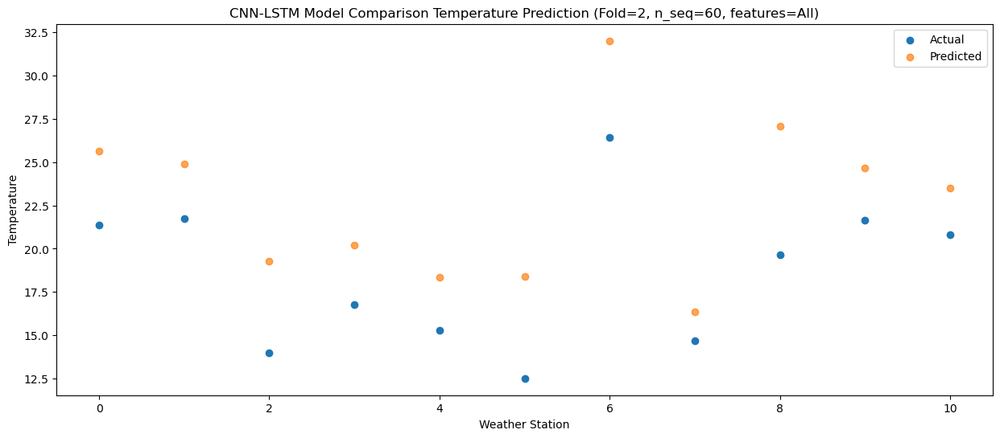

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  25.590628
1                 1   21.77  24.704822
2                 2   13.95  18.124600
3                 3   15.06  18.338063
4                 4   15.62  18.045862
5                 5   14.17  18.504580
6                 6   28.23  32.268778
7                 7   15.09  15.425572
8                 8   19.24  25.209987
9                 9   19.60  23.574333
10               10   19.21  22.487211


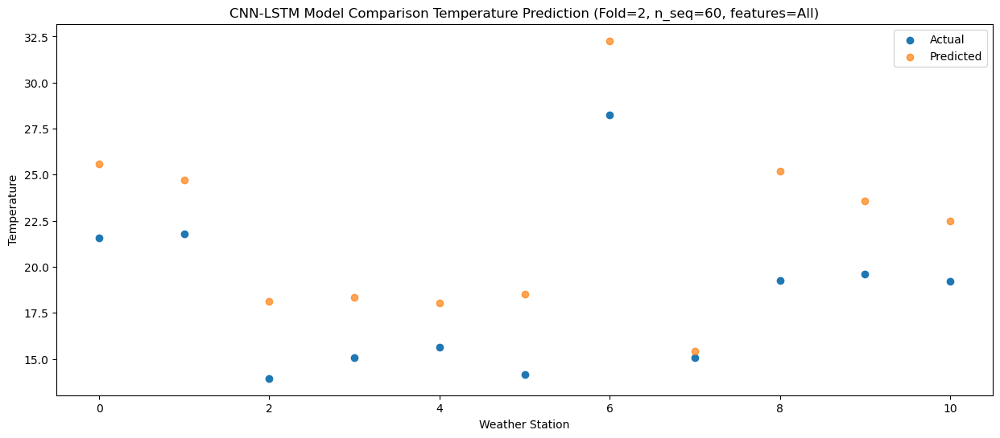

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  22.662879
1                 1   18.04  21.628914
2                 2   13.63  15.864067
3                 3   11.54  16.056466
4                 4   12.82  15.391927
5                 5   11.44  15.577405
6                 6   24.00  29.203175
7                 7   11.06  12.725265
8                 8   17.39  22.826296
9                 9   16.64  21.115497
10               10   16.62  19.977926


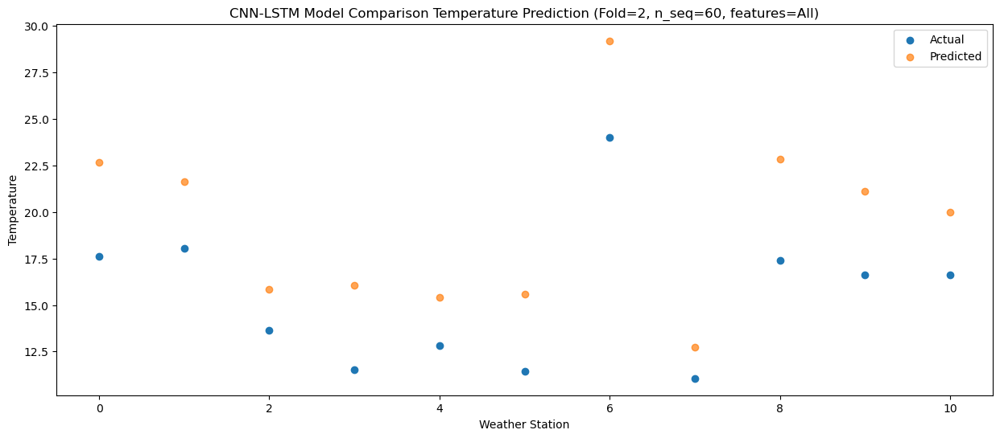

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  17.662252
1                 1   13.07  16.146569
2                 2   10.16  12.164485
3                 3    6.28  10.121455
4                 4    8.13  11.466354
5                 5    8.79  11.325321
6                 6   21.03  24.546196
7                 7    6.80   7.962472
8                 8   14.40  18.027177
9                 9   11.42  16.272776
10               10   10.20  14.865475


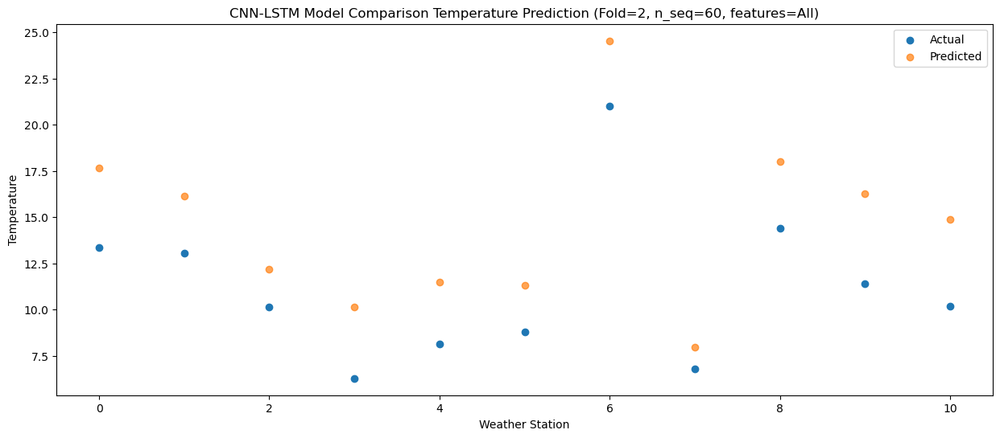

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_12 (Conv1D)          (None, 1, 1024)           2028544   
                                                                 
 max_pooling1d_12 (MaxPoolin  (None, 1, 1024)          0         
 g1D)                                                            
                                                                 
 dropout_36 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_24 (LSTM)              (None, 1, 512)            3147776   
                                                                 
 dropout_37 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_25 (LSTM)              (None, 512)               2099200   
                                                     

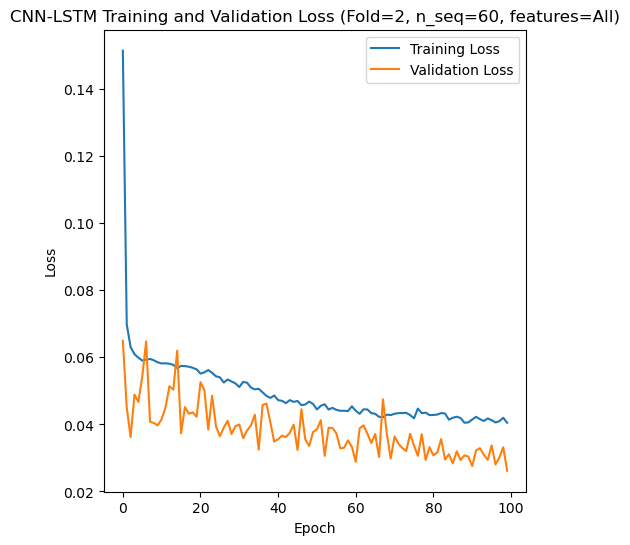

Epoch 1/100
84/84 [==============================] - 7s 43ms/step - loss: 0.1329 - accuracy: 0.3095 - mae: 0.1139 - rmse: 0.1329 - mape: 24.8726 - pearson: 0.6466 - val_loss: 0.0712 - val_accuracy: 0.5000 - val_mae: 0.0555 - val_rmse: 0.0712 - val_mape: 12.0695 - val_pearson: 0.7980
Epoch 2/100
84/84 [==============================] - 2s 28ms/step - loss: 0.0674 - accuracy: 0.4762 - mae: 0.0537 - rmse: 0.0674 - mape: 12.6645 - pearson: 0.8252 - val_loss: 0.0947 - val_accuracy: 0.1000 - val_mae: 0.0755 - val_rmse: 0.0947 - val_mape: 15.7554 - val_pearson: 0.6888
Epoch 3/100
84/84 [==============================] - 2s 26ms/step - loss: 0.0620 - accuracy: 0.5238 - mae: 0.0494 - rmse: 0.0620 - mape: 11.5436 - pearson: 0.8536 - val_loss: 0.0842 - val_accuracy: 0.5000 - val_mae: 0.0670 - val_rmse: 0.0842 - val_mape: 15.8456 - val_pearson: 0.7400
Epoch 4/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0606 - accuracy: 0.5952 - mae: 0.0485 - rmse: 0.0606 - mape: 11.4843 - p

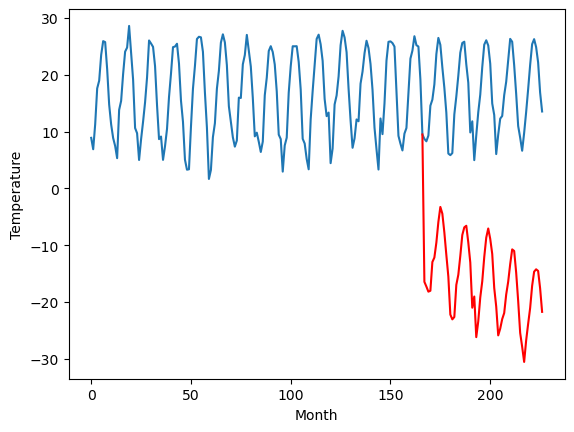

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		2.39		-0.50
1.54		1.07		-0.47
0.70		-0.01		-0.71
0.85		-0.05		-0.90
8.34		6.93		-1.41
9.26		7.92		-1.34
13.66		11.93		-1.73
20.76		17.10		-3.66
22.62		19.01		-3.61
20.76		17.78		-2.98
17.09		12.92		-4.17
9.98		6.62		-3.36
7.16		3.77		-3.39
0.61		-2.93		-3.54
-0.54		-3.96		-3.42
-4.26		-7.19		-2.93
7.71		3.65		-4.06
9.57		5.14		-4.43
13.79		9.04		-4.75
20.50		14.52		-5.98
21.81		16.07		-5.74
22.38		16.23		-6.15
19.65		13.40		-6.25
13.05		7.87		-5.18
5.34		-0.02		-5.36
6.65		1.38		-5.27
-2.18		-6.71		-4.53
-0.96		-5.67		-4.71
5.82		0.66		-5.16
10.67		5.31		-5.36
16.10		10.15		-5.95
21.25		14.92		-6.33
25.29		17.31		-7.98
22.21		14.33		-7.88
18.35		11.38		-6.97
11.80		4.36		-7.44
4.57		-2.33		-6.90
0.52		-6.77		-7.29
1.22		-5.87		-7.09
3.18		-4.45		-7.63
5.78		-1.74		-7.52
10.83		2.22		-8.61
16.14		6.90		-9.24
20.47		10.66		-9.81
22.73		12.59		-10.14
22.91		13.39		-9.52
18.86		8.99		-9.87


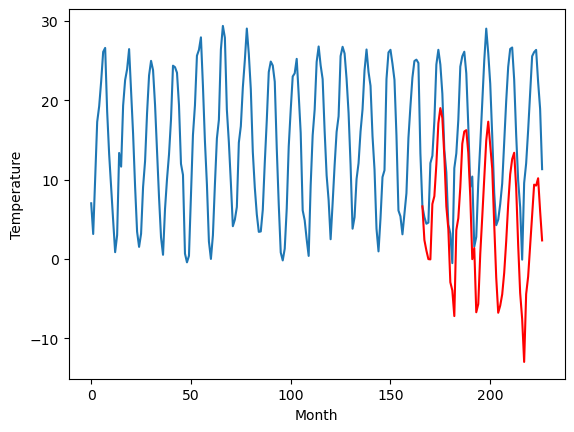

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		5.26		0.53
2.20		2.73		0.53
0.98		2.61		1.63
3.40		3.13		-0.27
5.19		7.07		1.88
9.85		9.24		-0.61
15.04		12.19		-2.85
18.39		14.55		-3.84
21.17		16.83		-4.34
21.70		17.55		-4.15
17.37		12.99		-4.38
11.88		8.06		-3.82
3.23		3.60		0.37
0.03		-1.16		-1.19
1.29		-1.01		-2.30
3.59		-0.64		-4.23
4.74		2.85		-1.89
10.47		5.07		-5.40
15.27		8.56		-6.71
20.12		13.23		-6.89
23.25		15.10		-8.15
21.05		13.89		-7.16
17.74		11.48		-6.26
9.08		5.70		-3.38
4.74		1.61		-3.13
0.82		-0.46		-1.28
0.49		-3.67		-4.16
2.19		-3.27		-5.46
6.90		0.93		-5.97
9.97		3.85		-6.12
14.21		6.36		-7.85
19.60		10.77		-8.83
22.17		14.35		-7.82
22.35		12.85		-9.50
19.53		10.04		-9.49
12.35		3.84		-8.51
1.62		-3.57		-5.19
0.66		-6.63		-7.29
2.05		-6.38		-8.43
1.20		-5.84		-7.04
4.07		-2.91		-6.98
9.70		0.16		-9.54
14.14		4.38		-9.76
16.94		6.70		-10.24
22.60		10.28		-12.32
20.91		10.88		-10.03
17.14		6.14		-11.00
11.83		-0.0

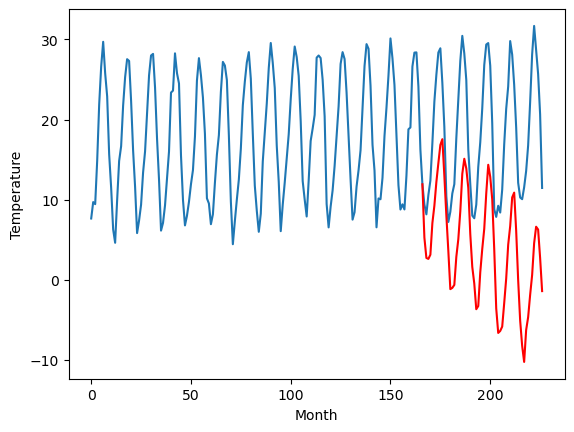

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-5.63		1.68
-7.30		-6.65		0.65
-7.85		-7.78		0.07
-8.20		-7.96		0.24
-1.29		-2.14		-0.85
-0.65		-1.17		-0.52
3.92		2.54		-1.38
9.74		7.54		-2.20
13.54		10.36		-3.18
11.12		8.51		-2.61
7.06		4.62		-2.44
1.64		-0.61		-2.25
-2.28		-4.00		-1.72
-9.48		-10.91		-1.43
-10.94		-12.44		-1.50
-12.26		-13.72		-1.46
-2.05		-5.43		-3.38
0.30		-3.24		-3.54
4.37		0.49		-3.88
10.29		5.34		-4.95
11.28		6.61		-4.67
11.80		7.08		-4.72
7.67		3.78		-3.89
4.09		-0.29		-4.38
-5.57		-9.30		-3.73
-4.08		-7.78		-3.70
-13.03		-16.03		-3.00
-8.51		-13.22		-4.71
-2.76		-8.03		-5.27
0.25		-4.64		-4.89
7.03		0.84		-6.19
10.51		4.72		-5.79
12.06		6.60		-5.46
10.99		4.45		-6.54
7.01		1.28		-5.73
-0.26		-5.19		-4.93
-3.38		-9.20		-5.82
-8.65		-14.99		-6.34
-6.90		-13.65		-6.75
-4.56		-12.36		-7.80
-4.32		-11.17		-6.85
1.92		-6.59		-8.51
4.61		-3.53		-8.14
8.35		0.02		-8.33
11.97		2.49		-9.48
10.86		1.90		-8.96
8.13		-1

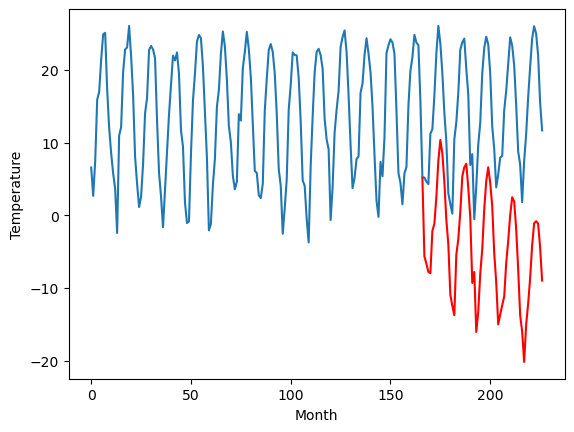

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		0.86		-4.78
2.38		-0.49		-2.87
-0.49		-1.77		-1.28
0.66		-1.92		-2.58
8.07		4.80		-3.27
11.10		6.06		-5.04
17.17		10.47		-6.70
24.22		16.22		-8.00
25.68		18.59		-7.09
23.12		16.81		-6.31
19.05		12.01		-7.04
11.32		5.55		-5.77
8.50		2.68		-5.82
1.33		-4.23		-5.56
-0.14		-5.71		-5.57
-4.01		-8.94		-4.93
9.07		1.93		-7.14
12.36		3.95		-8.41
16.93		7.97		-8.96
24.41		13.76		-10.65
24.41		15.15		-9.26
24.53		15.48		-9.05
21.17		12.25		-8.92
15.75		7.02		-8.73
6.01		-1.71		-7.72
5.65		-0.89		-6.54
-3.82		-9.34		-5.52
-1.30		-7.57		-6.27
7.16		-1.25		-8.41
11.29		3.06		-8.23
18.86		8.76		-10.10
24.31		13.46		-10.85
25.43		15.77		-9.66
23.61		13.10		-10.51
19.29		9.80		-9.49
12.02		2.76		-9.26
6.13		-3.21		-9.34
0.16		-8.74		-8.90
1.88		-7.63		-9.51
8.40		-6.40		-14.80
5.44		-4.27		-9.71
12.65		0.76		-11.89
18.65		5.18		-13.47
22.75		9.04		-13.71
24.45		11.08		-13.37
23.16		11.11		-12.05
19.80	

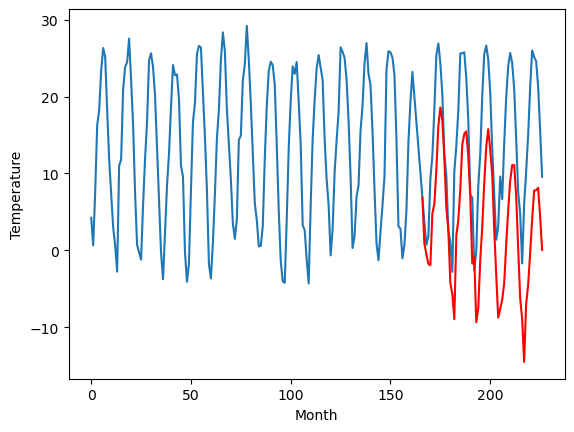

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-1.64		1.41
-2.84		-2.79		0.05
-4.26		-4.04		0.22
-4.67		-4.27		0.40
2.19		2.06		-0.13
4.46		3.15		-1.31
9.87		7.30		-2.57
16.86		12.85		-4.01
18.75		15.51		-3.24
16.24		13.56		-2.68
12.61		9.22		-3.39
6.61		3.29		-3.32
2.67		0.19		-2.48
-4.94		-6.79		-1.85
-6.39		-8.41		-2.02
-9.11		-10.78		-1.67
2.22		-0.97		-3.19
5.67		1.19		-4.48
9.95		5.10		-4.85
16.66		10.50		-6.16
17.04		11.79		-5.25
17.36		12.26		-5.10
14.10		8.94		-5.16
9.52		4.34		-5.18
-1.33		-4.78		-3.45
-0.28		-3.54		-3.26
-9.10		-12.11		-3.01
-5.91		-9.72		-3.81
1.05		-3.90		-4.95
4.90		-0.04		-4.94
12.70		5.74		-6.96
16.64		10.03		-6.61
18.63		12.09		-6.54
16.98		9.68		-7.30
13.03		6.38		-6.65
6.99		-0.39		-7.38
0.44		-5.27		-5.71
-5.10		-11.08		-5.98
-2.96		-9.81		-6.85
-1.24		-8.59		-7.35
-0.34		-7.01		-6.67
5.89		-2.05		-7.94
11.30		1.66		-9.64
14.76		5.42		-9.34
18.02		7.66		-10.36
16.47		7.28		-9.19
13.01		3.45		-9.

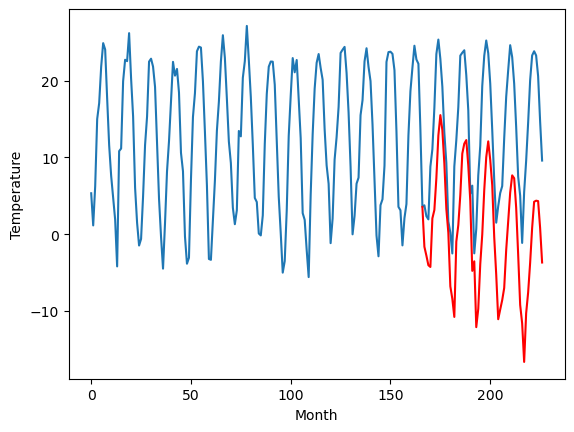

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		2.67		6.81
-9.81		0.51		10.32
-9.90		0.01		9.91
-9.71		0.26		9.97
-4.78		5.41		10.19
-1.80		7.22		9.02
5.31		10.78		5.47
9.52		14.35		4.83
11.51		16.51		5.00
12.26		16.46		4.20
6.76		11.64		4.88
3.02		5.99		2.97
-4.17		2.16		6.33
-9.87		-3.30		6.57
-9.60		-3.64		5.96
-9.50		-4.84		4.66
-6.53		1.69		8.22
-1.75		3.74		5.49
3.30		7.45		4.15
10.69		12.66		1.97
12.53		14.40		1.87
10.61		13.69		3.08
8.74		11.05		2.31
0.77		5.18		4.41
-1.97		-0.33		1.64
-6.73		-1.40		5.33
-9.02		-6.41		2.61
-10.74		-5.80		4.94
-6.20		-0.67		5.53
-1.88		2.97		4.85
4.03		6.53		2.50
9.80		11.19		1.39
11.72		14.43		2.71
10.96		12.37		1.41
8.80		9.42		0.62
0.54		2.82		2.28
-7.14		-4.59		2.55
-9.31		-8.22		1.09
-10.04		-7.72		2.32
-10.01		-6.96		3.05
-8.22		-4.05		4.17
-2.88		-0.40		2.48
4.33		4.20		-0.13
8.91		7.10		-1.81
15.05		10.09		-4.96
12.46		10.70		-1.76
8.31		6.08		-2.23
2.18		-0.61		-2.79
-3.68		-6.11		-2

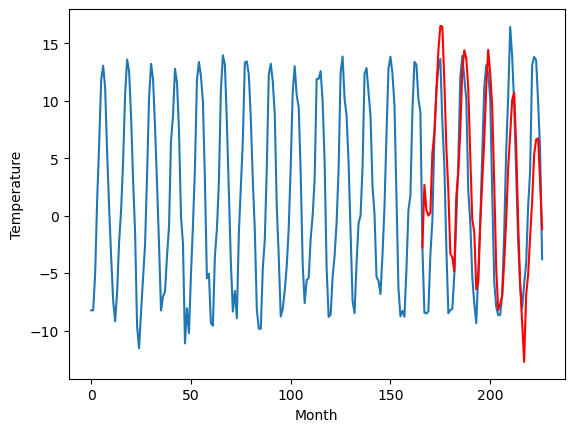

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		2.69		1.04
-3.08		0.13		3.21
-1.92		-0.10		1.82
-0.41		0.32		0.73
2.70		4.74		2.04
8.61		6.91		-1.70
15.88		10.24		-5.64
19.34		13.10		-6.24
23.57		15.29		-8.28
23.68		15.82		-7.86
18.87		10.97		-7.90
11.93		5.53		-6.40
3.12		1.31		-1.81
-2.57		-3.57		-1.00
-2.02		-3.57		-1.55
0.83		-4.03		-4.86
2.43		0.78		-1.65
10.40		3.00		-7.40
14.83		6.64		-8.19
22.47		11.74		-10.73
23.55		13.60		-9.95
22.32		12.46		-9.86
18.35		9.97		-8.38
8.00		3.86		-4.14
5.48		-0.52		-6.00
-1.79		-2.62		-0.83
-1.86		-6.27		-4.41
0.18		-6.02		-6.20
4.89		-1.33		-6.22
9.52		1.96		-7.56
14.19		4.84		-9.35
20.67		9.49		-11.18
22.90		13.15		-9.75
21.31		11.41		-9.90
18.95		8.48		-10.47
11.06		2.04		-9.02
-0.36		-5.87		-5.51
-2.69		-9.02		-6.33
-3.20		-8.75		-5.55
-2.29		-8.25		-5.96
0.54		-5.13		-5.67
8.49		-1.72		-10.21
14.29		2.94		-11.35
16.79		5.47		-11.32
25.15		8.89		-16.26
20.52		9.56		-10.96
15.82		4.78		-11

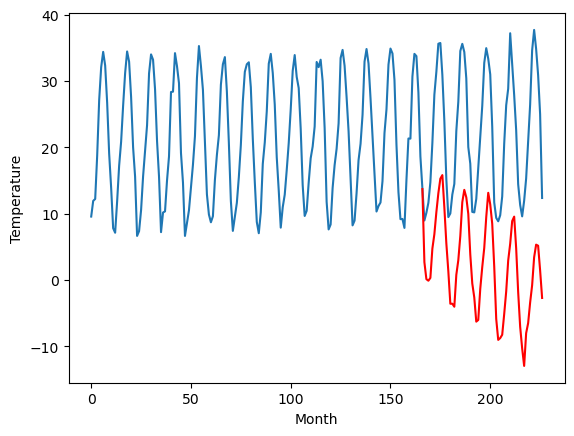

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		0.44		0.48
-1.29		-1.93		-0.64
-1.92		-1.98		-0.06
0.10		-1.39		-1.49
-0.46		2.32		2.78
3.16		4.30		1.14
5.56		6.82		1.26
8.10		8.73		0.63
7.29		10.98		3.69
9.17		11.83		2.66
8.59		7.60		-0.99
6.37		3.21		-3.16
-0.79		-1.41		-0.62
-2.84		-6.17		-3.33
-1.62		-5.85		-4.23
-0.69		-4.83		-4.14
-0.91		-2.23		-1.32
1.28		-0.20		-1.48
5.57		3.12		-2.45
7.27		7.26		-0.01
6.45		9.13		2.68
7.00		7.94		0.94
6.45		5.67		-0.78
3.69		0.28		-3.41
0.87		-3.66		-4.53
-2.83		-5.24		-2.41
-2.21		-8.31		-6.10
-1.25		-7.81		-6.56
0.98		-4.00		-4.98
2.42		-1.30		-3.72
5.41		0.85		-4.56
8.56		5.01		-3.55
6.91		8.38		1.47
8.33		6.96		-1.37
8.56		4.36		-4.20
3.83		-1.63		-5.46
-1.90		-8.50		-6.60
-3.10		-11.35		-8.25
-1.43		-11.11		-9.68
-3.23		-10.42		-7.19
-1.77		-7.64		-5.87
2.31		-5.11		-7.42
3.34		-1.34		-4.68
5.24		0.85		-4.39
8.25		4.45		-3.80
9.28		5.11		-4.17
6.67		0.38		-6.29
5.21		-5.48		-10.69
1.17

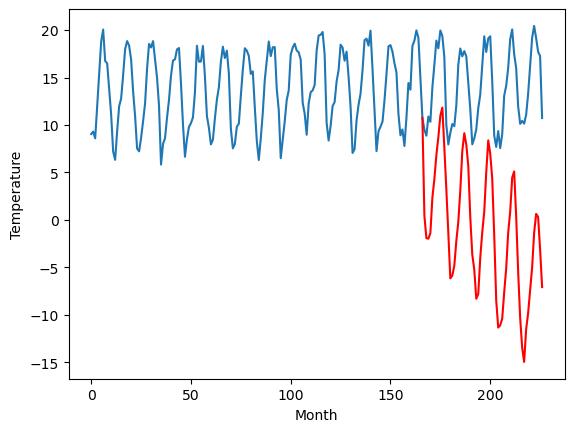

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-3.15		-0.07
-5.84		-4.62		1.22
-5.81		-5.49		0.32
-5.37		-5.73		-0.36
-1.79		-0.76		1.03
-0.35		0.72		1.07
5.21		4.70		-0.51
12.19		9.56		-2.63
16.14		12.82		-3.32
14.96		11.07		-3.89
10.62		7.10		-3.52
5.30		1.76		-3.54
1.23		-1.98		-3.21
-5.11		-8.45		-3.34
-8.13		-10.20		-2.07
-8.25		-10.92		-2.67
-3.25		-4.09		-0.84
1.37		-1.19		-2.56
6.20		2.62		-3.58
12.07		7.80		-4.27
14.21		9.06		-5.15
14.83		9.32		-5.51
11.51		5.81		-5.70
7.07		1.69		-5.38
-1.85		-7.03		-5.18
-3.45		-6.92		-3.47
-10.00		-14.29		-4.29
-7.24		-11.22		-3.98
-3.28		-6.38		-3.10
1.01		-3.49		-4.50
6.80		2.13		-4.67
11.12		5.89		-5.23
15.67		8.29		-7.38
15.59		6.72		-8.87
10.68		3.15		-7.53
4.42		-3.18		-7.60
0.46		-7.19		-7.65
-5.90		-13.31		-7.41
-3.92		-11.95		-8.03
-5.65		-11.26		-5.61
-3.68		-10.23		-6.55
2.37		-4.93		-7.30
6.01		-1.98		-7.99
10.00		1.37		-8.63
15.68		4.42		-11.26
13.43		3.27		-10.16
10.86		-

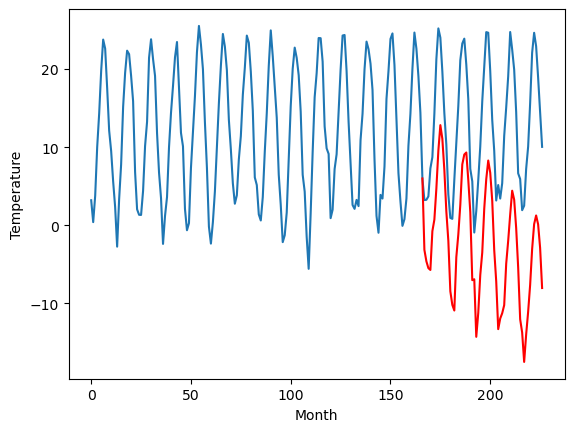

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-16.93		0.97
-20.86		-18.33		2.53
-20.45		-19.28		1.17
-19.53		-19.55		-0.02
-15.12		-14.36		0.76
-13.18		-12.96		0.22
-7.41		-8.90		-1.49
-0.69		-3.85		-3.16
3.08		-0.61		-3.69
1.21		-2.50		-3.71
-3.76		-6.49		-2.73
-9.25		-11.93		-2.68
-13.53		-15.57		-2.04
-20.35		-22.16		-1.81
-21.91		-23.98		-2.07
-22.71		-24.96		-2.25
-15.52		-17.60		-2.08
-10.65		-14.76		-4.11
-6.39		-10.92		-4.53
-0.22		-5.67		-5.45
1.42		-4.43		-5.85
1.15		-4.09		-5.24
-3.11		-7.63		-4.52
-7.23		-11.74		-4.51
-17.45		-20.70		-3.25
-17.86		-20.37		-2.51
-24.84		-28.06		-3.22
-21.03		-24.97		-3.94
-15.85		-19.98		-4.13
-12.03		-16.97		-4.94
-5.25		-11.19		-5.94
-1.26		-7.39		-6.13
2.52		-5.06		-7.58
1.65		-6.75		-8.40
-3.58		-10.33		-6.75
-11.19		-16.72		-5.53
-14.31		-20.73		-6.42
-21.34		-26.91		-5.57
-18.69		-25.51		-6.82
-18.48		-24.77		-6.29
-16.92		-23.73		-6.81
-9.35		-18.38		-9.03
-6.88		-15.37		-8.49


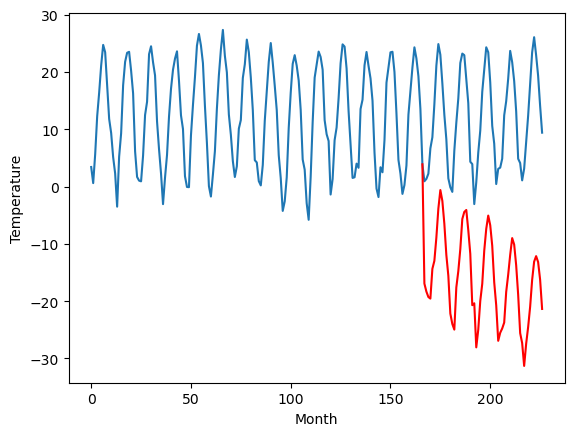

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-16.462186088562014, 2.3886583518981936, 5.261512556076049, -5.633395004272461, 0.8562559127807621, -1.640373687744141, 2.669793510437012, 2.6939154338836673, 0.4379582405090332, -3.150447769165039, -16.931881179809572]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -16.462186
1                 1    2.89   2.388658
2                 2    4.73   5.261513
3                 3   -7.31  -5.633395
4                 4    5.64   0.856256
5                 5   -3.05  -1.640374
6                 6   -4.14   2.669794
7                 7    1.65   2.693915
8                 8   -0.04   0.437958
9                 9   -3.08  -3.150448
10               10  -17.90 -16.931881


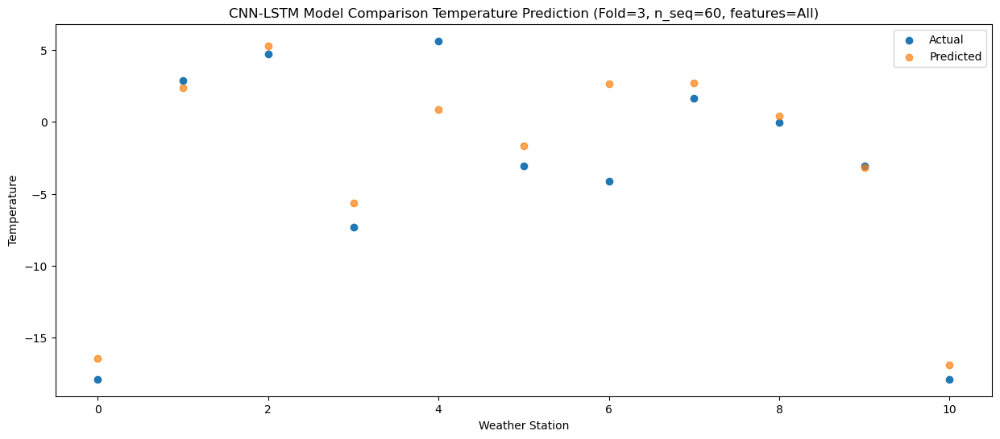

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -17.294396
1                 1    1.54   1.068626
2                 2    2.20   2.729341
3                 3   -7.30  -6.647210
4                 4    2.38  -0.487420
5                 5   -2.84  -2.793575
6                 6   -9.81   0.509405
7                 7   -3.08   0.130173
8                 8   -1.29  -1.926116
9                 9   -5.84  -4.617942
10               10  -20.86 -18.326480


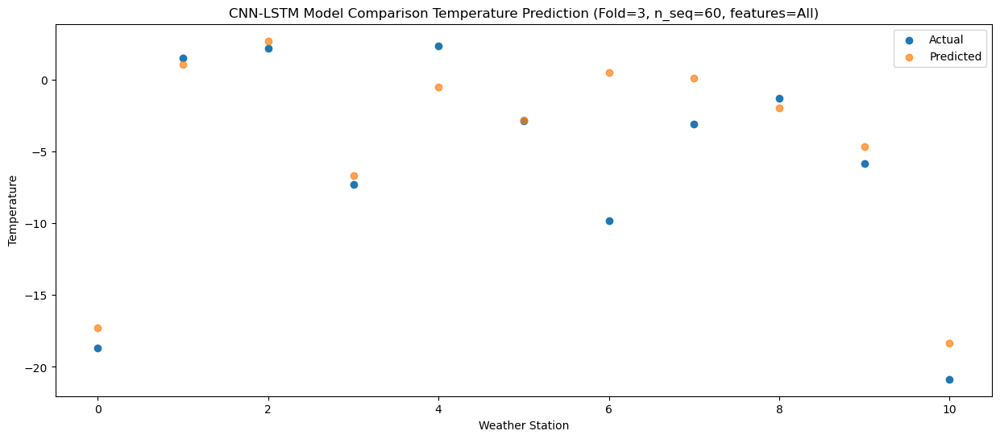

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -18.190337
1                 1    0.70  -0.012079
2                 2    0.98   2.607972
3                 3   -7.85  -7.775608
4                 4   -0.49  -1.769212
5                 5   -4.26  -4.044300
6                 6   -9.90   0.006046
7                 7   -1.92  -0.101117
8                 8   -1.92  -1.983479
9                 9   -5.81  -5.492855
10               10  -20.45 -19.275138


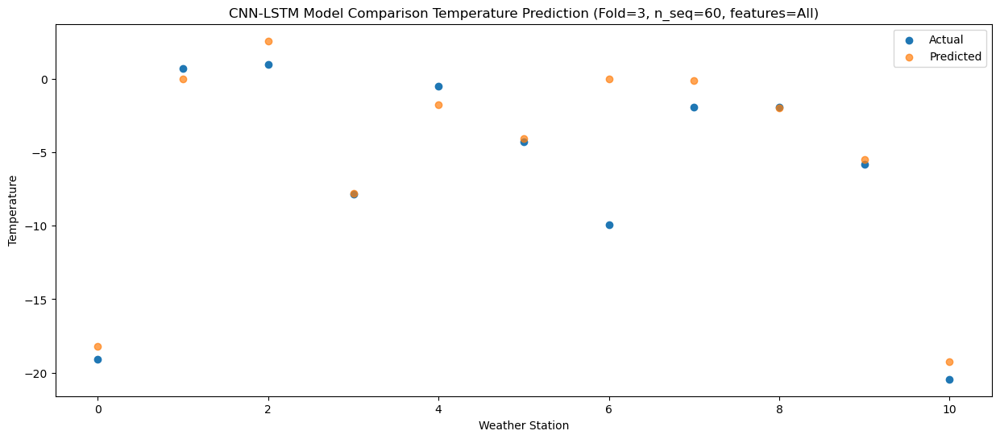

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -18.029741
1                 1    0.85  -0.048053
2                 2    3.40   3.132805
3                 3   -8.20  -7.958648
4                 4    0.66  -1.917491
5                 5   -4.67  -4.270315
6                 6   -9.71   0.256801
7                 7   -0.41   0.324114
8                 8    0.10  -1.389464
9                 9   -5.37  -5.725651
10               10  -19.53 -19.550302


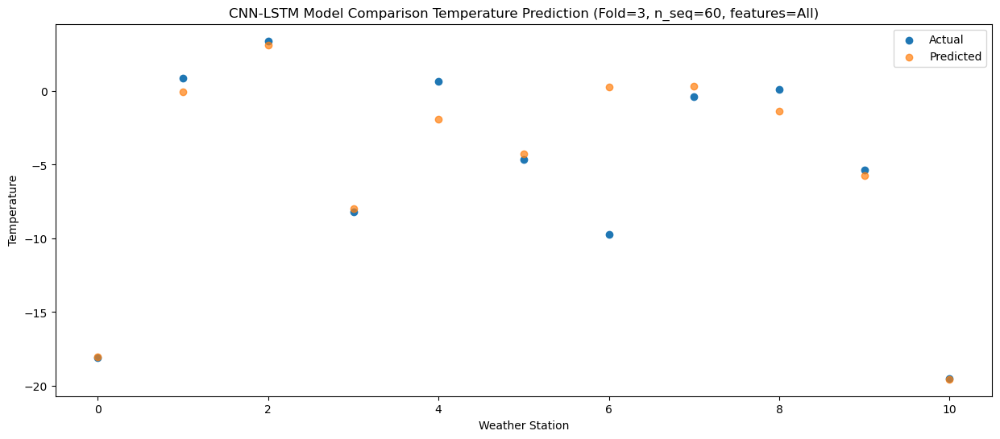

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -12.970174
1                 1    8.34   6.930930
2                 2    5.19   7.071610
3                 3   -1.29  -2.142523
4                 4    8.07   4.800437
5                 5    2.19   2.059881
6                 6   -4.78   5.408048
7                 7    2.70   4.737593
8                 8   -0.46   2.324643
9                 9   -1.79  -0.755031
10               10  -15.12 -14.360326


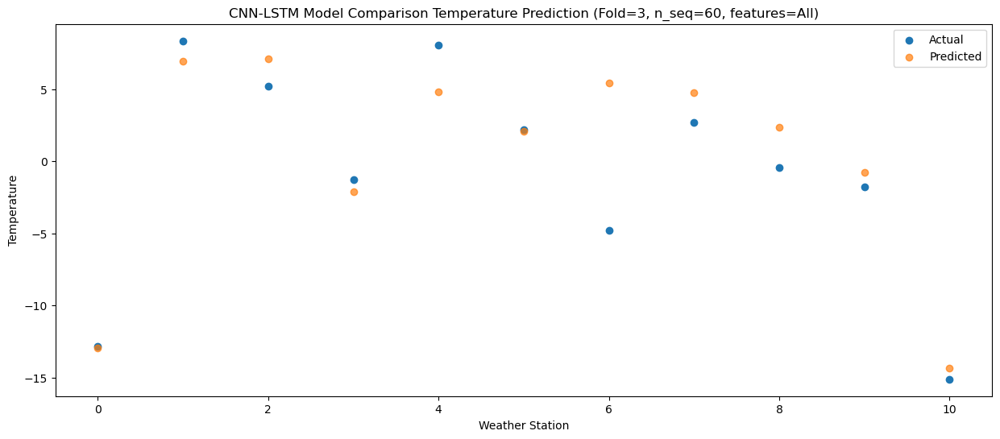

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -12.184749
1                 1    9.26   7.918891
2                 2    9.85   9.242063
3                 3   -0.65  -1.169074
4                 4   11.10   6.059366
5                 5    4.46   3.152573
6                 6   -1.80   7.223909
7                 7    8.61   6.914338
8                 8    3.16   4.302847
9                 9   -0.35   0.717181
10               10  -13.18 -12.963370


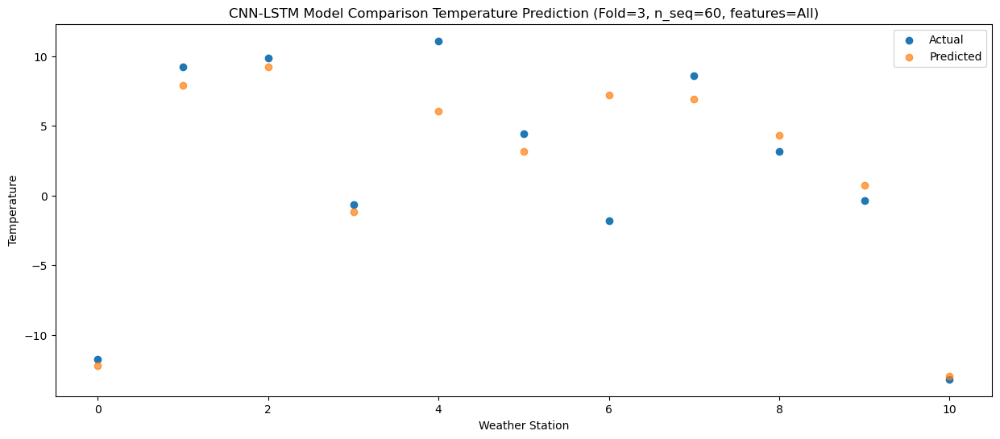

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07  -9.545415
1                 1   13.66  11.929106
2                 2   15.04  12.188021
3                 3    3.92   2.535905
4                 4   17.17  10.471316
5                 5    9.87   7.304395
6                 6    5.31  10.775557
7                 7   15.88  10.235090
8                 8    5.56   6.815584
9                 9    5.21   4.701152
10               10   -7.41  -8.904210


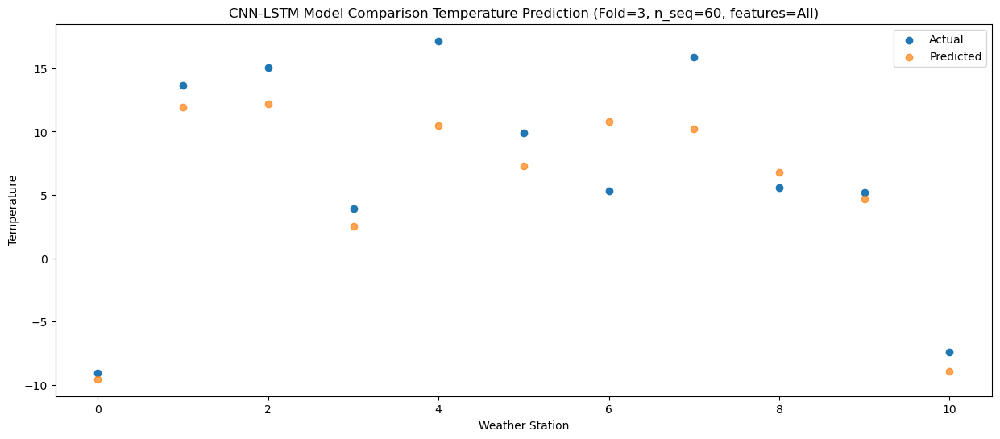

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -5.929836
1                 1   20.76  17.102233
2                 2   18.39  14.552901
3                 3    9.74   7.539565
4                 4   24.22  16.223125
5                 5   16.86  12.853780
6                 6    9.52  14.346085
7                 7   19.34  13.095387
8                 8    8.10   8.729395
9                 9   12.19   9.556428
10               10   -0.69  -3.850074


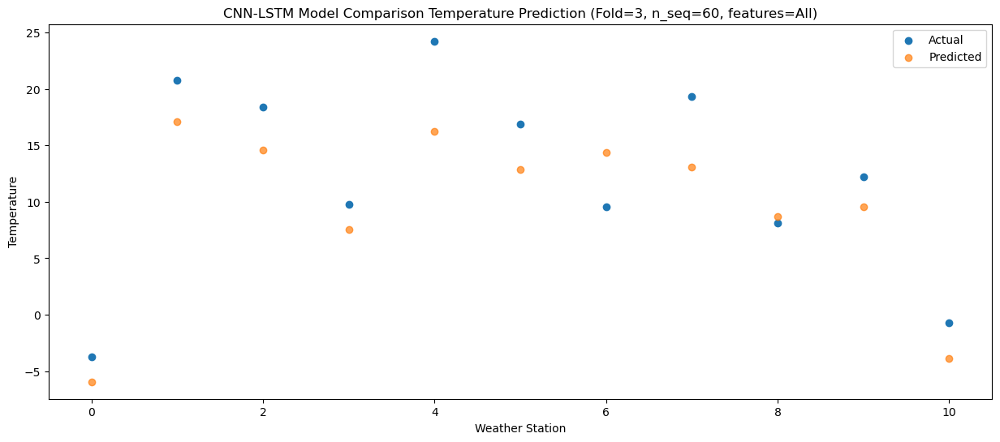

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -3.268205
1                 1   22.62  19.012606
2                 2   21.17  16.830198
3                 3   13.54  10.356088
4                 4   25.68  18.587675
5                 5   18.75  15.509900
6                 6   11.51  16.514275
7                 7   23.57  15.289676
8                 8    7.29  10.979480
9                 9   16.14  12.824239
10               10    3.08  -0.613483


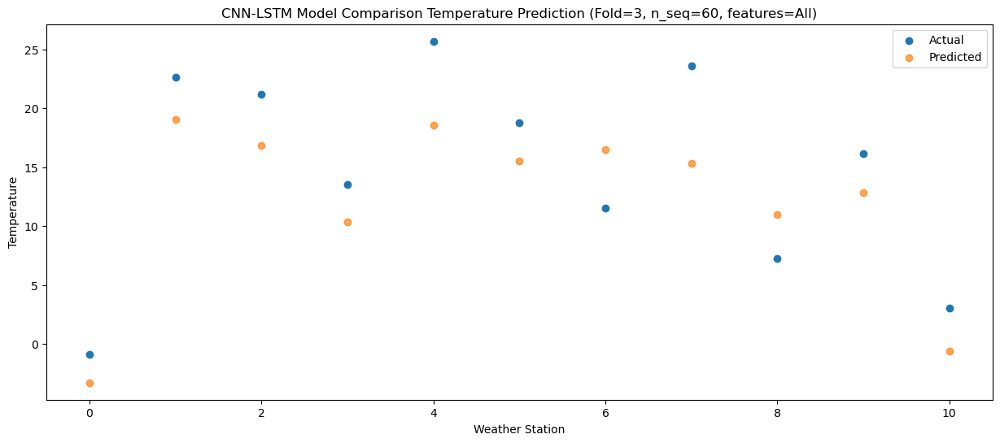

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12  -4.460262
1                 1   20.76  17.777940
2                 2   21.70  17.547919
3                 3   11.12   8.511065
4                 4   23.12  16.814435
5                 5   16.24  13.562223
6                 6   12.26  16.457567
7                 7   23.68  15.819295
8                 8    9.17  11.831280
9                 9   14.96  11.066779
10               10    1.21  -2.496790


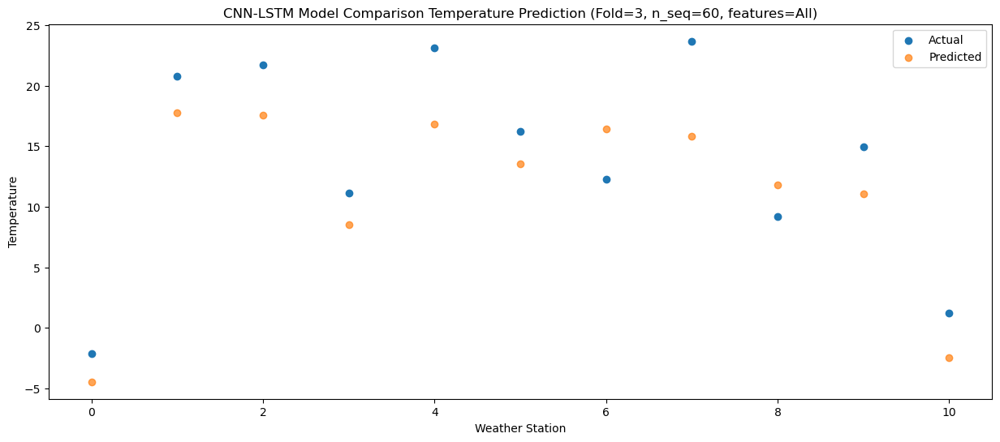

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -7.746035
1                 1   17.09  12.918998
2                 2   17.37  12.990777
3                 3    7.06   4.620909
4                 4   19.05  12.011533
5                 5   12.61   9.215933
6                 6    6.76  11.636439
7                 7   18.87  10.971826
8                 8    8.59   7.599703
9                 9   10.62   7.096467
10               10   -3.76  -6.494897


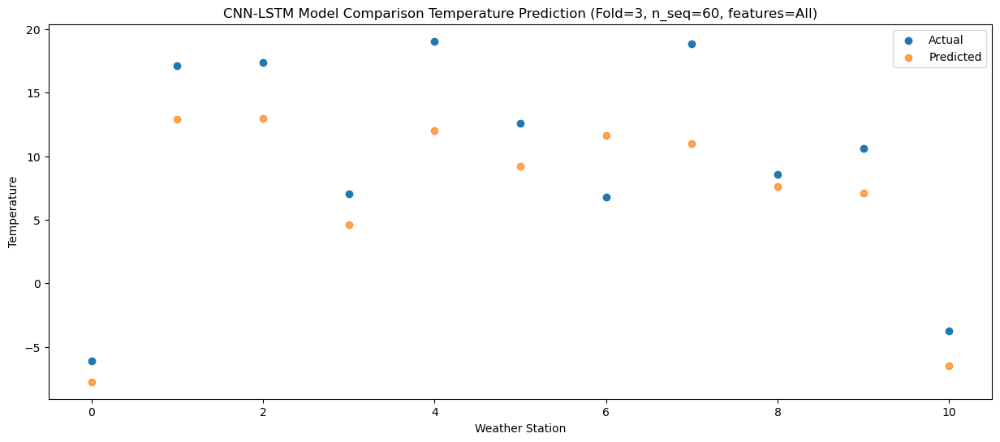

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66 -11.719662
1                 1    9.98   6.621715
2                 2   11.88   8.061551
3                 3    1.64  -0.612129
4                 4   11.32   5.553636
5                 5    6.61   3.288661
6                 6    3.02   5.988491
7                 7   11.93   5.531844
8                 8    6.37   3.208962
9                 9    5.30   1.762607
10               10   -9.25 -11.929553


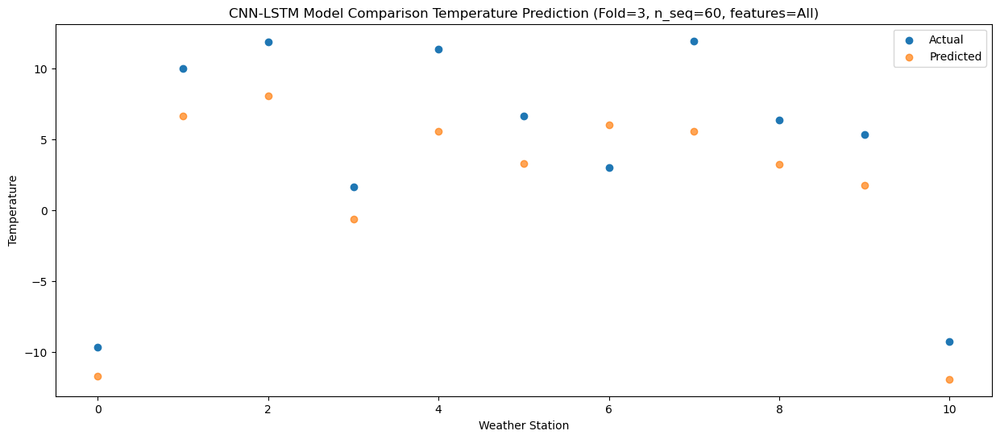

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -15.534314
1                 1    7.16   3.774241
2                 2    3.23   3.595846
3                 3   -2.28  -3.997860
4                 4    8.50   2.679914
5                 5    2.67   0.194338
6                 6   -4.17   2.163880
7                 7    3.12   1.312869
8                 8   -0.79  -1.413930
9                 9    1.23  -1.983662
10               10  -13.53 -15.570687


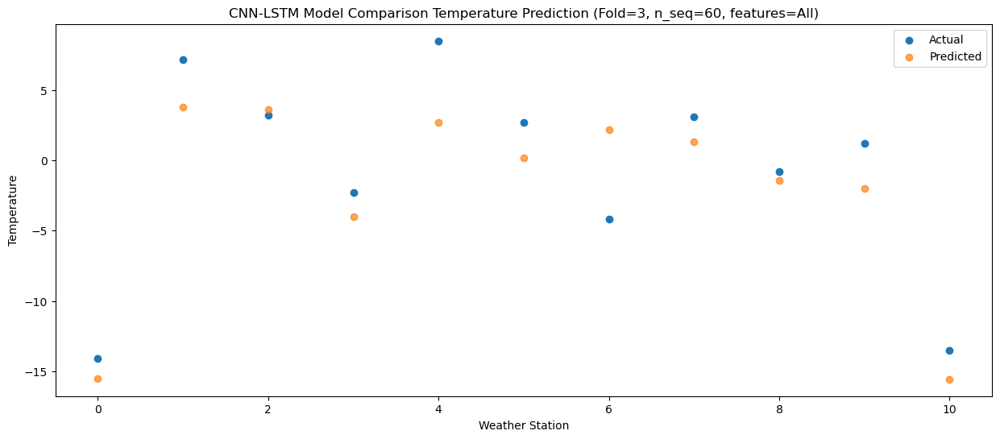

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -22.221779
1                 1    0.61  -2.926282
2                 2    0.03  -1.163673
3                 3   -9.48 -10.911233
4                 4    1.33  -4.234606
5                 5   -4.94  -6.792716
6                 6   -9.87  -3.295701
7                 7   -2.57  -3.574510
8                 8   -2.84  -6.167100
9                 9   -5.11  -8.449088
10               10  -20.35 -22.164241


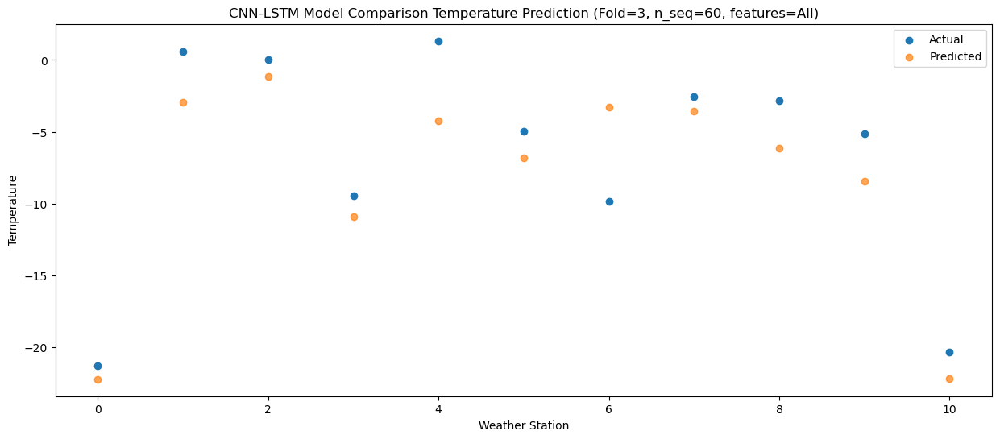

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -23.068839
1                 1   -0.54  -3.959299
2                 2    1.29  -1.005757
3                 3  -10.94 -12.435127
4                 4   -0.14  -5.710562
5                 5   -6.39  -8.410830
6                 6   -9.60  -3.641549
7                 7   -2.02  -3.571099
8                 8   -1.62  -5.854195
9                 9   -8.13 -10.196814
10               10  -21.91 -23.979017


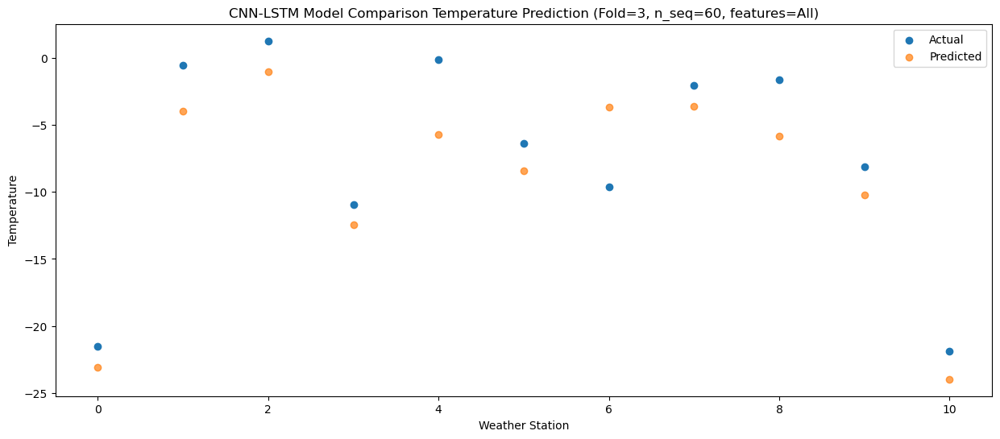

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -22.656508
1                 1   -4.26  -7.192039
2                 2    3.59  -0.635736
3                 3  -12.26 -13.723016
4                 4   -4.01  -8.941978
5                 5   -9.11 -10.779494
6                 6   -9.50  -4.840786
7                 7    0.83  -4.025160
8                 8   -0.69  -4.826596
9                 9   -8.25 -10.922202
10               10  -22.71 -24.963742


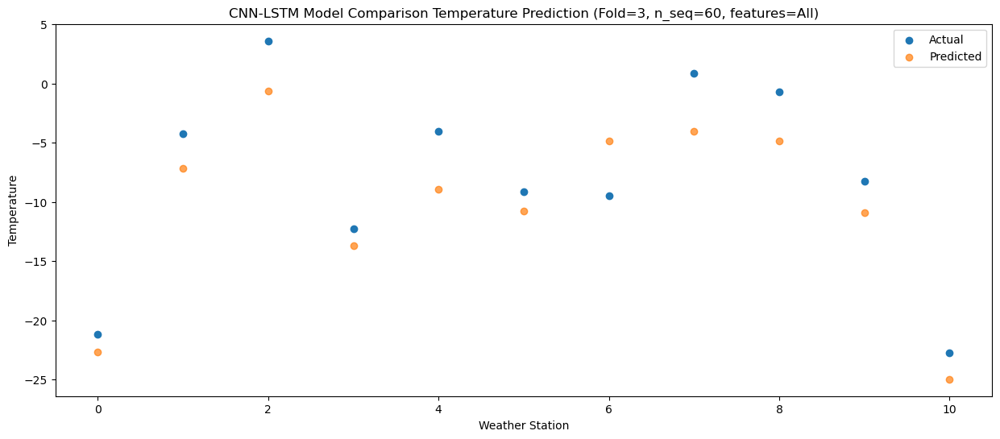

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -16.993018
1                 1    7.71   3.646145
2                 2    4.74   2.853484
3                 3   -2.05  -5.432008
4                 4    9.07   1.933506
5                 5    2.22  -0.968584
6                 6   -6.53   1.691338
7                 7    2.43   0.782768
8                 8   -0.91  -2.231095
9                 9   -3.25  -4.085426
10               10  -15.52 -17.604308


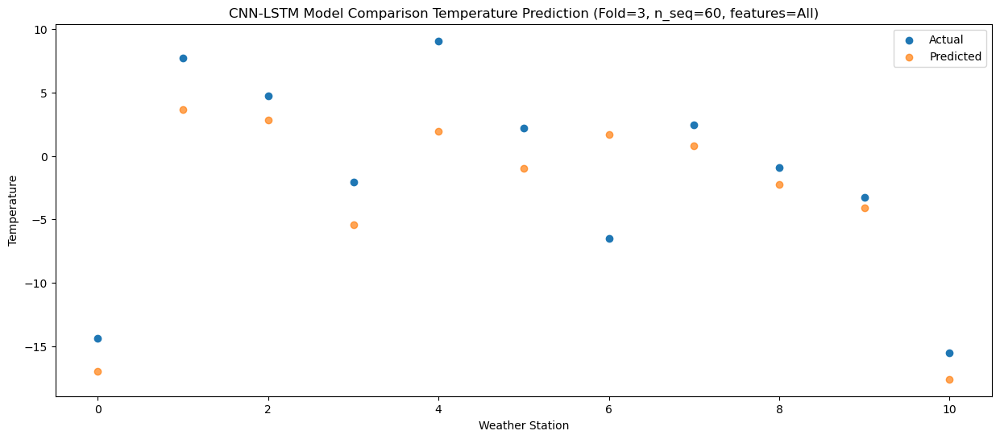

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21 -15.219395
1                 1    9.57   5.139434
2                 2   10.47   5.067205
3                 3    0.30  -3.237392
4                 4   12.36   3.949902
5                 5    5.67   1.192631
6                 6   -1.75   3.740120
7                 7   10.40   2.999293
8                 8    1.28  -0.203467
9                 9    1.37  -1.186041
10               10  -10.65 -14.756055


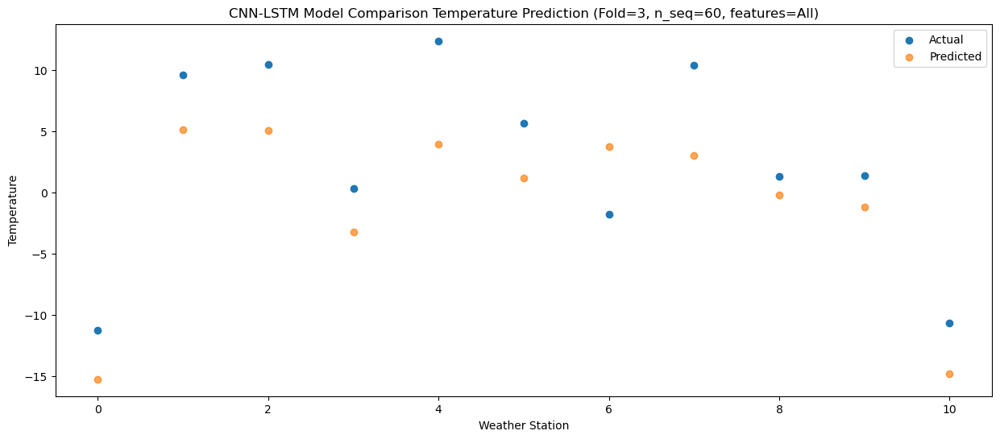

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55 -11.894038
1                 1   13.79   9.038836
2                 2   15.27   8.559164
3                 3    4.37   0.494559
4                 4   16.93   7.969014
5                 5    9.95   5.100485
6                 6    3.30   7.454163
7                 7   14.83   6.635532
8                 8    5.57   3.115036
9                 9    6.20   2.619928
10               10   -6.39 -10.918662


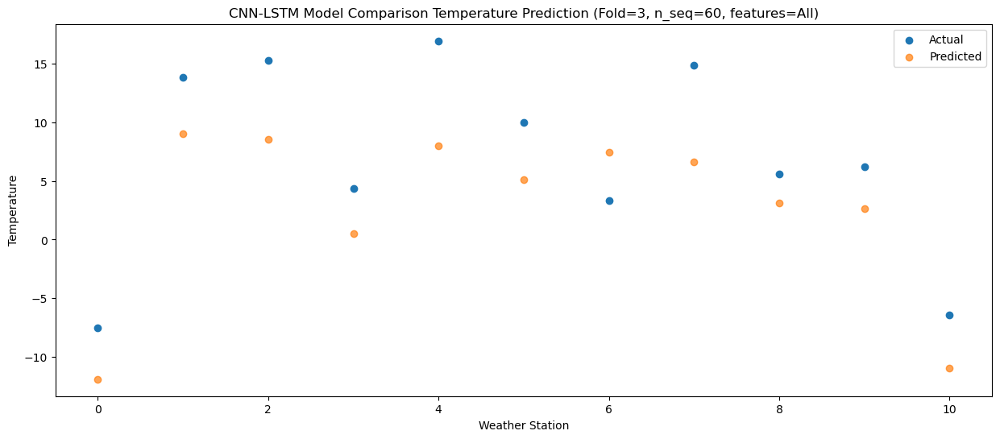

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49  -8.211842
1                 1   20.50  14.524511
2                 2   20.12  13.233759
3                 3   10.29   5.344879
4                 4   24.41  13.764646
5                 5   16.66  10.498643
6                 6   10.69  12.662426
7                 7   22.47  11.744272
8                 8    7.27   7.263336
9                 9   12.07   7.799056
10               10   -0.22  -5.667433


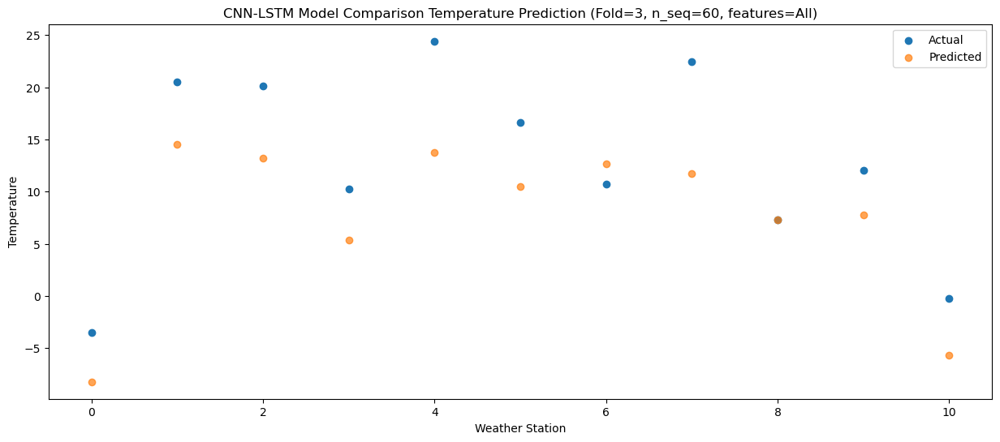

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -6.862110
1                 1   21.81  16.071019
2                 2   23.25  15.102136
3                 3   11.28   6.611124
4                 4   24.41  15.149013
5                 5   17.04  11.791483
6                 6   12.53  14.401335
7                 7   23.55  13.597834
8                 8    6.45   9.134253
9                 9   14.21   9.062463
10               10    1.42  -4.425639


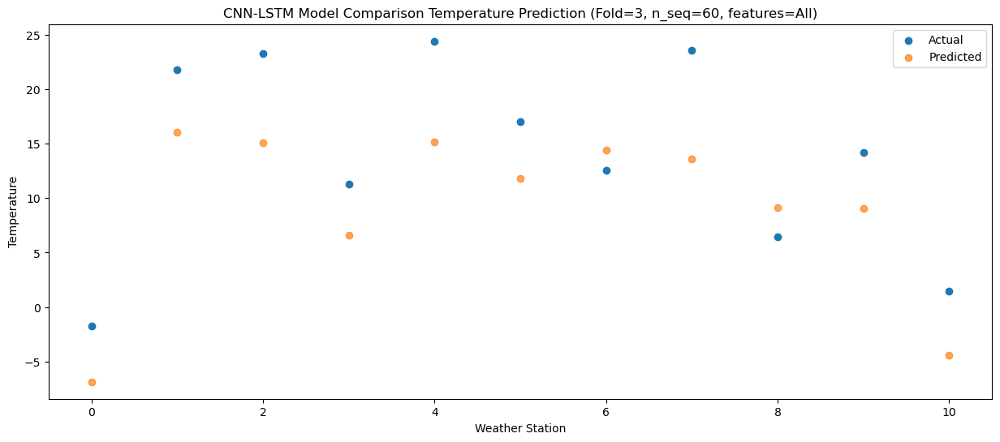

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -6.584976
1                 1   22.38  16.234398
2                 2   21.05  13.892670
3                 3   11.80   7.079406
4                 4   24.53  15.482477
5                 5   17.36  12.259975
6                 6   10.61  13.691400
7                 7   22.32  12.463631
8                 8    7.00   7.944920
9                 9   14.83   9.318091
10               10    1.15  -4.087795


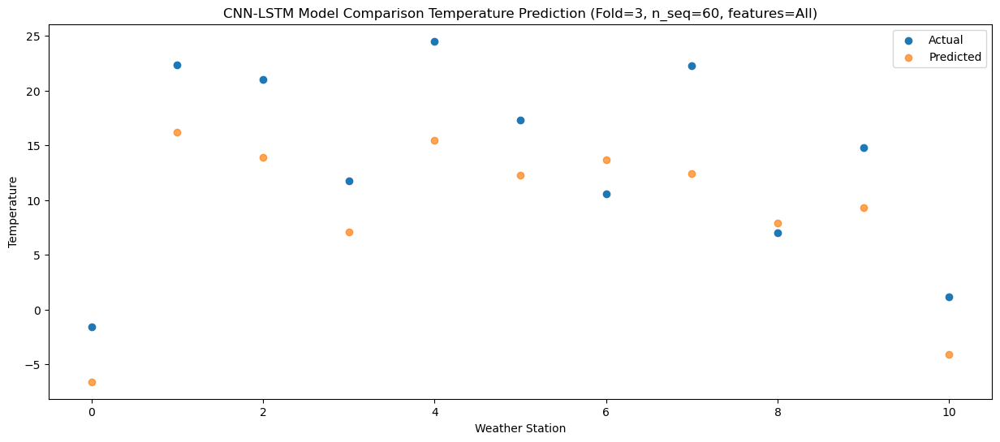

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -9.520717
1                 1   19.65  13.397327
2                 2   17.74  11.476268
3                 3    7.67   3.781880
4                 4   21.17  12.245302
5                 5   14.10   8.936887
6                 6    8.74  11.049138
7                 7   18.35   9.968632
8                 8    6.45   5.671752
9                 9   11.51   5.806856
10               10   -3.11  -7.625379


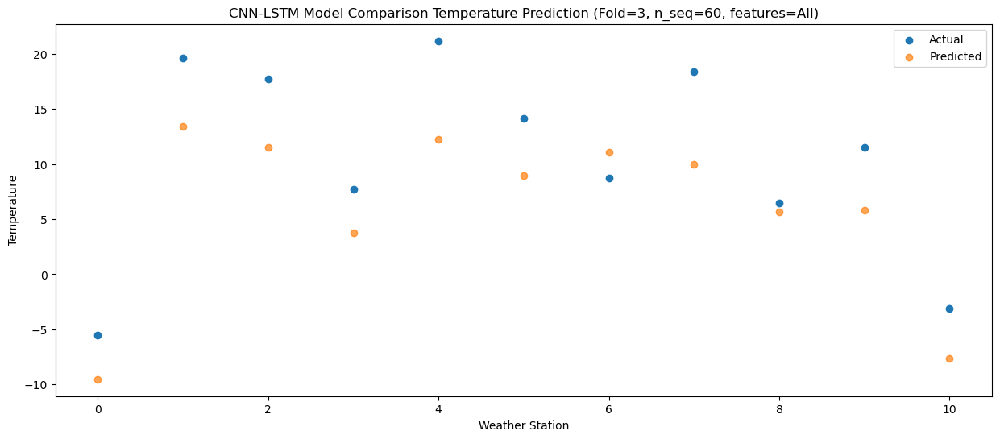

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78 -13.055792
1                 1   13.05   7.871081
2                 2    9.08   5.699582
3                 3    4.09  -0.286148
4                 4   15.75   7.015910
5                 5    9.52   4.343799
6                 6    0.77   5.176789
7                 7    8.00   3.859902
8                 8    3.69   0.283567
9                 9    7.07   1.694610
10               10   -7.23 -11.744765


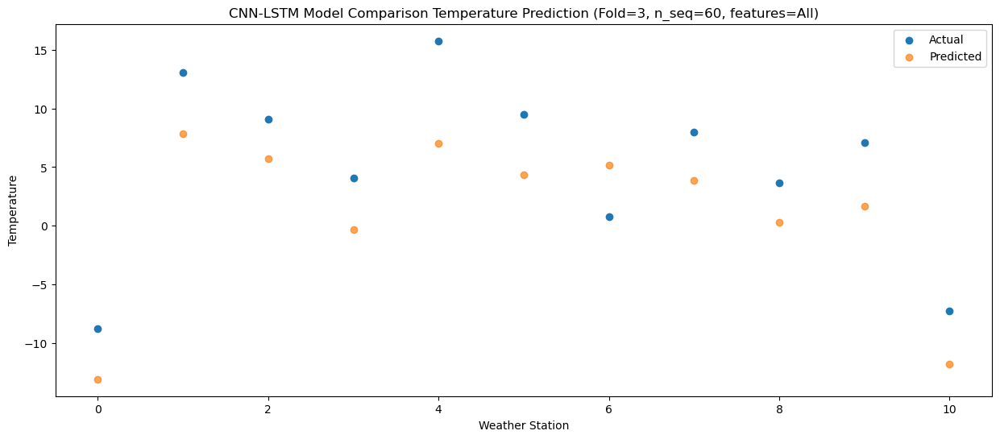

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -21.012942
1                 1    5.34  -0.019040
2                 2    4.74   1.610223
3                 3   -5.57  -9.298643
4                 4    6.01  -1.713700
5                 5   -1.33  -4.776626
6                 6   -1.97  -0.333541
7                 7    5.48  -0.515852
8                 8    0.87  -3.660522
9                 9   -1.85  -7.031000
10               10  -17.45 -20.702240


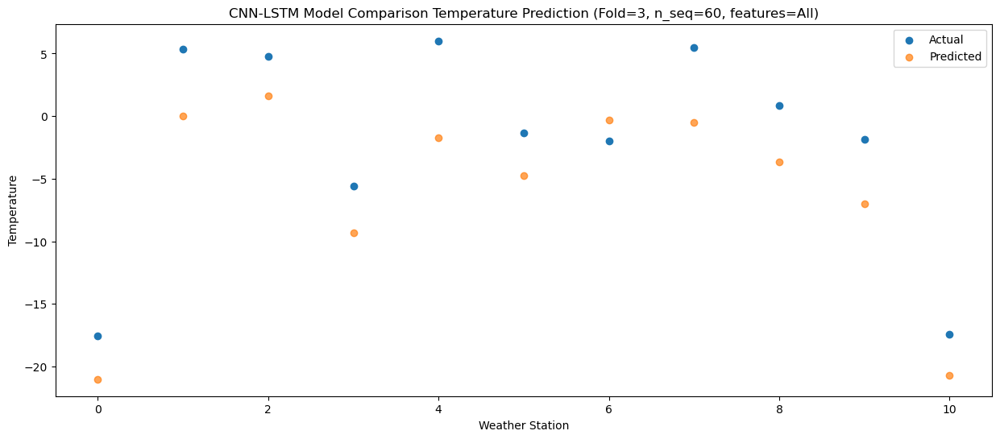

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -19.046619
1                 1    6.65   1.379750
2                 2    0.82  -0.463041
3                 3   -4.08  -7.778940
4                 4    5.65  -0.894767
5                 5   -0.28  -3.535675
6                 6   -6.73  -1.398238
7                 7   -1.79  -2.619453
8                 8   -2.83  -5.241847
9                 9   -3.45  -6.918229
10               10  -17.86 -20.368578


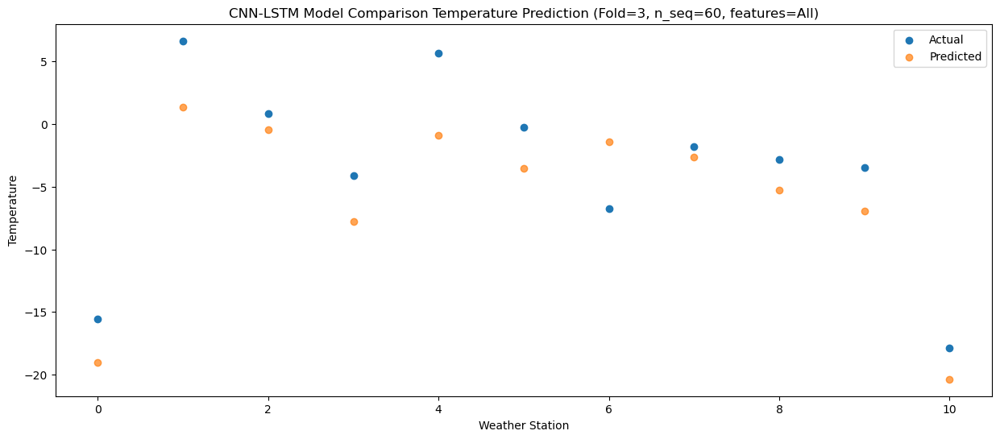

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -26.201073
1                 1   -2.18  -6.709769
2                 2    0.49  -3.669699
3                 3  -13.03 -16.030057
4                 4   -3.82  -9.344763
5                 5   -9.10 -12.112871
6                 6   -9.02  -6.407313
7                 7   -1.86  -6.273790
8                 8   -2.21  -8.313038
9                 9  -10.00 -14.289205
10               10  -24.84 -28.060214


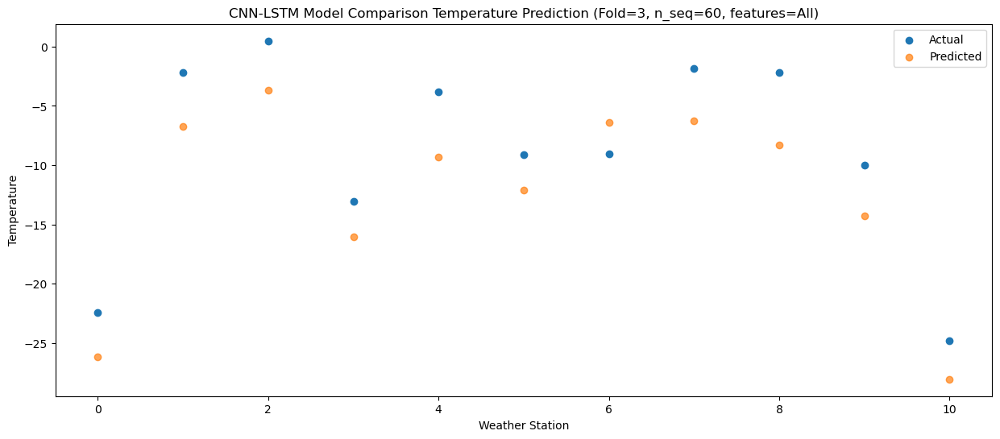

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -23.404911
1                 1   -0.96  -5.673250
2                 2    2.19  -3.267744
3                 3   -8.51 -13.218314
4                 4   -1.30  -7.567875
5                 5   -5.91  -9.721711
6                 6  -10.74  -5.803806
7                 7    0.18  -6.020487
8                 8   -1.25  -7.814313
9                 9   -7.24 -11.220852
10               10  -21.03 -24.972804


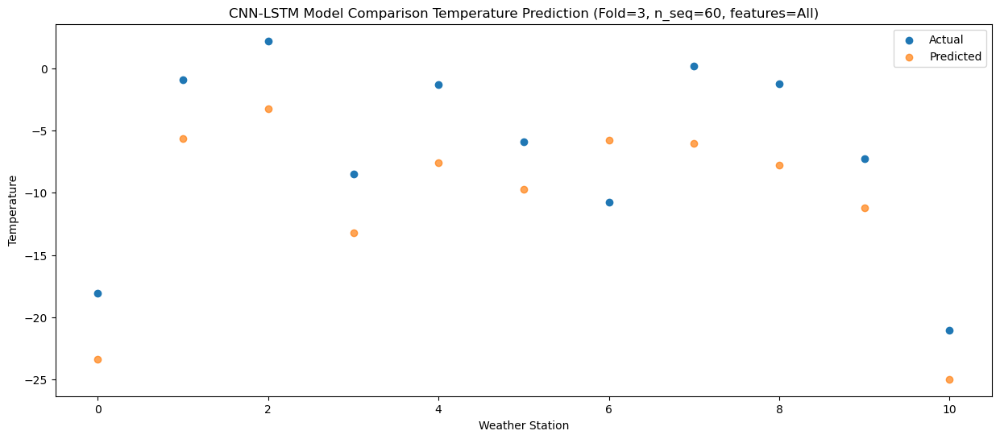

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -19.212935
1                 1    5.82   0.655986
2                 2    6.90   0.932921
3                 3   -2.76  -8.028931
4                 4    7.16  -1.250920
5                 5    1.05  -3.895910
6                 6   -6.20  -0.665570
7                 7    4.89  -1.326546
8                 8    0.98  -3.998376
9                 9   -3.28  -6.381482
10               10  -15.85 -19.981566


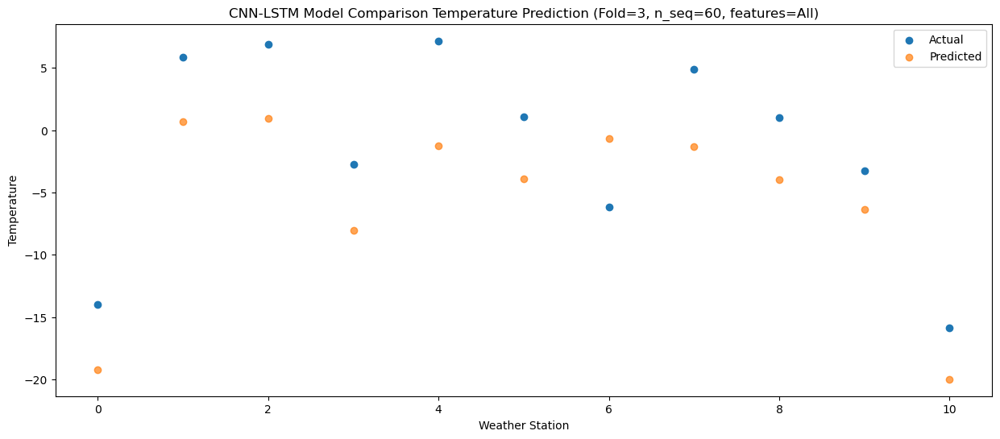

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88 -16.375142
1                 1   10.67   5.307737
2                 2    9.97   3.847495
3                 3    0.25  -4.639186
4                 4   11.29   3.056597
5                 5    4.90  -0.036794
6                 6   -1.88   2.973384
7                 7    9.52   1.957668
8                 8    2.42  -1.298810
9                 9    1.01  -3.491168
10               10  -12.03 -16.966091


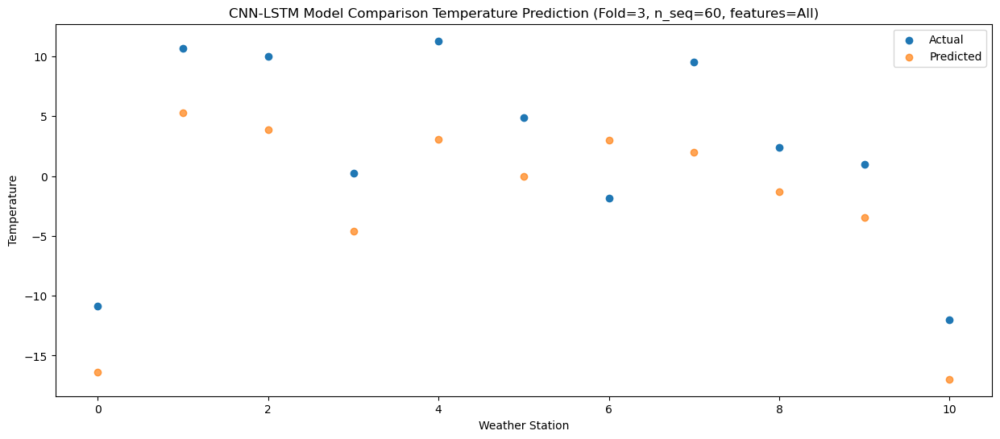

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04 -12.095903
1                 1   16.10  10.146266
2                 2   14.21   6.362283
3                 3    7.03   0.843514
4                 4   18.86   8.762043
5                 5   12.70   5.742447
6                 6    4.03   6.534935
7                 7   14.19   4.840236
8                 8    5.41   0.851265
9                 9    6.80   2.130695
10               10   -5.25 -11.188467


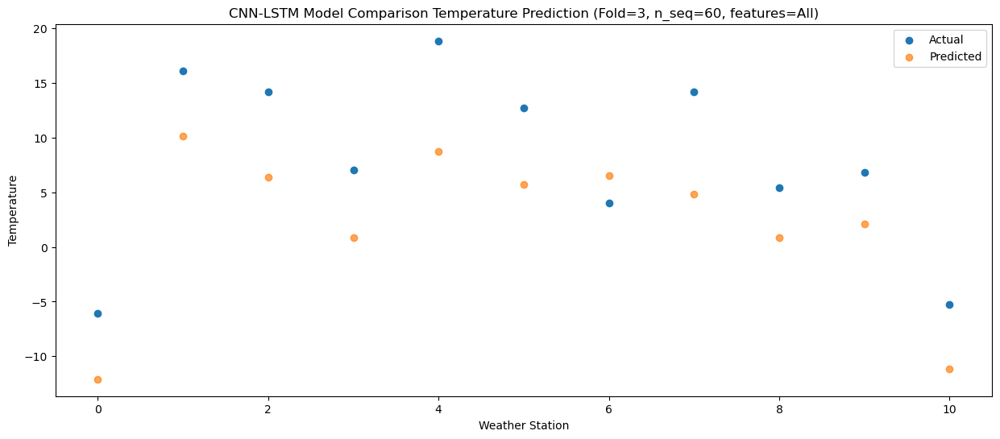

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08  -8.674166
1                 1   21.25  14.920091
2                 2   19.60  10.768874
3                 3   10.51   4.717310
4                 4   24.31  13.458376
5                 5   16.64  10.027943
6                 6    9.80  11.193010
7                 7   20.67   9.494698
8                 8    8.56   5.008182
9                 9   11.12   5.891126
10               10   -1.26  -7.385399


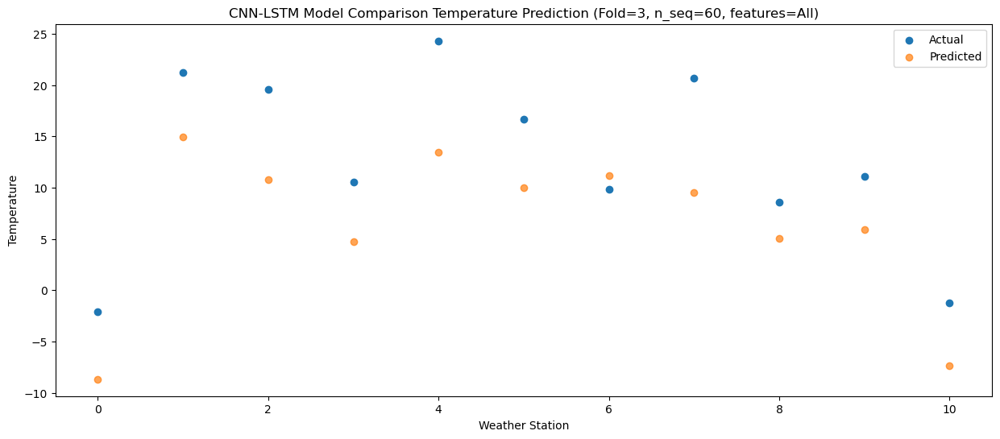

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -7.063220
1                 1   25.29  17.307203
2                 2   22.17  14.353782
3                 3   12.06   6.596919
4                 4   25.43  15.771731
5                 5   18.63  12.092872
6                 6   11.72  14.432428
7                 7   22.90  13.151542
8                 8    6.91   8.375675
9                 9   15.67   8.290070
10               10    2.52  -5.061434


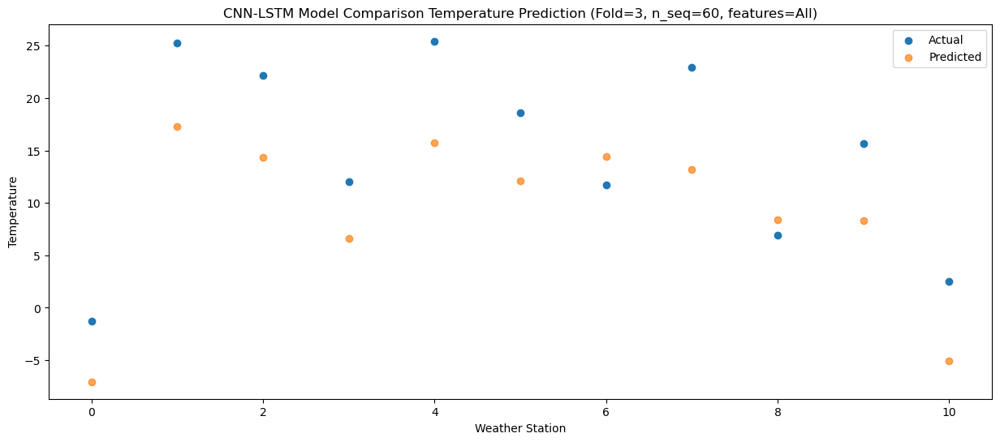

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22  -8.901021
1                 1   22.21  14.329113
2                 2   22.35  12.850952
3                 3   10.99   4.454458
4                 4   23.61  13.102929
5                 5   16.98   9.678561
6                 6   10.96  12.368308
7                 7   21.31  11.411278
8                 8    8.33   6.959186
9                 9   15.59   6.719330
10               10    1.65  -6.753141


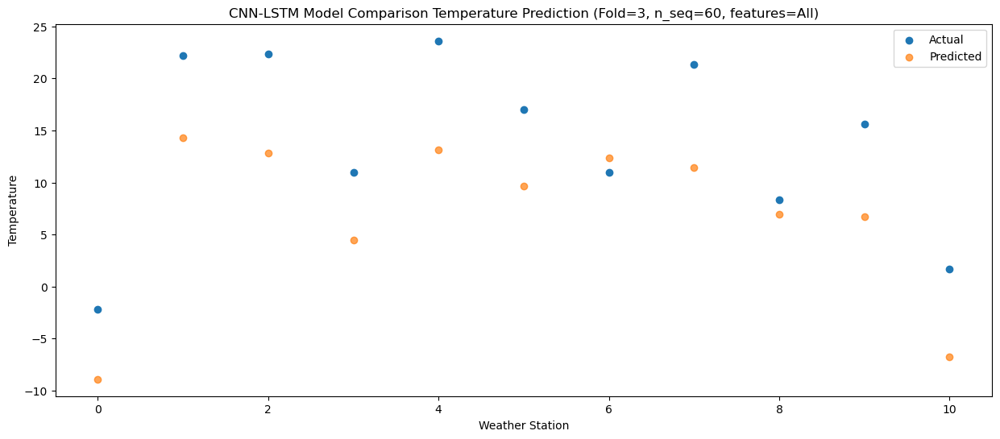

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43 -11.547147
1                 1   18.35  11.379033
2                 2   19.53  10.040893
3                 3    7.01   1.279604
4                 4   19.29   9.797391
5                 5   13.03   6.384655
6                 6    8.80   9.421606
7                 7   18.95   8.483260
8                 8    8.56   4.356537
9                 9   10.68   3.145657
10               10   -3.58 -10.327932


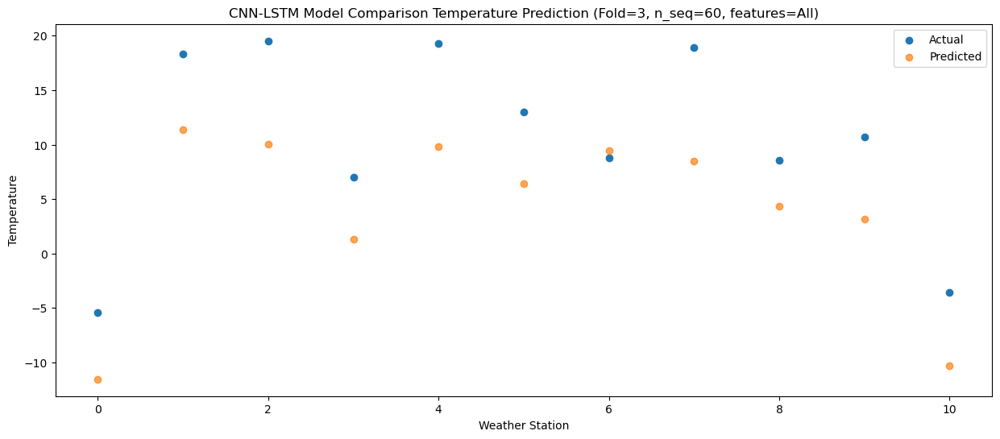

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44 -17.530105
1                 1   11.80   4.357955
2                 2   12.35   3.839894
3                 3   -0.26  -5.189763
4                 4   12.02   2.759776
5                 5    6.99  -0.391401
6                 6    0.54   2.821728
7                 7   11.06   2.043936
8                 8    3.83  -1.631367
9                 9    4.42  -3.178789
10               10  -11.19 -16.718872


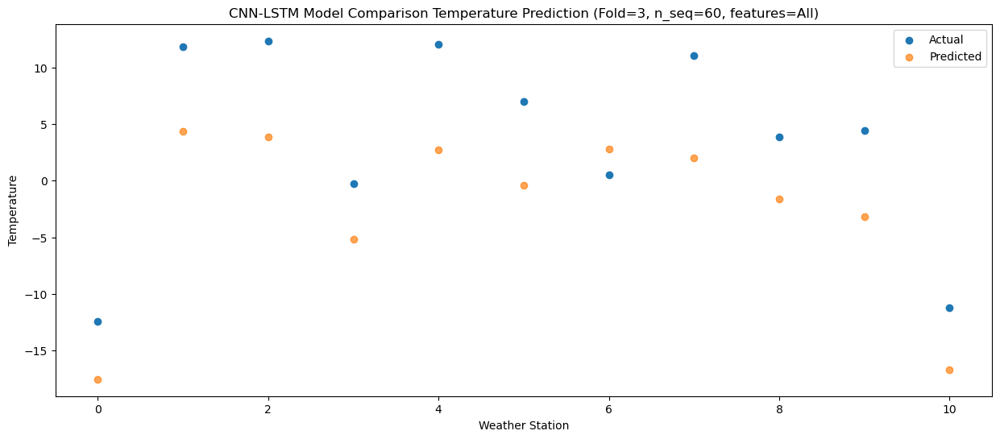

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -20.823967
1                 1    4.57  -2.334125
2                 2    1.62  -3.571340
3                 3   -3.38  -9.204253
4                 4    6.13  -3.213683
5                 5    0.44  -5.267596
6                 6   -7.14  -4.590109
7                 7   -0.36  -5.867615
8                 8   -1.90  -8.500124
9                 9    0.46  -7.193292
10               10  -14.31 -20.728541


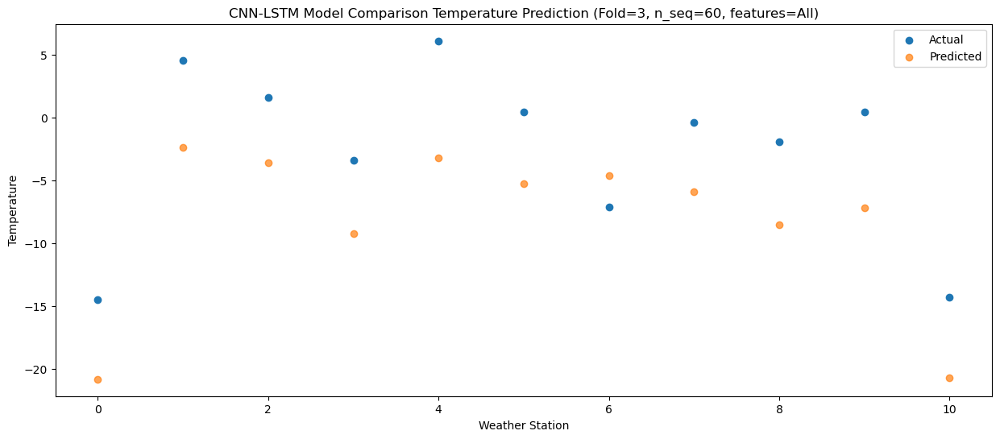

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -25.894454
1                 1    0.52  -6.769270
2                 2    0.66  -6.629481
3                 3   -8.65 -14.991066
4                 4    0.16  -8.735965
5                 5   -5.10 -11.078534
6                 6   -9.31  -8.217538
7                 7   -2.69  -9.023959
8                 8   -3.10 -11.348581
9                 9   -5.90 -13.305332
10               10  -21.34 -26.912766


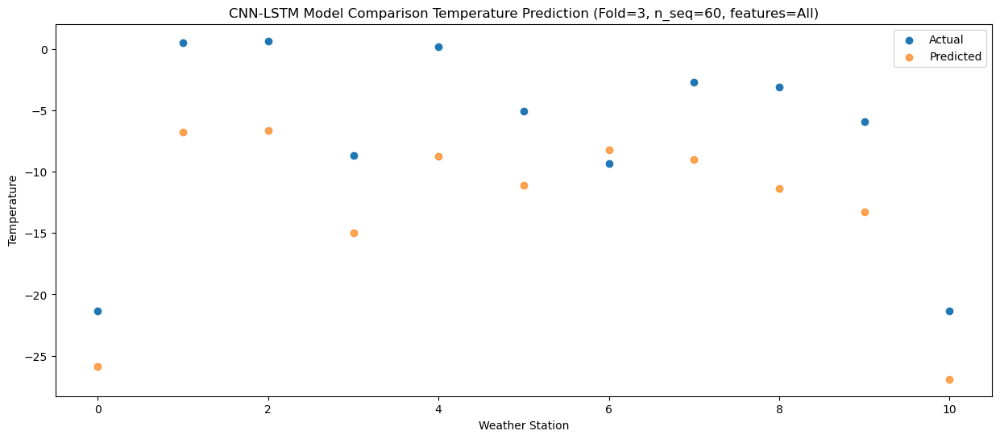

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -24.704911
1                 1    1.22  -5.872394
2                 2    2.05  -6.381733
3                 3   -6.90 -13.652727
4                 4    1.88  -7.626093
5                 5   -2.96  -9.809464
6                 6  -10.04  -7.723686
7                 7   -3.20  -8.751869
8                 8   -1.43 -11.113976
9                 9   -3.92 -11.947428
10               10  -18.69 -25.512117


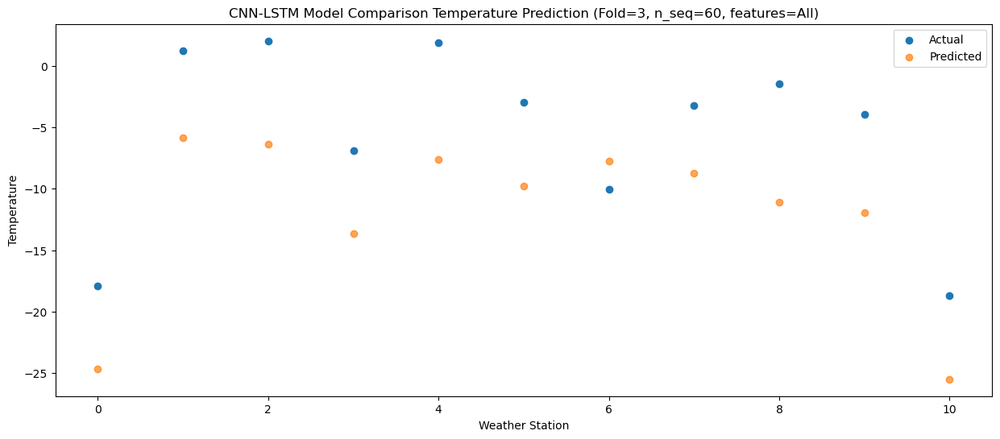

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -23.017526
1                 1    3.18  -4.449829
2                 2    1.20  -5.838233
3                 3   -4.56 -12.357689
4                 4    8.40  -6.403515
5                 5   -1.24  -8.588203
6                 6  -10.01  -6.962503
7                 7   -2.29  -8.249479
8                 8   -3.23 -10.415309
9                 9   -5.65 -11.264722
10               10  -18.48 -24.765180


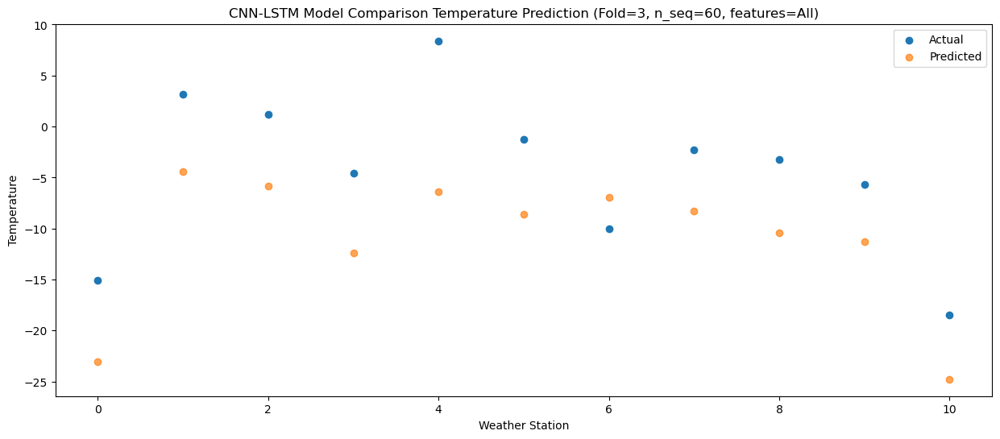

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -21.950889
1                 1    5.78  -1.741530
2                 2    4.07  -2.912334
3                 3   -4.32 -11.167957
4                 4    5.44  -4.267621
5                 5   -0.34  -7.007121
6                 6   -8.22  -4.051335
7                 7    0.54  -5.129843
8                 8   -1.77  -7.637931
9                 9   -3.68 -10.230190
10               10  -16.92 -23.733387


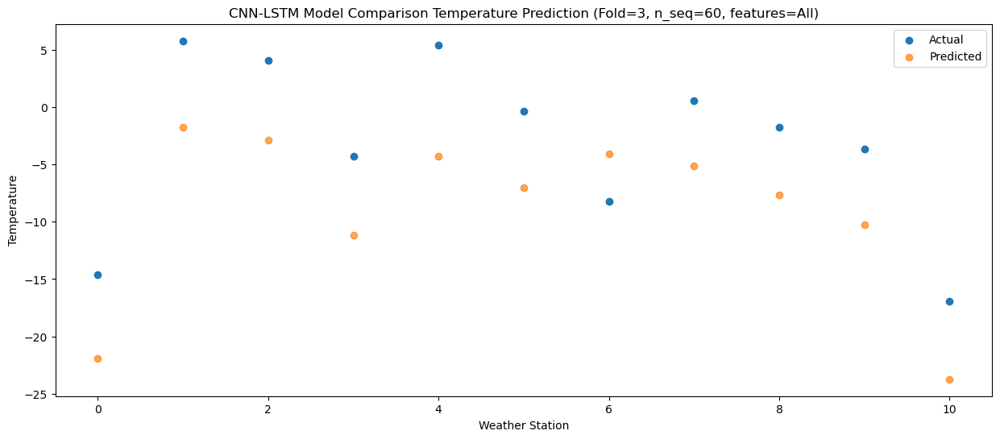

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97 -18.694932
1                 1   10.83   2.218162
2                 2    9.70   0.162437
3                 3    1.92  -6.586315
4                 4   12.65   0.759134
5                 5    5.89  -2.053121
6                 6   -2.88  -0.400940
7                 7    8.49  -1.718740
8                 8    2.31  -5.111256
9                 9    2.37  -4.925979
10               10   -9.35 -18.379031


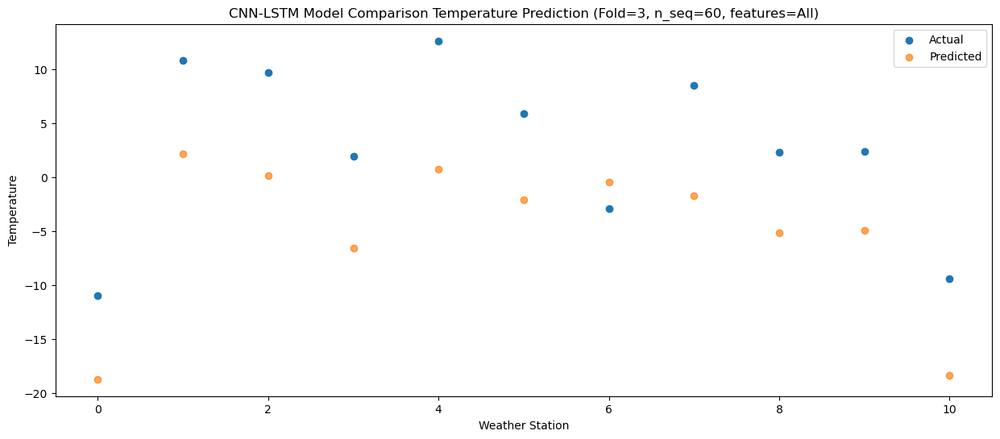

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61 -16.437351
1                 1   16.14   6.896608
2                 2   14.14   4.381299
3                 3    4.61  -3.527130
4                 4   18.65   5.175194
5                 5   11.30   1.661325
6                 6    4.33   4.196576
7                 7   14.29   2.940388
8                 8    3.34  -1.335362
9                 9    6.01  -1.984395
10               10   -6.88 -15.374473


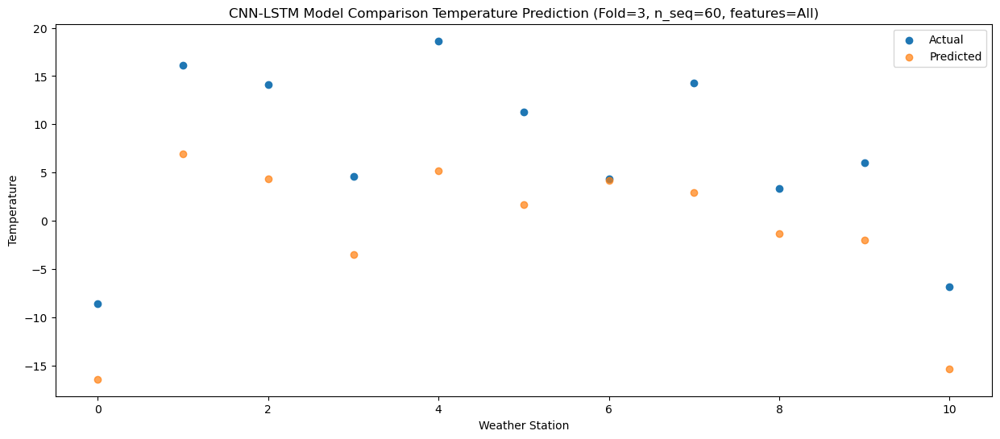

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84 -13.351503
1                 1   20.47  10.659971
2                 2   16.94   6.698847
3                 3    8.35   0.022742
4                 4   22.75   9.036397
5                 5   14.76   5.423660
6                 6    8.91   7.095171
7                 7   16.79   5.472894
8                 8    5.24   0.850902
9                 9   10.00   1.372781
10               10   -2.95 -11.928005


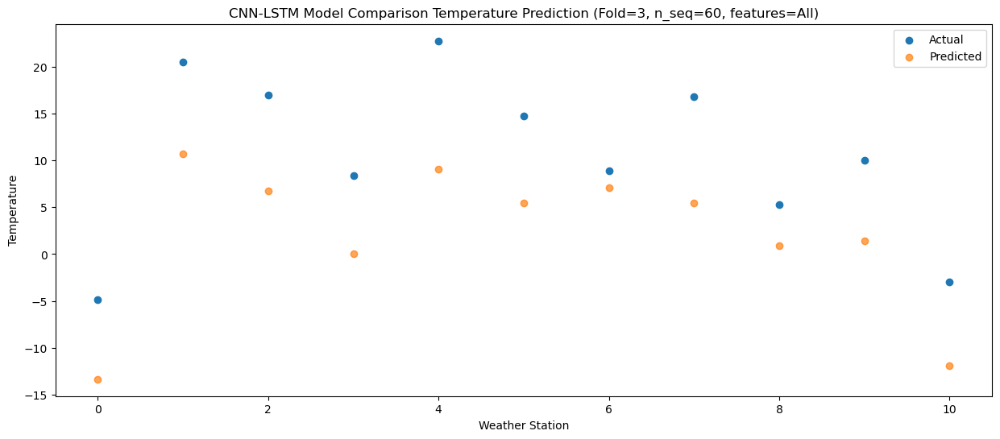

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06 -10.745846
1                 1   22.73  12.592004
2                 2   22.60  10.279967
3                 3   11.97   2.492903
4                 4   24.45  11.081328
5                 5   18.02   7.663410
6                 6   15.05  10.090816
7                 7   25.15   8.890504
8                 8    8.25   4.447349
9                 9   15.68   4.423050
10               10    1.89  -8.991784


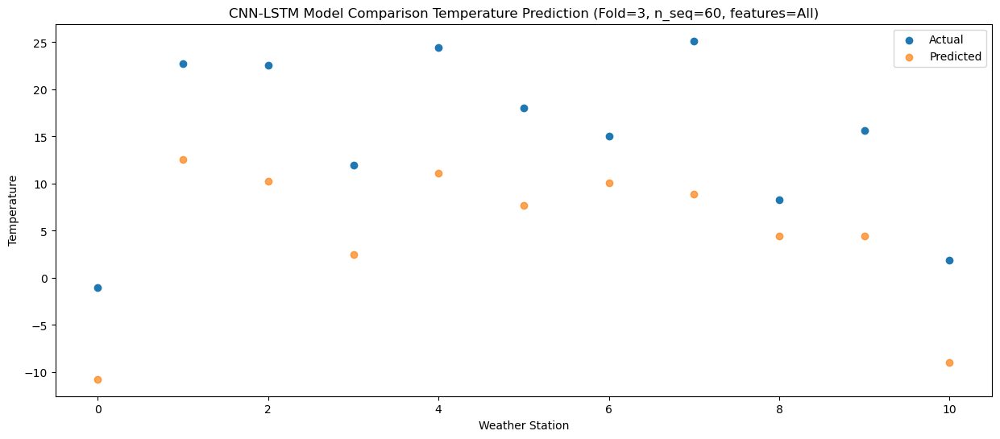

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57 -11.021943
1                 1   22.91  13.390371
2                 2   20.91  10.880859
3                 3   10.86   1.904776
4                 4   23.16  11.111751
5                 5   16.47   7.284895
6                 6   12.46  10.697809
7                 7   20.52   9.562503
8                 8    9.28   5.110773
9                 9   13.43   3.269021
10               10   -0.08 -10.122065


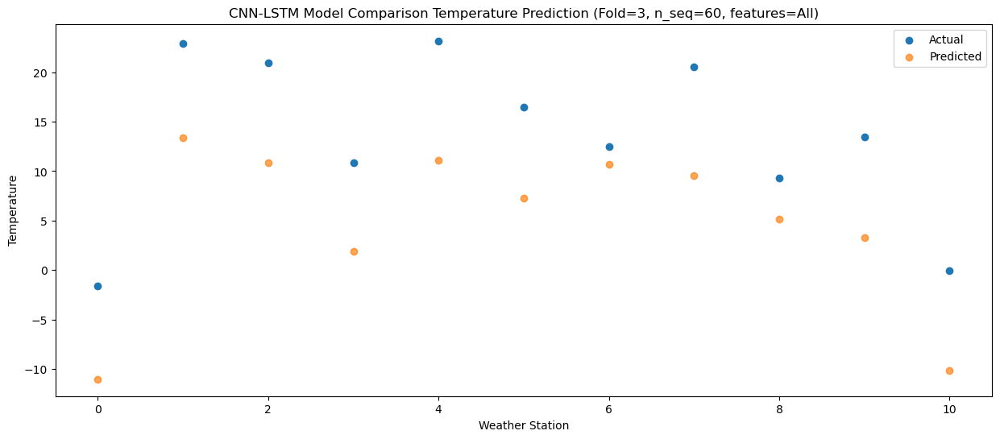

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71 -14.836118
1                 1   18.86   8.989512
2                 2   17.14   6.135699
3                 3    8.13  -1.830261
4                 4   19.80   7.072045
5                 5   13.01   3.447196
6                 6    8.31   6.082355
7                 7   15.82   4.779475
8                 8    6.67   0.375445
9                 9   10.86  -0.358352
10               10   -3.37 -13.736383


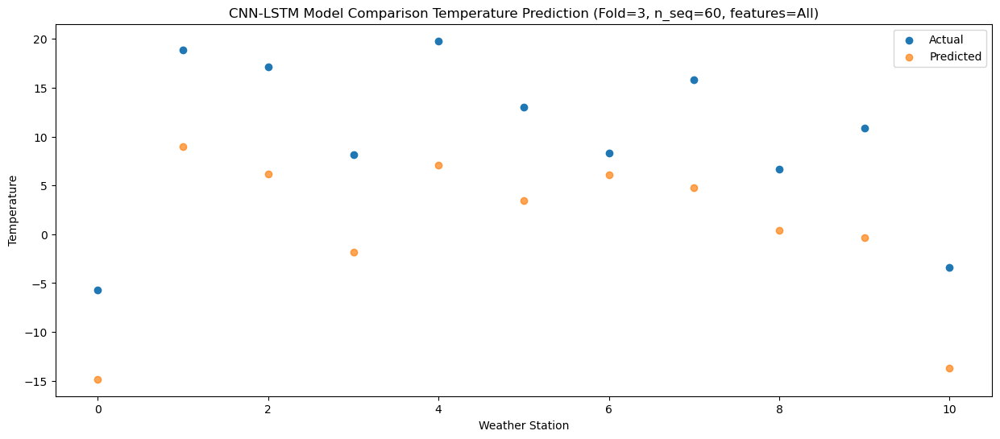

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74 -19.812977
1                 1   11.92   1.765570
2                 2   11.83  -0.047280
3                 3    2.69  -7.346656
4                 4   13.34   0.301614
5                 5    7.36  -2.659226
6                 6    2.18  -0.613999
7                 7   10.53  -1.813652
8                 8    5.21  -5.483487
9                 9    5.43  -5.411519
10               10   -8.66 -18.887224


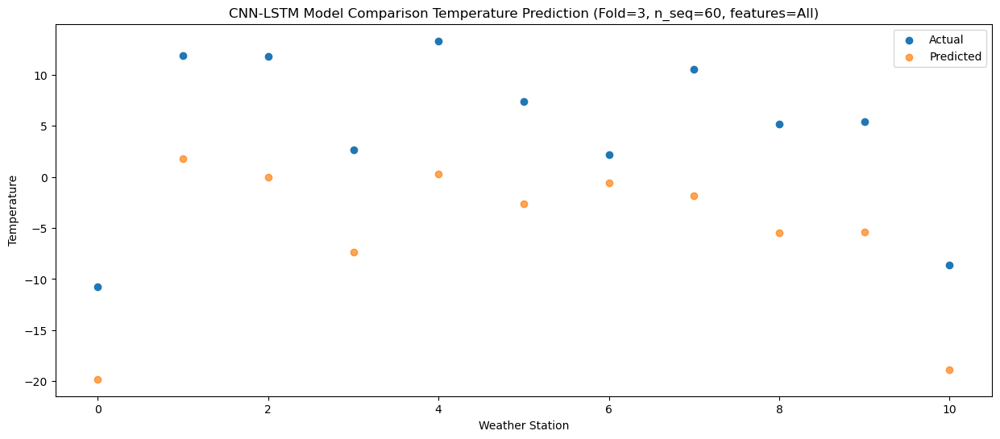

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -25.450811
1                 1    6.14  -4.283725
2                 2    4.92  -5.089466
3                 3   -3.70 -13.731782
4                 4    6.39  -6.170104
5                 5    0.88  -9.210933
6                 6   -3.68  -6.109578
7                 7    2.39  -7.042439
8                 8    1.17 -10.324891
9                 9   -2.42 -12.039734
10               10  -16.93 -25.576700


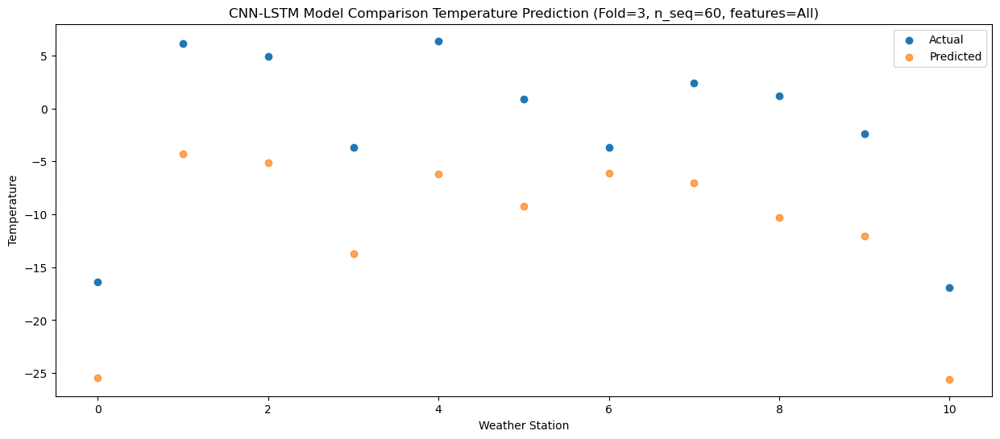

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -27.890331
1                 1    2.79  -7.558557
2                 2    3.08  -8.240330
3                 3   -5.53 -15.963999
4                 4    3.58  -8.936206
5                 5   -1.58 -11.618878
6                 6   -7.31  -9.311959
7                 7   -0.74 -10.297957
8                 8   -0.67 -13.464991
9                 9   -3.15 -13.740110
10               10  -17.68 -27.312289


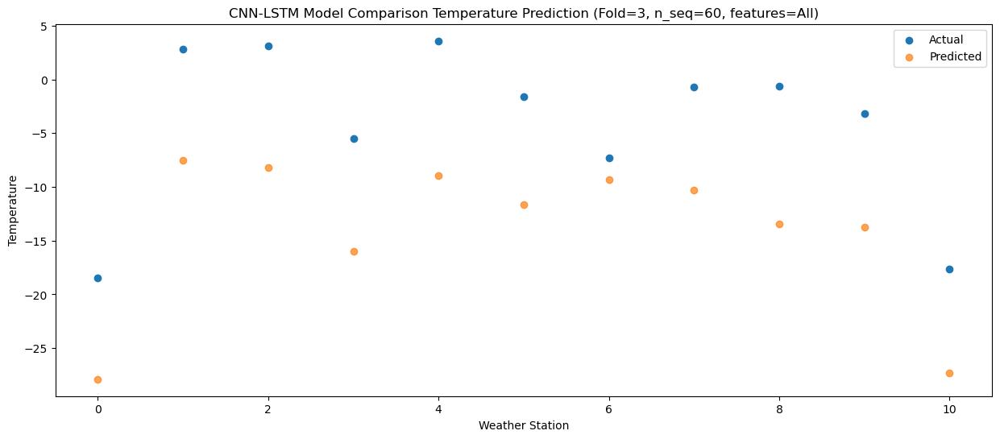

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -30.564742
1                 1   -3.82 -12.968236
2                 2    2.87 -10.246111
3                 3  -10.69 -20.146669
4                 4   -2.92 -14.501342
5                 5   -7.74 -16.641351
6                 6   -9.45 -12.730261
7                 7   -2.46 -12.949387
8                 8   -0.36 -14.970883
9                 9   -7.14 -17.503909
10               10  -20.70 -31.298376


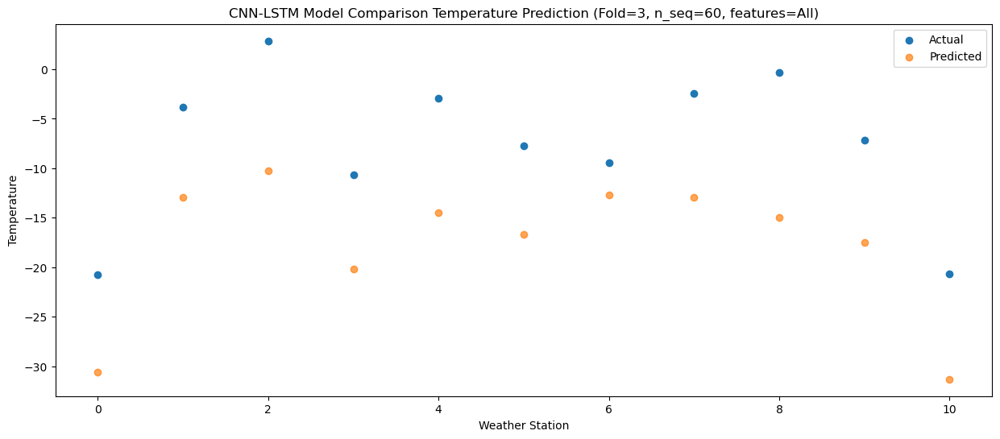

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -26.789222
1                 1    5.83  -4.420608
2                 2    4.36  -6.259894
3                 3   -5.01 -15.045826
4                 4    4.89  -6.950229
5                 5   -1.11 -10.301511
6                 6   -7.29  -6.877603
7                 7   -0.10  -8.006325
8                 8   -0.65 -11.527936
9                 9   -6.57 -14.004979
10               10  -18.66 -27.449537


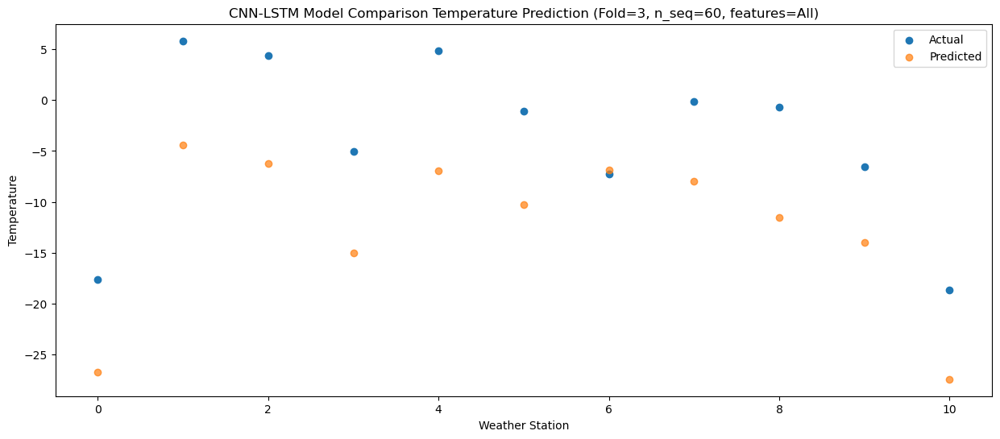

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -23.862278
1                 1    8.31  -2.215660
2                 2    6.39  -4.665401
3                 3   -1.36 -12.157050
4                 4    9.00  -4.511488
5                 5    2.96  -7.586947
6                 6   -5.55  -5.143201
7                 7    3.26  -6.495484
8                 8    0.28  -9.825505
9                 9   -1.87 -11.084764
10               10  -14.00 -24.510818


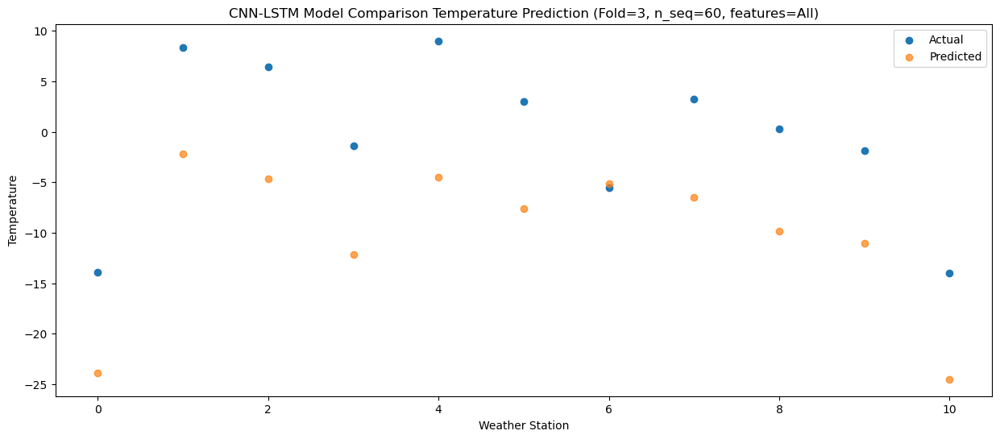

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93 -21.082473
1                 1   12.48   1.665656
2                 2    9.58  -1.884792
3                 3    3.70  -8.634010
4                 4   13.75  -0.400075
5                 5    7.93  -3.729606
6                 6   -0.57  -1.793924
7                 7    8.76  -3.387512
8                 8    2.51  -7.381560
9                 9    1.00  -7.638450
10               10   -9.42 -20.973595


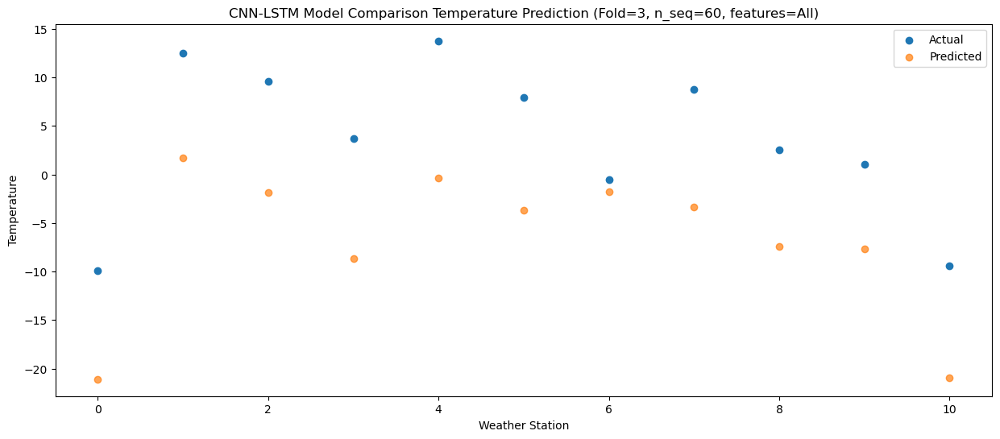

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66 -17.163757
1                 1   17.25   5.499137
2                 2   14.97   0.595283
3                 3    7.89  -4.153589
4                 4   19.91   3.970884
5                 5   13.45   0.808005
6                 6    2.54   1.218511
7                 7   14.39  -0.788211
8                 8    5.48  -5.013423
9                 9    6.55  -3.049121
10               10   -3.75 -16.305984


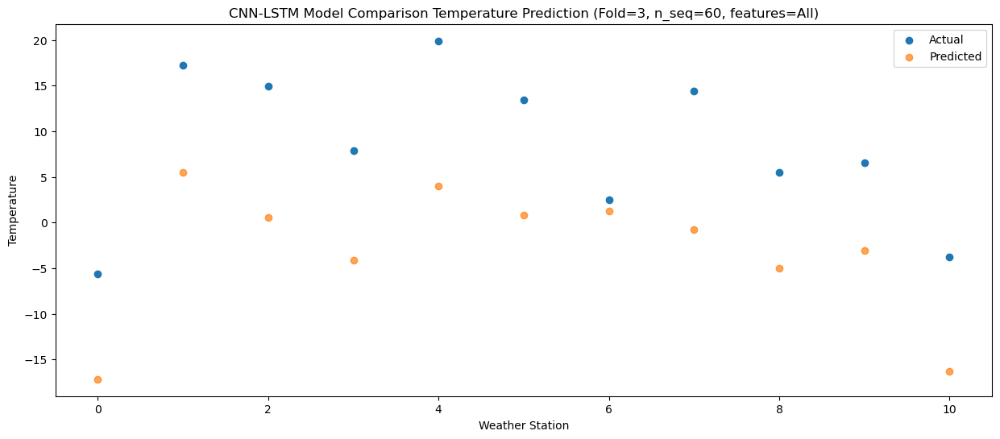

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00 -14.668835
1                 1   21.81   9.367372
2                 2   20.92   4.563229
3                 3   11.79  -1.104626
4                 4   24.78   7.781175
5                 5   16.68   4.223526
6                 6   11.69   5.301765
7                 7   22.57   3.432824
8                 8    8.39  -1.371987
9                 9   13.02   0.139357
10               10    1.62 -13.103426


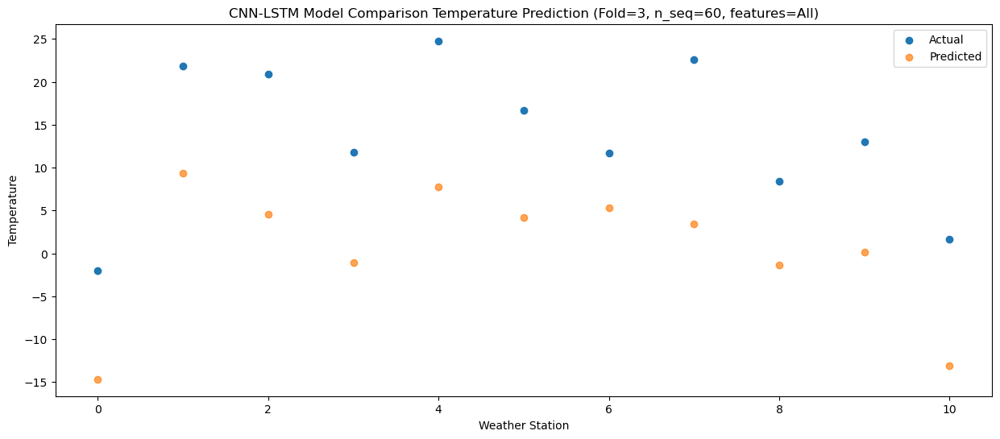

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11 -14.252952
1                 1   22.33   9.251272
2                 2   24.49   6.623842
3                 3   13.50  -0.801331
4                 4   23.94   7.833779
5                 5   17.23   4.363845
6                 6   12.44   6.626221
7                 7   25.65   5.334212
8                 8    9.65   0.627303
9                 9   15.58   1.255064
10               10    4.28 -12.141241


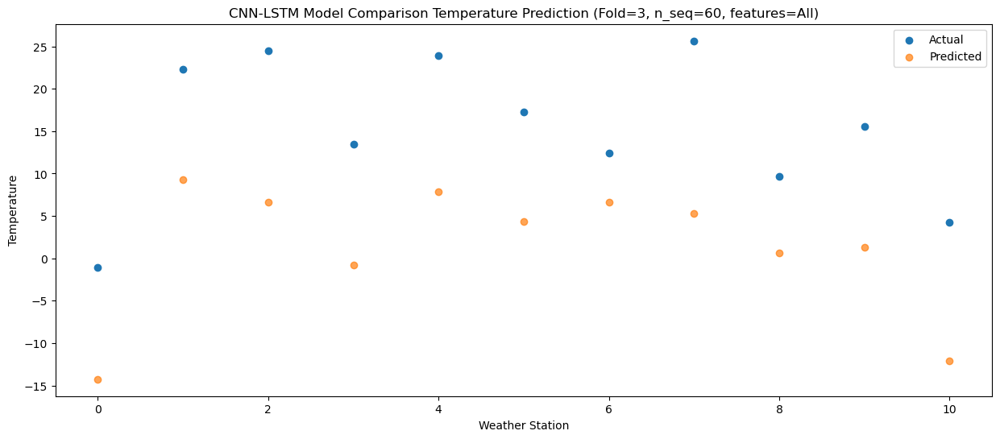

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51 -14.540575
1                 1   22.61  10.171349
2                 2   21.52   6.274134
3                 3   12.48  -1.133814
4                 4   23.39   8.140971
5                 5   16.68   4.308147
6                 6   12.15   6.728865
7                 7   22.79   5.173737
8                 8    8.37   0.315510
9                 9   13.86   0.117758
10               10    1.14 -13.172219


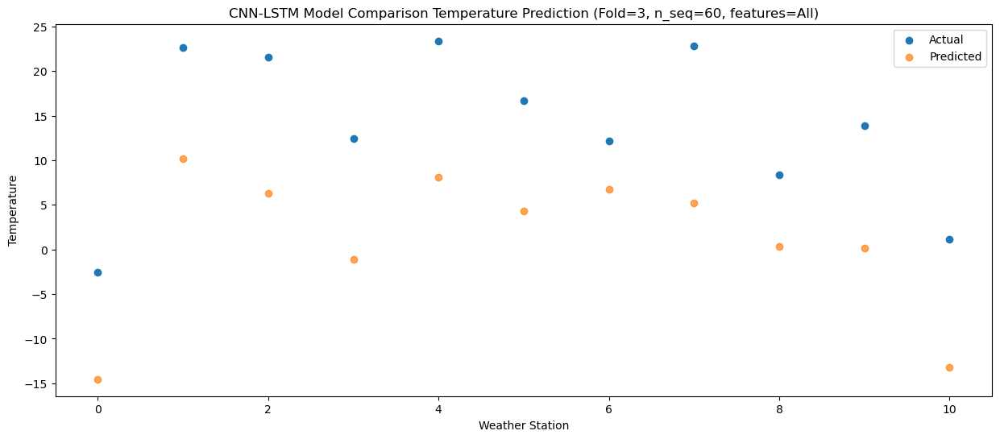

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20 -17.595472
1                 1   18.57   6.042923
2                 2   18.49   2.738985
3                 3    9.51  -4.408242
4                 4   20.13   4.411648
5                 5   13.99   0.819103
6                 6    8.53   2.941261
7                 7   18.84   1.462946
8                 8    6.93  -3.133695
9                 9    9.85  -2.895855
10               10   -2.45 -16.238885


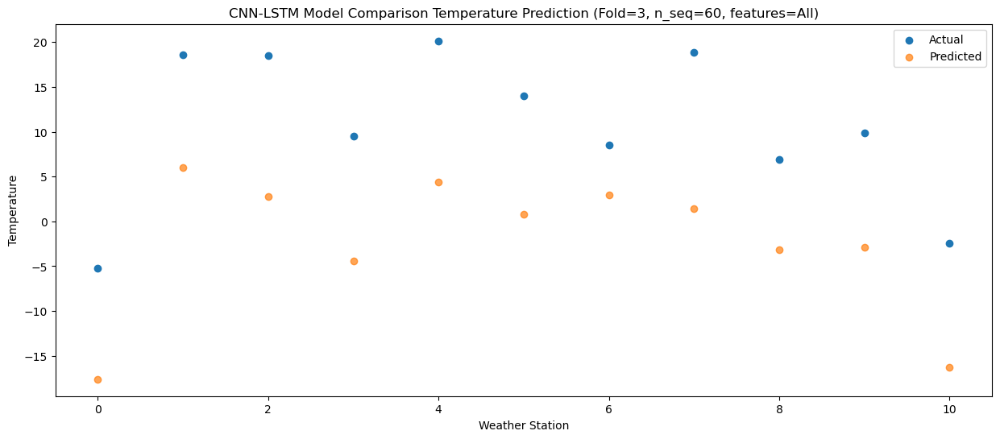

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51 -21.746938
1                 1   15.18   2.341507
2                 2   13.46  -1.409142
3                 3    3.01  -8.975098
4                 4   14.50   0.059698
5                 5    8.11  -3.690736
6                 6    4.30  -1.163923
7                 7   12.95  -2.702666
8                 8    6.47  -7.083655
9                 9    5.32  -8.039918
10               10   -7.69 -21.357335


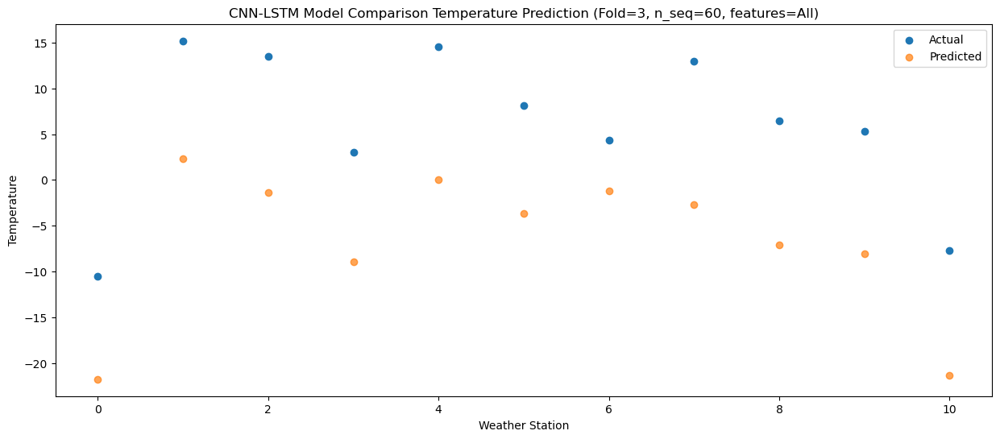

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_13 (Conv1D)          (None, 1, 1024)           2028544   
                                                                 
 max_pooling1d_13 (MaxPoolin  (None, 1, 1024)          0         
 g1D)                                                            
                                                                 
 dropout_39 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_26 (LSTM)              (None, 1, 512)            3147776   
                                                                 
 dropout_40 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_27 (LSTM)              (None, 512)               2099200   
                                                     

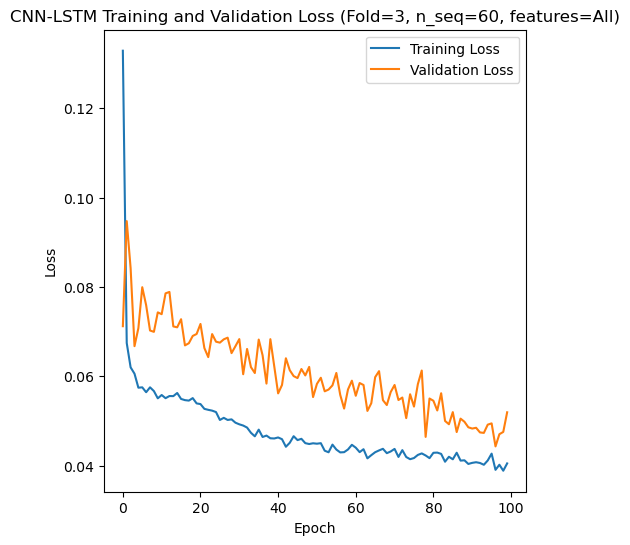

Epoch 1/100
84/84 [==============================] - 7s 39ms/step - loss: 0.1371 - accuracy: 0.2500 - mae: 0.1191 - rmse: 0.1371 - mape: inf - pearson: 0.6267 - val_loss: 0.0795 - val_accuracy: 0.6000 - val_mae: 0.0646 - val_rmse: 0.0795 - val_mape: 15.1417 - val_pearson: 0.7690
Epoch 2/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0694 - accuracy: 0.4524 - mae: 0.0548 - rmse: 0.0694 - mape: inf - pearson: 0.7984 - val_loss: 0.0684 - val_accuracy: 0.0000e+00 - val_mae: 0.0541 - val_rmse: 0.0684 - val_mape: 13.0303 - val_pearson: 0.8415
Epoch 3/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0621 - accuracy: 0.4286 - mae: 0.0491 - rmse: 0.0621 - mape: inf - pearson: 0.8255 - val_loss: 0.0709 - val_accuracy: 0.0000e+00 - val_mae: 0.0564 - val_rmse: 0.0709 - val_mape: 12.9824 - val_pearson: 0.8154
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0585 - accuracy: 0.4286 - mae: 0.0464 - rmse: 0.0585 - mape: inf - pearson: 

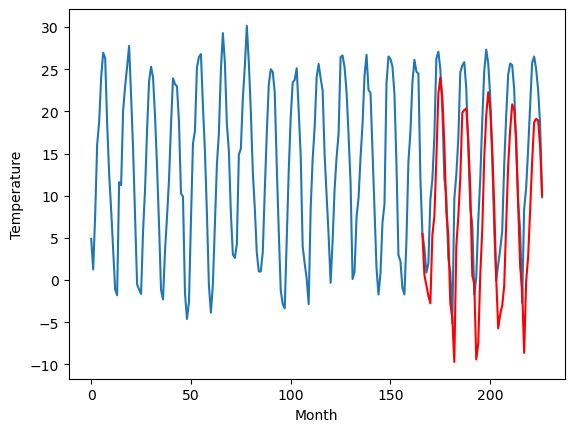

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-1.26		-1.63
0.19		-1.64		-1.83
-1.27		-1.82		-0.55
0.28		-1.23		-1.51
4.35		3.59		-0.76
6.03		4.82		-1.21
7.43		7.90		0.47
9.19		11.25		2.06
9.51		13.24		3.73
9.36		12.85		3.49
8.78		10.59		1.81
7.28		7.87		0.59
3.89		2.53		-1.36
-3.86		-4.26		-0.40
-3.16		-4.33		-1.17
0.27		-2.62		-2.89
1.87		1.04		-0.83
3.31		3.85		0.54
7.35		7.13		-0.22
8.98		10.62		1.64
9.35		11.63		2.28
9.63		11.91		2.28
8.34		9.25		0.91
6.50		6.32		-0.18
-0.66		-1.19		-0.53
1.14		1.02		-0.12
-3.62		-5.11		-1.49
-0.19		-1.53		-1.34
2.63		2.31		-0.32
4.97		5.68		0.71
7.79		9.99		2.20
9.51		13.35		3.84
9.88		14.21		4.33
9.83		13.57		3.74
8.39		11.03		2.64
4.56		6.18		1.62
3.10		2.46		-0.64
-1.75		-1.03		0.72
-1.90		0.66		2.56
1.40		2.56		1.16
3.12		3.60		0.48
5.84		6.81		0.97
6.62		9.17		2.55
8.83		12.00		3.17
10.44		16.63		6.19
10.95		16.09		5.14
8.85		12.51		3.66
5.20		8.53		3.33
1.49		3.05		1.56
-0.63		0.59		1.22

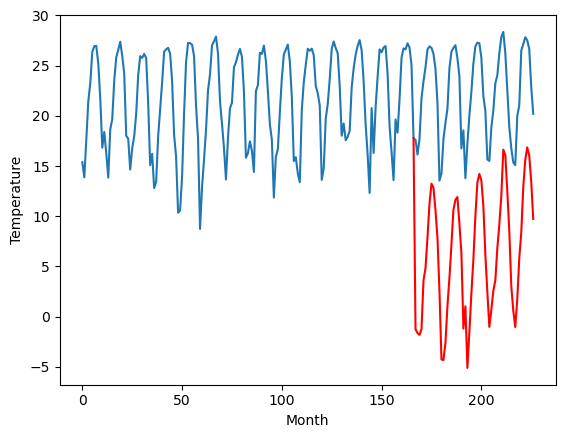

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-5.28		-0.91
-4.31		-5.40		-1.09
-4.50		-5.94		-1.44
-4.24		-6.08		-1.84
3.56		1.19		-2.37
2.61		1.93		-0.68
6.49		6.09		-0.40
10.58		11.16		0.58
12.15		12.83		0.68
11.32		11.37		0.05
9.22		7.93		-1.29
3.88		3.20		-0.68
-0.12		-0.62		-0.50
-6.37		-8.50		-2.13
-6.34		-9.21		-2.87
-8.26		-10.68		-2.42
1.07		-1.43		-2.50
2.14		0.93		-1.21
6.61		4.73		-1.88
10.87		9.45		-1.42
11.53		10.03		-1.50
12.18		10.48		-1.70
9.06		7.53		-1.53
5.67		4.05		-1.62
-3.00		-5.38		-2.38
0.51		-2.35		-2.86
-7.77		-11.29		-3.52
-5.41		-8.35		-2.94
-0.67		-2.47		-1.80
3.54		2.15		-1.39
9.34		8.18		-1.16
12.63		11.95		-0.68
12.83		13.22		0.39
11.29		11.38		0.09
9.22		8.08		-1.14
3.09		2.38		-0.71
-1.50		-2.71		-1.21
-3.93		-6.96		-3.03
-3.52		-5.21		-1.69
-1.58		-3.04		-1.46
0.57		-1.39		-1.96
2.32		2.51		0.19
7.18		6.76		-0.42
10.77		10.43		-0.34
12.55		13.67		1.12
14.63		13.61		-1.02
10.88		9.94		-0.94
4.77	

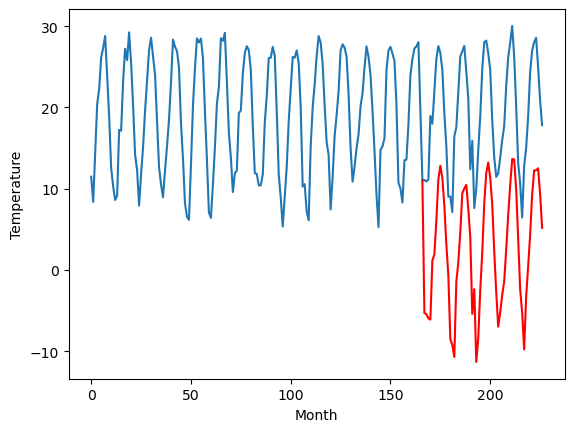

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-5.04		-1.40
-5.29		-5.58		-0.29
-5.05		-6.42		-1.37
-5.38		-6.81		-1.43
2.08		1.12		-0.96
2.74		2.41		-0.33
7.87		7.55		-0.32
12.83		13.54		0.71
14.69		14.94		0.25
14.44		13.30		-1.14
8.66		8.98		0.32
2.93		2.68		-0.25
0.32		-0.68		-1.00
-5.96		-8.49		-2.53
-6.88		-9.37		-2.49
-10.34		-12.77		-2.43
0.62		-1.14		-1.76
2.31		1.43		-0.88
6.47		5.55		-0.92
12.15		11.50		-0.65
13.74		11.97		-1.77
14.11		12.21		-1.90
11.32		9.15		-2.17
6.67		4.41		-2.26
-1.33		-5.00		-3.67
0.67		-3.42		-4.09
-7.80		-12.34		-4.54
-7.54		-10.36		-2.82
-1.36		-3.28		-1.92
4.69		1.93		-2.76
9.40		8.68		-0.72
13.95		13.17		-0.78
17.25		15.03		-2.22
14.52		12.87		-1.65
11.09		9.13		-1.96
4.22		2.92		-1.30
-2.83		-4.40		-1.57
-5.52		-8.74		-3.22
-4.53		-7.17		-2.64
-4.47		-5.32		-0.85
0.06		-3.01		-3.07
2.66		1.88		-0.78
8.34		7.68		-0.66
12.53		11.57		-0.96
15.08		14.47		-0.61
17.63		14.58		-3.05
12.93		10.80		-2

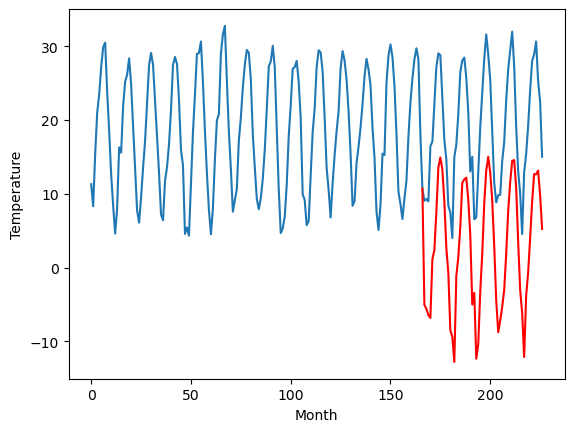

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-3.64		-0.87
-4.55		-4.28		0.27
-3.93		-5.15		-1.22
-4.31		-5.56		-1.25
3.57		2.34		-1.23
4.26		3.76		-0.50
9.91		9.04		-0.87
14.62		15.12		0.50
17.06		16.54		-0.52
16.38		14.90		-1.48
10.08		10.47		0.39
4.33		4.01		-0.32
1.57		0.65		-0.92
-5.00		-7.10		-2.10
-5.60		-8.01		-2.41
-9.49		-11.56		-2.07
1.43		0.17		-1.26
3.61		2.82		-0.79
7.14		6.99		-0.15
13.99		13.09		-0.90
15.48		13.57		-1.91
15.85		13.76		-2.09
12.42		10.68		-1.74
7.55		5.77		-1.78
-0.29		-3.57		-3.28
1.45		-2.31		-3.76
-7.45		-11.09		-3.64
-6.83		-9.19		-2.36
0.09		-2.03		-2.12
6.78		3.20		-3.58
11.61		10.02		-1.59
16.28		14.59		-1.69
19.70		16.54		-3.16
16.86		14.42		-2.44
12.77		10.61		-2.16
5.62		4.36		-1.26
-1.47		-3.20		-1.73
-4.44		-7.59		-3.15
-3.67		-6.02		-2.35
-3.44		-4.27		-0.83
1.41		-1.91		-3.32
4.06		3.16		-0.90
10.22		9.11		-1.11
15.33		12.99		-2.34
18.41		15.93		-2.48
20.28		16.00		-4.28
15.19		12.23		

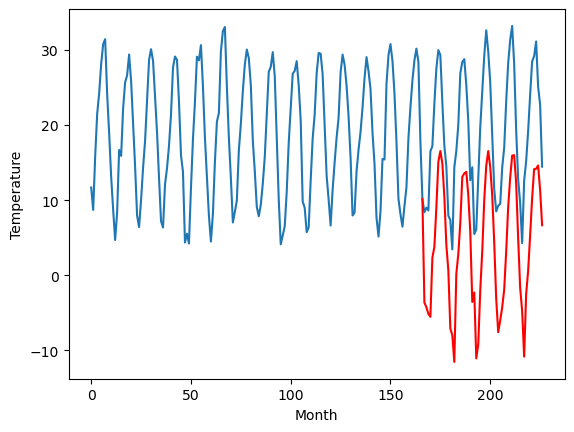

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		7.62		-1.19
7.17		6.61		-0.56
6.44		5.87		-0.57
5.68		5.83		0.15
13.24		12.37		-0.87
16.21		14.36		-1.85
22.78		19.49		-3.29
26.11		24.80		-1.31
28.94		26.37		-2.57
28.32		25.30		-3.02
20.59		21.25		0.66
16.63		15.31		-1.32
12.75		11.10		-1.65
5.77		4.16		-1.61
4.67		3.59		-1.08
3.10		1.25		-1.85
12.35		10.33		-2.02
14.58		13.47		-1.11
20.07		17.45		-2.62
25.03		23.37		-1.66
24.77		24.08		-0.69
25.09		24.00		-1.09
24.40		21.03		-3.37
18.70		15.89		-2.81
11.76		7.87		-3.89
12.17		7.92		-4.25
4.80		1.03		-3.77
4.60		2.91		-1.69
11.92		9.29		-2.63
19.43		13.99		-5.44
25.12		20.06		-5.06
27.49		24.70		-2.79
29.39		26.72		-2.67
26.09		25.25		-0.84
23.19		21.71		-1.48
16.38		15.77		-0.61
8.53		7.98		-0.55
6.93		4.12		-2.81
7.30		5.57		-1.73
7.47		6.84		-0.63
12.54		9.18		-3.36
16.76		14.27		-2.49
21.68		19.74		-1.94
28.16		23.17		-4.99
29.62		26.95		-2.67
29.71		26.72		-2.99
26.23		22.91		-3.

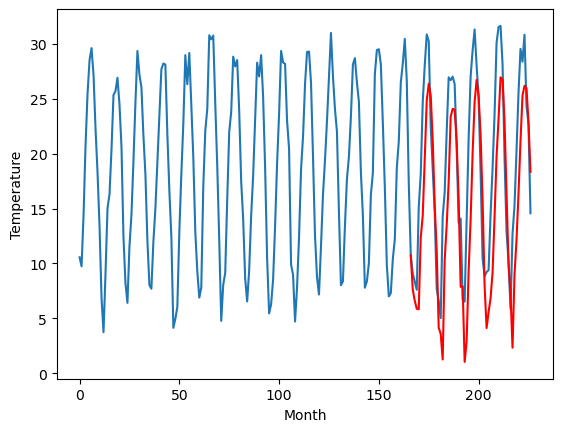

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		1.62		-0.17
1.44		1.18		-0.26
1.27		0.72		-0.55
1.74		0.65		-1.09
7.35		6.96		-0.39
8.62		8.13		-0.49
11.41		12.57		1.16
16.00		17.73		1.73
19.04		19.95		0.91
17.84		18.39		0.55
14.04		15.02		0.98
10.22		10.56		0.34
5.91		6.31		0.40
-1.34		-1.36		-0.02
-1.11		-2.37		-1.26
-0.44		-3.04		-2.60
5.96		4.73		-1.23
8.69		7.77		-0.92
12.14		11.57		-0.57
16.16		16.47		0.31
17.90		17.12		-0.78
18.03		17.62		-0.41
14.06		14.44		0.38
10.26		11.07		0.81
2.10		1.60		-0.50
4.01		3.66		-0.35
-2.05		-4.60		-2.55
2.23		-1.06		-3.29
5.79		4.32		-1.47
8.45		8.42		-0.03
14.43		14.70		0.27
17.64		18.41		0.77
18.91		19.88		0.97
17.39		18.62		1.23
14.30		15.04		0.74
7.43		9.45		2.02
4.73		4.99		0.26
-1.22		0.10		1.32
1.80		1.99		0.19
5.22		3.62		-1.60
5.70		4.85		-0.85
8.81		9.59		0.78
11.43		13.24		1.81
15.07		16.76		1.69
18.94		20.74		1.80
18.38		19.93		1.55
14.54		16.50		1.96
9.10		11.23		2.13
3.37		4.84		

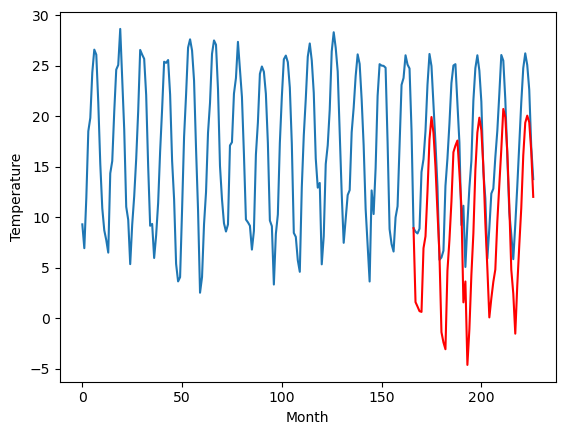

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		2.02		-1.98
3.19		1.34		-1.85
1.54		0.42		-1.12
2.11		-0.15		-2.26
9.04		7.69		-1.35
10.62		9.17		-1.45
14.72		14.86		0.14
21.07		21.48		0.41
23.61		23.28		-0.33
21.62		21.17		-0.45
18.04		16.59		-1.45
11.11		9.98		-1.13
8.56		6.75		-1.81
2.03		-1.28		-3.31
0.36		-2.64		-3.00
-3.25		-6.26		-3.01
9.02		5.75		-3.27
10.92		8.73		-2.19
14.96		12.99		-1.97
21.26		19.40		-1.86
22.55		19.77		-2.78
23.07		20.13		-2.94
20.03		16.74		-3.29
14.26		12.10		-2.16
6.32		1.93		-4.39
7.78		3.04		-4.74
-1.29		-6.29		-5.00
0.77		-3.87		-4.64
7.43		3.35		-4.08
11.29		8.45		-2.84
16.96		15.98		-0.98
22.28		20.45		-1.83
25.98		22.54		-3.44
22.46		20.54		-1.92
18.87		16.32		-2.55
12.50		9.99		-2.51
5.95		3.04		-2.91
1.10		-2.17		-3.27
2.75		-0.43		-3.18
4.89		1.10		-3.79
6.61		3.13		-3.48
12.23		8.94		-3.29
17.01		14.71		-2.30
21.09		18.75		-2.34
23.05		21.83		-1.22
22.86		21.39		-1.47
18.92		17.83		-1.09
13.

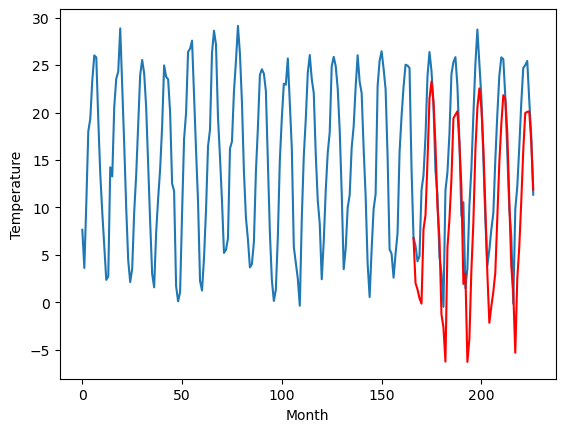

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		1.42		0.01
0.59		0.44		-0.15
-0.34		-0.50		-0.16
-1.17		-1.27		-0.10
5.65		5.98		0.33
8.64		7.82		-0.82
14.22		14.25		0.03
21.51		21.61		0.10
23.55		24.13		0.58
21.35		21.43		0.08
17.59		16.62		-0.97
10.75		9.79		-0.96
6.91		6.49		-0.42
-0.60		-1.72		-1.12
-2.18		-3.79		-1.61
-5.54		-7.24		-1.70
6.43		4.44		-1.99
10.08		8.21		-1.87
14.49		12.63		-1.86
21.73		19.60		-2.13
22.30		19.86		-2.44
23.16		20.40		-2.76
19.67		16.44		-3.23
14.32		12.05		-2.27
3.46		0.96		-2.50
3.78		1.12		-2.66
-5.06		-8.43		-3.37
-2.04		-5.18		-3.14
5.43		1.94		-3.49
9.21		6.69		-2.52
17.71		15.27		-2.44
22.19		19.61		-2.58
24.13		21.98		-2.15
21.90		20.45		-1.45
17.99		15.58		-2.41
10.50		9.23		-1.27
4.71		3.14		-1.57
-1.07		-3.36		-2.29
0.89		-1.37		-2.26
2.48		-0.49		-2.97
3.75		1.02		-2.73
10.25		8.27		-1.98
15.96		13.62		-2.34
19.84		17.79		-2.05
22.57		21.42		-1.15
21.41		19.97		-1.44
18.32		16.80		-1.52
1

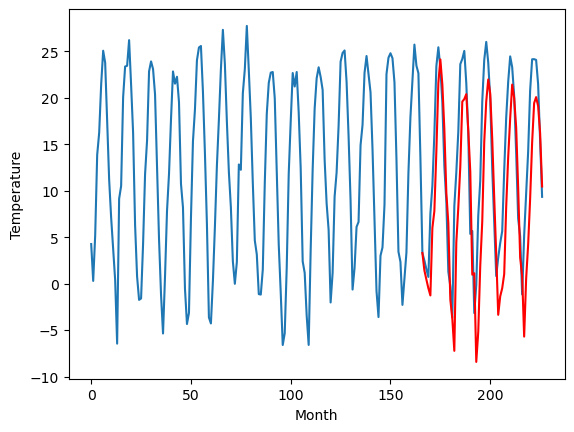

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		0.94		-0.48
1.10		-0.14		-1.24
-1.34		-1.27		0.07
-1.59		-2.17		-0.58
6.01		5.63		-0.38
9.12		7.65		-1.47
15.00		14.34		-0.66
22.73		22.02		-0.71
23.94		24.29		0.35
21.34		21.65		0.31
17.44		16.44		-1.00
10.10		8.91		-1.19
7.46		5.95		-1.51
-0.42		-2.26		-1.84
-2.45		-4.25		-1.80
-6.89		-8.72		-1.83
6.97		4.28		-2.69
10.68		7.88		-2.80
15.46		12.46		-3.00
22.85		19.82		-3.03
22.56		20.07		-2.49
22.84		20.46		-2.38
19.73		16.57		-3.16
14.27		11.57		-2.70
3.96		0.63		-3.33
3.71		0.30		-3.41
-5.77		-9.21		-3.44
-2.94		-6.55		-3.61
5.27		1.14		-4.13
9.39		6.24		-3.15
17.92		14.96		-2.96
22.53		19.64		-2.89
23.35		22.18		-1.17
22.05		20.40		-1.65
17.91		15.49		-2.42
10.44		8.91		-1.53
4.90		1.67		-3.23
-1.83		-4.67		-2.84
0.41		-2.79		-3.20
1.60		-1.82		-3.42
4.14		0.06		-4.08
11.47		7.46		-4.01
17.23		13.65		-3.58
21.54		17.92		-3.62
23.07		21.15		-1.92
21.81		20.07		-1.74
18.77		16.81		-1

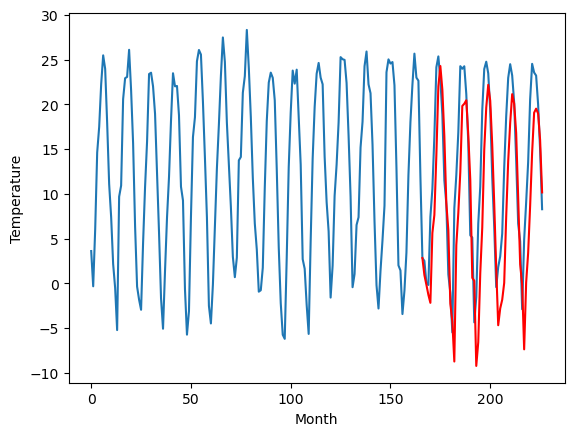

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		-1.47		-0.38
-1.87		-2.67		-0.80
-3.07		-3.50		-0.43
-3.88		-4.25		-0.37
2.28		2.33		0.05
3.66		4.34		0.68
10.40		11.00		0.60
16.89		18.46		1.57
20.33		21.43		1.10
17.92		18.55		0.63
13.93		13.82		-0.11
7.77		7.21		-0.56
4.54		3.63		-0.91
-3.02		-4.52		-1.50
-4.94		-6.91		-1.97
-7.18		-9.74		-2.56
2.71		0.90		-1.81
6.51		5.19		-1.32
11.04		9.63		-1.41
17.93		16.70		-1.23
18.09		16.96		-1.13
19.29		17.59		-1.70
15.00		13.37		-1.63
11.47		9.23		-2.24
1.07		-2.10		-3.17
0.21		-2.43		-2.64
-8.62		-11.78		-3.16
-5.06		-7.95		-2.89
0.91		-1.22		-2.13
4.91		3.22		-1.69
13.49		12.13		-1.36
16.76		16.29		-0.47
19.36		18.76		-0.60
18.29		17.66		-0.63
14.24		12.53		-1.71
7.38		6.32		-1.06
3.30		0.98		-2.32
-3.41		-6.08		-2.67
-1.78		-3.99		-2.21
-1.64		-3.54		-1.90
-0.76		-2.37		-1.61
7.71		5.53		-2.18
11.40		10.30		-1.10
15.71		14.44		-1.27
18.80		18.63		-0.17
17.47		16.53		-0.94
15.13		13.55		

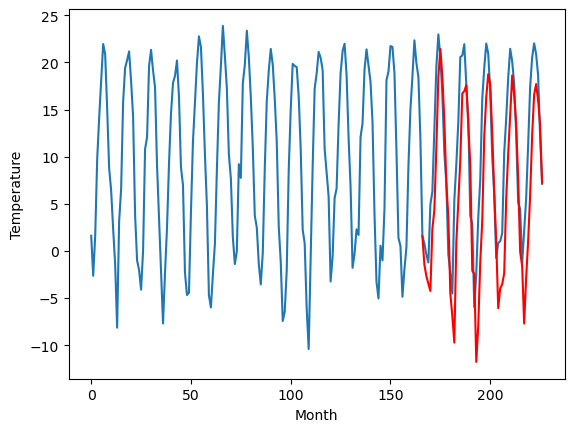

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[0.629379577636719, -1.2616256332397464, -5.279308547973633, -5.038843994140625, -3.6432698822021488, 7.622244720458985, 1.619499435424805, 2.0237899398803716, 1.422782363891601, 0.9376493072509771, -1.4706646728515622]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   0.629380
1                 1    0.37  -1.261626
2                 2   -4.37  -5.279309
3                 3   -3.64  -5.038844
4                 4   -2.77  -3.643270
5                 5    8.81   7.622245
6                 6    1.79   1.619499
7                 7    4.00   2.023790
8                 8    1.41   1.422782
9                 9    1.42   0.937649
10               10   -1.09  -1.470665


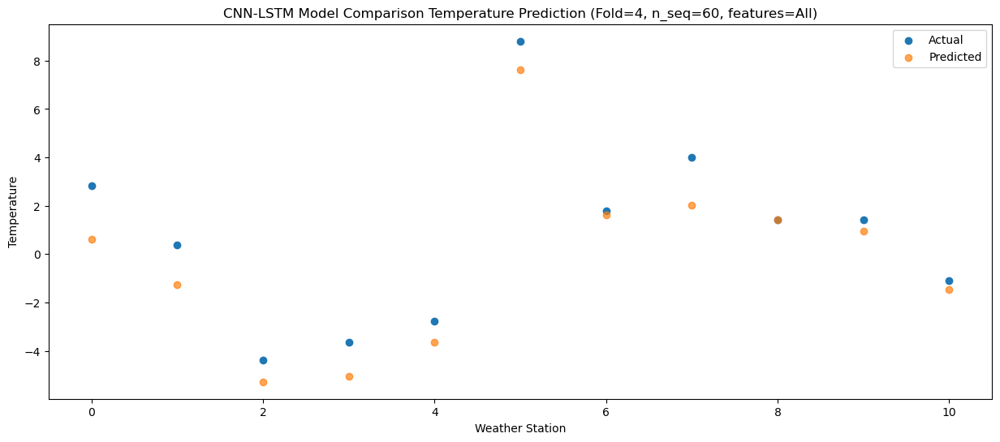

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.626846
1                 1    0.19  -1.635489
2                 2   -4.31  -5.403668
3                 3   -5.29  -5.578800
4                 4   -4.55  -4.280833
5                 5    7.17   6.607336
6                 6    1.44   1.180192
7                 7    3.19   1.344436
8                 8    0.59   0.437133
9                 9    1.10  -0.140597
10               10   -1.87  -2.672874


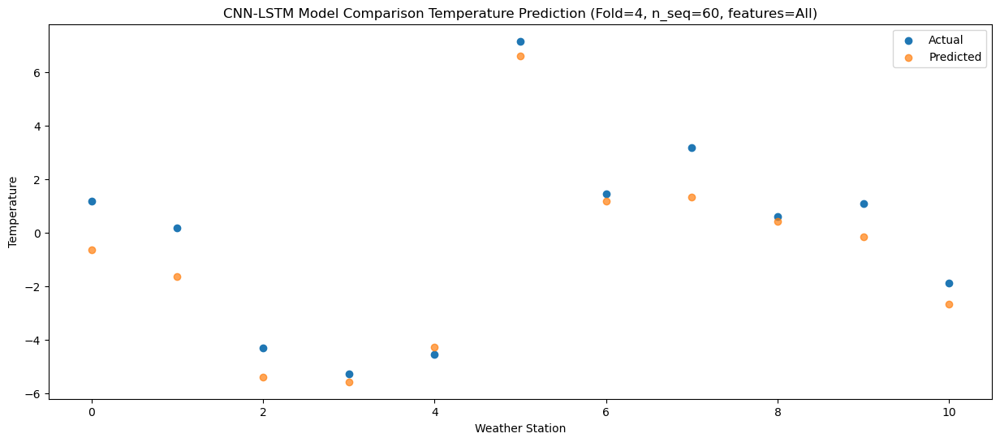

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.858361
1                 1   -1.27  -1.821837
2                 2   -4.50  -5.939392
3                 3   -5.05  -6.423747
4                 4   -3.93  -5.152690
5                 5    6.44   5.870414
6                 6    1.27   0.723103
7                 7    1.54   0.421115
8                 8   -0.34  -0.502597
9                 9   -1.34  -1.273035
10               10   -3.07  -3.503735


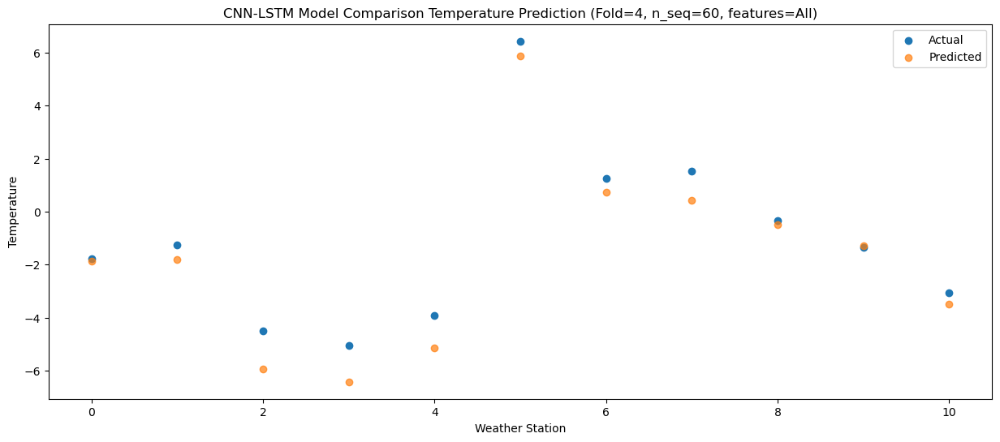

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -2.752338
1                 1    0.28  -1.234528
2                 2   -4.24  -6.084260
3                 3   -5.38  -6.814409
4                 4   -4.31  -5.556734
5                 5    5.68   5.831182
6                 6    1.74   0.652221
7                 7    2.11  -0.150276
8                 8   -1.17  -1.271176
9                 9   -1.59  -2.165040
10               10   -3.88  -4.249807


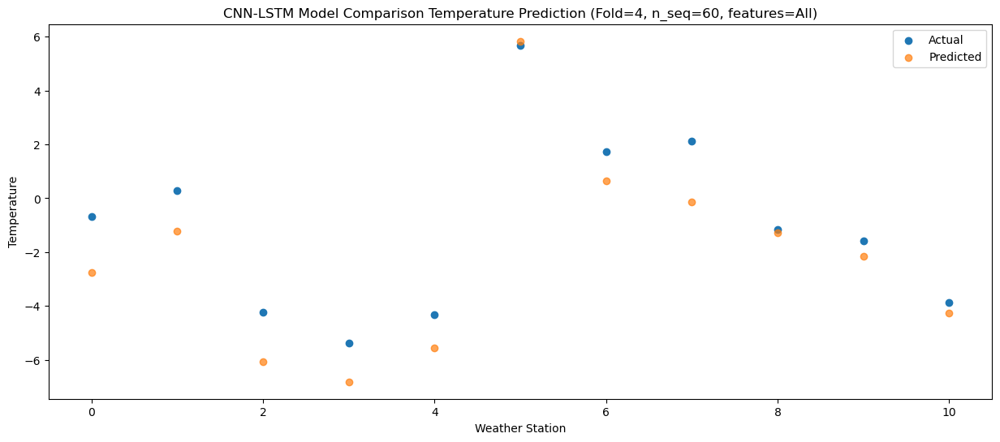

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   5.331014
1                 1    4.35   3.591168
2                 2    3.56   1.186512
3                 3    2.08   1.116126
4                 4    3.57   2.340696
5                 5   13.24  12.369265
6                 6    7.35   6.958081
7                 7    9.04   7.690379
8                 8    5.65   5.983218
9                 9    6.01   5.633530
10               10    2.28   2.329636


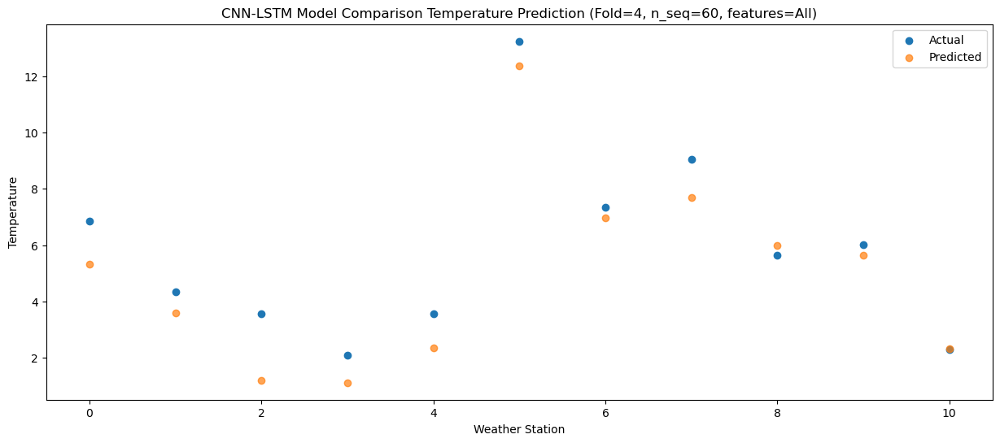

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.590561
1                 1    6.03   4.824048
2                 2    2.61   1.933372
3                 3    2.74   2.410093
4                 4    4.26   3.761216
5                 5   16.21  14.364240
6                 6    8.62   8.132629
7                 7   10.62   9.167728
8                 8    8.64   7.816001
9                 9    9.12   7.647332
10               10    3.66   4.340073


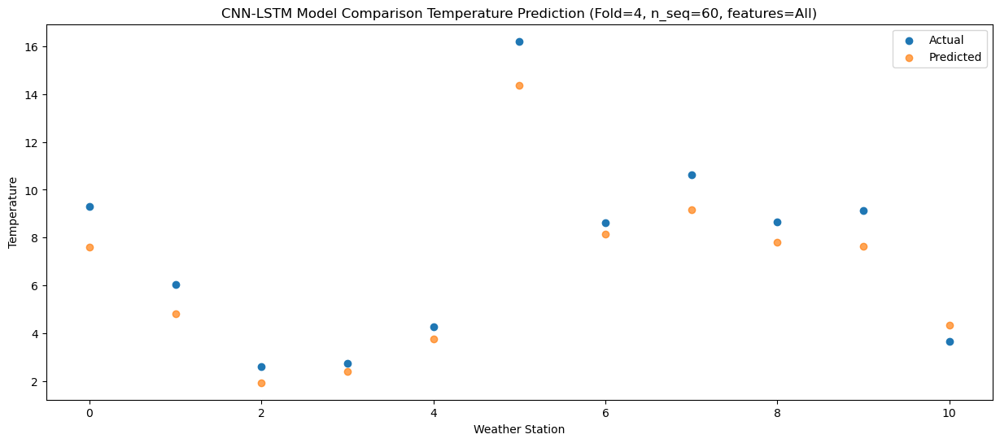

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  14.389686
1                 1    7.43   7.896563
2                 2    6.49   6.089507
3                 3    7.87   7.554326
4                 4    9.91   9.040364
5                 5   22.78  19.492626
6                 6   11.41  12.570636
7                 7   14.72  14.859351
8                 8   14.22  14.253682
9                 9   15.00  14.339890
10               10   10.40  10.997257


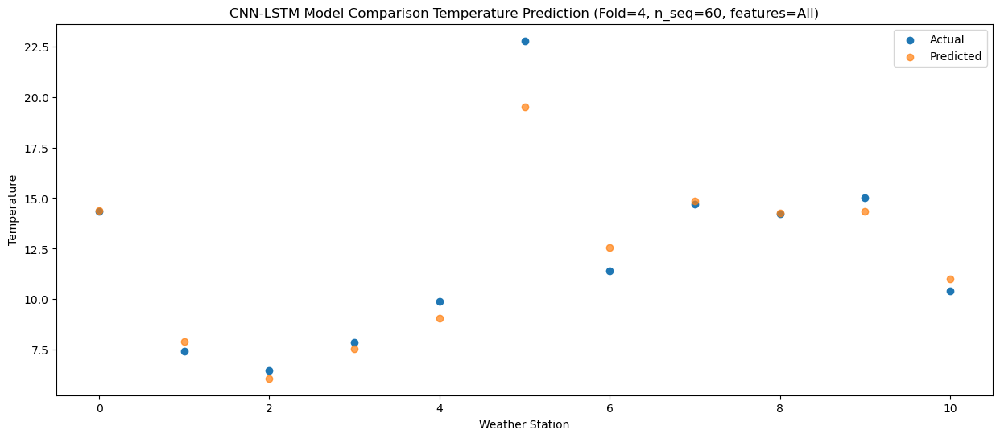

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  22.090261
1                 1    9.19  11.245231
2                 2   10.58  11.161457
3                 3   12.83  13.544521
4                 4   14.62  15.122384
5                 5   26.11  24.804663
6                 6   16.00  17.726085
7                 7   21.07  21.477069
8                 8   21.51  21.606130
9                 9   22.73  22.022664
10               10   16.89  18.459081


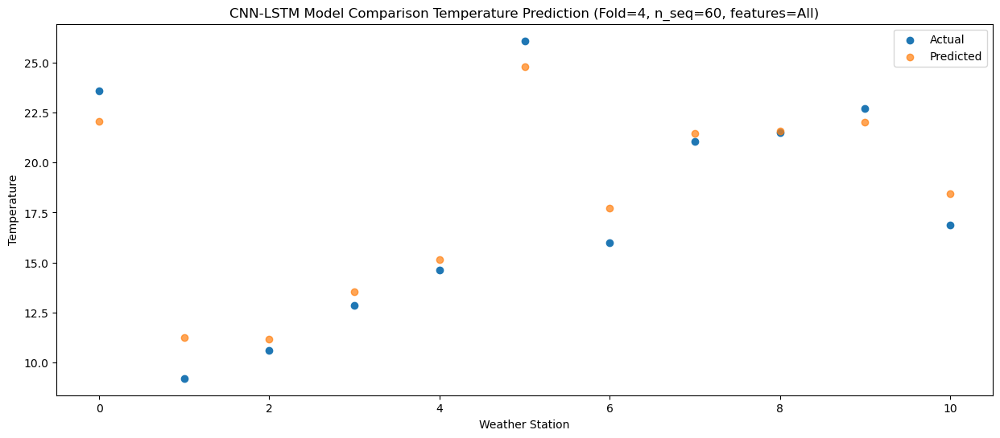

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  24.024618
1                 1    9.51  13.241884
2                 2   12.15  12.826187
3                 3   14.69  14.942886
4                 4   17.06  16.538760
5                 5   28.94  26.366248
6                 6   19.04  19.946522
7                 7   23.61  23.278296
8                 8   23.55  24.132793
9                 9   23.94  24.287325
10               10   20.33  21.433204


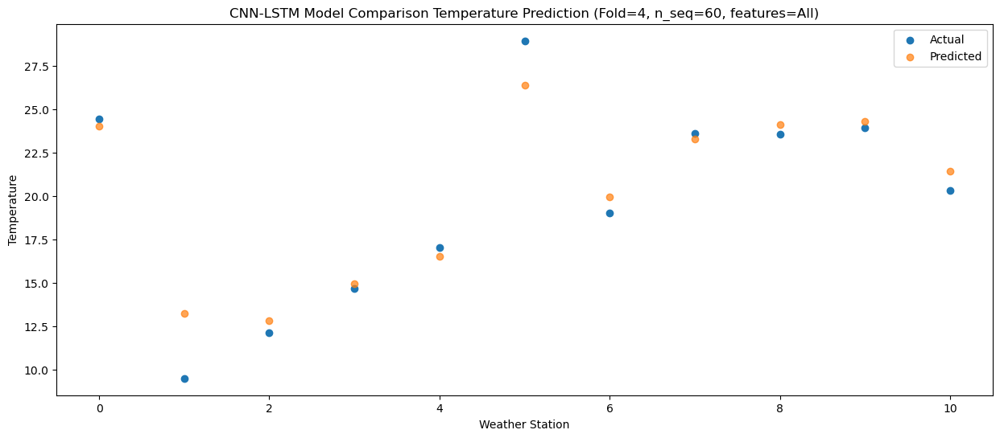

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  21.683979
1                 1    9.36  12.846015
2                 2   11.32  11.365639
3                 3   14.44  13.298794
4                 4   16.38  14.897162
5                 5   28.32  25.304293
6                 6   17.84  18.386409
7                 7   21.62  21.166172
8                 8   21.35  21.432144
9                 9   21.34  21.654127
10               10   17.92  18.554606


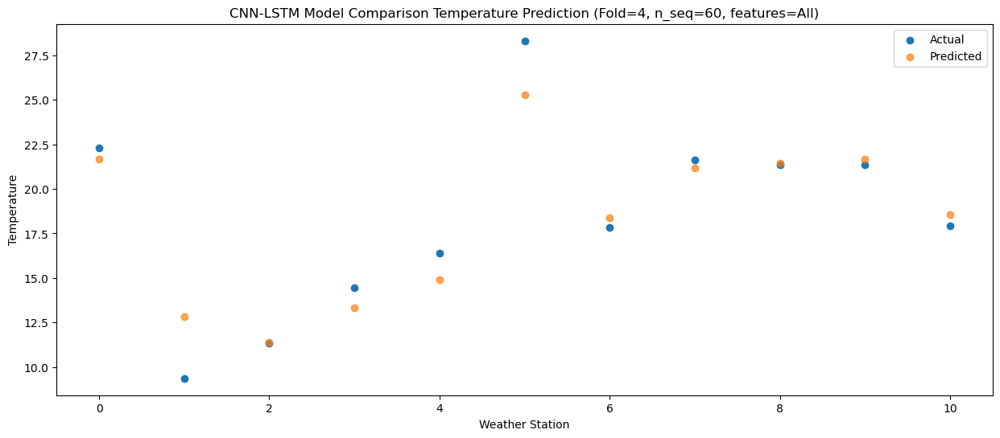

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  16.168485
1                 1    8.78  10.594137
2                 2    9.22   7.925465
3                 3    8.66   8.976577
4                 4   10.08  10.470005
5                 5   20.59  21.247199
6                 6   14.04  15.019601
7                 7   18.04  16.594470
8                 8   17.59  16.618810
9                 9   17.44  16.437056
10               10   13.93  13.818993


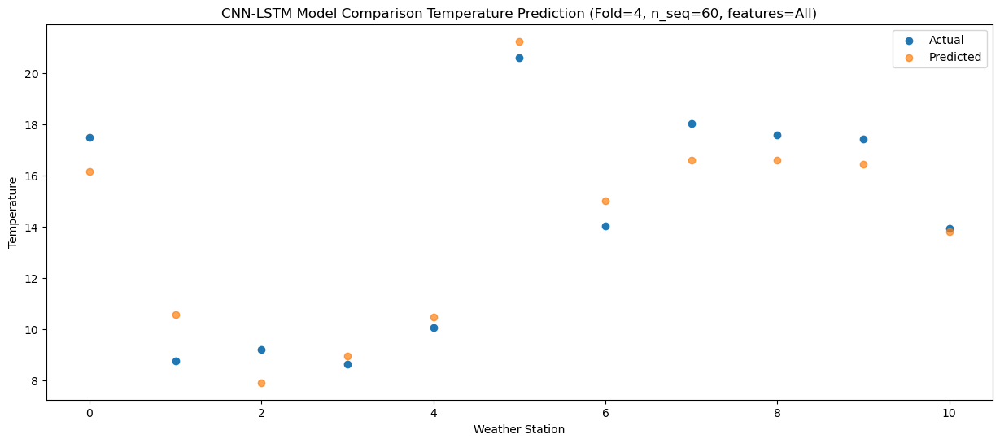

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   8.100617
1                 1    7.28   7.870867
2                 2    3.88   3.195334
3                 3    2.93   2.678335
4                 4    4.33   4.010129
5                 5   16.63  15.313703
6                 6   10.22  10.555526
7                 7   11.11   9.984189
8                 8   10.75   9.793482
9                 9   10.10   8.912813
10               10    7.77   7.211180


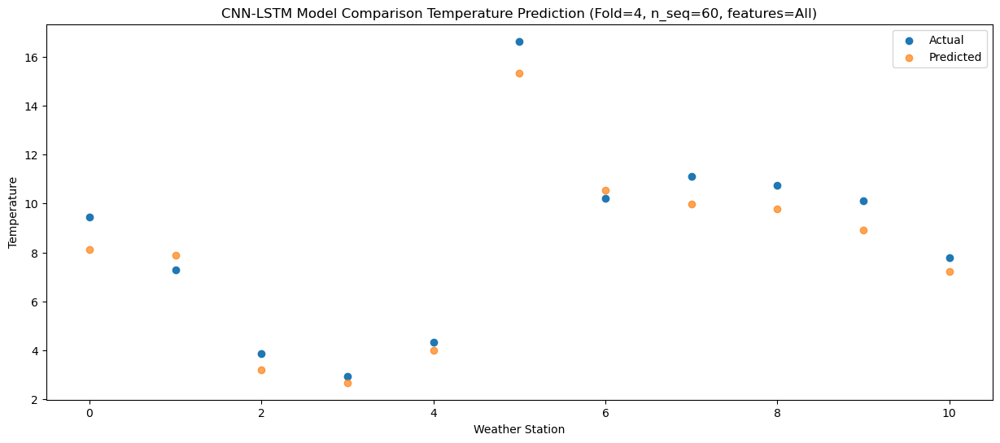

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.244889
1                 1    3.89   2.532127
2                 2   -0.12  -0.620183
3                 3    0.32  -0.680537
4                 4    1.57   0.653434
5                 5   12.75  11.098058
6                 6    5.91   6.308968
7                 7    8.56   6.745821
8                 8    6.91   6.494140
9                 9    7.46   5.952857
10               10    4.54   3.627630


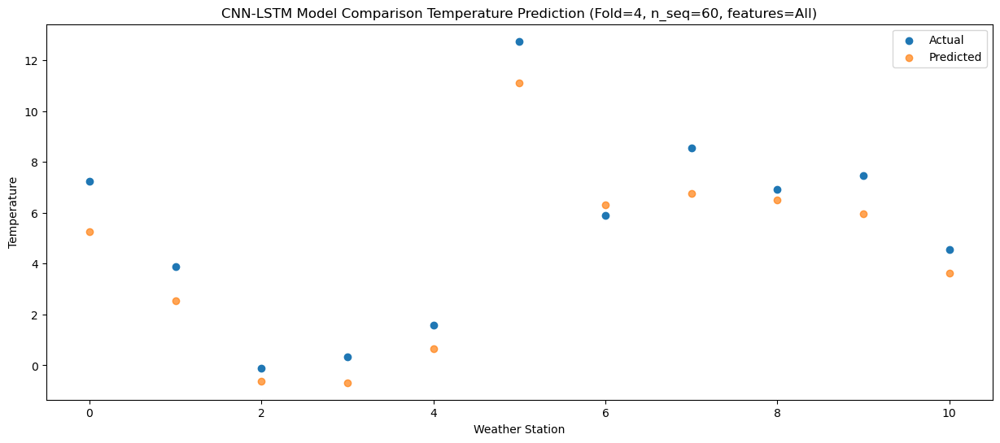

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -2.733906
1                 1   -3.86  -4.262812
2                 2   -6.37  -8.497037
3                 3   -5.96  -8.491165
4                 4   -5.00  -7.103617
5                 5    5.77   4.157482
6                 6   -1.34  -1.356370
7                 7    2.03  -1.281452
8                 8   -0.60  -1.716436
9                 9   -0.42  -2.255280
10               10   -3.02  -4.522132


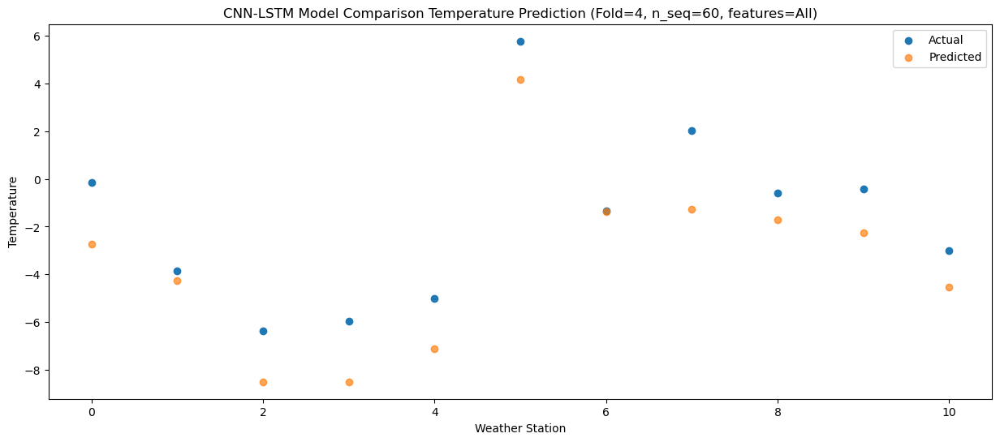

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -4.485925
1                 1   -3.16  -4.331100
2                 2   -6.34  -9.213275
3                 3   -6.88  -9.367432
4                 4   -5.60  -8.007669
5                 5    4.67   3.587048
6                 6   -1.11  -2.366632
7                 7    0.36  -2.641640
8                 8   -2.18  -3.787957
9                 9   -2.45  -4.249353
10               10   -4.94  -6.905235


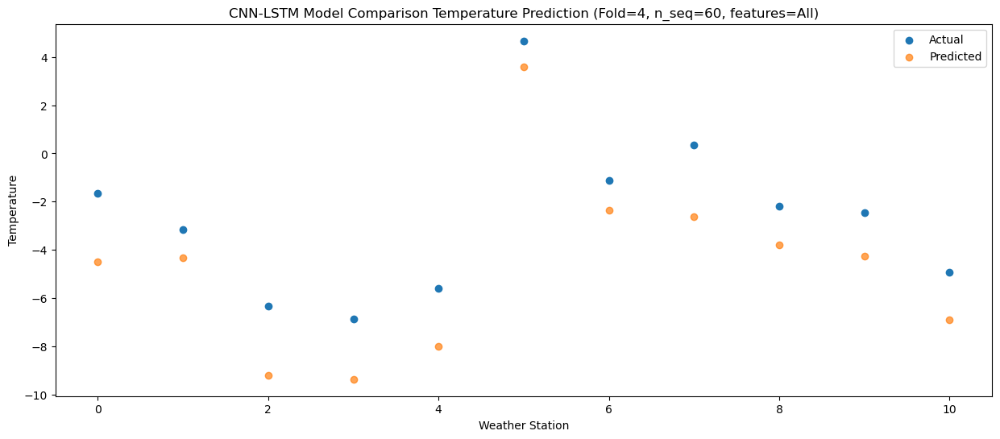

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -9.697476
1                 1    0.27  -2.618736
2                 2   -8.26 -10.681774
3                 3  -10.34 -12.768760
4                 4   -9.49 -11.557740
5                 5    3.10   1.254541
6                 6   -0.44  -3.044105
7                 7   -3.25  -6.259936
8                 8   -5.54  -7.236987
9                 9   -6.89  -8.722171
10               10   -7.18  -9.736837


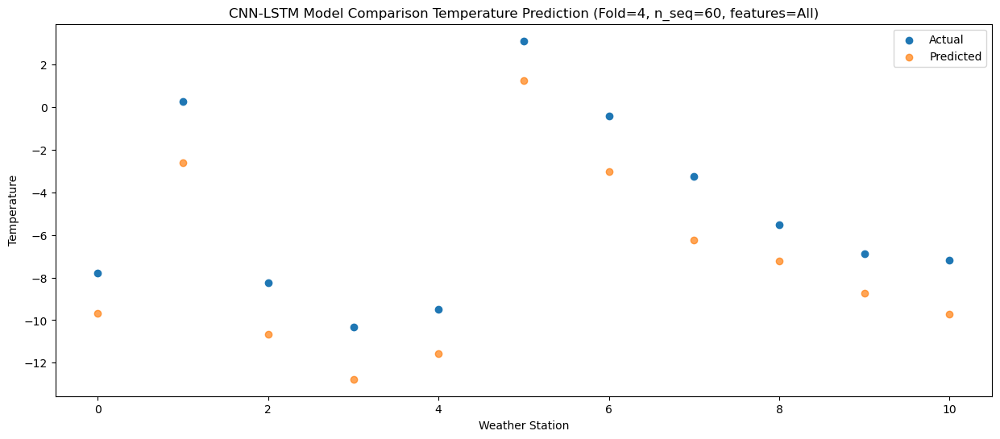

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   4.038328
1                 1    1.87   1.042893
2                 2    1.07  -1.429774
3                 3    0.62  -1.135531
4                 4    1.43   0.168410
5                 5   12.35  10.325514
6                 6    5.96   4.732943
7                 7    9.02   5.753207
8                 8    6.43   4.439843
9                 9    6.97   4.281628
10               10    2.71   0.901243


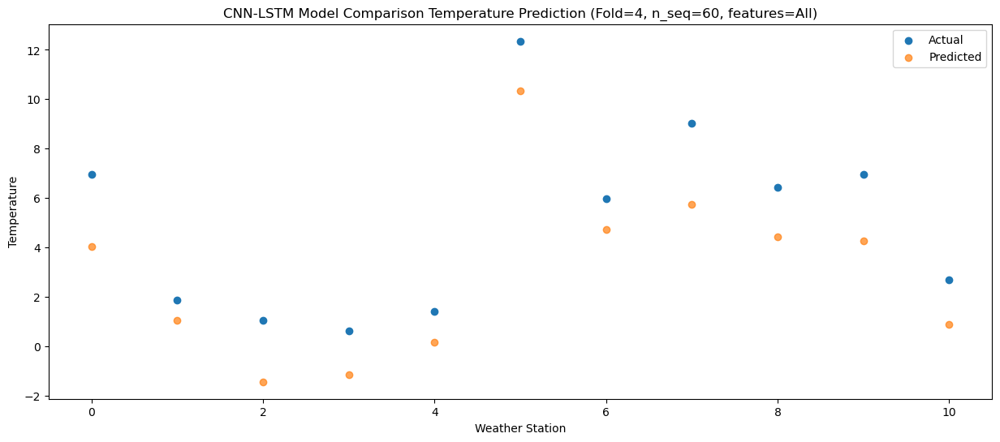

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   7.510372
1                 1    3.31   3.847497
2                 2    2.14   0.934097
3                 3    2.31   1.428107
4                 4    3.61   2.817901
5                 5   14.58  13.473049
6                 6    8.69   7.774333
7                 7   10.92   8.728639
8                 8   10.08   8.205719
9                 9   10.68   7.878297
10               10    6.51   5.188958


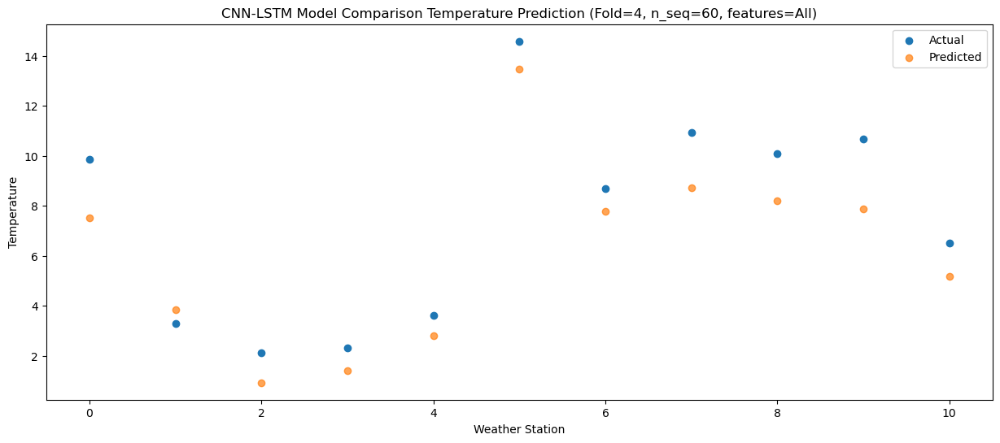

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  12.175421
1                 1    7.35   7.131967
2                 2    6.61   4.726903
3                 3    6.47   5.554472
4                 4    7.14   6.987207
5                 5   20.07  17.453757
6                 6   12.14  11.566891
7                 7   14.96  12.992557
8                 8   14.49  12.626996
9                 9   15.46  12.455654
10               10   11.04   9.633064


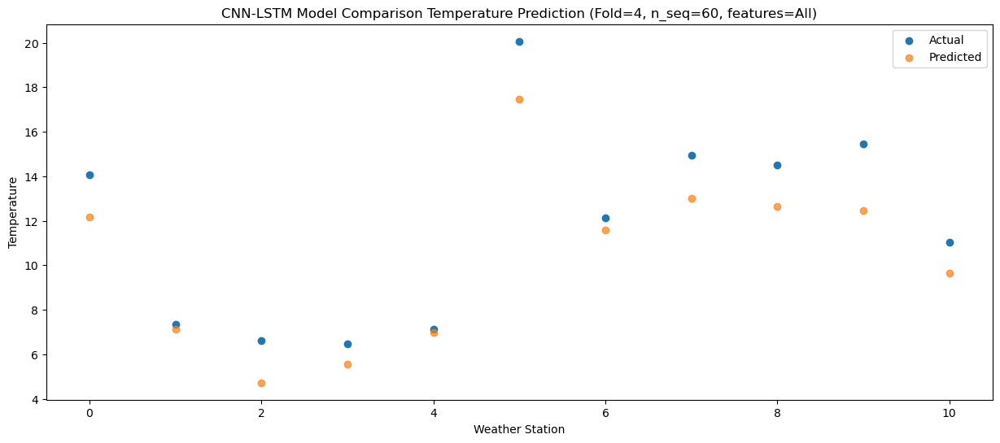

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  19.837045
1                 1    8.98  10.619888
2                 2   10.87   9.445936
3                 3   12.15  11.496643
4                 4   13.99  13.085383
5                 5   25.03  23.369464
6                 6   16.16  16.465070
7                 7   21.26  19.397829
8                 8   21.73  19.595445
9                 9   22.85  19.824756
10               10   17.93  16.701435


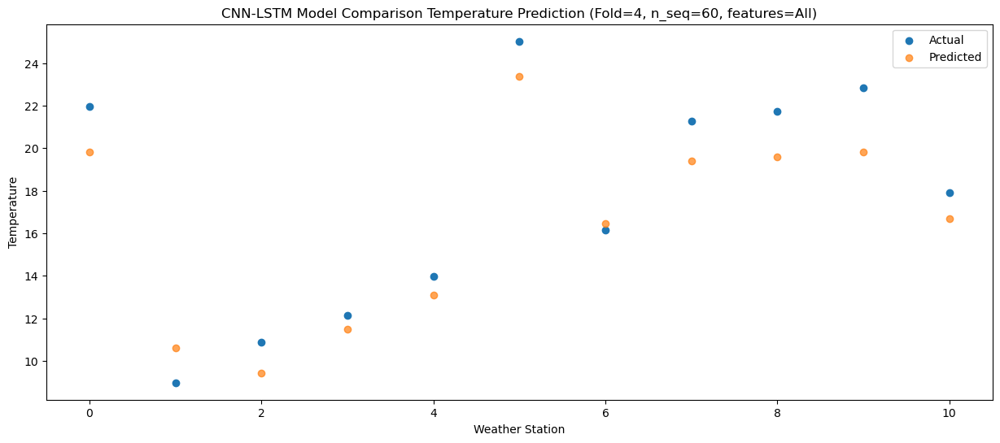

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  20.163713
1                 1    9.35  11.634816
2                 2   11.53  10.031112
3                 3   13.74  11.973876
4                 4   15.48  13.568510
5                 5   24.77  24.078694
6                 6   17.90  17.115381
7                 7   22.55  19.774013
8                 8   22.30  19.863474
9                 9   22.56  20.074862
10               10   18.09  16.960367


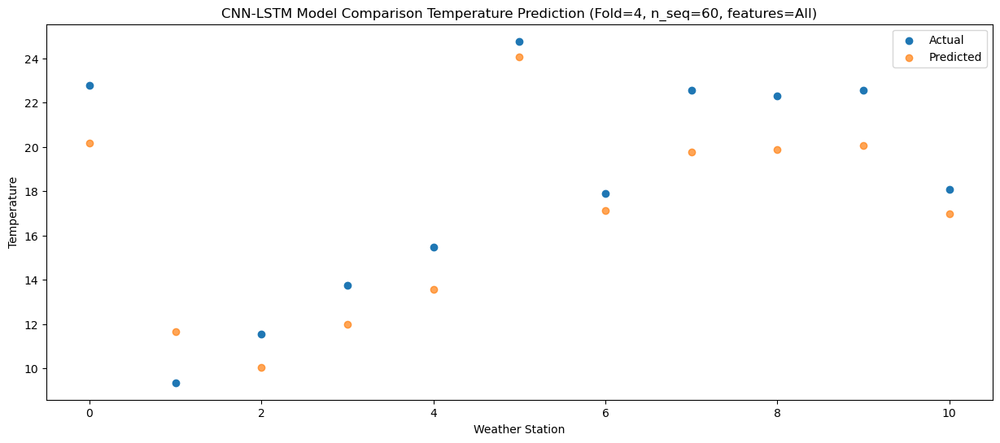

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  20.321422
1                 1    9.63  11.910017
2                 2   12.18  10.482254
3                 3   14.11  12.206042
4                 4   15.85  13.762732
5                 5   25.09  23.995735
6                 6   18.03  17.619678
7                 7   23.07  20.133656
8                 8   23.16  20.396003
9                 9   22.84  20.462013
10               10   19.29  17.585903


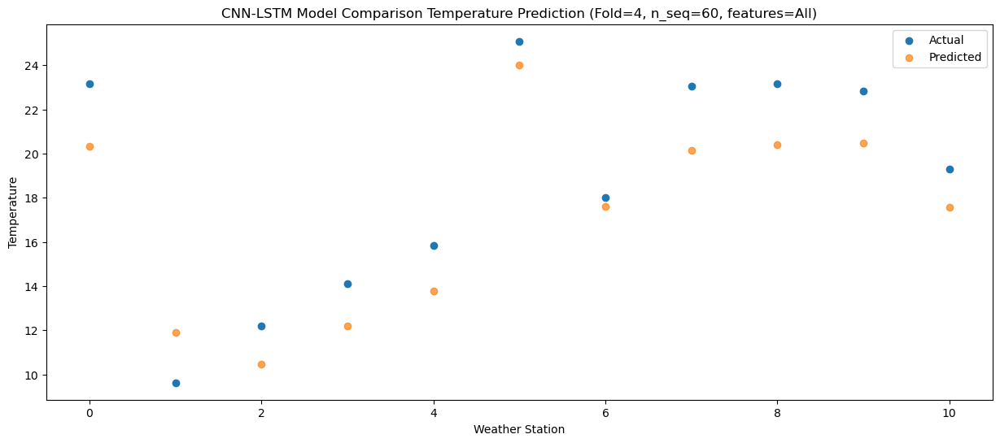

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.617809
1                 1    8.34   9.252098
2                 2    9.06   7.527127
3                 3   11.32   9.152095
4                 4   12.42  10.684681
5                 5   24.40  21.028326
6                 6   14.06  14.440902
7                 7   20.03  16.737331
8                 8   19.67  16.440299
9                 9   19.73  16.573822
10               10   15.00  13.367040


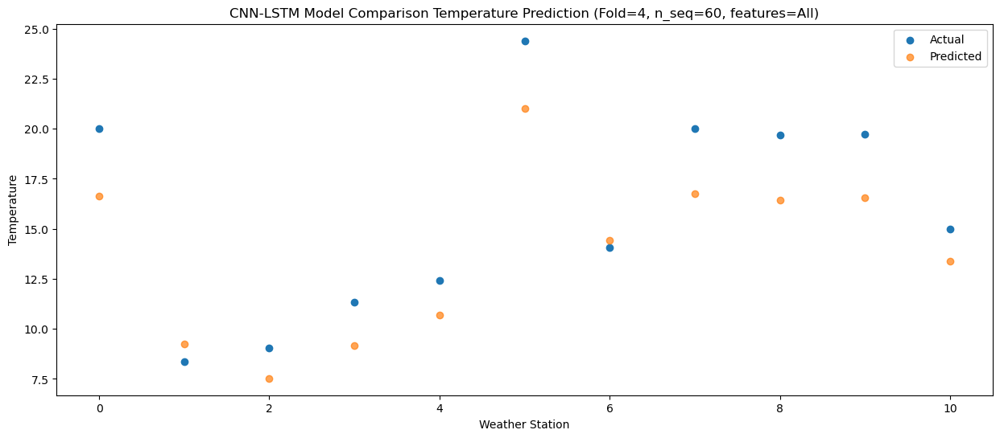

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  10.866443
1                 1    6.50   6.321691
2                 2    5.67   4.049018
3                 3    6.67   4.408638
4                 4    7.55   5.773697
5                 5   18.70  15.885473
6                 6   10.26  11.067148
7                 7   14.26  12.096010
8                 8   14.32  12.051568
9                 9   14.27  11.570934
10               10   11.47   9.225216


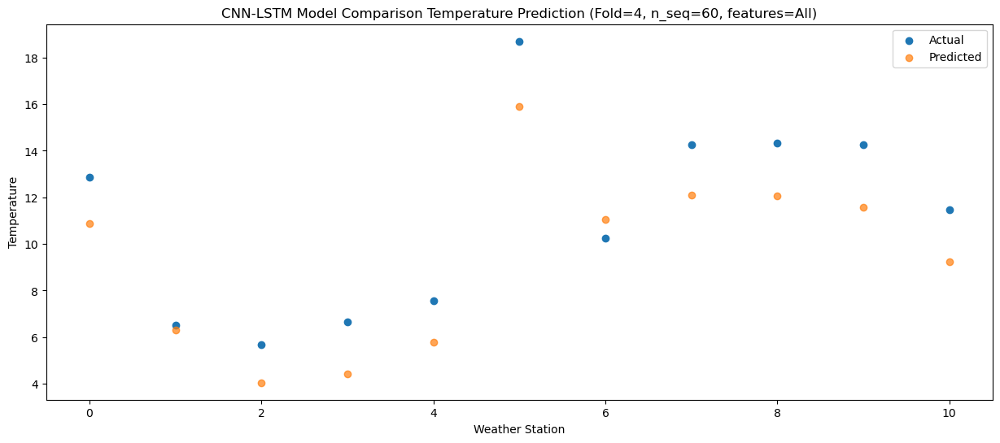

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   0.540626
1                 1   -0.66  -1.194713
2                 2   -3.00  -5.376693
3                 3   -1.33  -4.995646
4                 4   -0.29  -3.569252
5                 5   11.76   7.868112
6                 6    2.10   1.595002
7                 7    6.32   1.932053
8                 8    3.46   0.963192
9                 9    3.96   0.625281
10               10    1.07  -2.104882


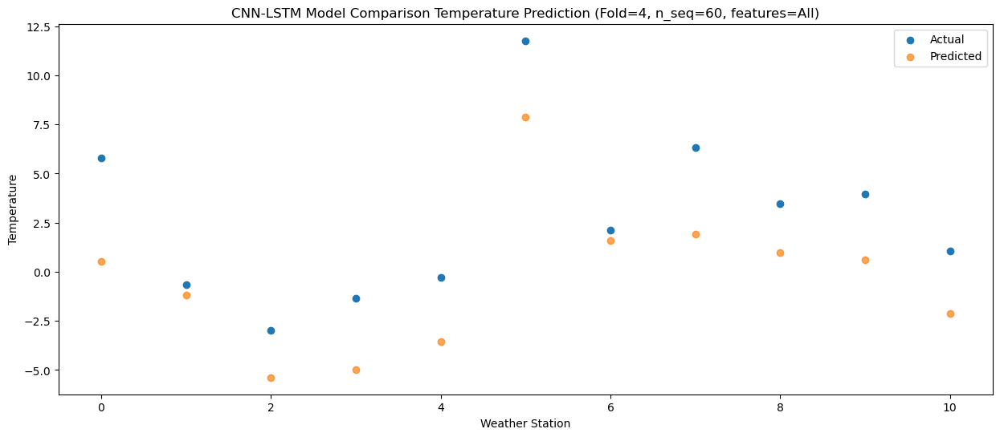

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01  -0.408987
1                 1    1.14   1.023150
2                 2    0.51  -2.347170
3                 3    0.67  -3.416648
4                 4    1.45  -2.305732
5                 5   12.17   7.919284
6                 6    4.01   3.664703
7                 7    7.78   3.038541
8                 8    3.78   1.115552
9                 9    3.71   0.300498
10               10    0.21  -2.427360


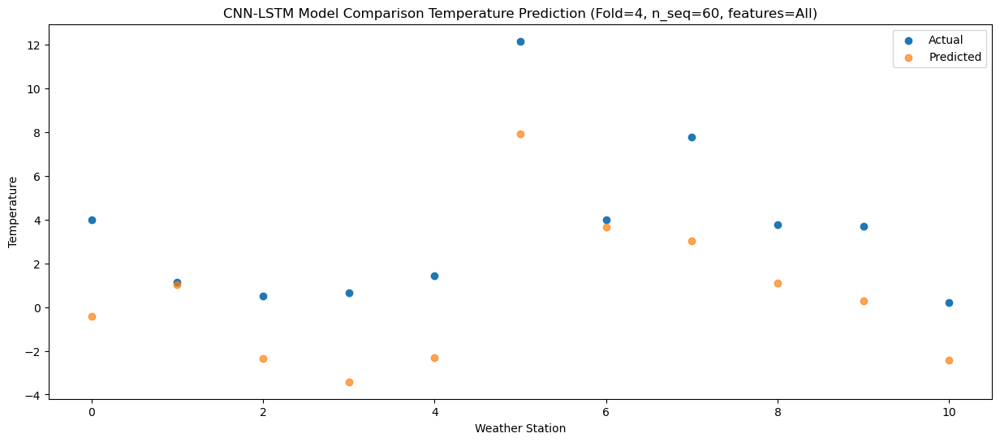

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -9.408365
1                 1   -3.62  -5.112678
2                 2   -7.77 -11.290285
3                 3   -7.80 -12.341816
4                 4   -7.45 -11.090838
5                 5    4.80   1.033433
6                 6   -2.05  -4.599254
7                 7   -1.29  -6.291912
8                 8   -5.06  -8.429365
9                 9   -5.77  -9.213756
10               10   -8.62 -11.782973


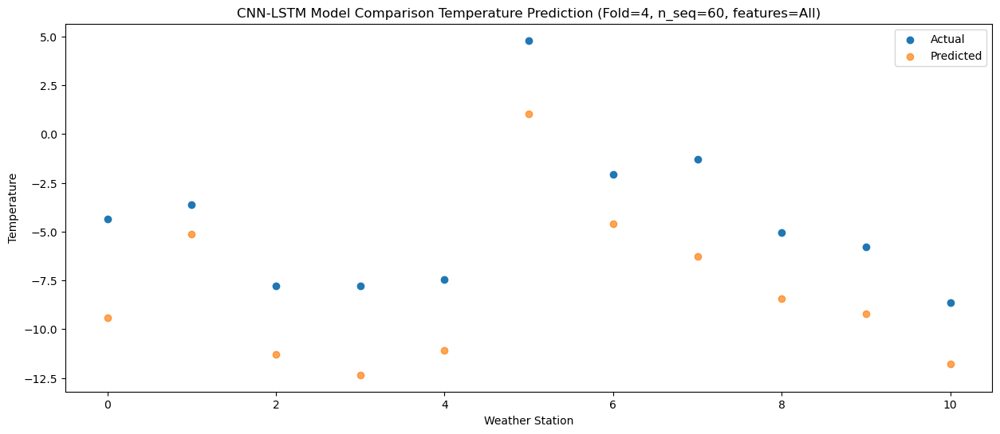

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -7.482147
1                 1   -0.19  -1.528230
2                 2   -5.41  -8.351407
3                 3   -7.54 -10.360029
4                 4   -6.83  -9.188715
5                 5    4.60   2.912111
6                 6    2.23  -1.060041
7                 7    0.77  -3.871854
8                 8   -2.04  -5.175403
9                 9   -2.94  -6.553568
10               10   -5.06  -7.953889


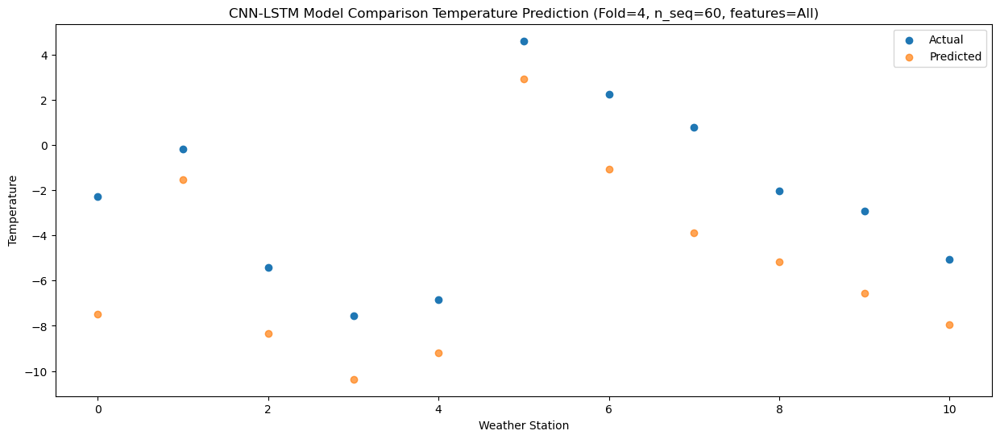

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   0.605263
1                 1    2.63   2.313556
2                 2   -0.67  -2.466218
3                 3   -1.36  -3.275790
4                 4    0.09  -2.027843
5                 5   11.92   9.292479
6                 6    5.79   4.315027
7                 7    7.43   3.352658
8                 8    5.43   1.937972
9                 9    5.27   1.138868
10               10    0.91  -1.221327


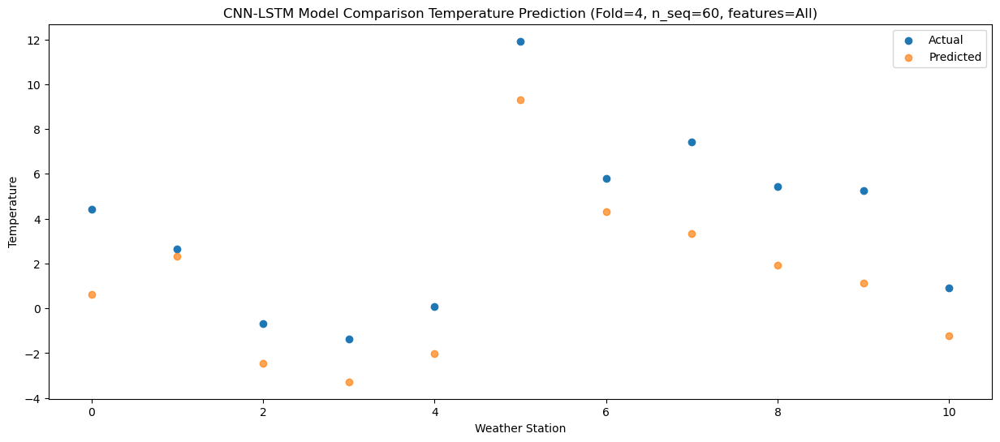

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   5.982429
1                 1    4.97   5.684050
2                 2    3.54   2.151510
3                 3    4.69   1.934557
4                 4    6.78   3.199531
5                 5   19.43  13.991186
6                 6    8.45   8.418533
7                 7   11.29   8.450042
8                 8    9.21   6.691442
9                 9    9.39   6.239870
10               10    4.91   3.219331


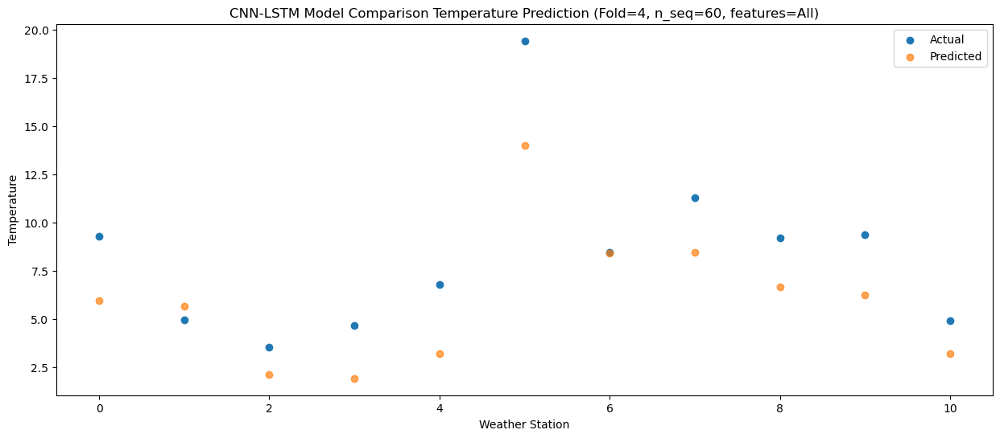

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.507467
1                 1    7.79   9.987504
2                 2    9.34   8.176399
3                 3    9.40   8.679059
4                 4   11.61  10.021071
5                 5   25.12  20.062766
6                 6   14.43  14.704565
7                 7   16.96  15.979553
8                 8   17.71  15.271959
9                 9   17.92  14.959800
10               10   13.49  12.132501


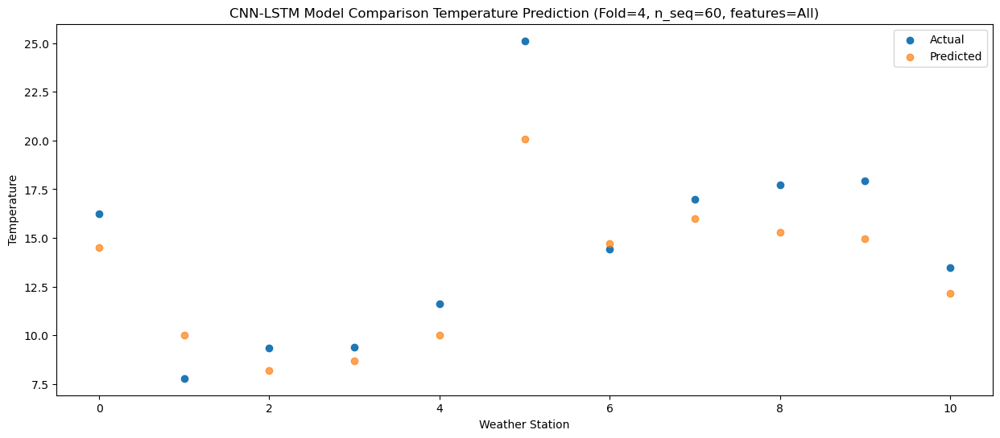

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  19.560607
1                 1    9.51  13.351619
2                 2   12.63  11.952537
3                 3   13.95  13.170412
4                 4   16.28  14.592742
5                 5   27.49  24.703055
6                 6   17.64  18.405728
7                 7   22.28  20.452890
8                 8   22.19  19.611142
9                 9   22.53  19.640290
10               10   16.76  16.294709


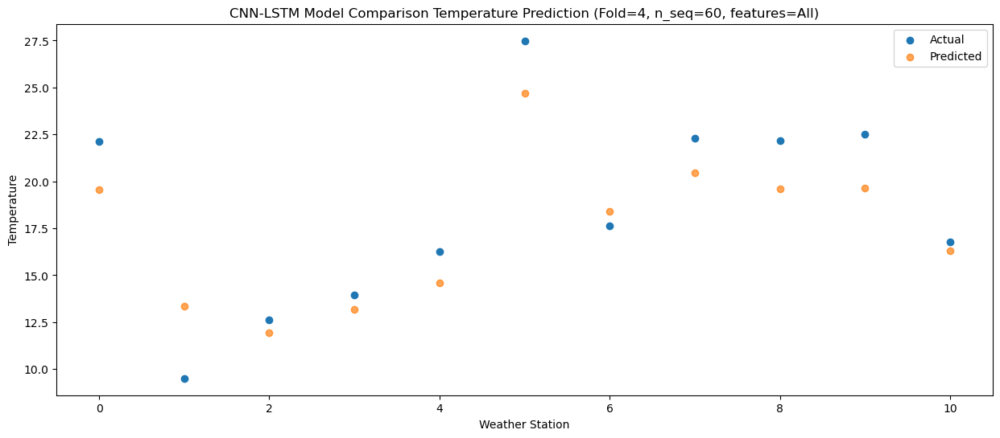

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  22.277346
1                 1    9.88  14.211737
2                 2   12.83  13.222542
3                 3   17.25  15.028680
4                 4   19.70  16.541895
5                 5   29.39  26.715321
6                 6   18.91  19.880872
7                 7   25.98  22.536946
8                 8   24.13  21.975696
9                 9   23.35  22.183784
10               10   19.36  18.760901


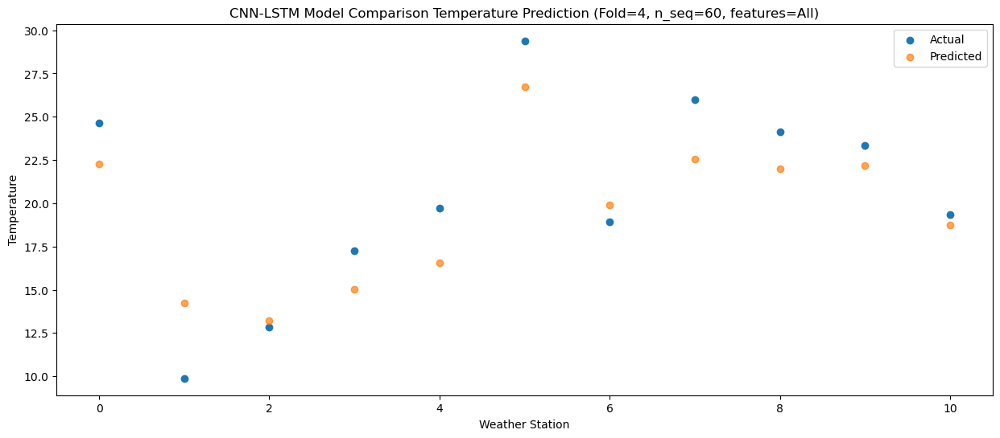

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  20.326098
1                 1    9.83  13.574046
2                 2   11.29  11.380360
3                 3   14.52  12.870984
4                 4   16.86  14.416265
5                 5   26.09  25.249822
6                 6   17.39  18.622797
7                 7   22.46  20.535778
8                 8   21.90  20.449750
9                 9   22.05  20.402689
10               10   18.29  17.660579


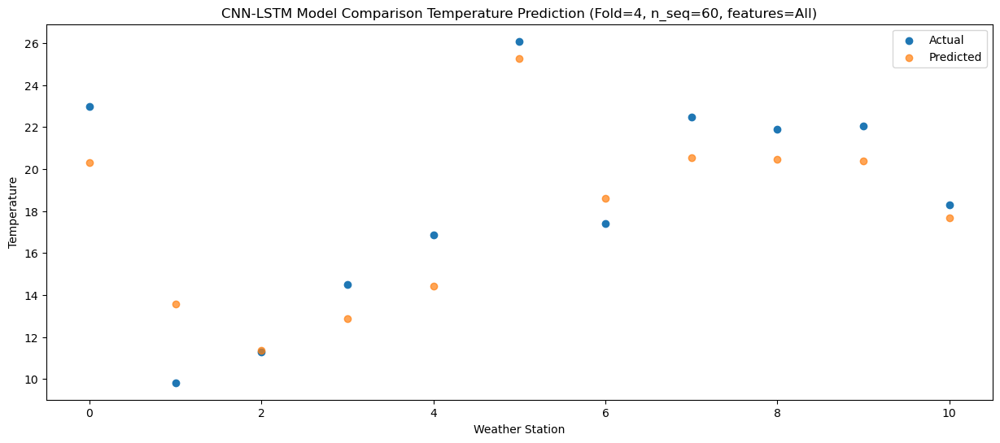

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  15.513784
1                 1    8.39  11.029475
2                 2    9.22   8.079954
3                 3   11.09   9.127061
4                 4   12.77  10.611784
5                 5   23.19  21.713626
6                 6   14.30  15.043454
7                 7   18.87  16.318651
8                 8   17.99  15.575729
9                 9   17.91  15.487843
10               10   14.24  12.525188


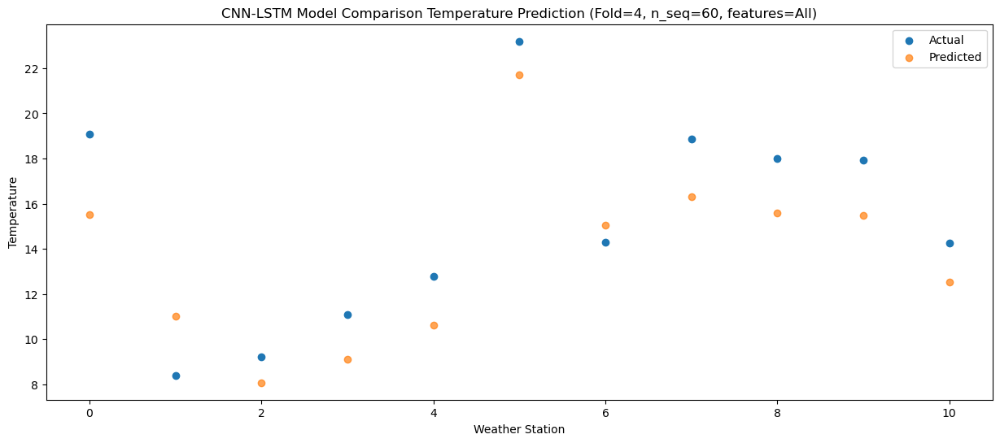

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   8.762624
1                 1    4.56   6.178534
2                 2    3.09   2.375494
3                 3    4.22   2.920796
4                 4    5.62   4.363157
5                 5   16.38  15.765146
6                 6    7.43   9.451178
7                 7   12.50   9.992995
8                 8   10.50   9.231097
9                 9   10.44   8.913239
10               10    7.38   6.316627


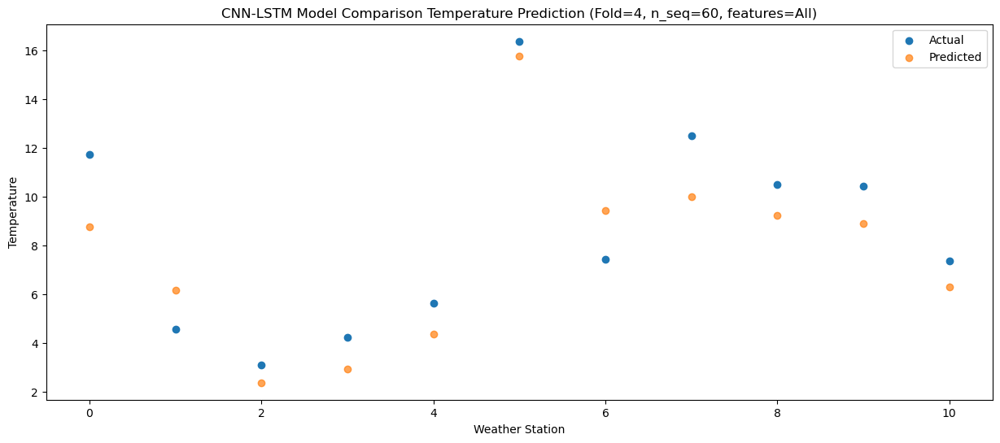

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   0.157894
1                 1    3.10   2.460928
2                 2   -1.50  -2.712933
3                 3   -2.83  -4.400120
4                 4   -1.47  -3.204070
5                 5    8.53   7.977602
6                 6    4.73   4.991818
7                 7    5.95   3.042693
8                 8    4.71   3.142852
9                 9    4.90   1.668038
10               10    3.30   0.980610


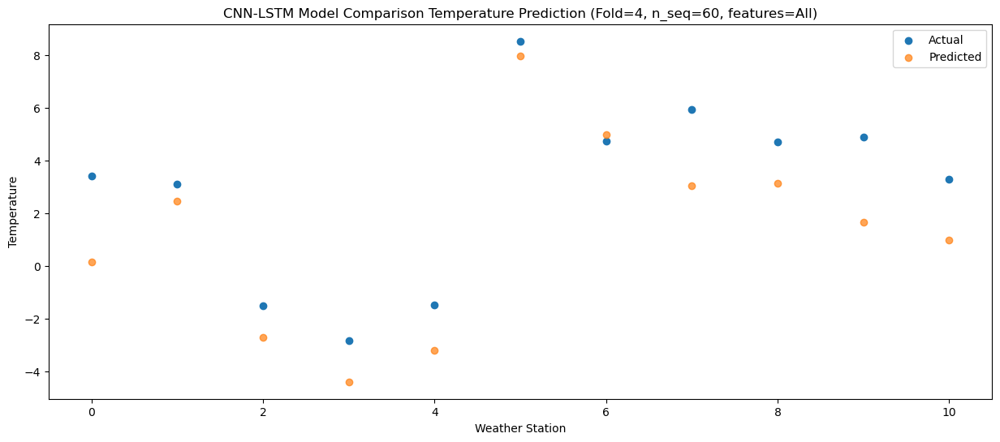

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -5.722796
1                 1   -1.75  -1.025442
2                 2   -3.93  -6.955111
3                 3   -5.52  -8.742176
4                 4   -4.44  -7.588643
5                 5    6.93   4.116170
6                 6   -1.22   0.104532
7                 7    1.10  -2.167581
8                 8   -1.07  -3.358509
9                 9   -1.83  -4.668558
10               10   -3.41  -6.084935


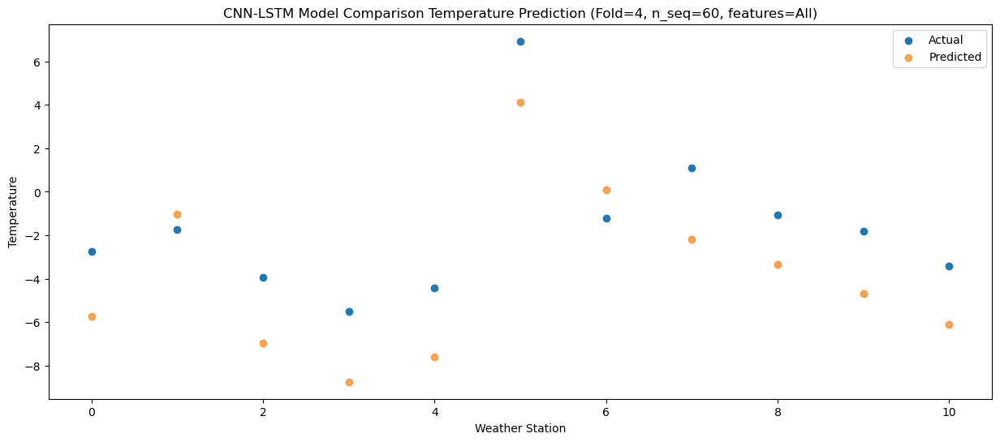

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77  -4.020050
1                 1   -1.90   0.664511
2                 2   -3.52  -5.206156
3                 3   -4.53  -7.167069
4                 4   -3.67  -6.024782
5                 5    7.30   5.565669
6                 6    1.80   1.992931
7                 7    2.75  -0.426911
8                 8    0.89  -1.372128
9                 9    0.41  -2.791885
10               10   -1.78  -3.989987


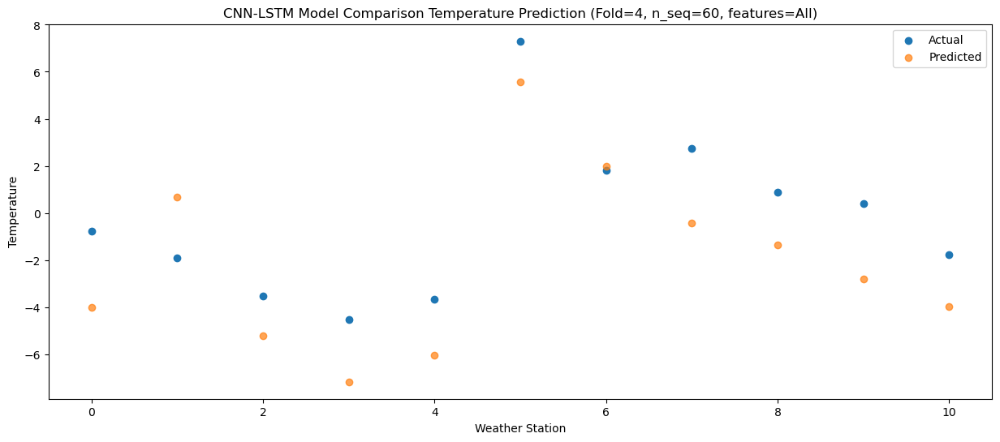

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -3.023760
1                 1    1.40   2.561022
2                 2   -1.58  -3.043134
3                 3   -4.47  -5.317708
4                 4   -3.44  -4.267880
5                 5    7.47   6.842475
6                 6    5.22   3.624317
7                 7    4.89   1.101463
8                 8    2.48  -0.492755
9                 9    1.60  -1.818511
10               10   -1.64  -3.536216


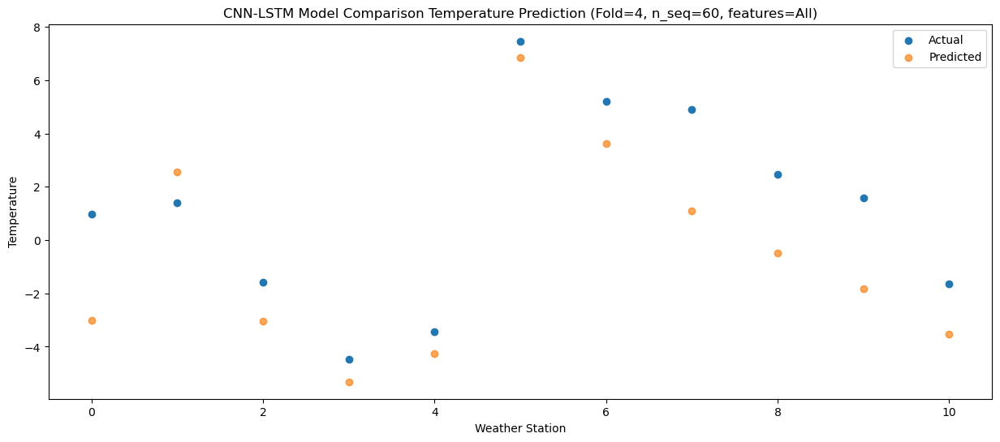

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16  -0.703967
1                 1    3.12   3.600615
2                 2    0.57  -1.389436
3                 3    0.06  -3.005261
4                 4    1.41  -1.908959
5                 5   12.54   9.175970
6                 6    5.70   4.847457
7                 7    6.61   3.134700
8                 8    3.75   1.021306
9                 9    4.14   0.059512
10               10   -0.76  -2.369047


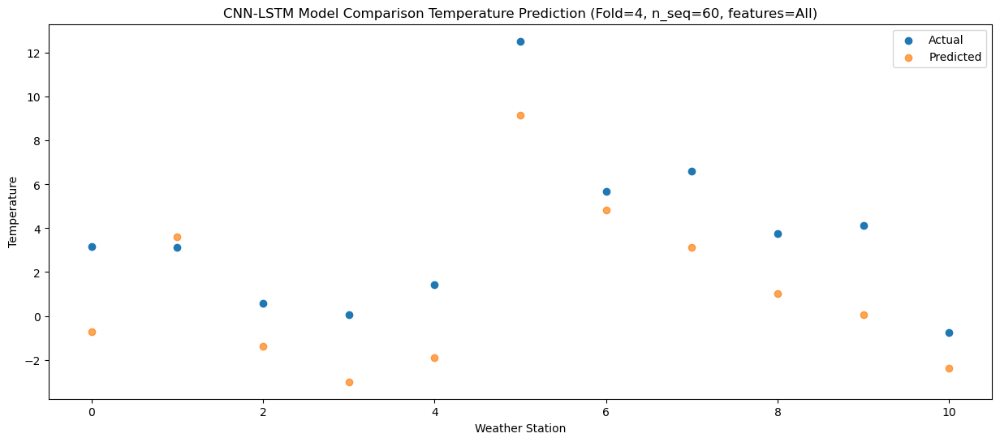

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   6.665493
1                 1    5.84   6.808316
2                 2    2.32   2.510782
3                 3    2.66   1.878434
4                 4    4.06   3.163475
5                 5   16.76  14.269100
6                 6    8.81   9.593252
7                 7   12.23   8.943556
8                 8   10.25   8.271164
9                 9   11.47   7.460484
10               10    7.71   5.526055


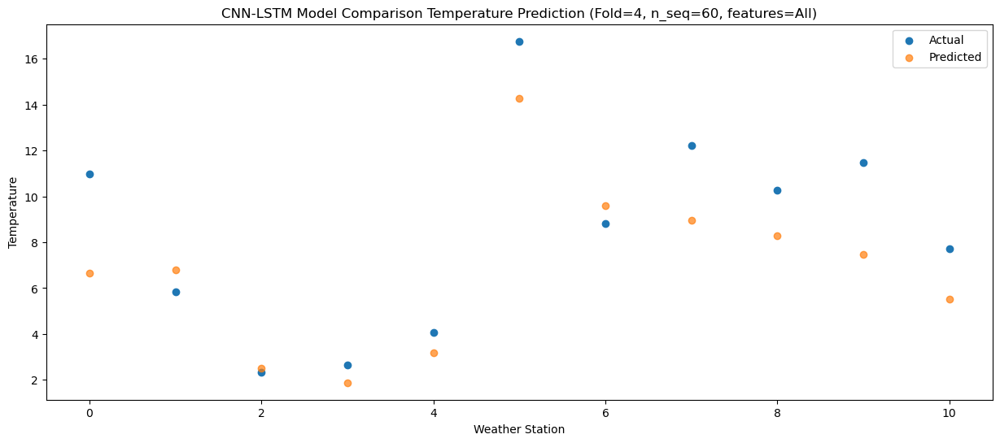

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  13.625834
1                 1    6.62   9.166239
2                 2    7.18   6.762240
3                 3    8.34   7.683266
4                 4   10.22   9.111232
5                 5   21.68  19.740428
6                 6   11.43  13.237640
7                 7   17.01  14.706011
8                 8   15.96  13.624634
9                 9   17.23  13.654784
10               10   11.40  10.303677


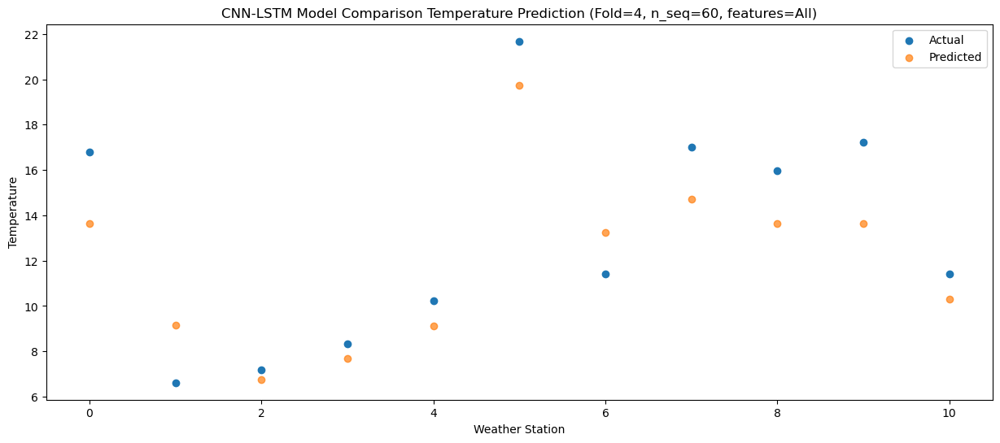

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  17.844746
1                 1    8.83  12.000497
2                 2   10.77  10.426975
3                 3   12.53  11.567274
4                 4   15.33  12.994443
5                 5   28.16  23.168534
6                 6   15.07  16.755141
7                 7   21.09  18.747288
8                 8   19.84  17.793543
9                 9   21.54  17.920861
10               10   15.71  14.438880


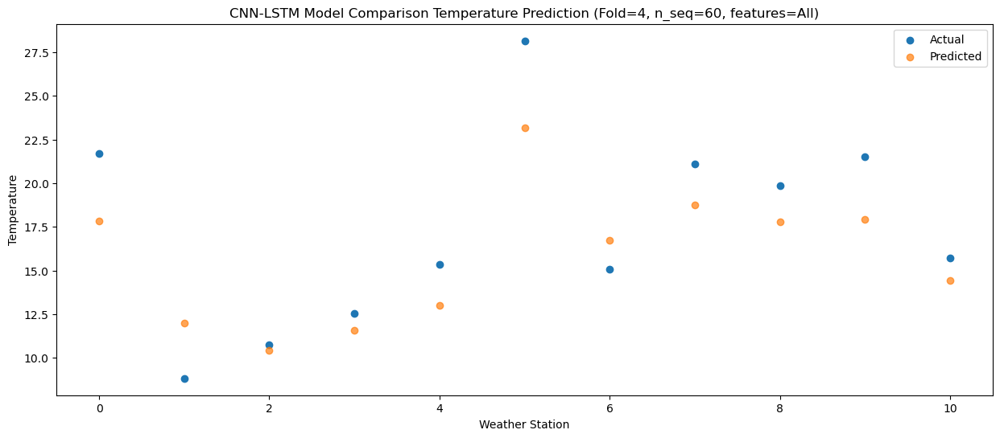

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  20.836466
1                 1   10.44  16.631842
2                 2   12.55  13.667261
3                 3   15.08  14.472325
4                 4   18.41  15.931724
5                 5   29.62  26.951829
6                 6   18.94  20.743725
7                 7   23.05  21.825230
8                 8   22.57  21.424229
9                 9   23.07  21.145323
10               10   18.80  18.626775


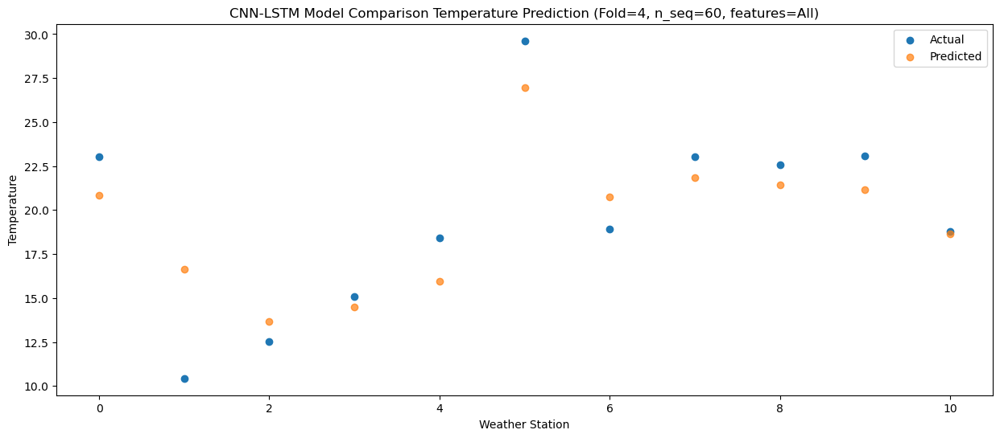

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  20.193354
1                 1   10.95  16.086368
2                 2   14.63  13.609482
3                 3   17.63  14.579065
4                 4   20.28  16.003780
5                 5   29.71  26.716326
6                 6   18.38  19.930809
7                 7   22.86  21.386139
8                 8   21.41  19.974455
9                 9   21.81  20.071963
10               10   17.47  16.525214


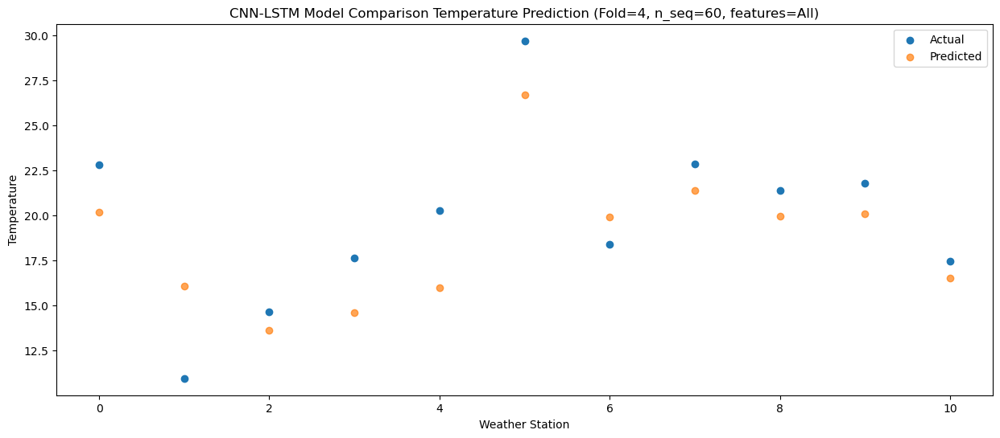

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  16.748939
1                 1    8.85  12.505406
2                 2   10.88   9.935664
3                 3   12.93  10.798510
4                 4   15.19  12.231128
5                 5   26.23  22.912626
6                 6   14.54  16.501849
7                 7   18.92  17.826604
8                 8   18.32  16.803258
9                 9   18.77  16.805553
10               10   15.13  13.552217


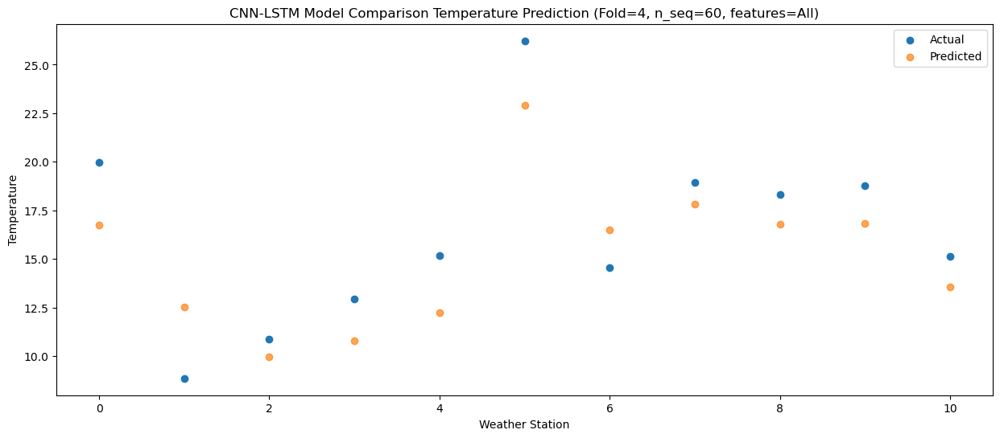

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87   8.921170
1                 1    5.20   8.527753
2                 2    4.77   3.851348
3                 3    4.80   3.531226
4                 4    6.36   4.895472
5                 5   17.70  16.360403
6                 6    9.10  11.227313
7                 7   13.02  10.724642
8                 8   12.18  10.302144
9                 9   12.36   9.610282
10               10    9.87   7.659797


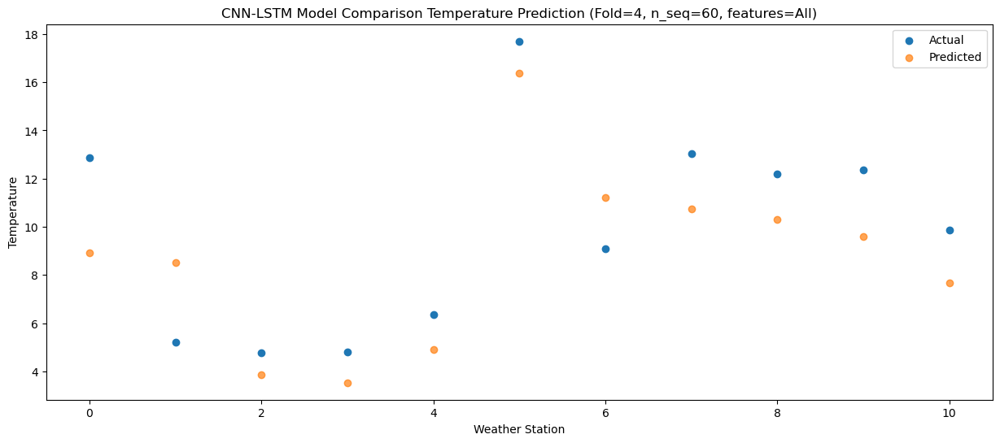

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   1.586226
1                 1    1.49   3.046015
2                 2   -2.19  -2.352458
3                 3   -1.27  -3.000590
4                 4   -0.17  -1.676268
5                 5   10.99  10.015231
6                 6    3.37   4.835402
7                 7    7.12   3.800359
8                 8    5.11   2.805988
9                 9    5.27   2.145206
10               10    2.48  -0.092079


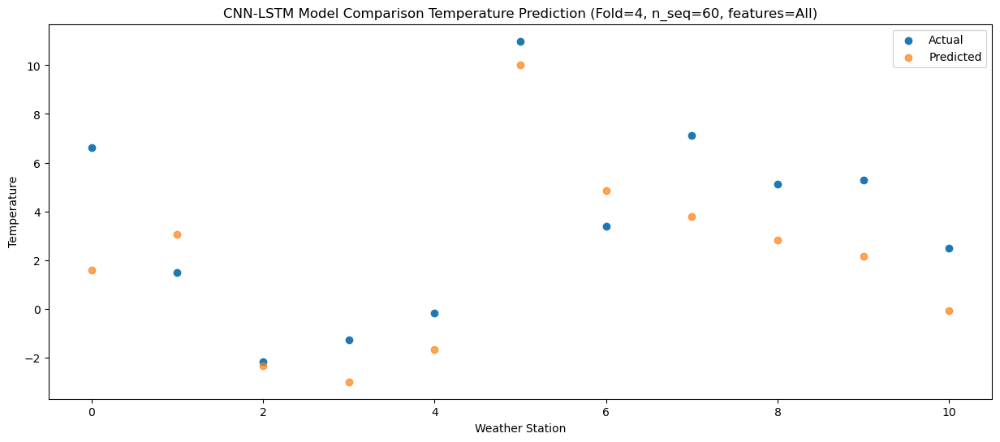

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22  -1.059291
1                 1   -0.63   0.590407
2                 2   -4.74  -5.239520
3                 3   -4.29  -6.117045
4                 4   -3.30  -4.772329
5                 5    8.19   7.182348
6                 6    1.16   2.463948
7                 7    4.24   1.052121
8                 8    3.22   0.797990
9                 9    3.28  -0.166997
10               10    1.82  -1.599619


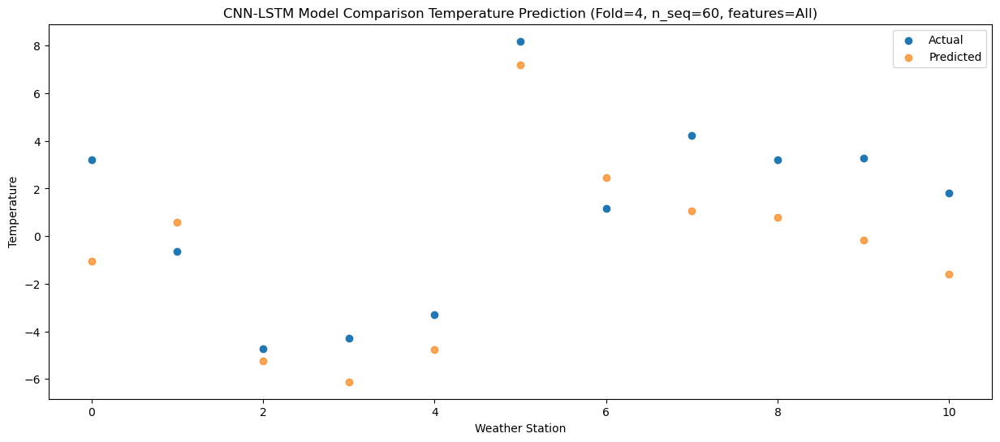

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -8.628752
1                 1   -2.05  -1.037265
2                 2   -8.93  -9.758137
3                 3   -9.81 -12.108232
4                 4   -8.65 -10.856630
5                 5    3.94   2.327869
6                 6   -1.28  -1.504399
7                 7   -2.92  -5.320645
8                 8   -3.06  -5.704277
9                 9   -4.30  -7.362162
10               10   -3.95  -7.711678


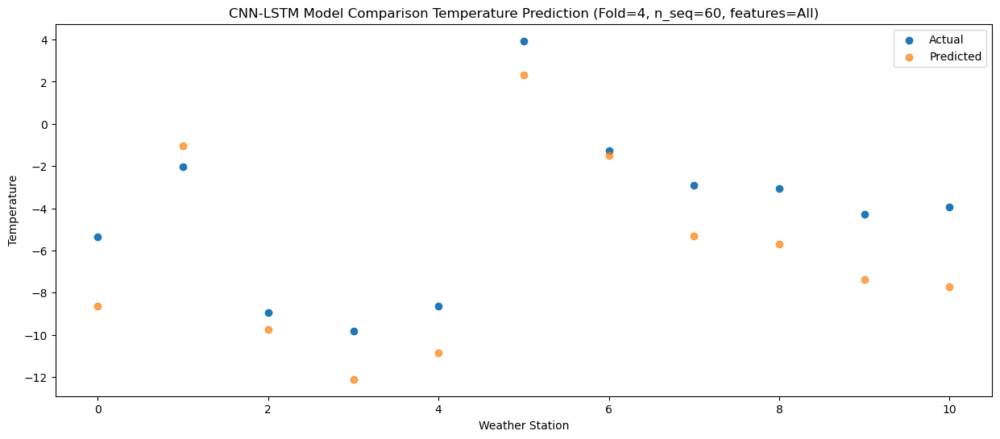

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74  -0.137119
1                 1   -2.32   1.738483
2                 2   -2.61  -3.249378
3                 3   -1.40  -3.806054
4                 4   -0.33  -2.517671
5                 5   10.76   9.022719
6                 6    2.13   3.273725
7                 7    6.99   2.466411
8                 8    3.28   0.535469
9                 9    3.47   0.086772
10               10   -0.47  -2.871031


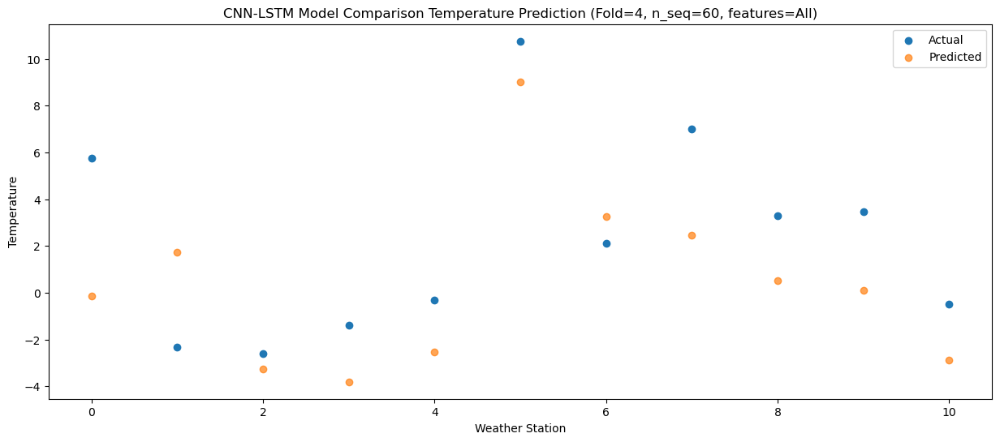

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   2.782122
1                 1    2.58   5.796380
2                 2   -0.38   0.452567
3                 3    1.01  -0.644064
4                 4    2.24   0.586877
5                 5   13.36  12.112815
6                 6    5.92   7.219989
7                 7    9.42   5.806538
8                 8    7.72   4.191483
9                 9    7.62   3.400930
10               10    2.88   1.025633


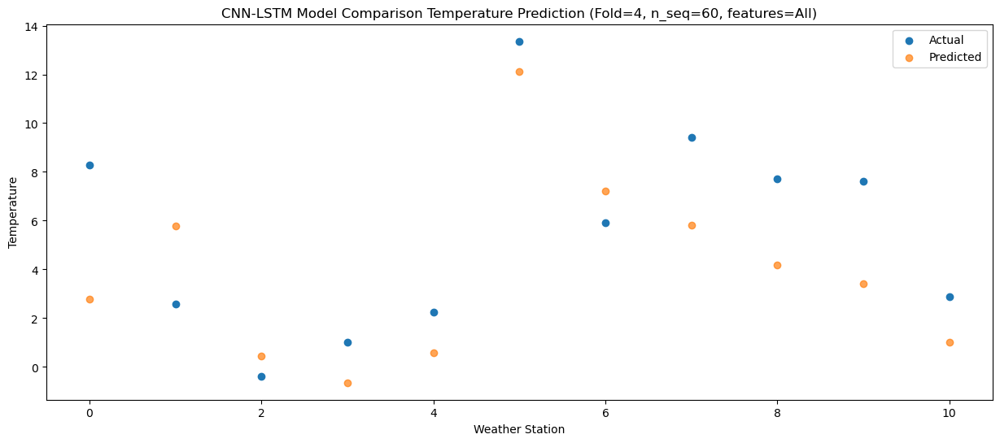

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   8.272962
1                 1    3.63   8.357832
2                 2    3.44   4.322482
3                 3    4.86   4.002753
4                 4    6.29   5.302454
5                 5   18.32  16.385759
6                 6   10.15  10.926272
7                 7   13.56  10.637179
8                 8   12.30   9.142825
9                 9   12.11   8.668615
10               10    8.60   5.880742


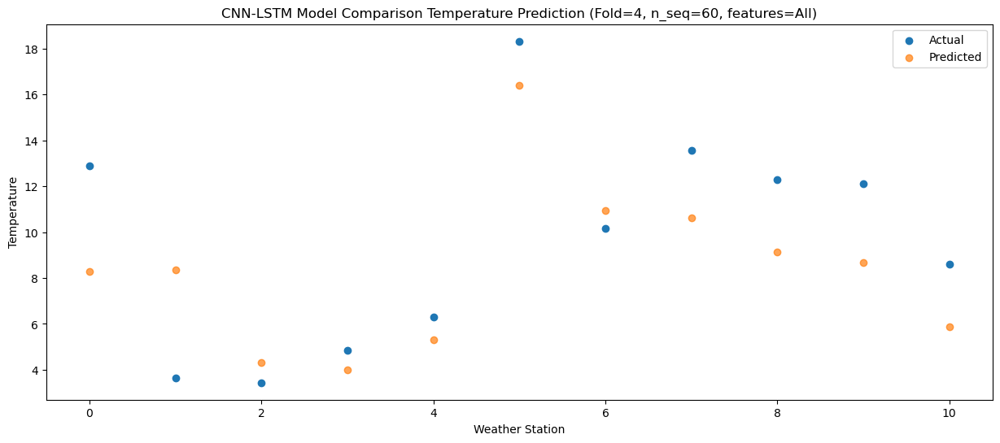

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  13.995830
1                 1    9.08  12.871767
2                 2    8.96   9.223741
3                 3    9.62   8.928414
4                 4   11.09  10.253471
5                 5   23.61  21.136322
6                 6   14.22  16.135496
7                 7   18.21  15.989701
8                 8   18.90  15.183470
9                 9   19.14  14.621934
10               10   14.70  12.229334


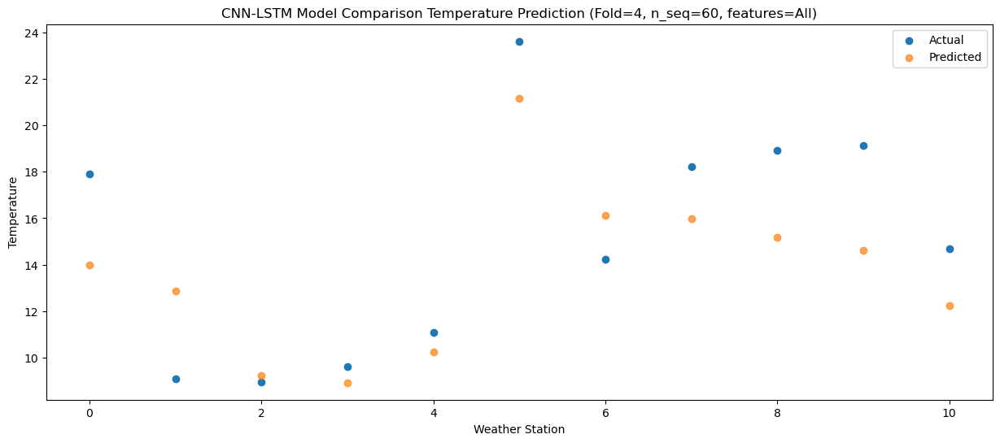

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  18.696346
1                 1    9.73  15.614916
2                 2   11.59  12.253622
3                 3   13.65  12.685621
4                 4   15.54  14.127334
5                 5   27.62  25.290440
6                 6   17.64  19.377367
7                 7   21.93  19.940566
8                 8   22.26  19.427150
9                 9   23.11  19.071160
10               10   17.86  16.587044


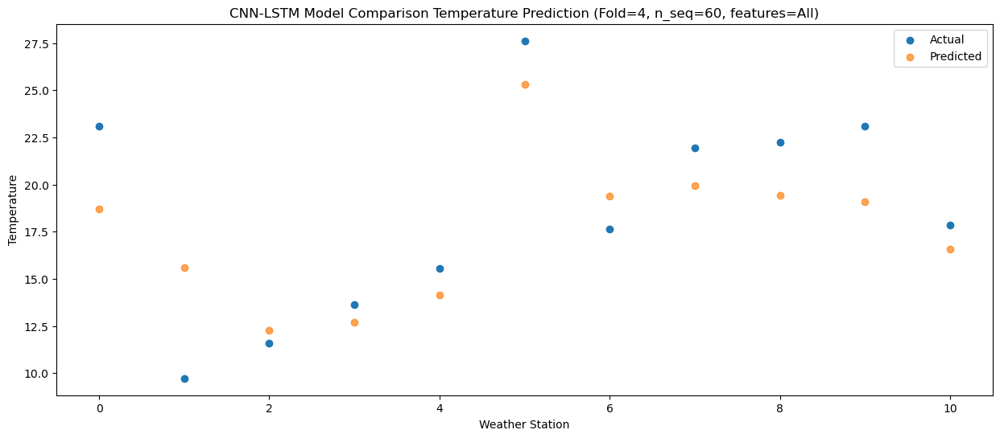

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  19.119230
1                 1   10.42  16.858448
2                 2   12.61  12.288427
3                 3   14.55  12.657131
4                 4   16.25  14.176646
5                 5   26.45  26.176951
6                 6   19.10  20.085067
7                 7   22.23  20.071256
8                 8   22.27  20.076771
9                 9   22.14  19.525540
10               10   19.38  17.704854


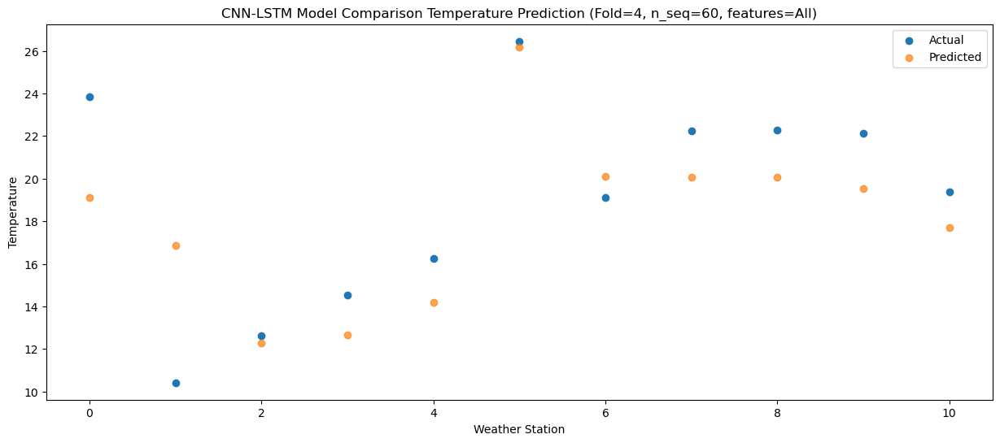

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  18.917636
1                 1   10.12  16.043877
2                 2   13.18  12.519696
3                 3   16.30  13.158284
4                 4   18.21  14.618985
5                 5   28.91  25.957500
6                 6   17.94  19.424174
7                 7   22.67  20.124637
8                 8   22.19  19.118300
9                 9   21.80  18.980723
10               10   18.24  16.005008


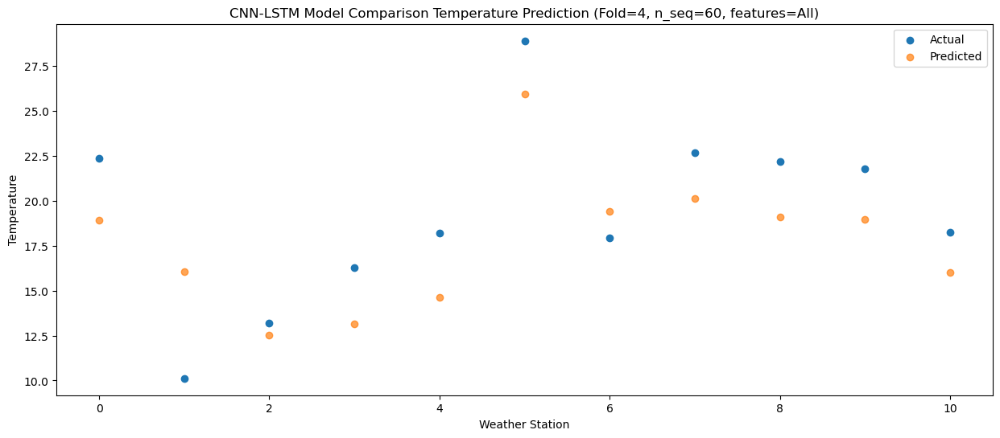

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  15.868233
1                 1    9.25  13.445751
2                 2    9.57   9.380545
3                 3   10.91   9.863448
4                 4   12.20  11.342883
5                 5   22.46  22.902029
6                 6   15.50  16.569668
7                 7   18.53  16.947689
8                 8   19.58  16.218952
9                 9   18.57  16.023198
10               10   15.97  13.290672


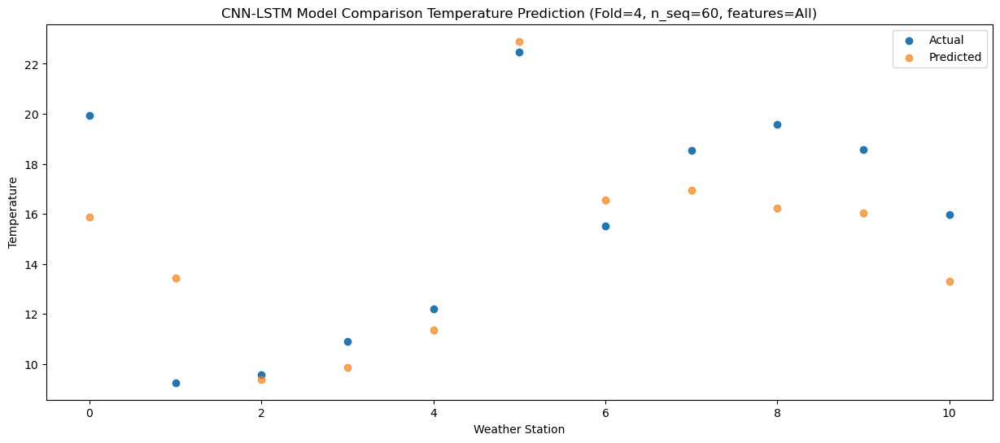

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  10.051054
1                 1    5.48   9.728636
2                 2    5.43   5.195364
3                 3    8.16   5.257107
4                 4    9.78   6.654065
5                 5   20.75  18.339129
6                 6    9.88  12.039406
7                 7   14.85  11.884454
8                 8   13.65  10.456195
9                 9   13.50  10.168188
10               10    9.50   7.251575


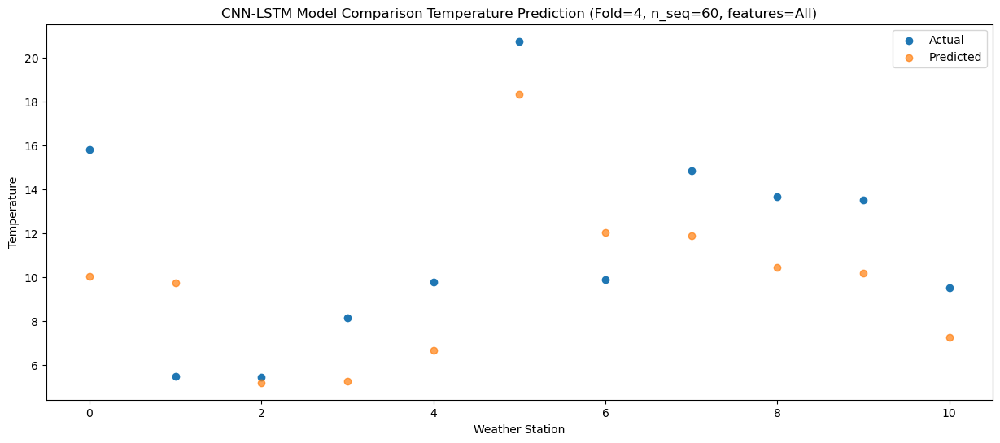

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_14 (Conv1D)          (None, 1, 1024)           2028544   
                                                                 
 max_pooling1d_14 (MaxPoolin  (None, 1, 1024)          0         
 g1D)                                                            
                                                                 
 dropout_42 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_28 (LSTM)              (None, 1, 512)            3147776   
                                                                 
 dropout_43 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_29 (LSTM)              (None, 512)               2099200   
                                                     

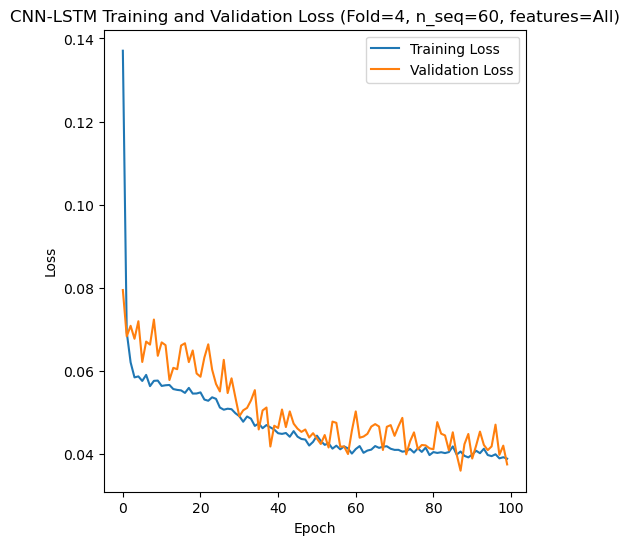

[[1.006831165331793, 0.6108676490609931, 0.7422740115885016, 0.8506455731497394, 1.57845554011908, 0.9046929500369486, 1.072229382595025, 1.1681223926757116, 1.399944112997784, 0.9491725887520418, 1.1260858400907165, 0.706755841349545, 1.020095102098798, 1.1622716449884978, 1.0096149971291144, 0.5761840854565956, 1.055811176241449, 1.2714000585503429, 1.5007672756504018, 1.65750245839142, 1.4732015028672127, 1.5175297292202885, 1.8179013172942535, 1.9813690991690303, 1.877777715339394, 1.650110884457352, 1.4837295113082818, 1.5001792051454992, 1.5648369957814676, 1.498458297270882, 1.9203784568470652, 1.9268019931388642, 2.2210384585539886, 1.9592395473486437, 1.9612691031991636, 2.454276443495271, 2.0565690768294744, 2.284011305215302, 2.294370028678182, 2.12263580485948, 2.1219005196864202, 2.424610067134714, 2.7093300087035153, 2.947171286366825, 2.9199626772836225, 2.5238354536944576, 2.73017123292566, 3.344570143490961, 3.5065106954950083, 3.7843211638444587, 3.5004153379305674, 3

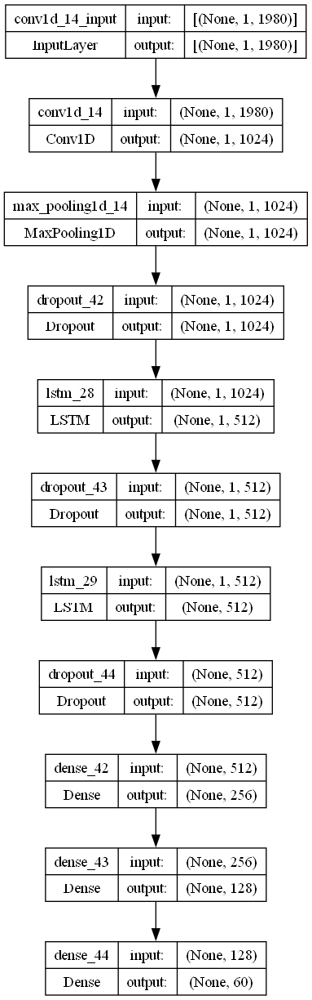

In [4]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best CNN-LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.19234474220376732
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.38382301488750553

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# make one forecast with a CNN-LSTM model,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)